In [2]:
# Import all essential libraries

import os
import csv
import ipdb
import math
import warnings
import random
import numpy as np
import networkx as nx
import scipy.constants as sc
import matplotlib.pyplot as plt
import networkx.algorithms.isomorphism as iso
# %matplotlib qt
from IPython.core.debugger import Pdb
ipdb = Pdb()

In [3]:
#Class representation of Atom (node in our network)

class Atom():
    def __init__(self, name, number):
        self._name = name + " " + str(number)
        self._number = number
        self._element = name
        self._valency = self.get_max_valency()

    def get_max_valency(self): #Returns maximum valency for each atom
        name = self._element[0]
        if name == "H":
            return 1
        elif name == "C":
            return 4
        elif name == "N":
            return 3
        elif name == "O":
            return 2
        elif name == "S":
            return 2

    def current_valency(self, G): #Updates the current valency of the atom by accounting for its edges.
        neig = nx.degree(G, self)
        max_val = self.get_max_valency()
        if neig > max_val:
            ipdb.set_trace()
            raise ValueError('Atom has more neighbours than valence')
        else:
            # print(max_val, neig)
            self._valency = max_val - neig
        
    def get_total_valency(self, G): #Returns the current valency of the atom
        neig = nx.degree(G, self)
        free_electrons = self.get_max_valency() - neig
        return free_electrons
        
        
    def __repr__(self): #Returns the representations of an atoms which is its symbol followed by its index.
        return self._name

In [4]:
#Function for plotting a MultiGraph

def plot_fig(G, title=""):
    A = nx.adjacency_matrix(G)
    pos = nx.spring_layout(G)
    nodes = list(nx.nodes(G))
    mapping = {}
    for i,j in enumerate(nodes):
        mapping[j] = i
        
    plt.figure()
    if title: plt.title(title)
    for i in G.edges():
        G[i[0]][i[1]][0]['number'] = A[mapping[i[0]], mapping[i[1]]]
    labels = nx.get_edge_attributes(G, 'number')
    edge_labels = {}
    node_colors = [] #Color code for distinguishing between atoms 
    for i in nx.nodes(G):
        if i._element=="H":
            node_colors.append('#ccffd3')
        elif i._element=="C":
            node_colors.append('grey')
        elif i._element=="O":
            node_colors.append('red')
        elif i._element=="N":
            node_colors.append('#74b6fc')
            
            
    for i in labels:
        edge_labels[(i[0], i[1])] = labels[i]
    nx.draw(G, pos, with_labels=True,edge_color='black',width=1,linewidths=1,node_size = 500,node_color=node_colors,alpha=0.9)
    nx.draw_networkx_edge_labels(G, pos, edge_labels = edge_labels)
    plt.show()

In [5]:
# Function to update the valencies of the atoms
# This function updates the atom valencies based 
# on the number of edges that atom forms.

def fix_valencies(G):
    for node in nx.nodes(G):
        degree = len(G[node])
        if degree > 0:
            node.current_valency(G)

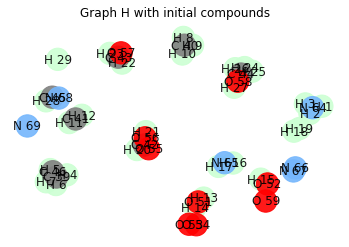

In [6]:
#This graph acts like a database. It stores known intermediates from literature as connected components in them. 
#The dictionary data_G links these components to their corresponding free energy values.
H = nx.MultiGraph()

H_lists = [Atom("H",i) for i in range(1,30)]
C_lists = [Atom("C",i) for i in range(39, 47)]
O_lists = [Atom("O",i) for i in range(51, 60)]
N_lists = [Atom("N",i) for i in range(64, 70)]
for i,lst in enumerate([H_lists, C_lists, O_lists, N_lists]):
    for comp in lst:
        H.add_node(comp, data=comp)

# nx.draw(H,with_labels=True)
H.add_edges_from([(H_lists[0], N_lists[0]), (N_lists[0], H_lists[1]), (N_lists[0], H_lists[2])])
H.add_edges_from([(H_lists[3], C_lists[0]), (H_lists[4], C_lists[0]), (H_lists[5], C_lists[0]), (H_lists[6], C_lists[0])])
H.add_edges_from([(H_lists[7], C_lists[1]), (H_lists[8], C_lists[1]), (H_lists[9], C_lists[1])])
H.add_edges_from([(H_lists[10], C_lists[2]), (H_lists[11], C_lists[2])])
H.add_edges_from([(H_lists[12], O_lists[0]), (H_lists[13], O_lists[0])])
H.add_edges_from([(H_lists[14], O_lists[1])])
H.add_edges_from([(H_lists[15], N_lists[1]), (N_lists[1], H_lists[16])])
H.add_edges_from([(H_lists[17], H_lists[18])])
H.add_edges_from([(O_lists[2], O_lists[3])])
H.add_edges_from([(N_lists[2], N_lists[3]), (N_lists[2], N_lists[3]), (N_lists[2], N_lists[3])])
H.add_edges_from([(H_lists[19], C_lists[3]),(O_lists[4], C_lists[3]),(O_lists[4], C_lists[3]),(O_lists[5], C_lists[3]),(H_lists[20], O_lists[5])])
H.add_edges_from([(H_lists[21], C_lists[4]),(O_lists[6], C_lists[4]),(O_lists[6], C_lists[4]),(H_lists[22], C_lists[4])])
H.add_edges_from([(H_lists[23], C_lists[5]), (H_lists[24], C_lists[5]), (H_lists[25], C_lists[5]),(O_lists[7], C_lists[5]),(O_lists[7], H_lists[26])])
H.add_edges_from([(H_lists[27], C_lists[6]), (N_lists[4], C_lists[6]), (N_lists[4], C_lists[6]), (N_lists[4], C_lists[6])])

plot_fig(H, "Graph H with initial compounds")

data_G = {}
#Gibbs free energy value for the connected compounds.
G_value = [-185.9402151,-213.1921923,2.651927862,247.7699191,-380.6041595,-97.3578968,43.5280415,-97.16928744,-563.5848,-269.5222798,-379.0914382,-16.77210243,133.6241442,736.5926058,-149.516614,132.4236,-139.8716185,361.0634601]

#Each connected component in the network H is an expected key intermediate from our model. 
#These compounds are now matched to their G value using a dictionary.
entities = nx.connected_components(H)
entities = list(entities)
for i in range(len(entities)):
    sub = H.subgraph(list(entities[i]))
    data_G[sub] = G_value[i]

#The valency of all atoms in H is now updated.  
fix_valencies(H)    

In [7]:
# Finding G of all components given a network
# Input 
#     - G: the network whose total gibbs free energy needs to be calculated
# Output
#     - G_energy: gibbs free energy of the network

def input_G(G):
    
    #All the connected components of the network is obtained
    cc = list(nx.connected_components(G))
    G_energy = 0
    
    for i in range(len(cc)):
        found = 0
        # Fetch a connected component and check if it is isomorphic to any of the subgraphs in the database network H.
        # Variable 'same' and 'found' keeps track of whether a compound in matched to the ones on the database.
        sub_G = G.subgraph(list(cc[i]))
        same = False
        
        for j in data_G:
            
            # iso.is_isomorphic compared the connection of nodes between two graphs.
            GH = iso.GraphMatcher(sub_G,j)
            if GH.is_isomorphic() == True:
                same = True
            else:
                same = False
            # In case a network with the same connections as our compound is found, 
            #we check the mapping for each nodes' label to confirm the same.
            if same == True:
                if len(GH.mapping) != 2:
                    for k in GH.mapping: # check mapping of each nodes
                        if str(k)[0] == str(GH.mapping[k])[0]: # Each node's label (without index) should coincide
                            same = True
                        else:
                            same = False
                            break
                else:
                    keys = []
                    values = []
                    for i in GH.mapping.keys():
                        keys.append(str(i).split()[0])
                    for i in GH.mapping.keys():
                        values.append(str(i).split()[0])
                    keys = keys.sort()
                    values = values.sort()
                    if keys == values:
                        same = True
                    else: 
                        same = False
    
            if same == True: # If compound is found, add G
                found = 1
                break

        if same == True:
            G_energy += data_G[j]
            
        elif same == False: # If compound not found,
            randomp = G.subgraph(list(cc[i]))
            plot_fig(randomp)
            
            val = float(input('Enter G value of %s: '%list(cc[i])))
            data_G[sub_G] = val # Add the new compound's data to our dictionary
            G_energy += val

    return G_energy

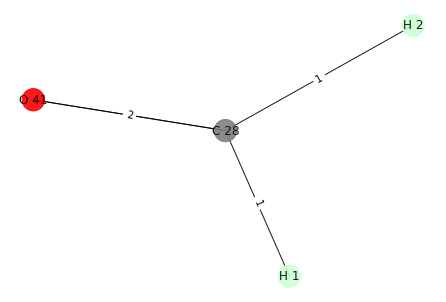

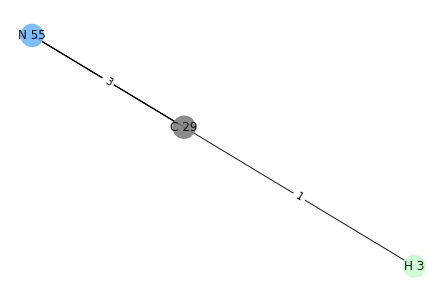

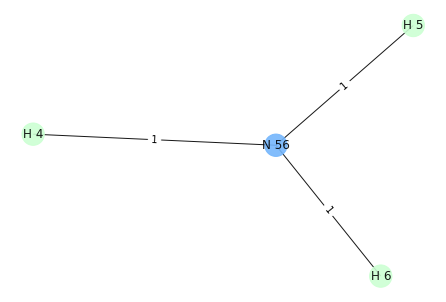

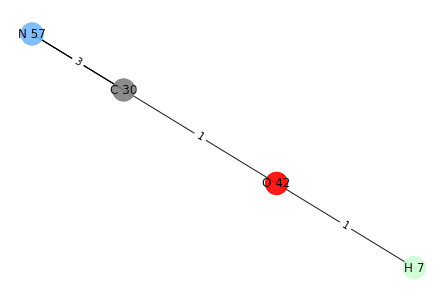

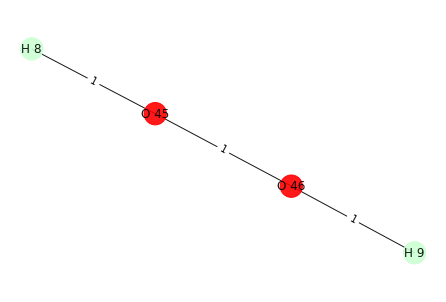

...

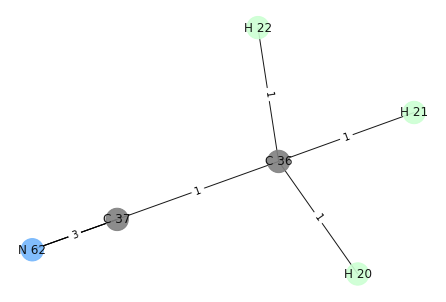

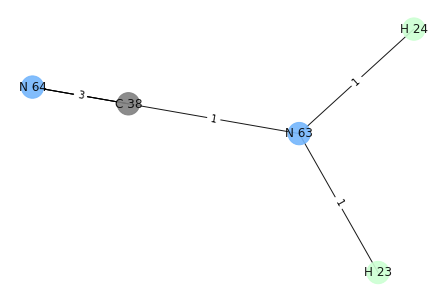

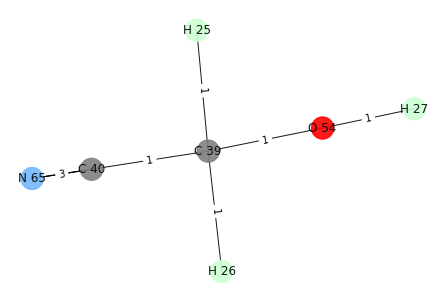

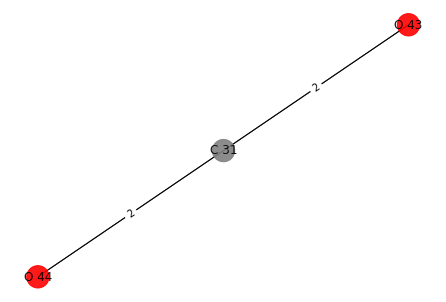

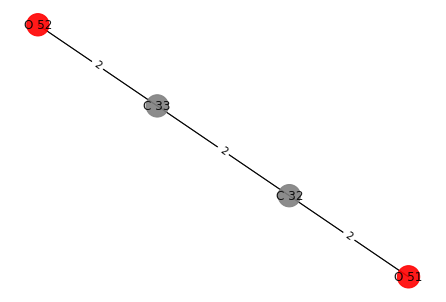

In [8]:
#Compounds of size = 3-7 most commonly occuring compounds- From the results of previous code.

N = nx.MultiGraph()

H_list_n = [Atom("H",i) for i in range(1,28)]
C_list_n = [Atom("C",i) for i in range(28, 41)]
O_list_n = [Atom("O",i) for i in range(41, 55)]
N_list_n = [Atom("N",i) for i in range(55, 66)]
for i,lst in enumerate([H_list_n, C_list_n, O_list_n, N_list_n]):
    for comp in lst:
        N.add_node(comp, data=comp)
#CH2O        
N.add_edges_from([(H_list_n[0], C_list_n[0]), (H_list_n[1], C_list_n[0]), (O_list_n[0], C_list_n[0]), (O_list_n[0], C_list_n[0])])
#HCN
N.add_edges_from([(C_list_n[1], H_list_n[2]), (C_list_n[1], N_list_n[0]), (C_list_n[1], N_list_n[0]), (C_list_n[1], N_list_n[0])])
#NH3
N.add_edges_from([(H_list_n[3], N_list_n[1]), (N_list_n[1], H_list_n[4]), (N_list_n[1], H_list_n[5])])
#CNOH
N.add_edges_from([(C_list_n[2], N_list_n[2]), (C_list_n[2], N_list_n[2]), (C_list_n[2], N_list_n[2]), (C_list_n[2], O_list_n[1]), (O_list_n[1], H_list_n[6])])
#CO2
N.add_edges_from([(O_list_n[2], C_list_n[3]), (O_list_n[2], C_list_n[3]), (O_list_n[3], C_list_n[3]), (O_list_n[3], C_list_n[3])])
#H2O2
N.add_edges_from([(O_list_n[4], H_list_n[7]), (O_list_n[4], O_list_n[5]), (O_list_n[5], H_list_n[8])])
#N2H2
N.add_edges_from([(H_list_n[9], N_list_n[3]), (N_list_n[3], N_list_n[4]), (N_list_n[3], N_list_n[4]), (H_list_n[10], N_list_n[4])])
#HNO
N.add_edges_from([(H_list_n[11], N_list_n[5]), (O_list_n[6], N_list_n[5]), (O_list_n[6], N_list_n[5])])
#HNO2
N.add_edges_from([(O_list_n[7], N_list_n[6]), (O_list_n[7], N_list_n[6]), (O_list_n[8], N_list_n[6]), (O_list_n[8], H_list_n[12])])
#H2O
N.add_edges_from([(H_list_n[13], O_list_n[9]), (H_list_n[14], O_list_n[9])])
#C2O2
N.add_edges_from([(O_list_n[10], C_list_n[4]), (O_list_n[10], C_list_n[4]), (C_list_n[4], C_list_n[5]), (C_list_n[5], C_list_n[4]), (O_list_n[11], C_list_n[5]), (O_list_n[11], C_list_n[5])])
#CH3CHO
N.add_edges_from([(H_list_n[15], C_list_n[6]), (C_list_n[6], H_list_n[16]), (C_list_n[6], H_list_n[17]), (C_list_n[6], C_list_n[7]), (H_list_n[18], C_list_n[7]), (O_list_n[12], C_list_n[7]), (O_list_n[12], C_list_n[7])])
#CH3CN
N.add_edges_from([(H_list_n[19], C_list_n[8]), (C_list_n[8], H_list_n[20]), (C_list_n[8], H_list_n[21]), (C_list_n[8], C_list_n[9]), (C_list_n[9], N_list_n[7]), (C_list_n[9], N_list_n[7]), (C_list_n[9], N_list_n[7])])
#NH2CN
N.add_edges_from([(H_list_n[22], N_list_n[8]), (H_list_n[23], N_list_n[8]), (C_list_n[10], N_list_n[8]), (C_list_n[10], N_list_n[9]), (C_list_n[10], N_list_n[9]), (C_list_n[10], N_list_n[9])])
#(OH)CH2CN
N.add_edges_from([(H_list_n[24], C_list_n[11]), (C_list_n[11], H_list_n[25]), (C_list_n[11], O_list_n[13]), (H_list_n[26], O_list_n[13]), (C_list_n[11], C_list_n[12]), (C_list_n[12], N_list_n[10]), (C_list_n[12], N_list_n[10]), (C_list_n[12], N_list_n[10])])

fix_valencies(N)
for i in nx.connected_components(N):
    plot_fig(N.subgraph(list(i)))

#Gibbs free energy value for the connected compounds.
G_value_N = [-269.5222798, -16.77210243, -185.9402151, -193.3606757, -309.19, 39.66146045, -55.64, -266.6638947, -380.6041595, -368.2453749, -108.3733513, -46.38146781, -261.5047571, -551.2701753, -200.95752]

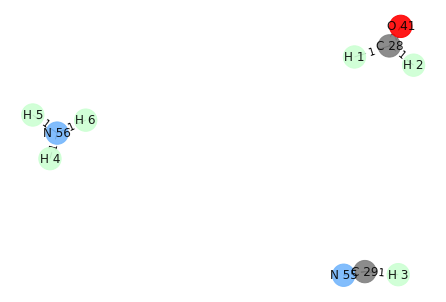

In [9]:

# G = N.copy()
# connected_components = list(nx.connected_components(G))
# mol1 = G.subgraph(connected_components[0])
# mol2 = G.subgraph(connected_components[1])
# mol3 = G.subgraph(connected_components[2])

# G_new = nx.MultiGraph()
# nodes = []
# edges = {}
# for i in [mol1, mol2, mol3]:
#     nodes.extend(nx.nodes(i))
#     edg_data = nx.get_edge_attributes(i, 'number')
#     for i in edg_data:
#         edges[i] = edg_data[i]

# for i in nodes:
#     G_new.add_nodes_from(nodes)
# for i in edges:
#     for j in range(edges[i]):
#         G_new.add_edge(i[0], i[1])
        
# plot_fig(G_new)

In [10]:
# Function that dictates the rules for forming the bonds
# Input 
#     -G_param: Network G that is to be modified.
#     -order: 
# Output
#     -Dictionary with keys as network's connected components and values as their corresponding G values. 

def form_bonds(G_param, order):
    M = G_param.copy()
    M_dict = {}
    max_size = 11 #Maximum allowed size for compounds that forms
    connected_components = list(nx.connected_components(M))
    n = len(connected_components)
    print(n)
    print(connected_components)
    print(connected_components[0])
    print(connected_components[1])
    print(len(connected_components[0]) + len(connected_components[1]))
    
    #A pair of connected components were selected from the graph sequentially
    while n >= 2:
        if (len(connected_components[0]) + len(connected_components[1])) > max_size:
            if len(connected_components[0]) >= len(connected_components[1]):
                connected_components = connected_components[1:]
            else:
                connected_components.pop(1)
        else:
            mol1 = M.subgraph(list(connected_components[0]))
            mol2 = M.subgraph(list(connected_components[1]))

            plot_fig(mol1)
            plot_fig(mol2)
            
            # All the hydrogen atoms in both the connected components were identified
            H_list1 = [i for i in nx.nodes(mol1) if i._name.split()[0] == "H"]
            H_list2 = [i for i in nx.nodes(mol2) if i._name.split()[0] == "H"]

            flag = 1
            flag1 = 1
            flag2 = 1
            if len(H_list1) > 1:
                H_to_be_removed1 = H_list1[random.randint(0, len(H_list1)-1)]
            elif len(H_list1) == 1:
                H_to_be_removed1 = H_list1[0] 
            else:
                #if any of the components didn’t have hydrogen atoms, 
                #it was prevented from being iterated again
                flag1 = 0

            if len(H_list2) > 1:
                H_to_be_removed2 = H_list2[random.randint(0, len(H_list2)-1)]
            elif len(H_list2) == 1:
                H_to_be_removed2 = H_list2[0]
            else:
                #if any of the components didn’t have hydrogen atoms, 
                #it was prevented from being iterated again
                flag2 = 0

            flag = flag1*flag2
            if flag:
                print(H_to_be_removed1)
                print(H_to_be_removed2)
                neighbor1 = [i for i in mol1[H_to_be_removed1]][0]
                neighbor2 = [i for i in mol2[H_to_be_removed2]][0]

                print(neighbor1, neighbor2)
                #The bonds between the (neighbor1, hydro1) and (neighbor2, hydro2) were broken.
                #Bonds between (neighbor1, neighbor2) were created. 
                M.remove_edge(H_to_be_removed1, neighbor1)
                M.remove_edge(H_to_be_removed2, neighbor2)
                M.add_edge(neighbor1, neighbor2)

                fix_valencies(M)
                plot_fig(M.subgraph(list(nx.node_connected_component(M, neighbor1))))
                non_H_nodes = []
                print(nx.node_connected_component(M, neighbor1))
                #Atoms that have neighbors that are not exclusively hydrogen atoms were identified.
                for i in nx.node_connected_component(M, neighbor1):
                    if (i._name.split()[0]!="H"):
                        non_H_nodes.append(i)
                non_H_nodes = list(set(non_H_nodes))

                print(non_H_nodes)
                
                #Edges between the hydro1 atom non_h_neighbor are added in the graph.
                #an edge between non_h_neighbor and one of its initial neighbors (init_neigh)
                #is removed from the graph to satisfy the valency conditions.
                for i in range(len(non_H_nodes)):
                    M_new = M.subgraph(list(nx.node_connected_component(M, neighbor1))).copy()
                    print("i:", i)
                    temp1 = list(M_new[non_H_nodes[i]].keys())
                    temp1 = [i for i in temp1 if i._name.split()[0]!="H"][0]
                    print("Removing edge between:", non_H_nodes[i], temp1)
                    M_new.remove_edge(non_H_nodes[i], temp1)
                    print("Adding edge between:", non_H_nodes[i], H_to_be_removed1)
                    M_new.add_edge(H_to_be_removed1, non_H_nodes[i])
                    fix_valencies(M_new)
                    for node in nx.node_connected_component(M_new, H_to_be_removed1):
                        print(node, node._valency)

                    plot_fig(M_new.subgraph(nx.node_connected_component(M_new, neighbor1)))

                    for j in non_H_nodes:
                        print(j._name, j._valency)
                    second_node = [j for j in non_H_nodes if j._valency!=0]
                    print(second_node, H_to_be_removed2)
                    
                    #A bond between init_neigh and hydro2 is added to the network.
                    M_new.add_edge(H_to_be_removed2, second_node[0])
                    fix_valencies(M_new)
                    plot_fig(M_new.subgraph(nx.node_connected_component(M_new, H_to_be_removed2)))
                    #All new compounds are added to a dictionary as the key and the standard Gibbs free energy value is taken as the value.
                    M_dict[M_new.subgraph(nx.node_connected_component(M_new, neighbor1))] = input_G(M_new.subgraph(nx.node_connected_component(M_new, neighbor1)))

                connected_components = connected_components[2:]
                print(connected_components)
                n = len(connected_components)
            else:
                connected_components = connected_components[1:]
                print(connected_components)
                n = len(connected_components)

    return M_dict

In [11]:
#Performing bond formations using simulated annealing

def simulated_annealing_bonds(G, order=[]):
    connected_components = list(nx.connected_components(G))
    num_components = len(connected_components)
        
    # randomly permute the order in which the compounds react
    if order == []:
        order = np.random.permutation(num_components)
    else:
        order = np.random.permutation(order)
    
    dict_vals = form_bonds(G, order)
    
    return dict_vals

15
[{C 28, H 2, O 41, H 1}, {H 3, C 29, N 55}, {N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]
{C 28, H 2, O 41, H 1}
{H 3, C 29, N 55}
7


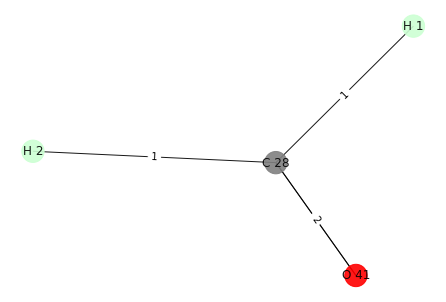

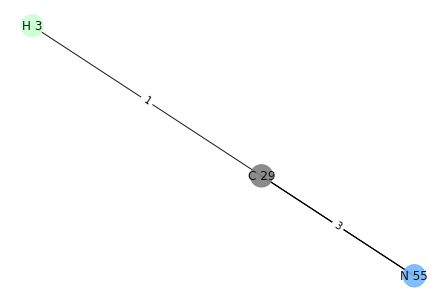

H 1
H 3
C 28 C 29


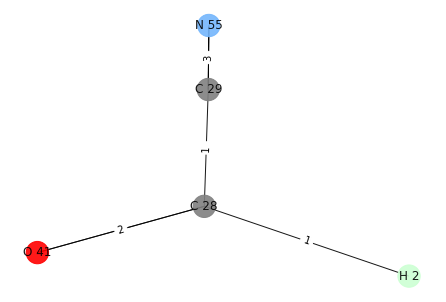

{C 28, C 29, H 2, O 41, N 55}
[C 28, O 41, C 29, N 55]
i: 0
Removing edge between: C 28 O 41
Adding edge between: C 28 H 1
C 28 0
H 1 0
C 29 0
H 2 0
O 41 1
N 55 0


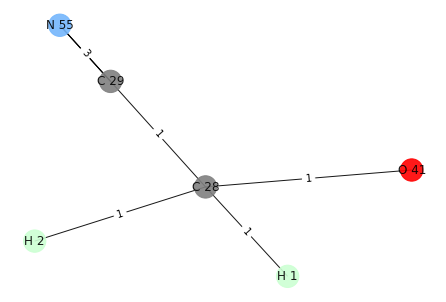

C 28 0
O 41 1
C 29 0
N 55 0
[O 41] H 3


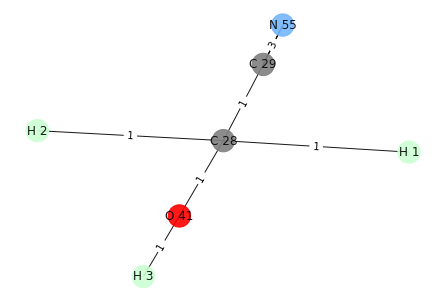

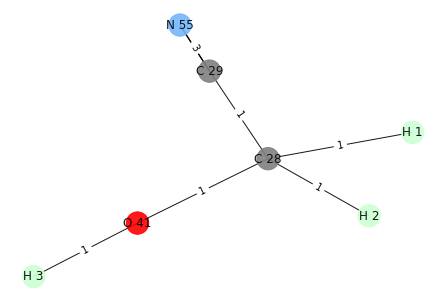

Enter G value of [C 28, H 1, C 29, H 2, O 41, N 55, H 3]: -261.5047571
i: 1
Removing edge between: O 41 C 28
Adding edge between: O 41 H 1
C 28 1
H 1 0
C 29 0
H 2 0
O 41 0
N 55 0


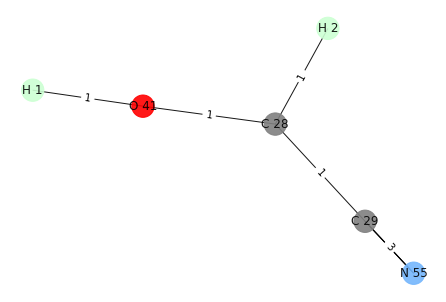

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


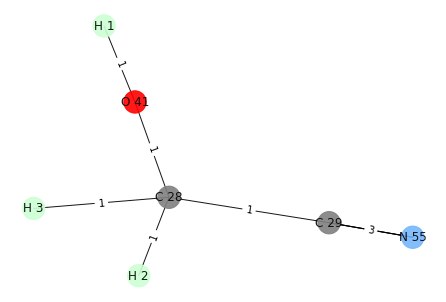

i: 2
Removing edge between: C 29 C 28
Adding edge between: C 29 H 1
H 1 0
C 29 0
N 55 0


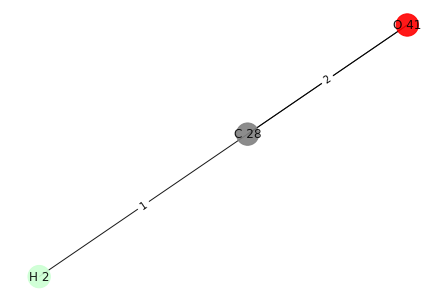

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


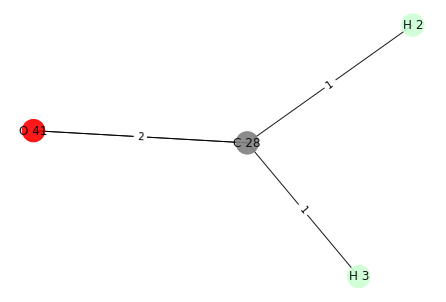

i: 3
Removing edge between: N 55 C 29
Adding edge between: N 55 H 1
C 28 0
H 1 0
C 29 1
O 41 0
H 2 0
N 55 0


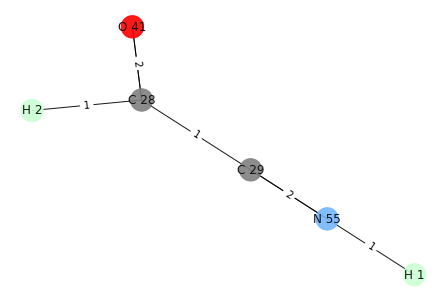

C 28 0
O 41 0
C 29 1
N 55 0
[C 29] H 3


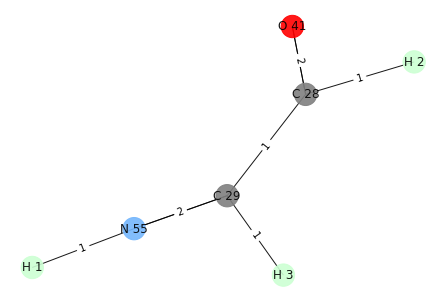

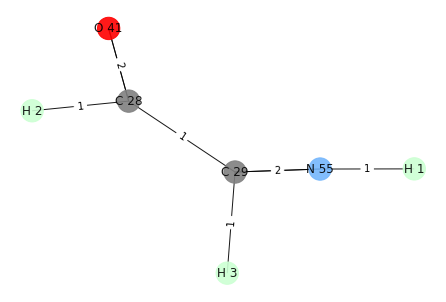

Enter G value of [C 28, C 29, H 1, H 2, O 41, N 55, H 3]: -100
[{N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


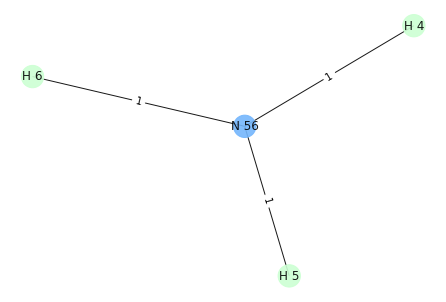

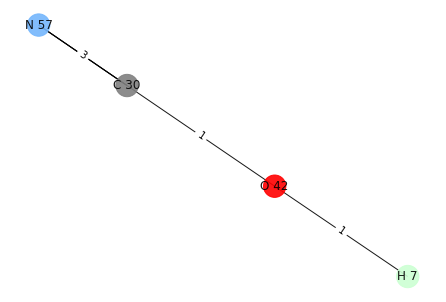

H 4
H 7
N 56 O 42


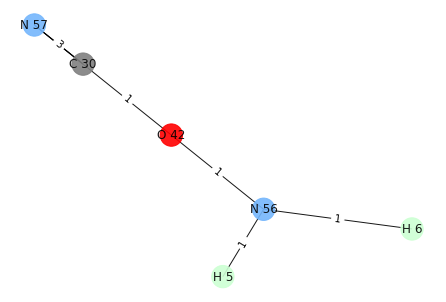

{H 6, O 42, C 30, H 5, N 56, N 57}
[O 42, N 56, C 30, N 57]
i: 0
Removing edge between: O 42 C 30
Adding edge between: O 42 H 4
H 6 0
O 42 0
H 4 0
H 5 0
N 56 0


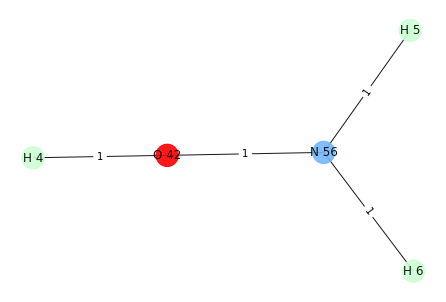

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


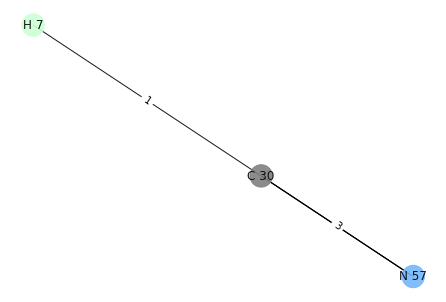

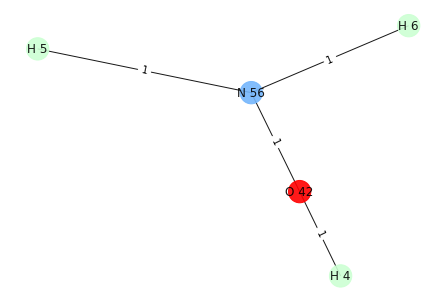

Enter G value of [H 6, O 42, H 4, H 5, N 56]: -215.860156
i: 1
Removing edge between: N 56 O 42
Adding edge between: N 56 H 4
N 56 0
H 6 0
H 4 0
H 5 0


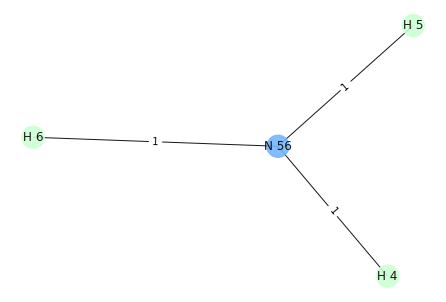

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


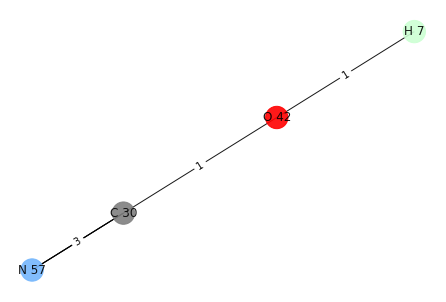

i: 2
Removing edge between: C 30 O 42
Adding edge between: C 30 H 4
N 57 0
C 30 0
H 4 0


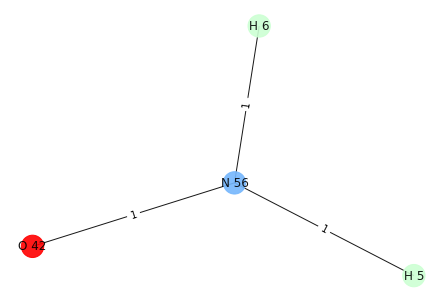

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


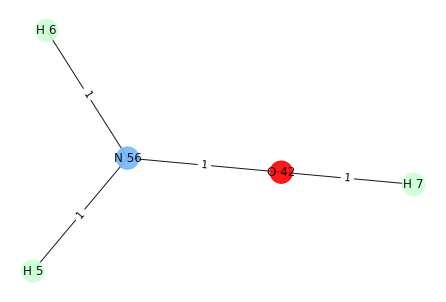

i: 3
Removing edge between: N 57 C 30
Adding edge between: N 57 H 4
H 6 0
O 42 0
H 4 0
C 30 1
H 5 0
N 57 0
N 56 0


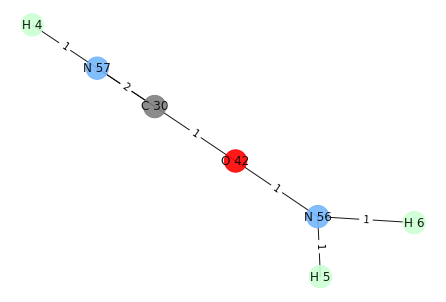

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


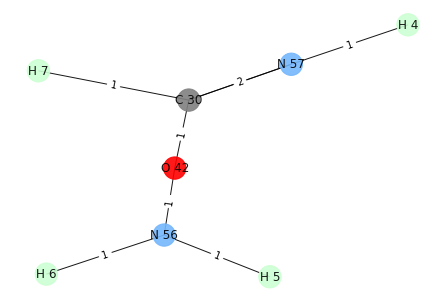

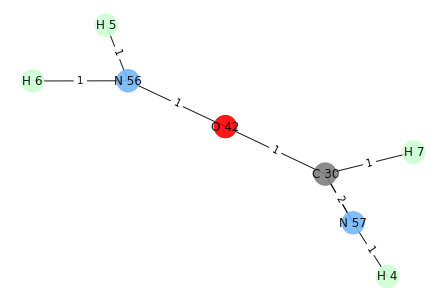

Enter G value of [H 6, O 42, H 7, H 4, H 5, C 30, N 56, N 57]: 100
[{H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


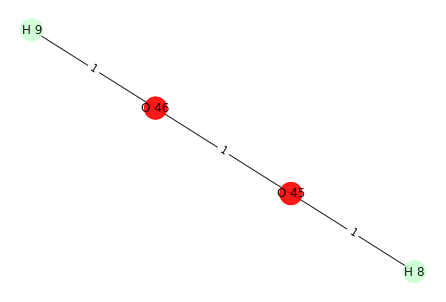

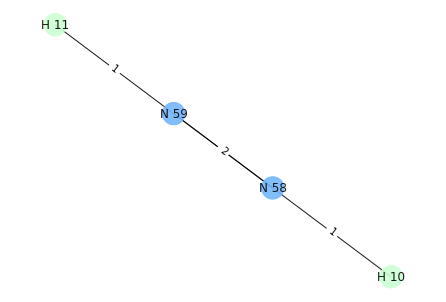

H 8
H 10
O 45 N 58


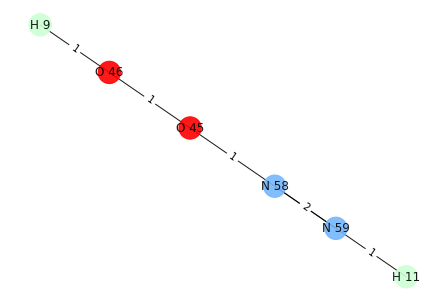

{O 45, H 11, N 58, O 46, N 59, H 9}
[O 45, N 59, O 46, N 58]
i: 0
Removing edge between: O 45 O 46
Adding edge between: O 45 H 8
O 45 0
H 11 0
N 58 0
H 8 0
N 59 0


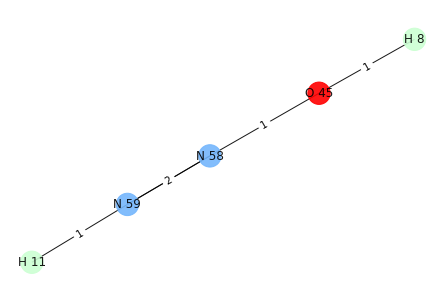

O 45 0
N 59 0
O 46 1
N 58 0
[O 46] H 10


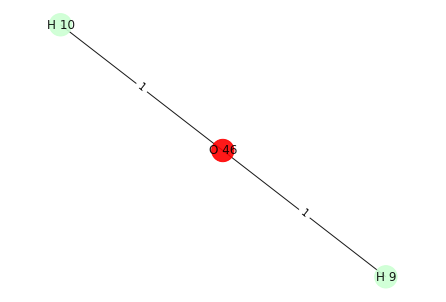

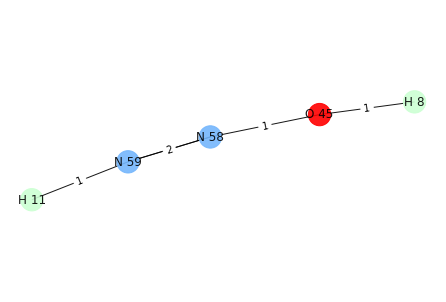

Enter G value of [O 45, H 11, N 58, H 8, N 59]: -100
i: 1
Removing edge between: N 59 N 58
Adding edge between: N 59 H 8
O 45 0
H 11 0
N 58 1
O 46 0
H 8 0
N 59 0
H 9 0


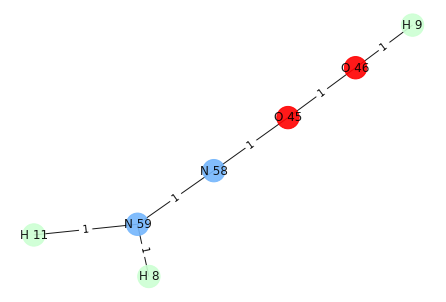

O 45 0
N 59 0
O 46 0
N 58 1
[N 58] H 10


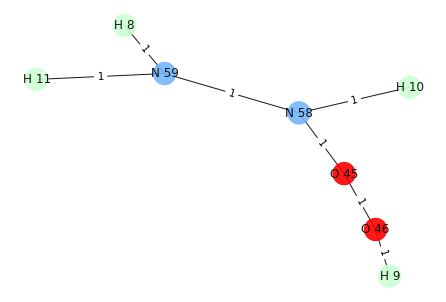

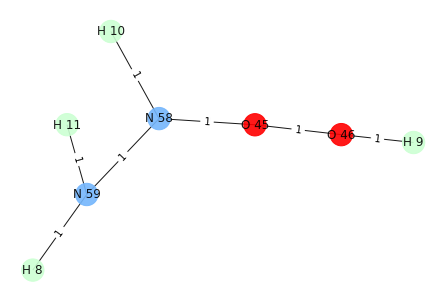

Enter G value of [O 45, H 11, N 58, O 46, H 8, N 59, H 9, H 10]: -67.33
i: 2
Removing edge between: O 46 O 45
Adding edge between: O 46 H 8
H 8 0
H 9 0
O 46 0


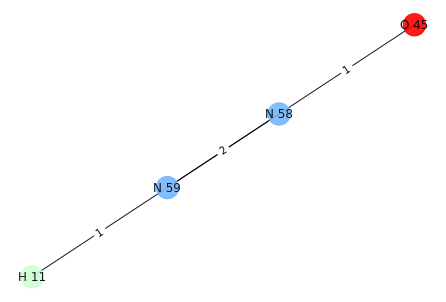

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 10


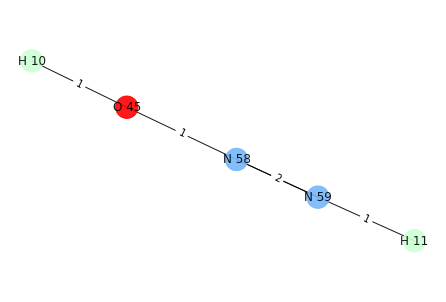

i: 3
Removing edge between: N 58 O 45
Adding edge between: N 58 H 8
H 8 0
H 11 0
N 59 0
N 58 0


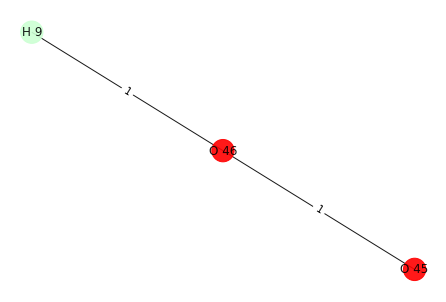

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 10


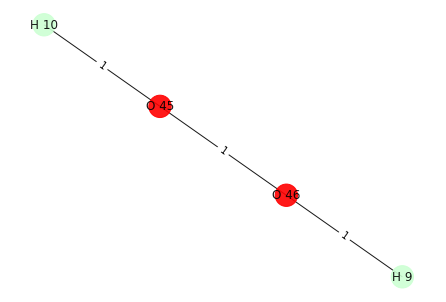

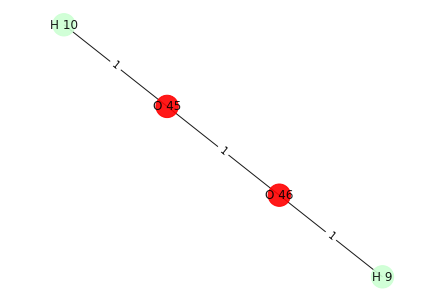

Enter G value of [O 45, H 9, O 46, H 10]: -309.19
[{N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


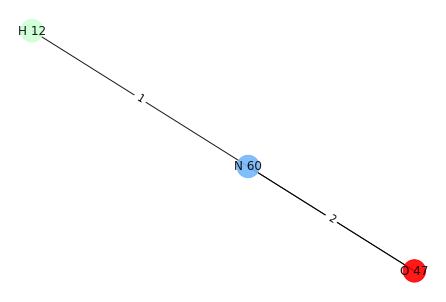

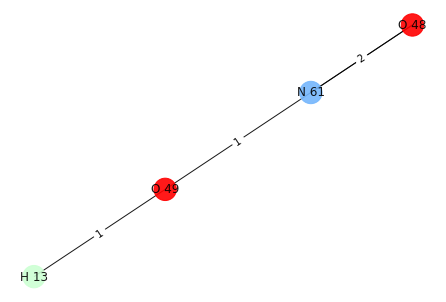

H 12
H 13
N 60 O 49


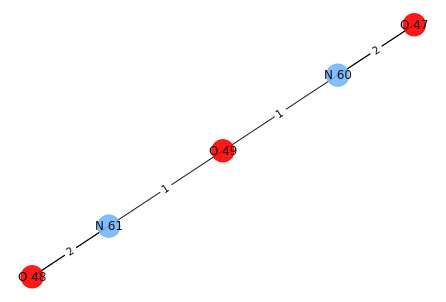

{N 60, O 49, N 61, O 47, O 48}
[N 60, O 49, N 61, O 47, O 48]
i: 0
Removing edge between: N 60 O 47
Adding edge between: N 60 H 12
N 60 0
O 49 0
N 61 0
H 12 0
O 47 1
O 48 0


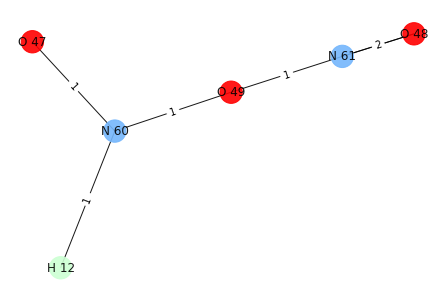

N 60 0
O 49 0
N 61 0
O 47 1
O 48 0
[O 47] H 13


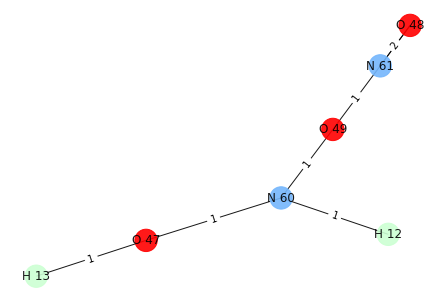

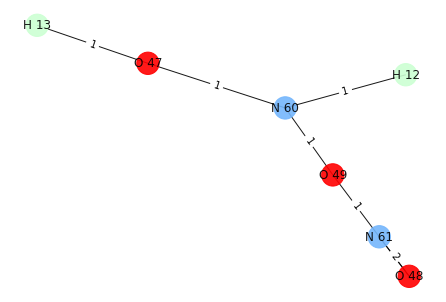

Enter G value of [N 60, O 49, N 61, H 12, H 13, O 47, O 48]: 100
i: 1
Removing edge between: O 49 N 60
Adding edge between: O 49 H 12
N 61 0
O 49 0
H 12 0
O 48 0


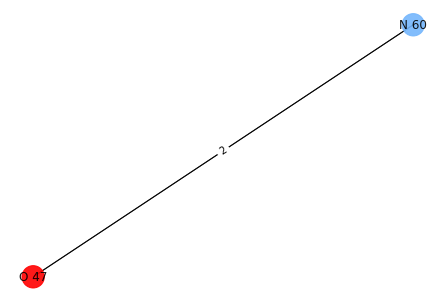

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


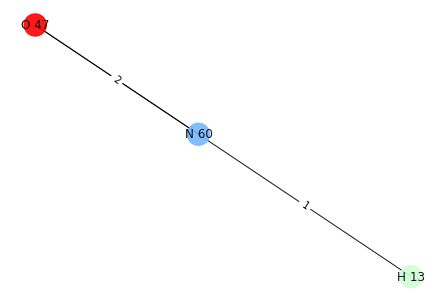

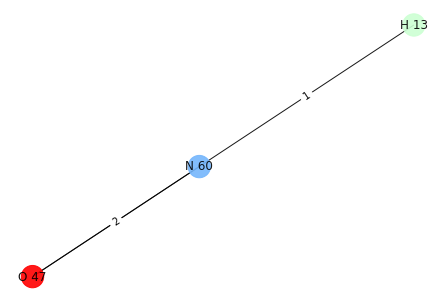

Enter G value of [N 60, O 47, H 13]: -55.64
i: 2
Removing edge between: N 61 O 49
Adding edge between: N 61 H 12
N 61 0
H 12 0
O 48 0


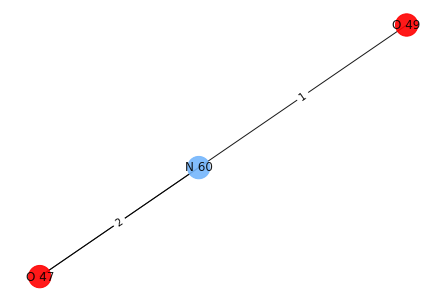

N 60 0
O 49 1
N 61 0
O 47 0
O 48 0
[O 49] H 13


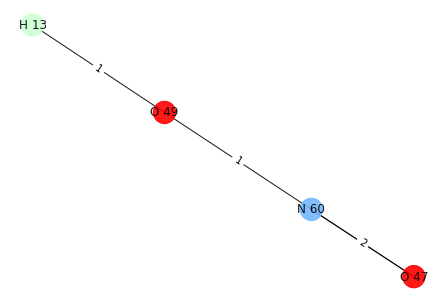

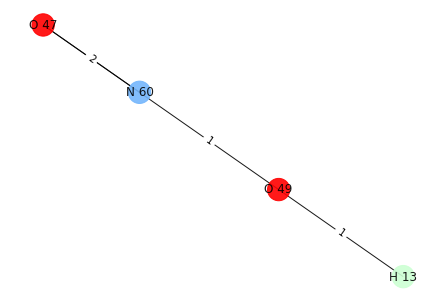

Enter G value of [N 60, O 49, O 47, H 13]: -266.66
i: 3
Removing edge between: O 47 N 60
Adding edge between: O 47 H 12
N 60 1
O 49 0
N 61 0
H 12 0
O 47 0
O 48 0


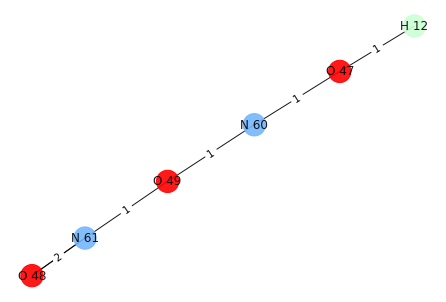

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


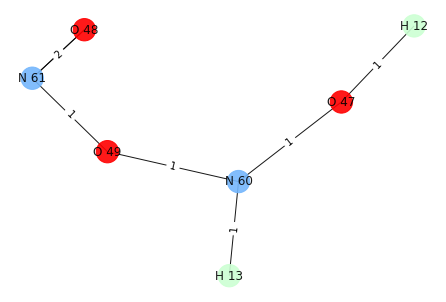

i: 4
Removing edge between: O 48 N 61
Adding edge between: O 48 H 12
N 60 0
O 49 0
N 61 1
H 12 0
O 47 0
O 48 0


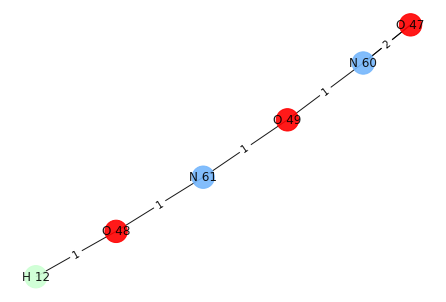

N 60 0
O 49 0
N 61 1
O 47 0
O 48 0
[N 61] H 13


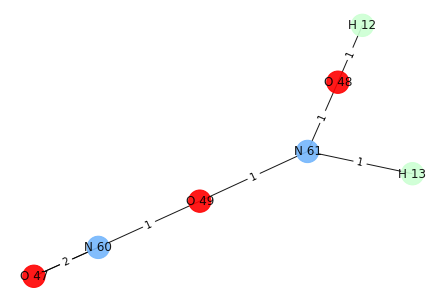

[{O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


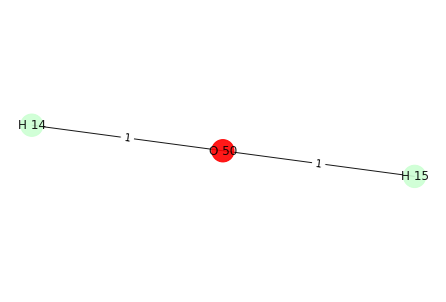

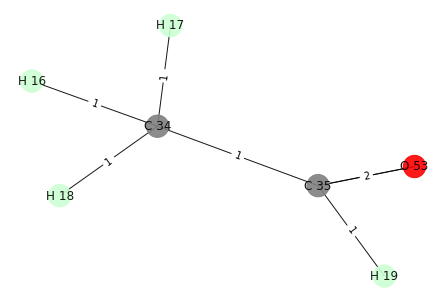

H 15
H 16
O 50 C 34


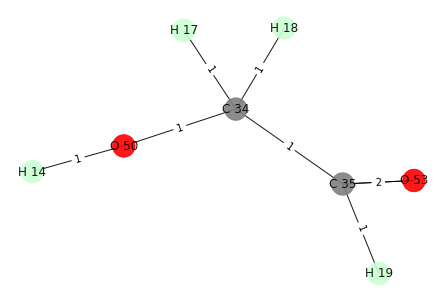

{O 53, H 19, O 50, C 34, H 18, C 35, H 17, H 14}
[O 53, C 34, C 35, O 50]
i: 0
Removing edge between: O 53 C 35
Adding edge between: O 53 H 15
O 53 0
H 19 0
H 15 0
H 14 0
C 34 0
O 50 0
C 35 1
H 17 0
H 18 0


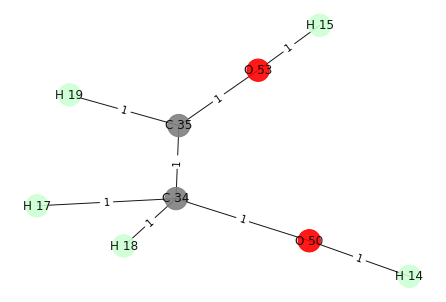

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 16


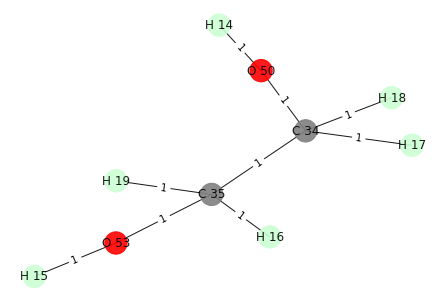

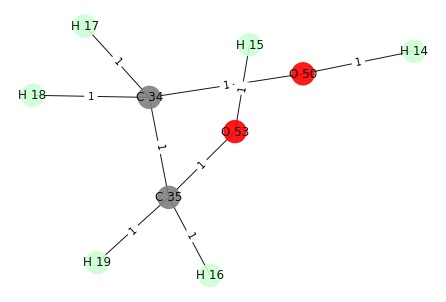

Enter G value of [O 53, H 19, H 15, H 14, C 34, O 50, H 16, C 35, H 17, H 18]: -35.4373805
i: 1
Removing edge between: C 34 C 35
Adding edge between: C 34 H 15
H 15 0
H 14 0
C 34 0
O 50 0
H 17 0
H 18 0


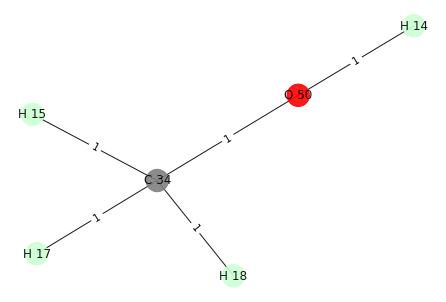

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 16


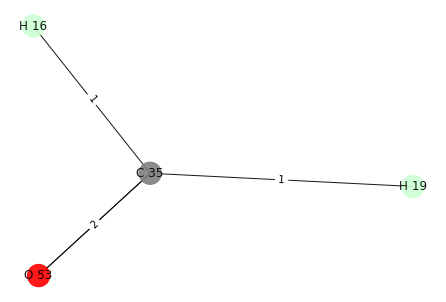

i: 2
Removing edge between: C 35 O 53
Adding edge between: C 35 H 15
O 53 1
H 19 0
H 15 0
H 14 0
C 34 0
O 50 0
C 35 0
H 17 0
H 18 0


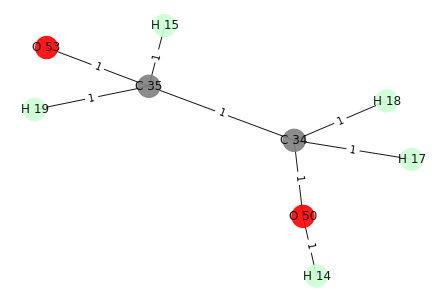

O 53 1
C 34 0
C 35 0
O 50 0
[O 53] H 16


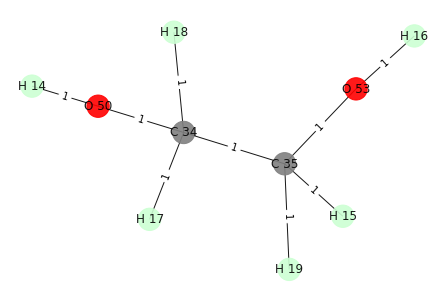

i: 3
Removing edge between: O 50 C 34
Adding edge between: O 50 H 15
O 50 0
H 15 0
H 14 0


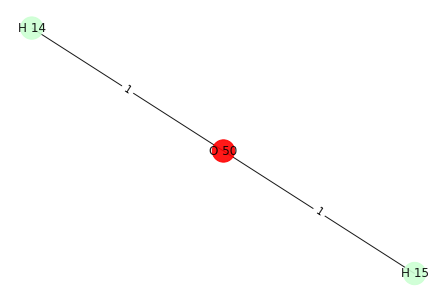

O 53 0
C 34 1
C 35 0
O 50 0
[C 34] H 16


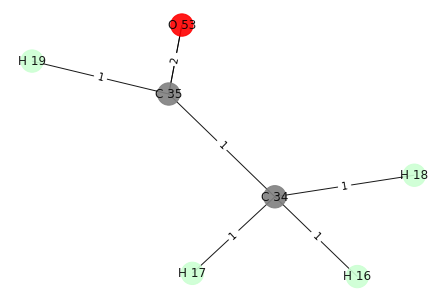

[{H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


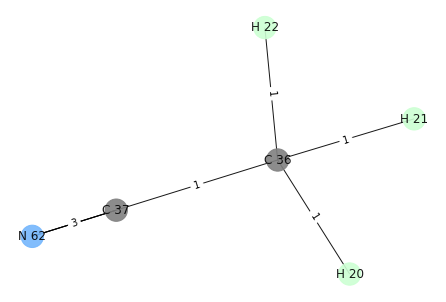

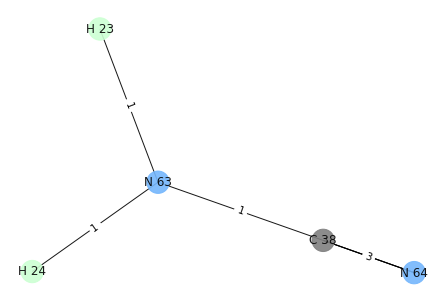

H 21
H 24
C 36 N 63


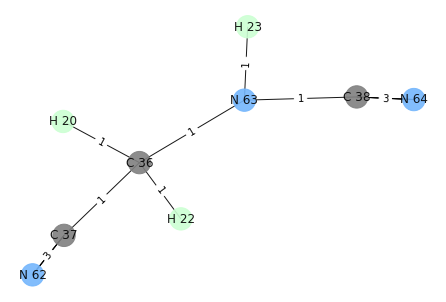

{N 63, C 38, H 23, H 20, C 37, N 62, N 64, C 36, H 22}
[C 38, C 37, N 62, N 63, C 36, N 64]
i: 0
Removing edge between: C 38 N 63
Adding edge between: C 38 H 21
N 64 0
H 21 0
C 38 0


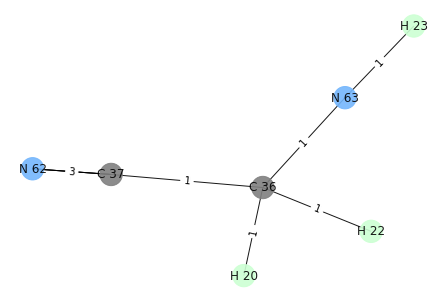

C 38 0
C 37 0
N 62 0
N 63 1
C 36 0
N 64 0
[N 63] H 24


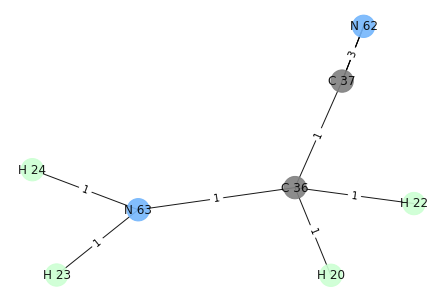

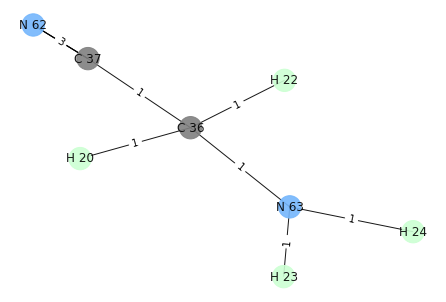

Enter G value of [H 23, H 24, H 20, C 37, N 62, N 63, C 36, H 22]: 1.575047801
i: 1
Removing edge between: C 37 C 36
Adding edge between: C 37 H 21
C 37 0
H 21 0
N 62 0


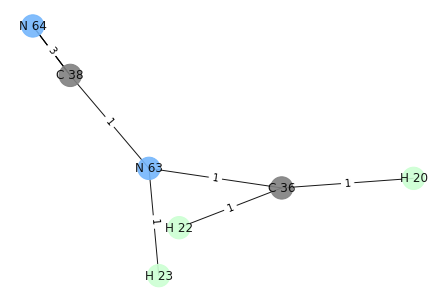

C 38 0
C 37 0
N 62 0
N 63 0
C 36 1
N 64 0
[C 36] H 24


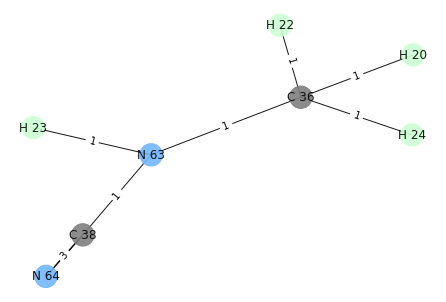

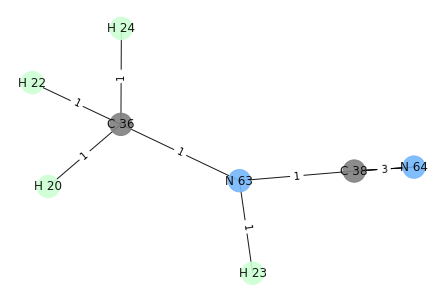

Enter G value of [H 23, C 38, H 20, H 24, N 64, N 63, C 36, H 22]: -100
i: 2
Removing edge between: N 62 C 37
Adding edge between: N 62 H 21
N 63 0
H 23 0
C 38 0
H 20 0
C 37 1
N 62 0
N 64 0
H 21 0
C 36 0
H 22 0


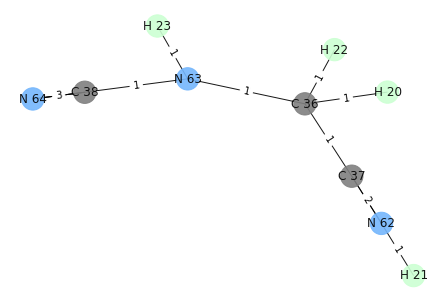

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


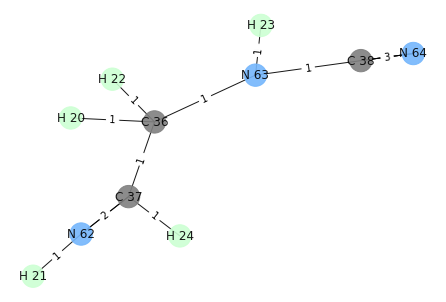

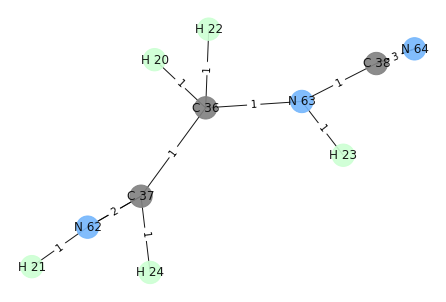

Enter G value of [H 23, C 38, H 20, H 24, C 37, N 62, N 64, H 21, N 63, C 36, H 22]: -56.82
i: 3
Removing edge between: N 63 C 38
Adding edge between: N 63 H 21
H 23 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
H 22 0


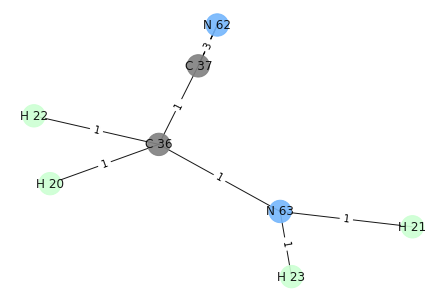

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


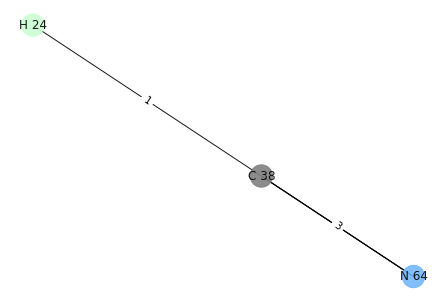

i: 4
Removing edge between: C 36 C 37
Adding edge between: C 36 H 21
N 63 0
H 23 0
C 38 0
H 20 0
N 64 0
H 21 0
C 36 0
H 22 0


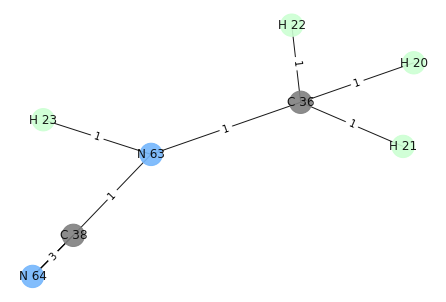

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


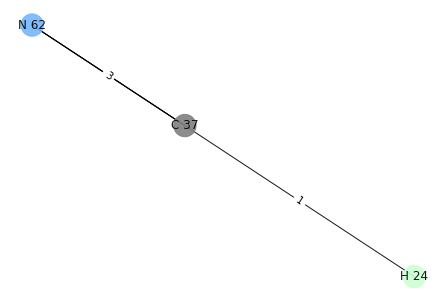

i: 5
Removing edge between: N 64 C 38
Adding edge between: N 64 H 21
C 38 1
H 23 0
H 22 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
N 64 0


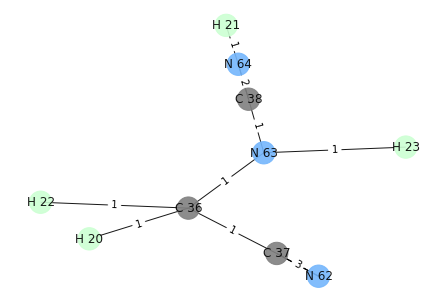

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


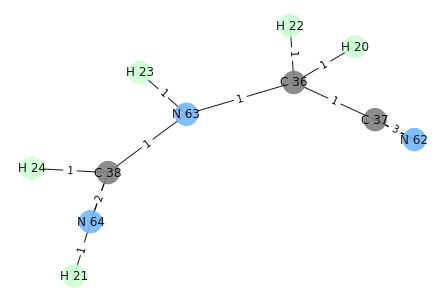

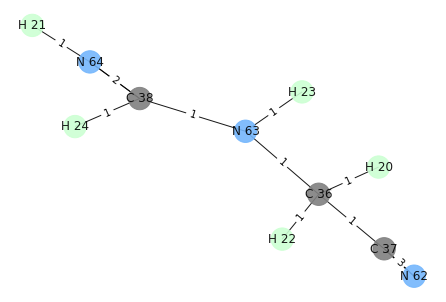

Enter G value of [H 23, C 38, H 20, H 24, C 37, N 62, N 64, H 21, N 63, C 36, H 22]: -100
[{H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


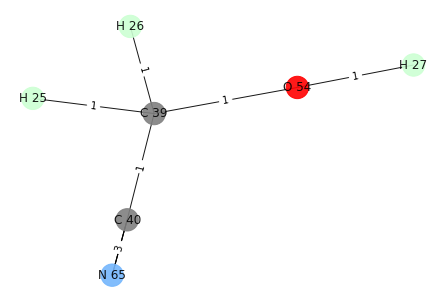

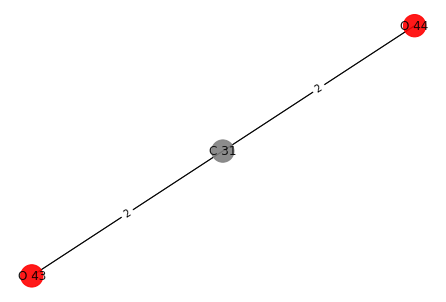

[{O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


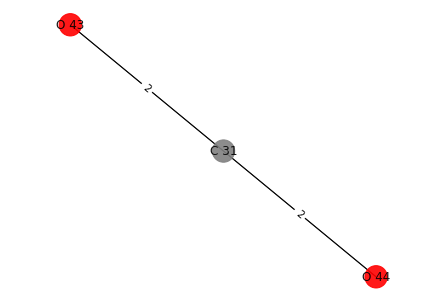

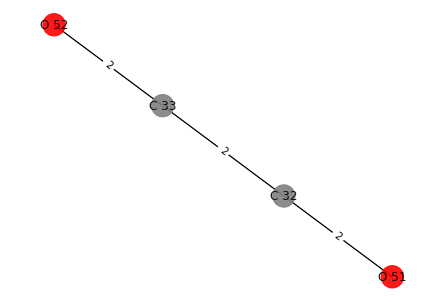

[{C 32, C 33, O 51, O 52}]
15
[{C 28, H 2, O 41, H 1}, {H 3, C 29, N 55}, {N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]
{C 28, H 2, O 41, H 1}
{H 3, C 29, N 55}
7


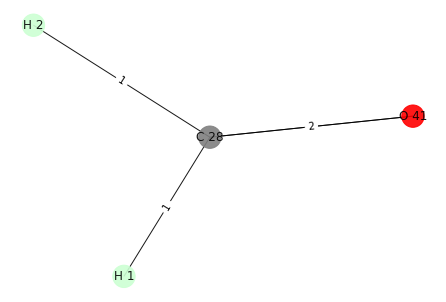

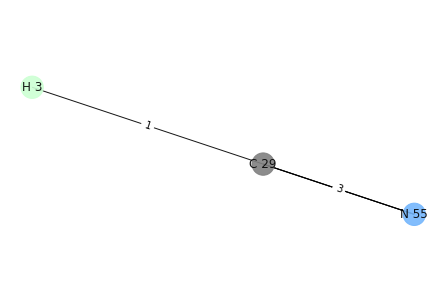

H 1
H 3
C 28 C 29


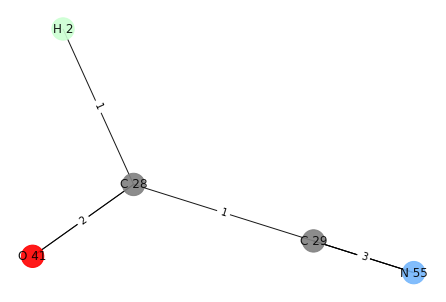

{C 28, C 29, H 2, O 41, N 55}
[C 28, O 41, C 29, N 55]
i: 0
Removing edge between: C 28 O 41
Adding edge between: C 28 H 1
C 28 0
H 1 0
C 29 0
H 2 0
O 41 1
N 55 0


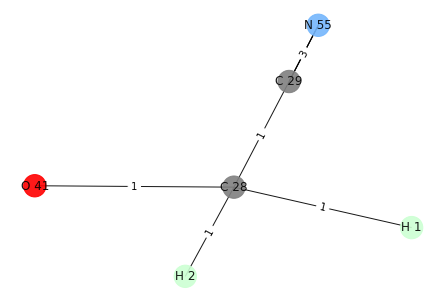

C 28 0
O 41 1
C 29 0
N 55 0
[O 41] H 3


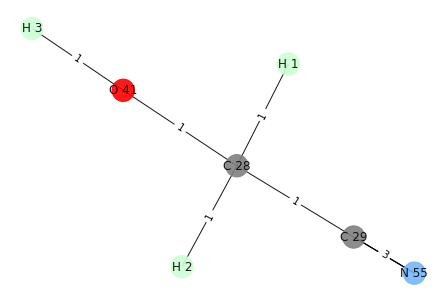

i: 1
Removing edge between: O 41 C 28
Adding edge between: O 41 H 1
C 28 1
H 1 0
C 29 0
H 2 0
O 41 0
N 55 0


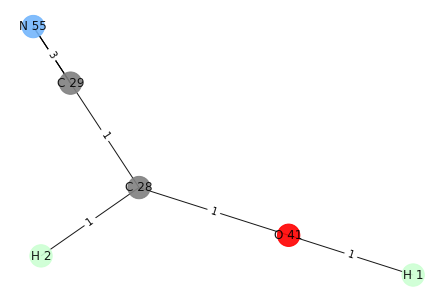

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


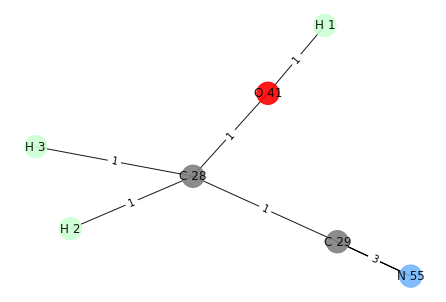

i: 2
Removing edge between: C 29 C 28
Adding edge between: C 29 H 1
H 1 0
C 29 0
N 55 0


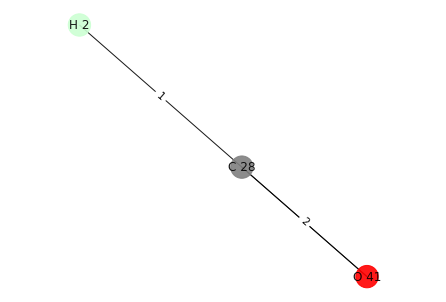

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


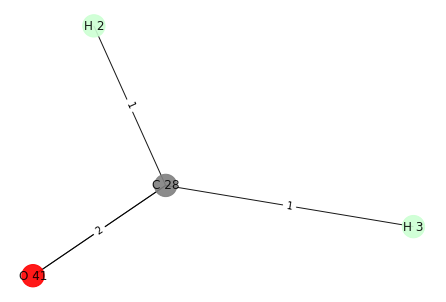

i: 3
Removing edge between: N 55 C 29
Adding edge between: N 55 H 1
C 28 0
H 1 0
C 29 1
O 41 0
H 2 0
N 55 0


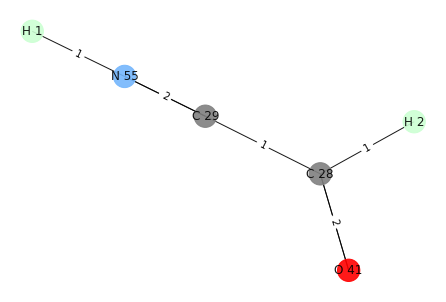

C 28 0
O 41 0
C 29 1
N 55 0
[C 29] H 3


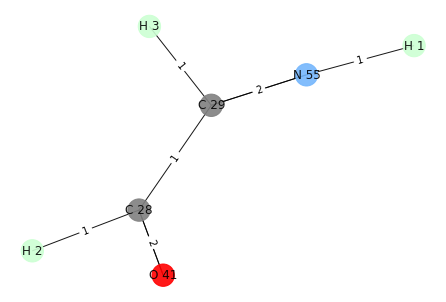

[{N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


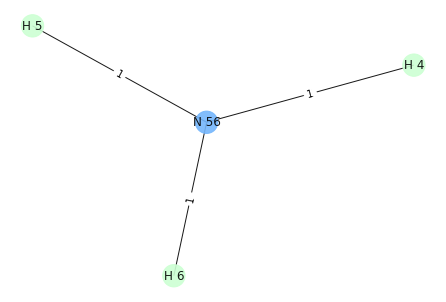

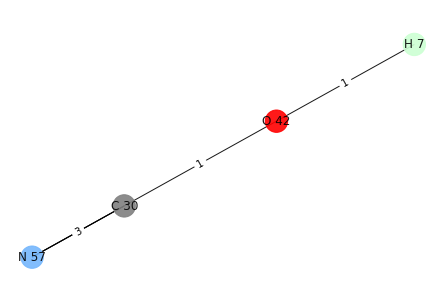

H 6
H 7
N 56 O 42


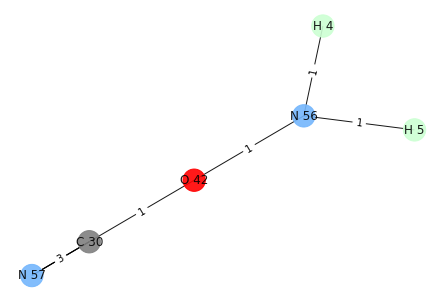

{O 42, H 4, C 30, H 5, N 56, N 57}
[O 42, N 56, C 30, N 57]
i: 0
Removing edge between: O 42 C 30
Adding edge between: O 42 H 6
H 6 0
O 42 0
H 4 0
H 5 0
N 56 0


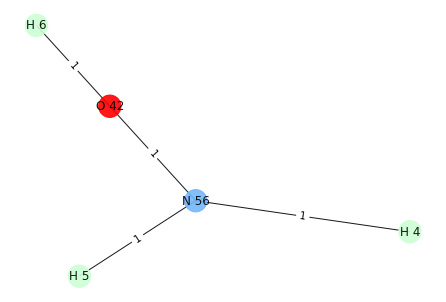

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


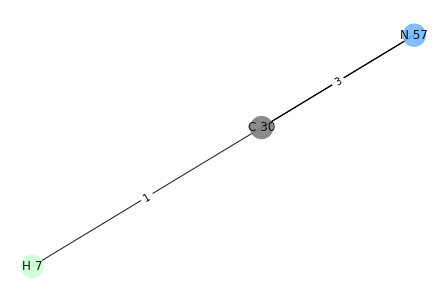

i: 1
Removing edge between: N 56 O 42
Adding edge between: N 56 H 6
H 6 0
N 56 0
H 4 0
H 5 0


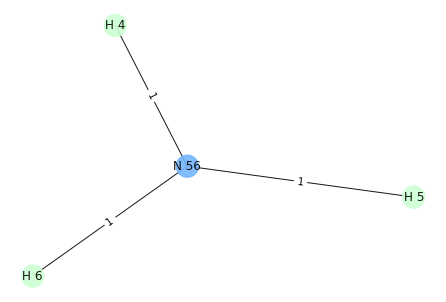

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


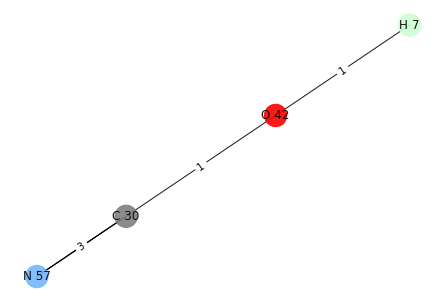

i: 2
Removing edge between: C 30 O 42
Adding edge between: C 30 H 6
H 6 0
C 30 0
N 57 0


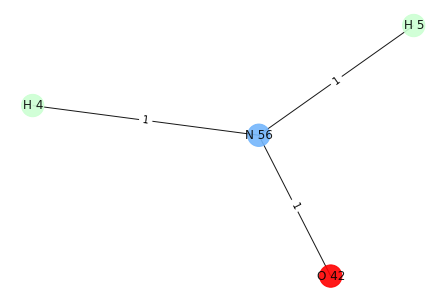

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


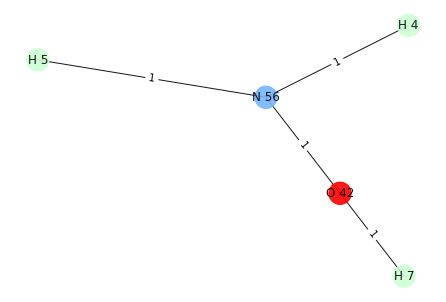

i: 3
Removing edge between: N 57 C 30
Adding edge between: N 57 H 6
H 6 0
O 42 0
H 4 0
C 30 1
H 5 0
N 56 0
N 57 0


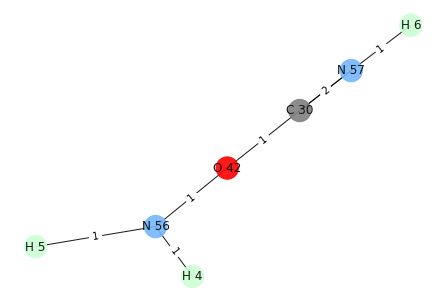

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


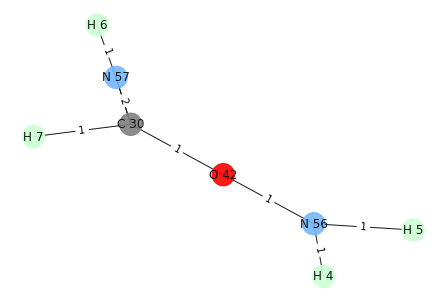

[{H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


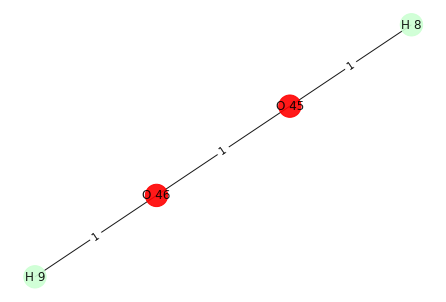

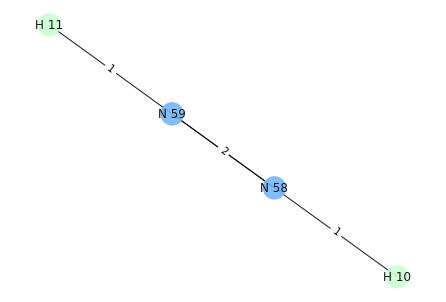

H 9
H 10
O 46 N 58


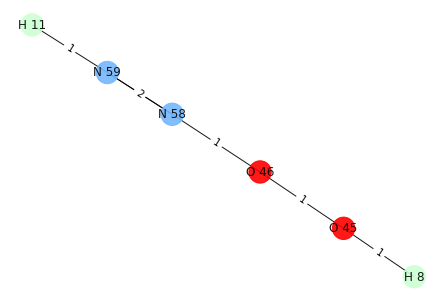

{O 45, H 11, N 58, O 46, H 8, N 59}
[O 45, N 59, O 46, N 58]
i: 0
Removing edge between: O 45 O 46
Adding edge between: O 45 H 9
H 9 0
H 8 0
O 45 0


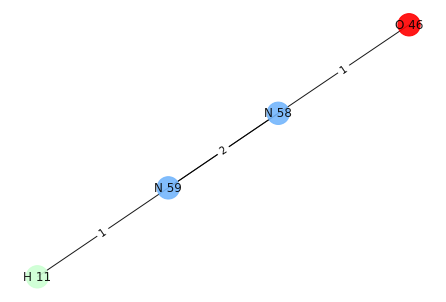

O 45 0
N 59 0
O 46 1
N 58 0
[O 46] H 10


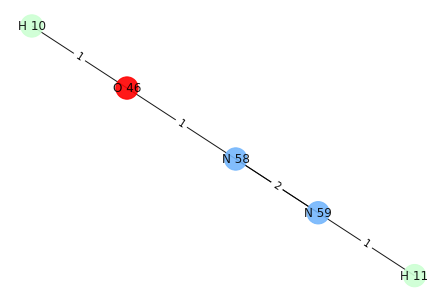

i: 1
Removing edge between: N 59 N 58
Adding edge between: N 59 H 9
O 45 0
H 11 0
N 58 1
O 46 0
H 8 0
N 59 0
H 9 0


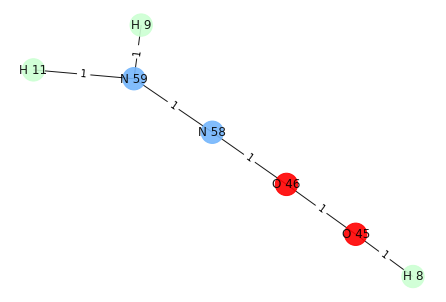

O 45 0
N 59 0
O 46 0
N 58 1
[N 58] H 10


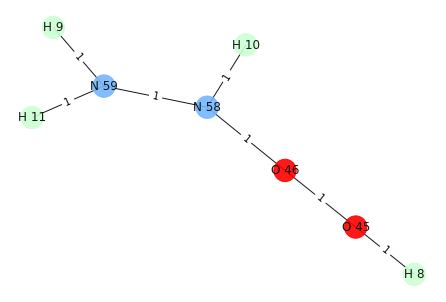

i: 2
Removing edge between: O 46 O 45
Adding edge between: O 46 H 9
H 11 0
N 58 0
O 46 0
N 59 0
H 9 0


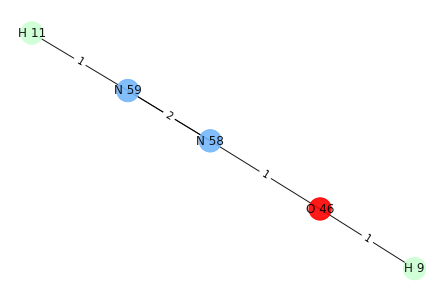

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 10


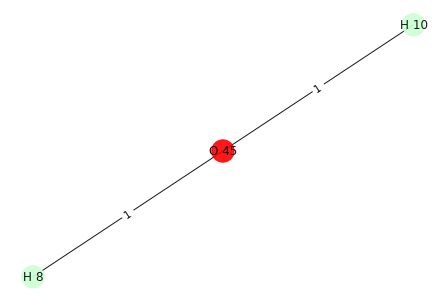

i: 3
Removing edge between: N 58 N 59
Adding edge between: N 58 H 9
O 45 0
H 11 0
N 58 0
O 46 0
H 8 0
N 59 1
H 9 0


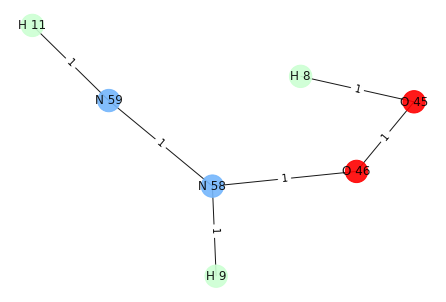

O 45 0
N 59 1
O 46 0
N 58 0
[N 59] H 10


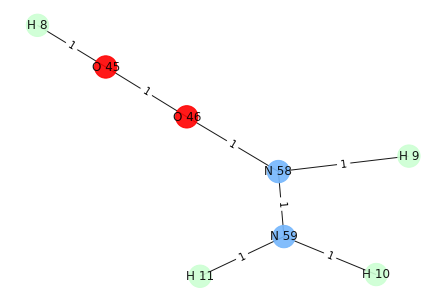

[{N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


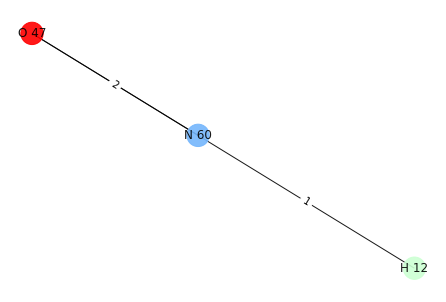

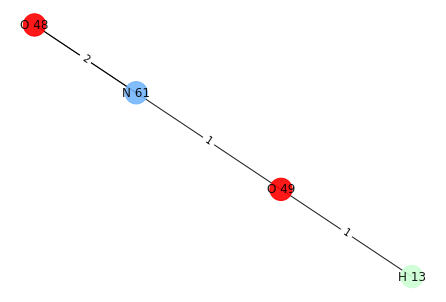

H 12
H 13
N 60 O 49


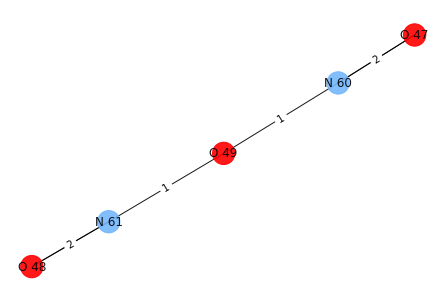

{N 60, O 49, N 61, O 47, O 48}
[N 60, O 49, N 61, O 47, O 48]
i: 0
Removing edge between: N 60 O 47
Adding edge between: N 60 H 12
N 60 0
O 49 0
N 61 0
H 12 0
O 47 1
O 48 0


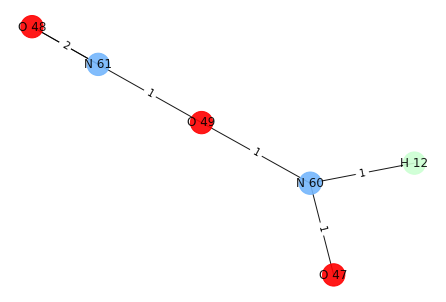

N 60 0
O 49 0
N 61 0
O 47 1
O 48 0
[O 47] H 13


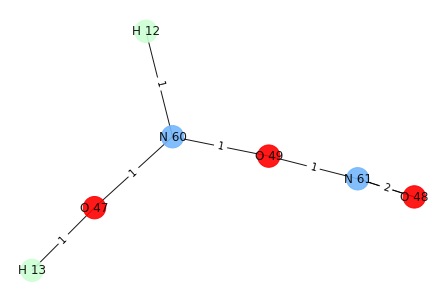

i: 1
Removing edge between: O 49 N 60
Adding edge between: O 49 H 12
N 61 0
O 49 0
H 12 0
O 48 0


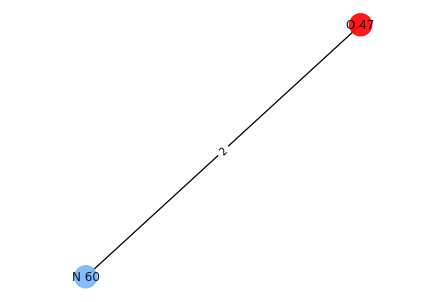

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


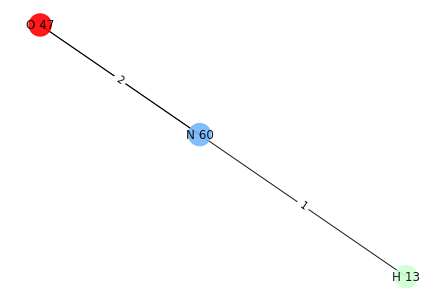

i: 2
Removing edge between: N 61 O 49
Adding edge between: N 61 H 12
N 61 0
H 12 0
O 48 0


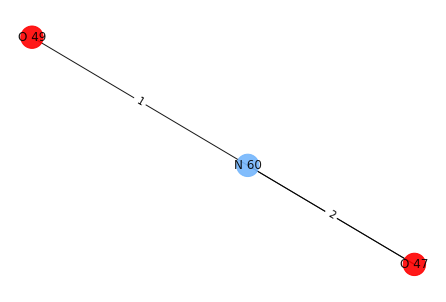

N 60 0
O 49 1
N 61 0
O 47 0
O 48 0
[O 49] H 13


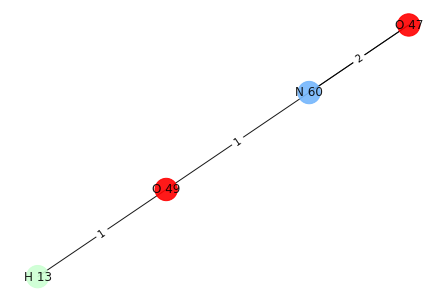

i: 3
Removing edge between: O 47 N 60
Adding edge between: O 47 H 12
N 60 1
O 49 0
N 61 0
H 12 0
O 47 0
O 48 0


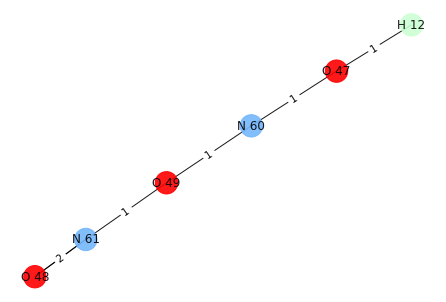

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


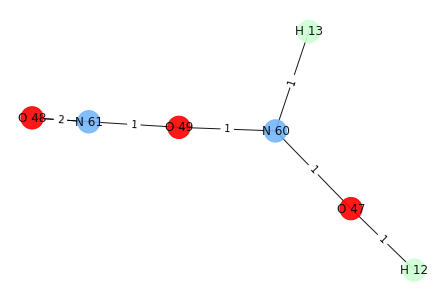

i: 4
Removing edge between: O 48 N 61
Adding edge between: O 48 H 12
N 60 0
O 49 0
N 61 1
H 12 0
O 47 0
O 48 0


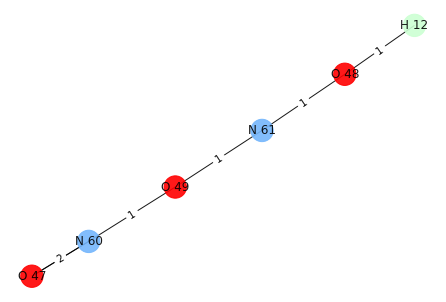

N 60 0
O 49 0
N 61 1
O 47 0
O 48 0
[N 61] H 13


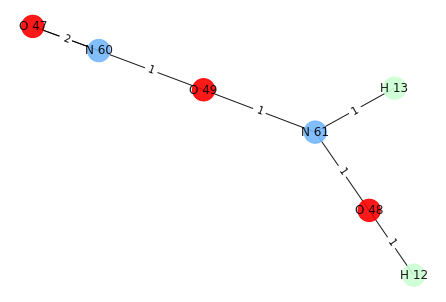

[{O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


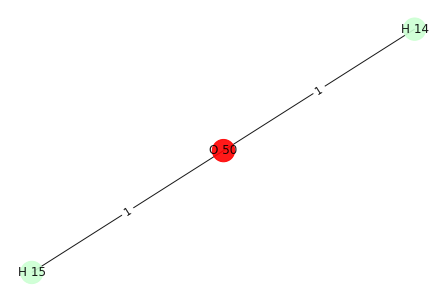

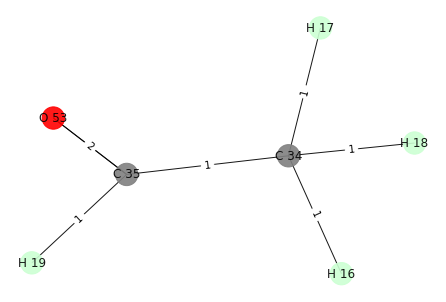

H 14
H 19
O 50 C 35


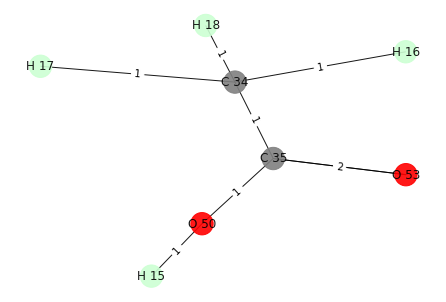

{O 53, H 15, O 50, C 34, H 16, C 35, H 17, H 18}
[O 53, C 34, C 35, O 50]
i: 0
Removing edge between: O 53 C 35
Adding edge between: O 53 H 14
O 53 0
H 15 0
O 50 0
C 34 0
H 18 0
H 16 0
C 35 1
H 17 0
H 14 0


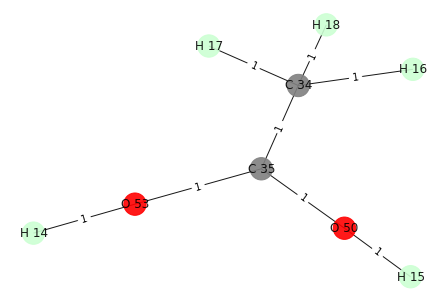

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 19


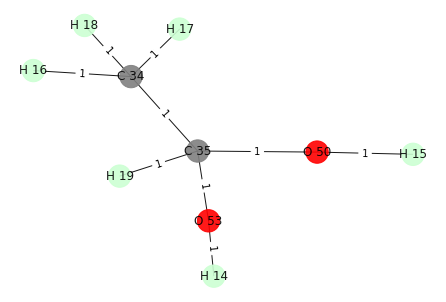

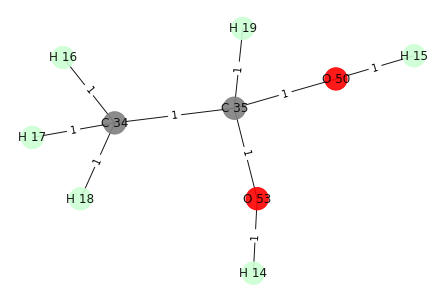

Enter G value of [O 53, H 19, H 15, C 34, O 50, H 18, H 16, C 35, H 17, H 14]: -683.038
i: 1
Removing edge between: C 34 C 35
Adding edge between: C 34 H 14
H 14 0
C 34 0
H 16 0
H 17 0
H 18 0


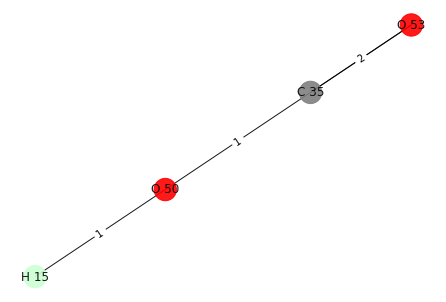

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 19


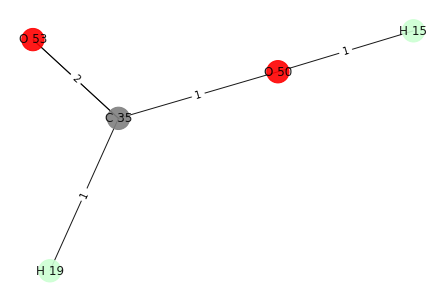

i: 2
Removing edge between: C 35 O 53
Adding edge between: C 35 H 14
O 53 1
H 15 0
C 34 0
O 50 0
H 18 0
H 16 0
C 35 0
H 17 0
H 14 0


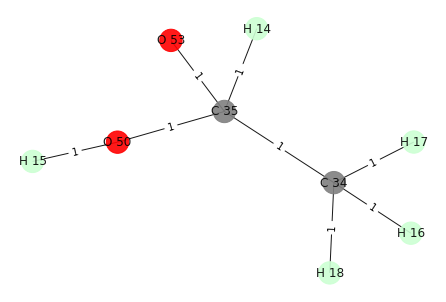

O 53 1
C 34 0
C 35 0
O 50 0
[O 53] H 19


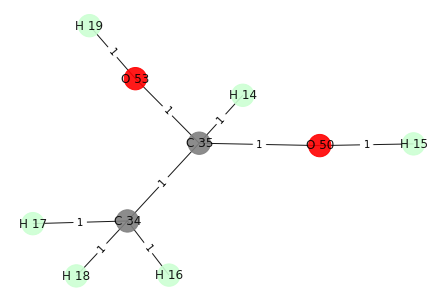

i: 3
Removing edge between: O 50 C 35
Adding edge between: O 50 H 14
O 50 0
H 14 0
H 15 0


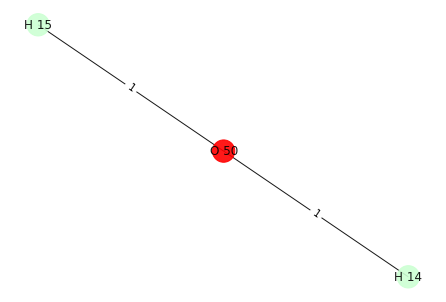

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 19


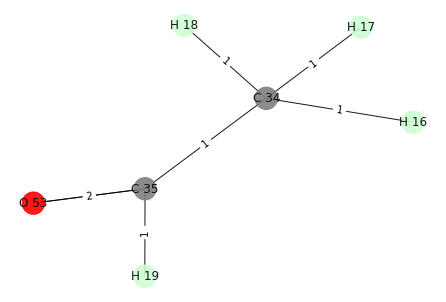

[{H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


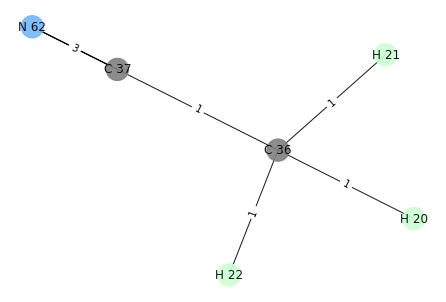

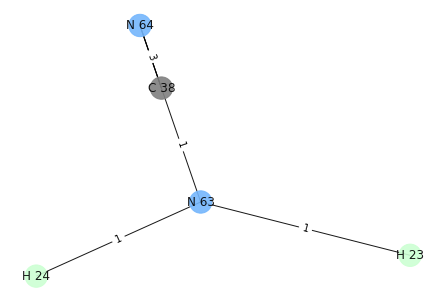

H 22
H 24
C 36 N 63


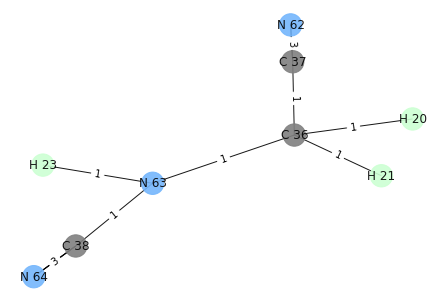

{N 63, C 38, H 23, H 20, C 37, N 62, H 21, C 36, N 64}
[C 38, C 37, N 62, N 63, C 36, N 64]
i: 0
Removing edge between: C 38 N 63
Adding edge between: C 38 H 22
N 64 0
H 22 0
C 38 0


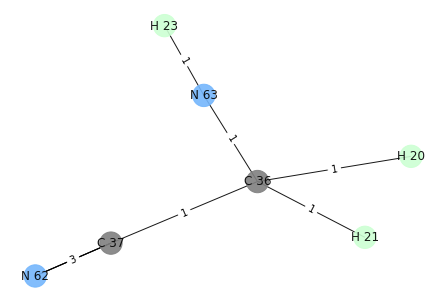

C 38 0
C 37 0
N 62 0
N 63 1
C 36 0
N 64 0
[N 63] H 24


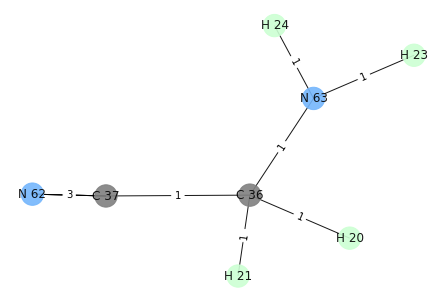

i: 1
Removing edge between: C 37 C 36
Adding edge between: C 37 H 22
C 37 0
H 22 0
N 62 0


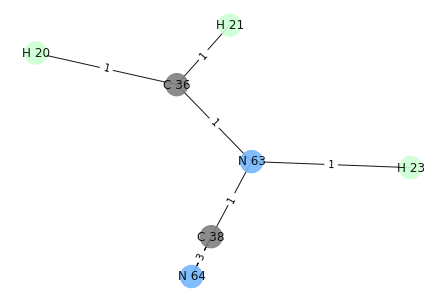

C 38 0
C 37 0
N 62 0
N 63 0
C 36 1
N 64 0
[C 36] H 24


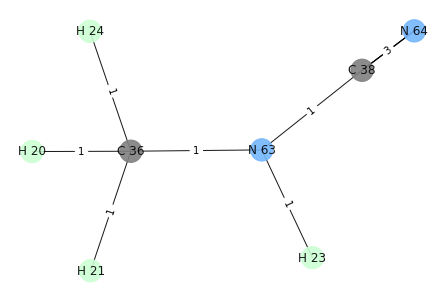

i: 2
Removing edge between: N 62 C 37
Adding edge between: N 62 H 22
N 63 0
H 23 0
C 38 0
H 20 0
C 37 1
N 62 0
N 64 0
H 21 0
C 36 0
H 22 0


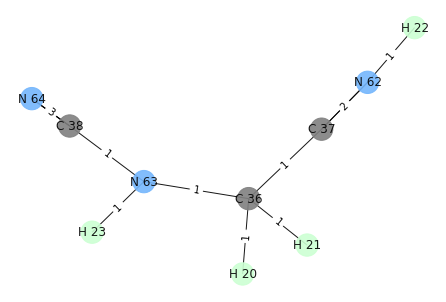

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


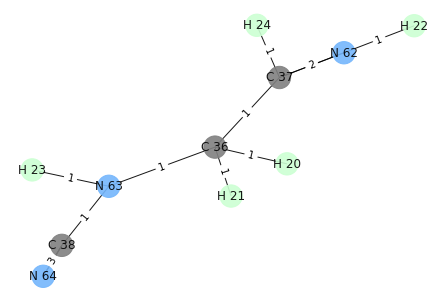

i: 3
Removing edge between: N 63 C 38
Adding edge between: N 63 H 22
H 23 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
H 22 0


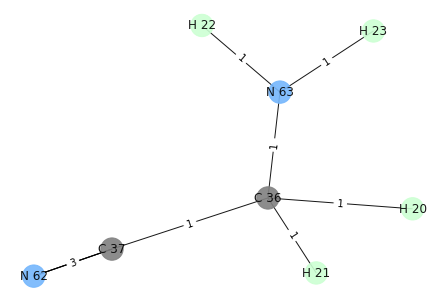

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


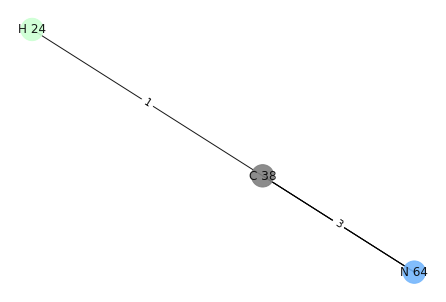

i: 4
Removing edge between: C 36 C 37
Adding edge between: C 36 H 22
N 63 0
H 23 0
C 38 0
H 20 0
N 64 0
H 21 0
C 36 0
H 22 0


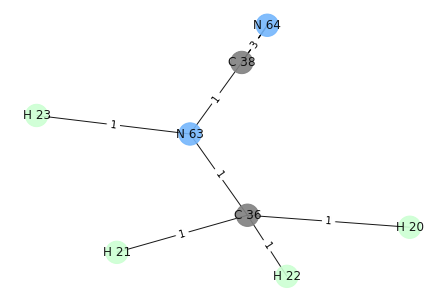

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


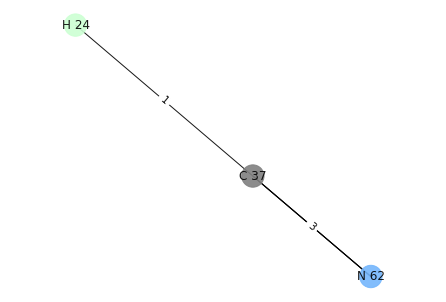

i: 5
Removing edge between: N 64 C 38
Adding edge between: N 64 H 22
C 38 1
H 23 0
H 22 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
N 64 0


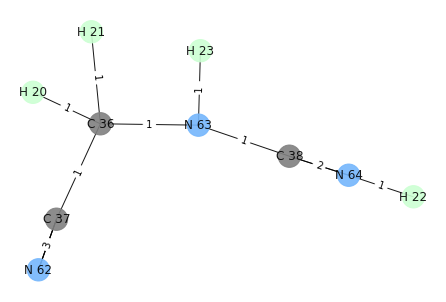

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


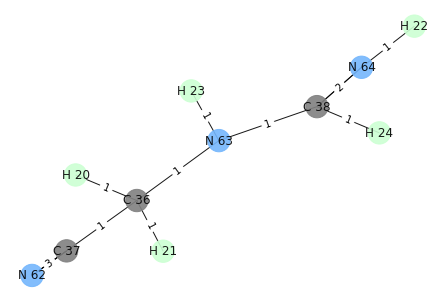

[{H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


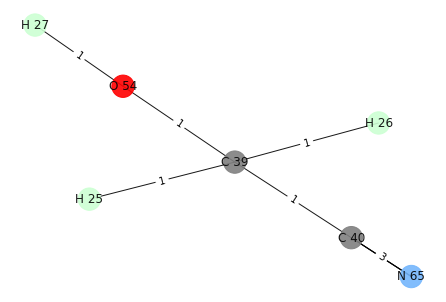

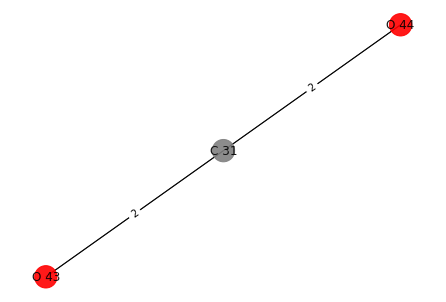

[{O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


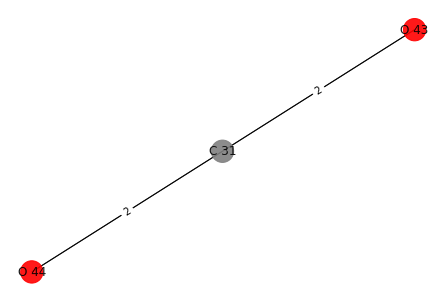

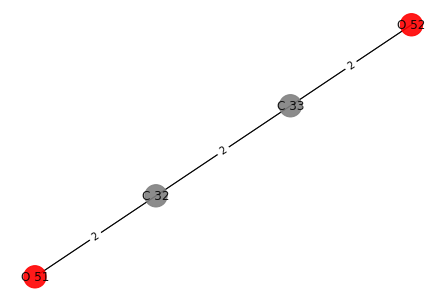

[{C 32, C 33, O 51, O 52}]
15
[{C 28, H 2, O 41, H 1}, {H 3, C 29, N 55}, {N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]
{C 28, H 2, O 41, H 1}
{H 3, C 29, N 55}
7


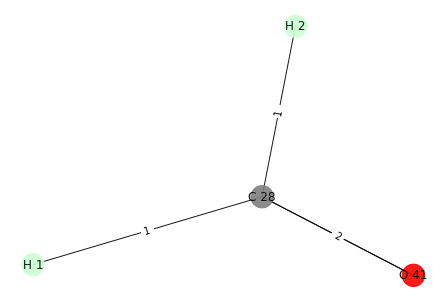

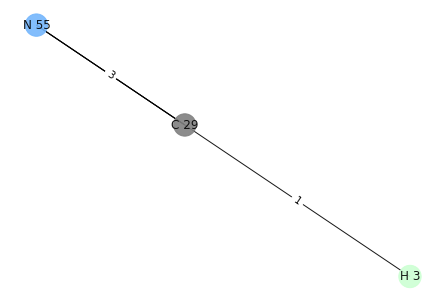

H 2
H 3
C 28 C 29


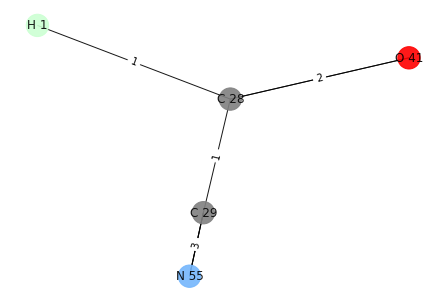

{C 28, H 1, C 29, O 41, N 55}
[C 28, O 41, C 29, N 55]
i: 0
Removing edge between: C 28 O 41
Adding edge between: C 28 H 2
C 28 0
C 29 0
H 1 0
O 41 1
H 2 0
N 55 0


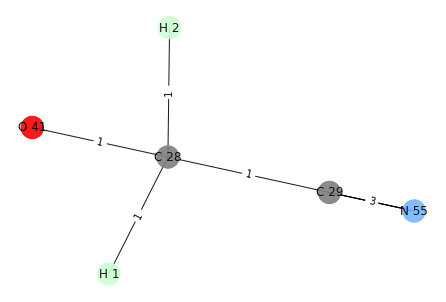

C 28 0
O 41 1
C 29 0
N 55 0
[O 41] H 3


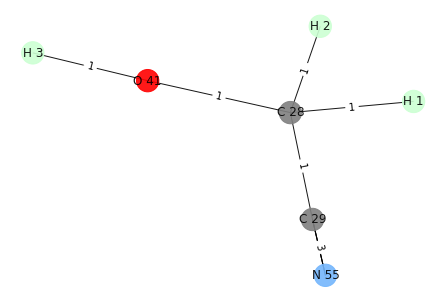

i: 1
Removing edge between: O 41 C 28
Adding edge between: O 41 H 2
C 28 1
C 29 0
H 1 0
O 41 0
H 2 0
N 55 0


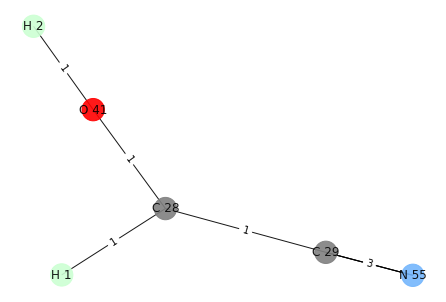

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


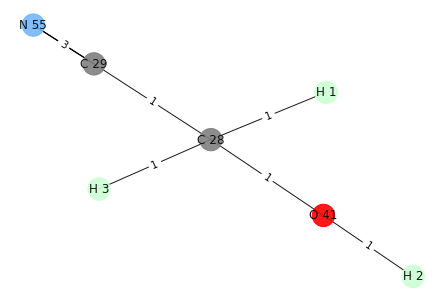

i: 2
Removing edge between: C 29 C 28
Adding edge between: C 29 H 2
H 2 0
C 29 0
N 55 0


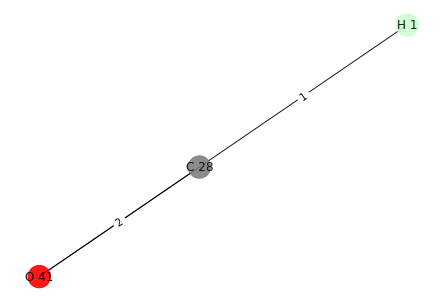

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


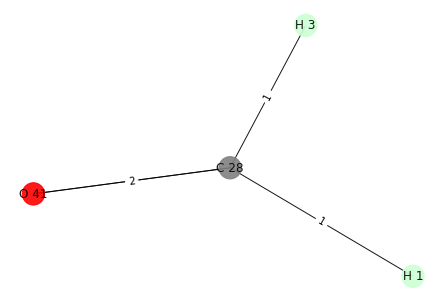

i: 3
Removing edge between: N 55 C 29
Adding edge between: N 55 H 2
C 28 0
C 29 1
H 1 0
O 41 0
H 2 0
N 55 0


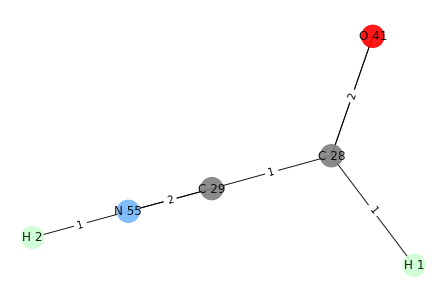

C 28 0
O 41 0
C 29 1
N 55 0
[C 29] H 3


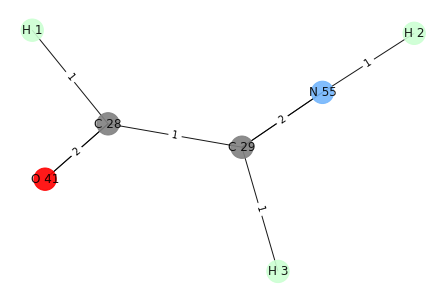

[{N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


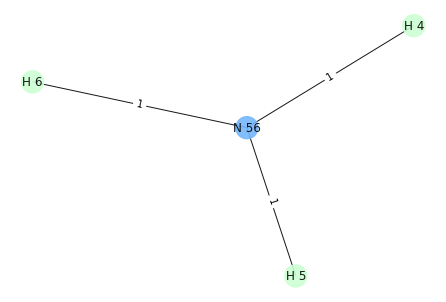

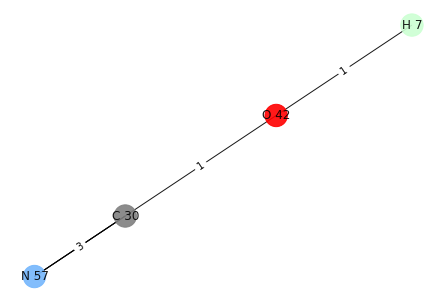

H 5
H 7
N 56 O 42


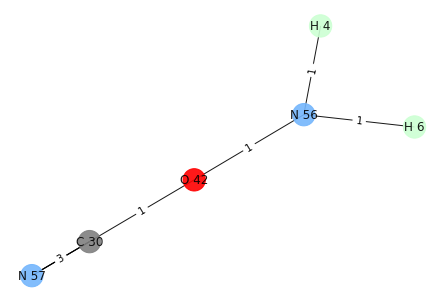

{H 6, O 42, H 4, C 30, N 56, N 57}
[O 42, N 56, C 30, N 57]
i: 0
Removing edge between: O 42 C 30
Adding edge between: O 42 H 5
H 6 0
O 42 0
H 4 0
H 5 0
N 56 0


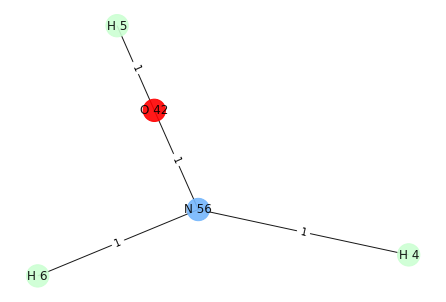

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


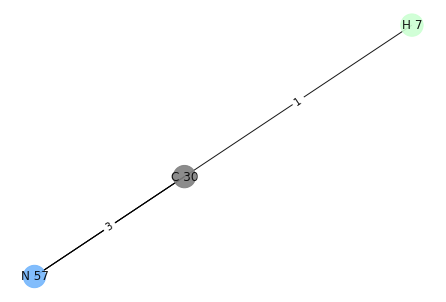

i: 1
Removing edge between: N 56 O 42
Adding edge between: N 56 H 5
N 56 0
H 6 0
H 5 0
H 4 0


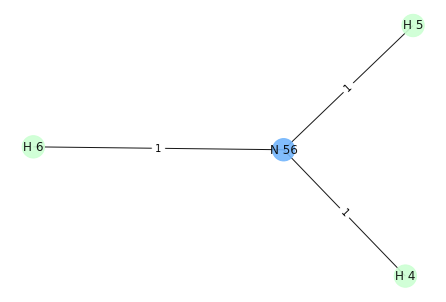

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


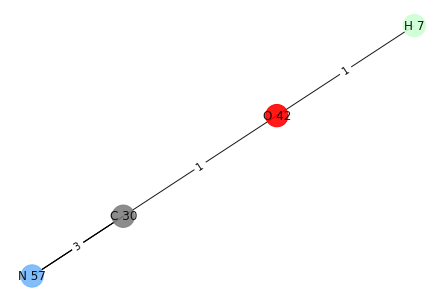

i: 2
Removing edge between: C 30 O 42
Adding edge between: C 30 H 5
N 57 0
C 30 0
H 5 0


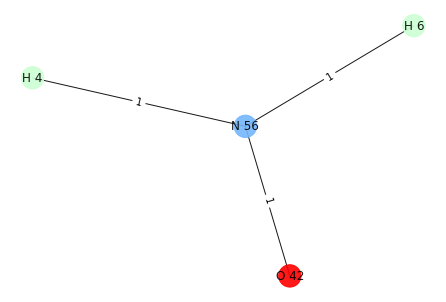

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


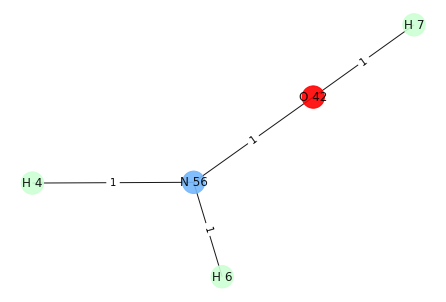

i: 3
Removing edge between: N 57 C 30
Adding edge between: N 57 H 5
H 6 0
O 42 0
H 4 0
C 30 1
H 5 0
N 57 0
N 56 0


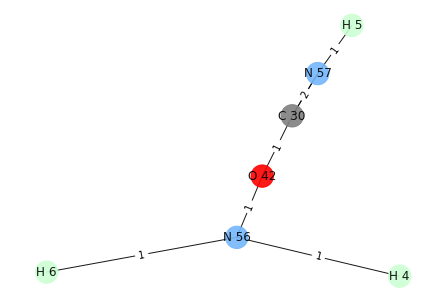

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


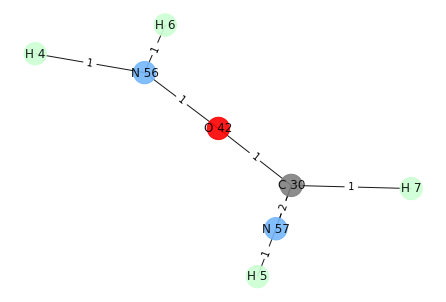

[{H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


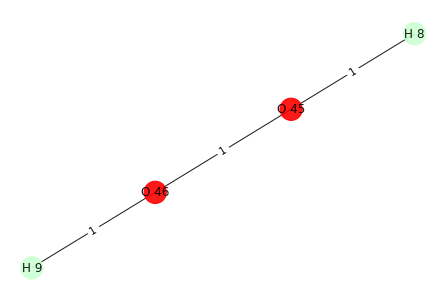

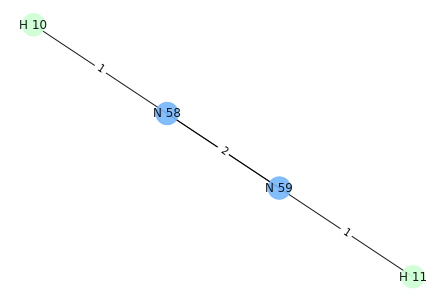

H 9
H 11
O 46 N 59


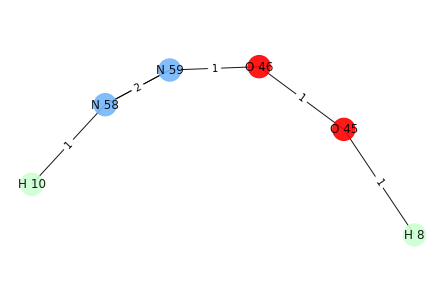

{O 45, N 58, O 46, H 8, N 59, H 10}
[O 45, N 59, O 46, N 58]
i: 0
Removing edge between: O 45 O 46
Adding edge between: O 45 H 9
H 9 0
H 8 0
O 45 0


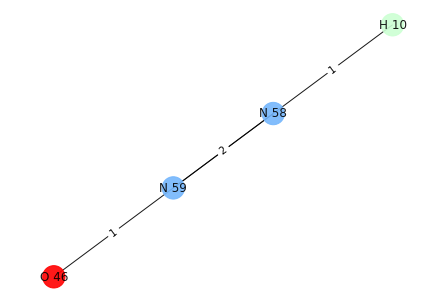

O 45 0
N 59 0
O 46 1
N 58 0
[O 46] H 11


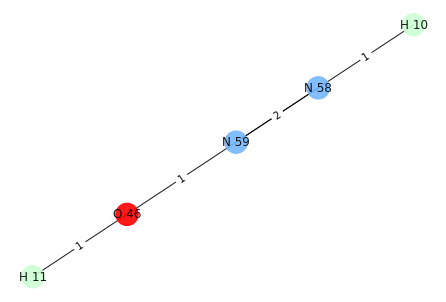

i: 1
Removing edge between: N 59 N 58
Adding edge between: N 59 H 9
O 45 0
N 58 1
O 46 0
H 8 0
N 59 0
H 9 0
H 10 0


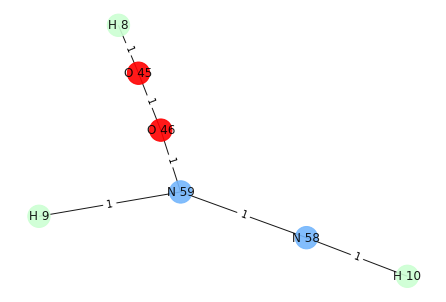

O 45 0
N 59 0
O 46 0
N 58 1
[N 58] H 11


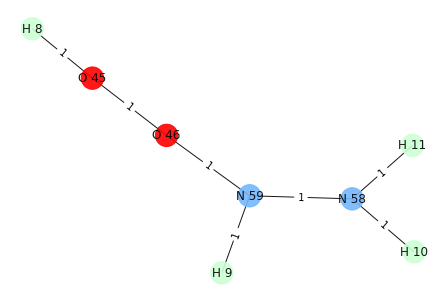

i: 2
Removing edge between: O 46 O 45
Adding edge between: O 46 H 9
N 58 0
O 46 0
N 59 0
H 9 0
H 10 0


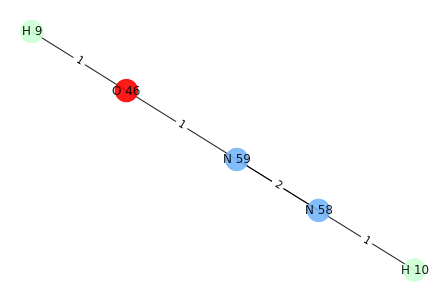

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 11


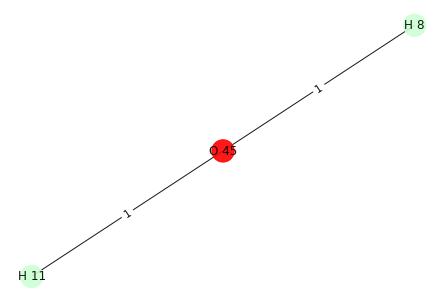

i: 3
Removing edge between: N 58 N 59
Adding edge between: N 58 H 9
O 45 0
N 58 0
O 46 0
H 8 0
N 59 1
H 9 0
H 10 0


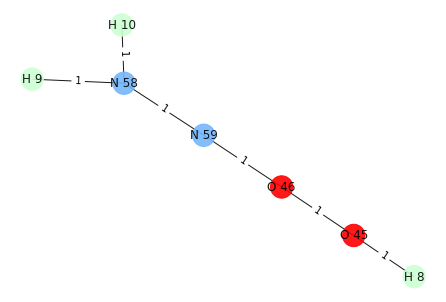

O 45 0
N 59 1
O 46 0
N 58 0
[N 59] H 11


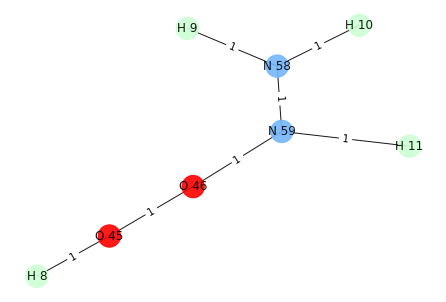

[{N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


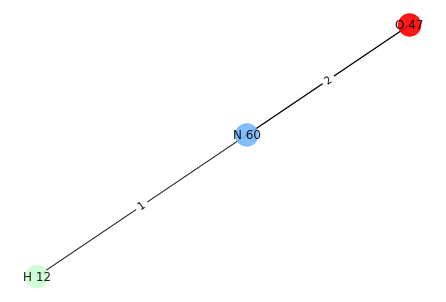

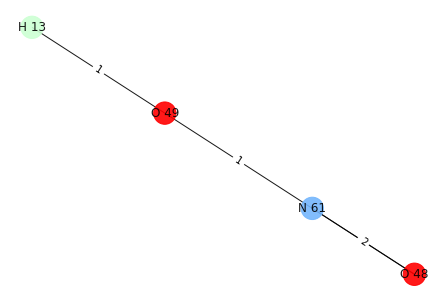

H 12
H 13
N 60 O 49


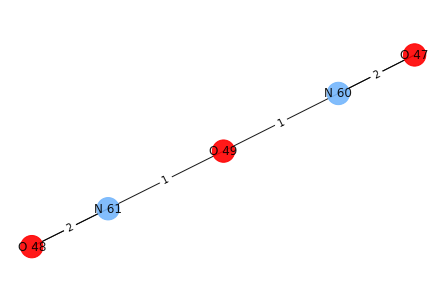

{N 60, O 49, N 61, O 47, O 48}
[N 60, O 49, N 61, O 47, O 48]
i: 0
Removing edge between: N 60 O 47
Adding edge between: N 60 H 12
N 60 0
O 49 0
N 61 0
H 12 0
O 47 1
O 48 0


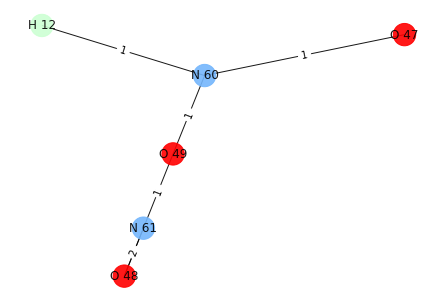

N 60 0
O 49 0
N 61 0
O 47 1
O 48 0
[O 47] H 13


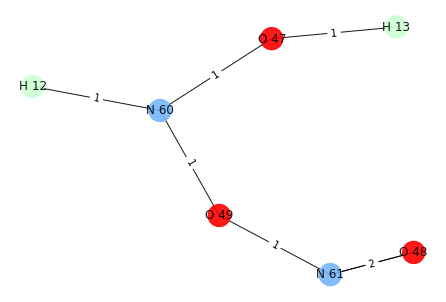

i: 1
Removing edge between: O 49 N 60
Adding edge between: O 49 H 12
N 61 0
O 49 0
H 12 0
O 48 0


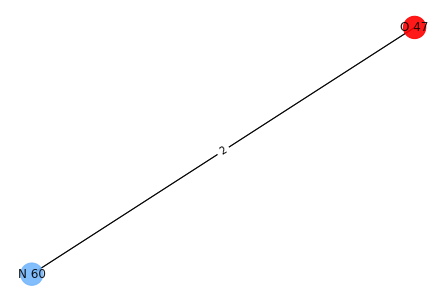

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


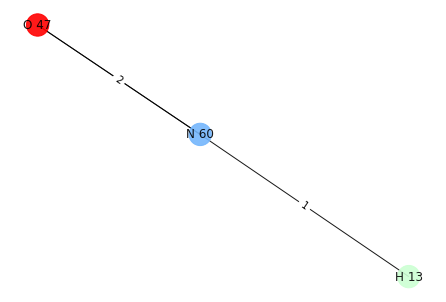

i: 2
Removing edge between: N 61 O 49
Adding edge between: N 61 H 12
N 61 0
H 12 0
O 48 0


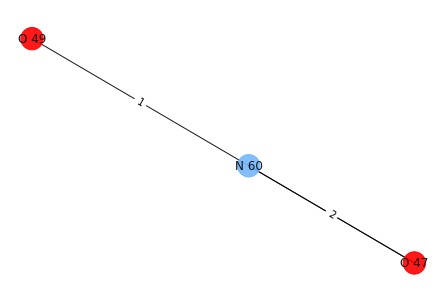

N 60 0
O 49 1
N 61 0
O 47 0
O 48 0
[O 49] H 13


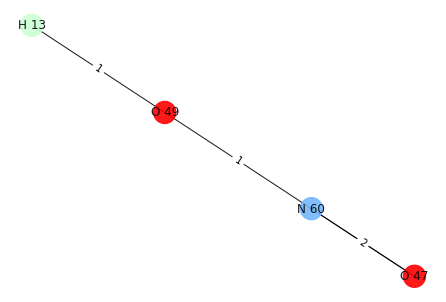

i: 3
Removing edge between: O 47 N 60
Adding edge between: O 47 H 12
N 60 1
O 49 0
N 61 0
H 12 0
O 47 0
O 48 0


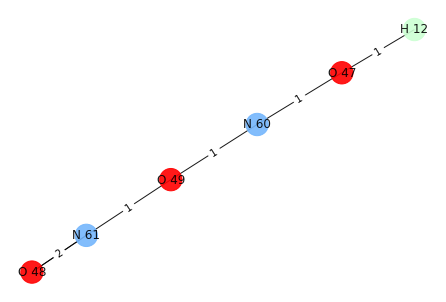

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


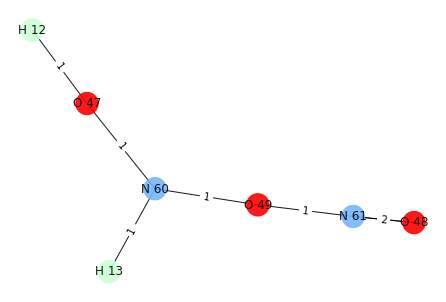

i: 4
Removing edge between: O 48 N 61
Adding edge between: O 48 H 12
N 60 0
O 49 0
N 61 1
H 12 0
O 47 0
O 48 0


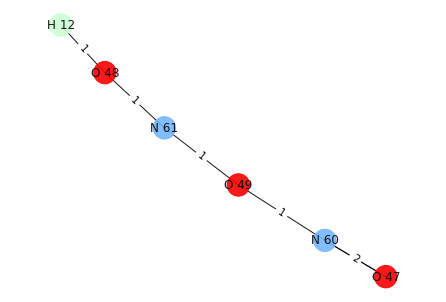

N 60 0
O 49 0
N 61 1
O 47 0
O 48 0
[N 61] H 13


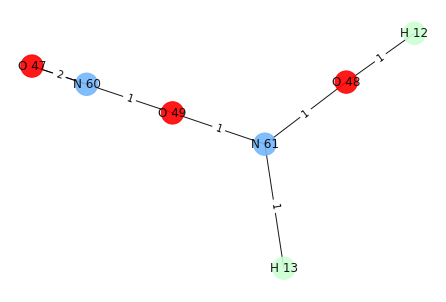

[{O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


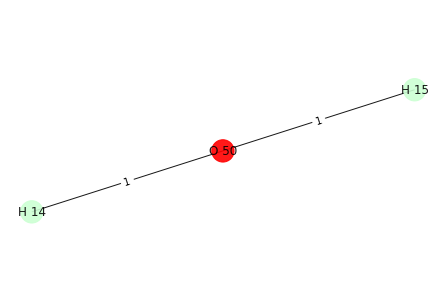

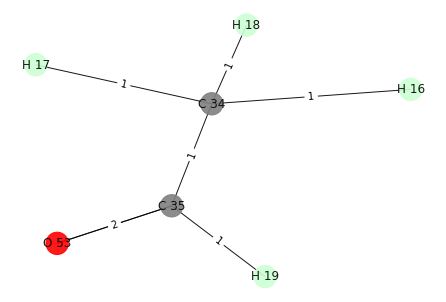

H 14
H 18
O 50 C 34


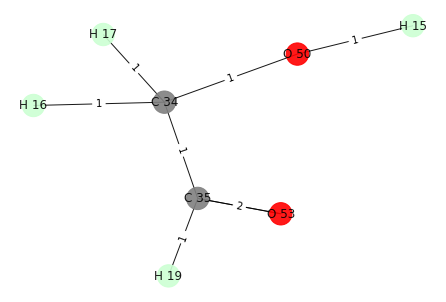

{O 53, H 15, H 19, O 50, C 34, H 16, C 35, H 17}
[O 53, C 34, C 35, O 50]
i: 0
Removing edge between: O 53 C 35
Adding edge between: O 53 H 14
O 53 0
H 19 0
H 15 0
C 34 0
O 50 0
H 16 0
C 35 1
H 17 0
H 14 0


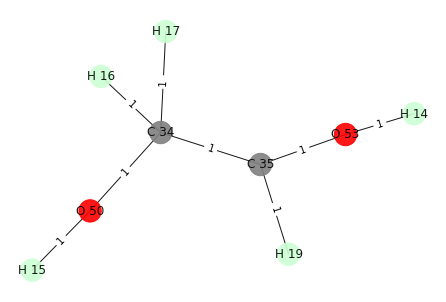

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 18


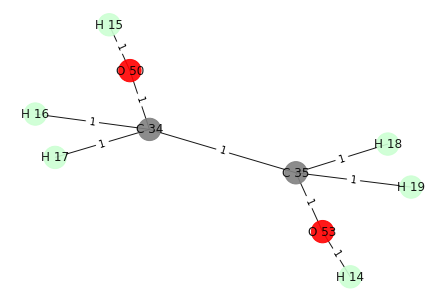

i: 1
Removing edge between: C 34 O 50
Adding edge between: C 34 H 14
O 53 0
H 19 0
C 34 0
H 16 0
C 35 0
H 17 0
H 14 0


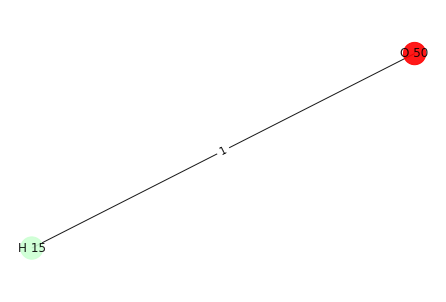

O 53 0
C 34 0
C 35 0
O 50 1
[O 50] H 18


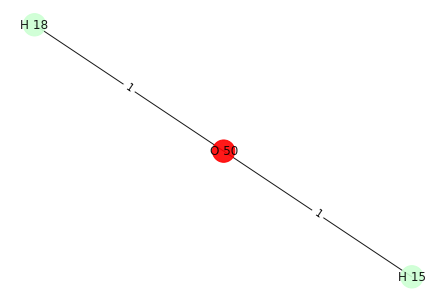

i: 2
Removing edge between: C 35 O 53
Adding edge between: C 35 H 14
O 53 1
H 19 0
H 15 0
C 34 0
O 50 0
H 16 0
C 35 0
H 17 0
H 14 0


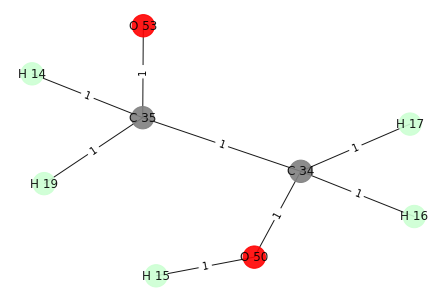

O 53 1
C 34 0
C 35 0
O 50 0
[O 53] H 18


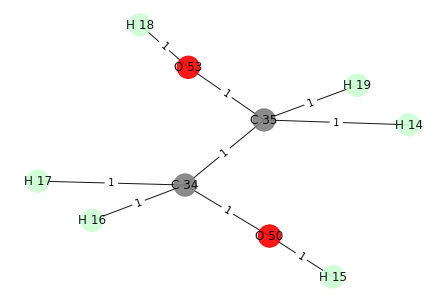

i: 3
Removing edge between: O 50 C 34
Adding edge between: O 50 H 14
O 50 0
H 14 0
H 15 0


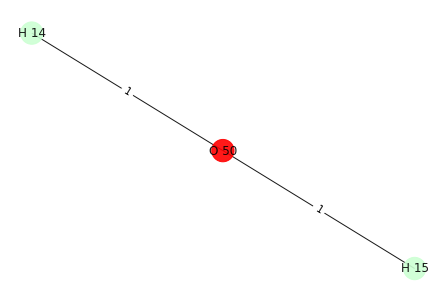

O 53 0
C 34 1
C 35 0
O 50 0
[C 34] H 18


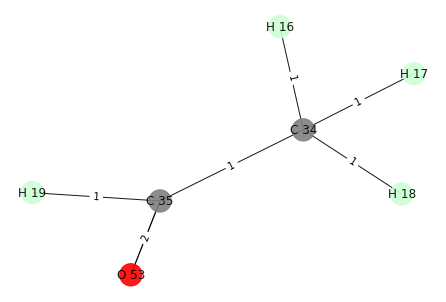

[{H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


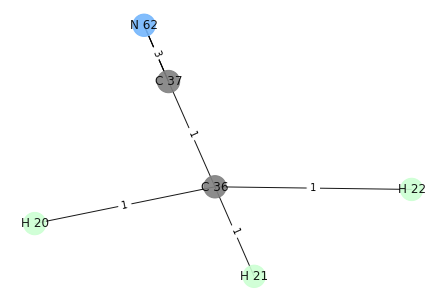

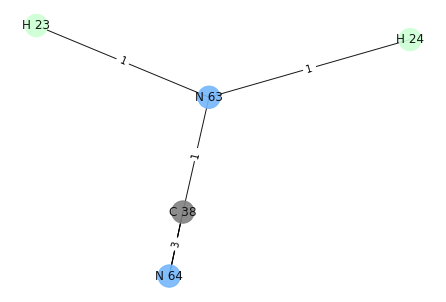

H 21
H 23
C 36 N 63


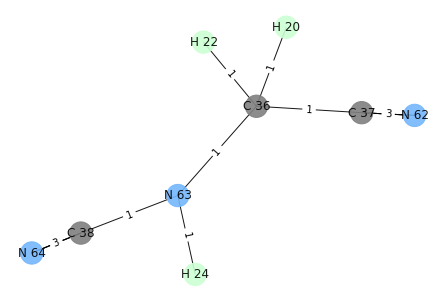

{N 63, C 38, H 20, H 24, C 37, N 62, N 64, C 36, H 22}
[C 38, C 37, N 62, N 63, C 36, N 64]
i: 0
Removing edge between: C 38 N 63
Adding edge between: C 38 H 21
N 64 0
H 21 0
C 38 0


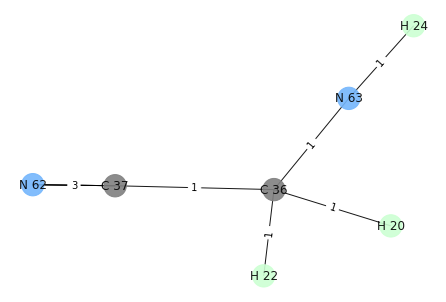

C 38 0
C 37 0
N 62 0
N 63 1
C 36 0
N 64 0
[N 63] H 23


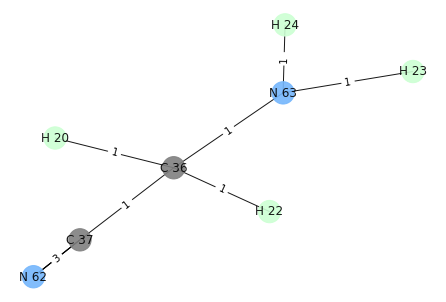

i: 1
Removing edge between: C 37 C 36
Adding edge between: C 37 H 21
C 37 0
H 21 0
N 62 0


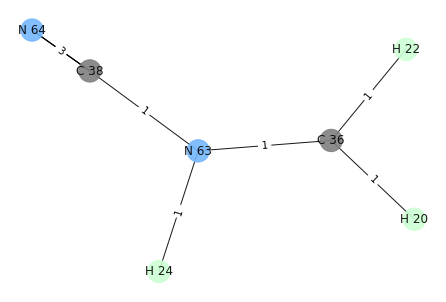

C 38 0
C 37 0
N 62 0
N 63 0
C 36 1
N 64 0
[C 36] H 23


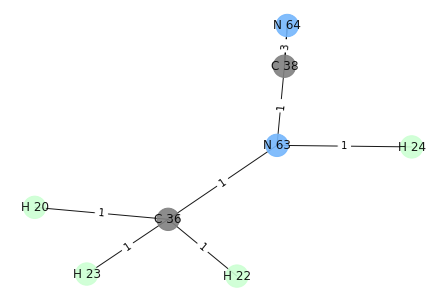

i: 2
Removing edge between: N 62 C 37
Adding edge between: N 62 H 21
N 63 0
C 38 0
H 20 0
H 24 0
C 37 1
N 62 0
N 64 0
H 21 0
C 36 0
H 22 0


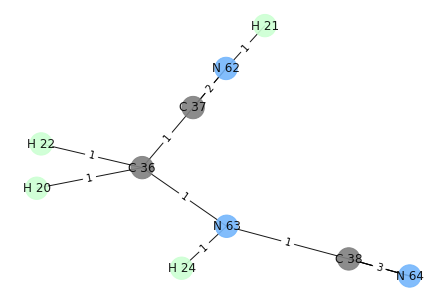

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 23


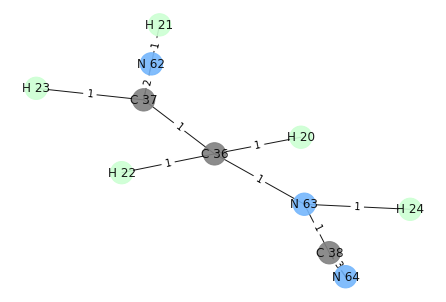

i: 3
Removing edge between: N 63 C 38
Adding edge between: N 63 H 21
H 24 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
H 22 0


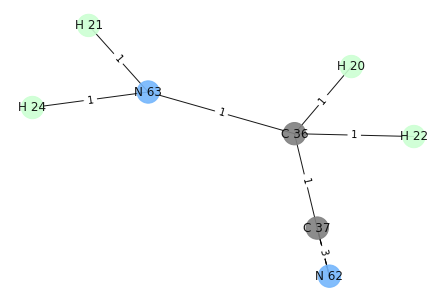

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 23


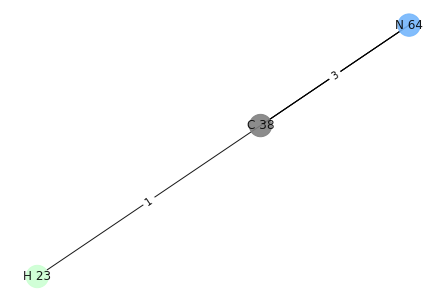

i: 4
Removing edge between: C 36 C 37
Adding edge between: C 36 H 21
N 63 0
C 38 0
H 20 0
H 24 0
N 64 0
H 21 0
C 36 0
H 22 0


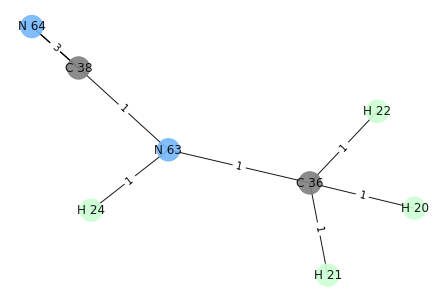

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 23


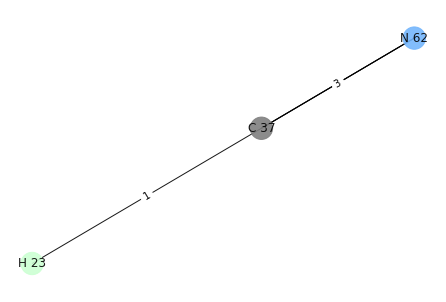

i: 5
Removing edge between: N 64 C 38
Adding edge between: N 64 H 21
C 38 1
H 22 0
H 24 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
N 64 0


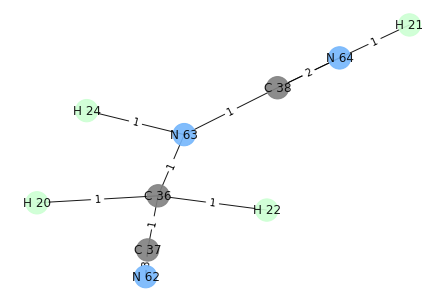

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 23


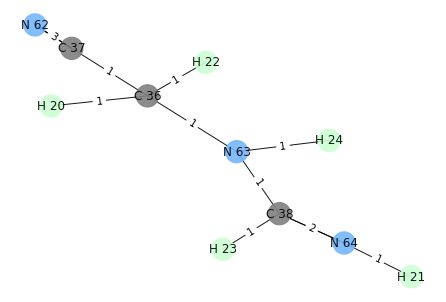

[{H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


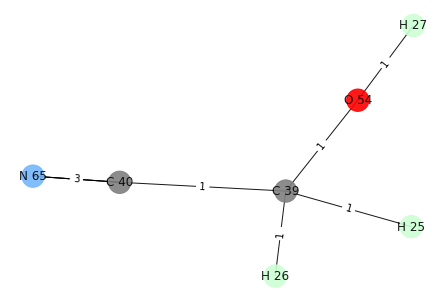

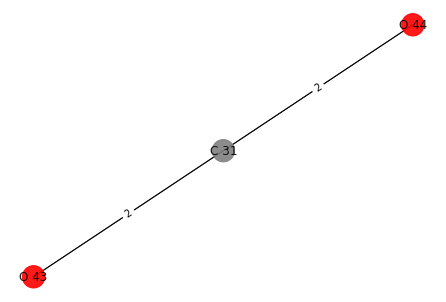

[{O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


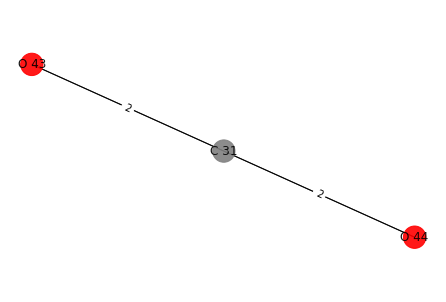

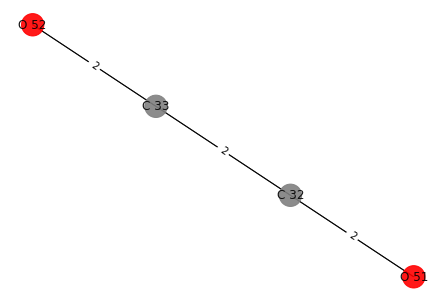

[{C 32, C 33, O 51, O 52}]
15
[{C 28, H 2, O 41, H 1}, {H 3, C 29, N 55}, {N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]
{C 28, H 2, O 41, H 1}
{H 3, C 29, N 55}
7


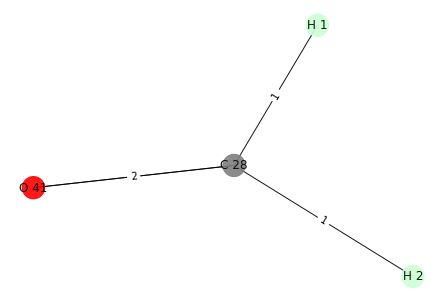

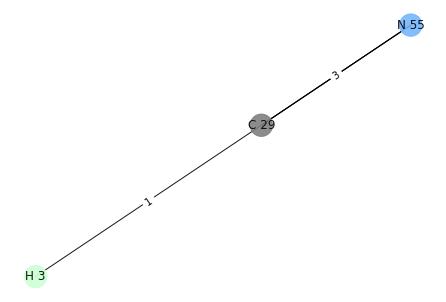

H 2
H 3
C 28 C 29


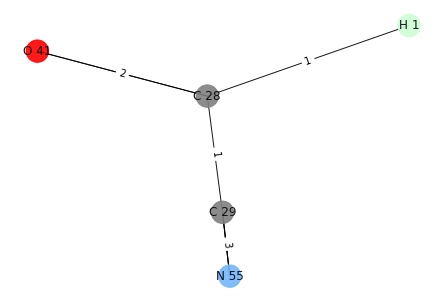

{C 28, H 1, C 29, O 41, N 55}
[C 28, O 41, C 29, N 55]
i: 0
Removing edge between: C 28 O 41
Adding edge between: C 28 H 2
C 28 0
C 29 0
H 1 0
O 41 1
H 2 0
N 55 0


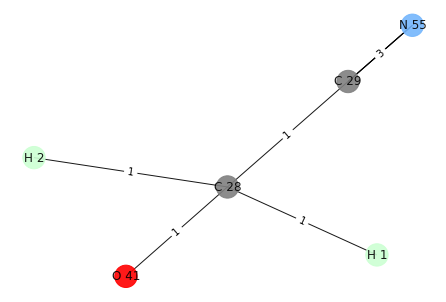

C 28 0
O 41 1
C 29 0
N 55 0
[O 41] H 3


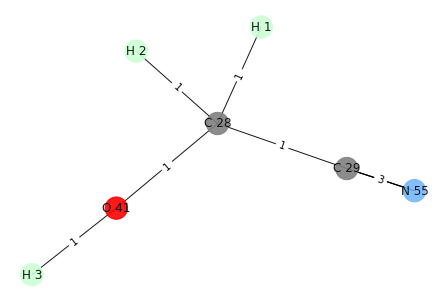

i: 1
Removing edge between: O 41 C 28
Adding edge between: O 41 H 2
C 28 1
C 29 0
H 1 0
O 41 0
H 2 0
N 55 0


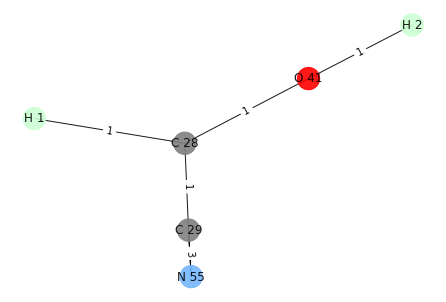

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


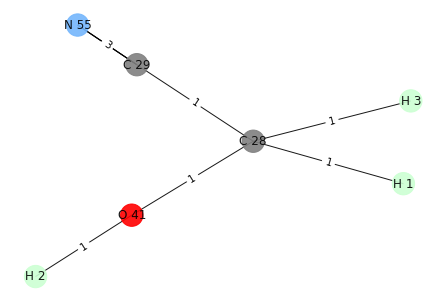

i: 2
Removing edge between: C 29 C 28
Adding edge between: C 29 H 2
H 2 0
C 29 0
N 55 0


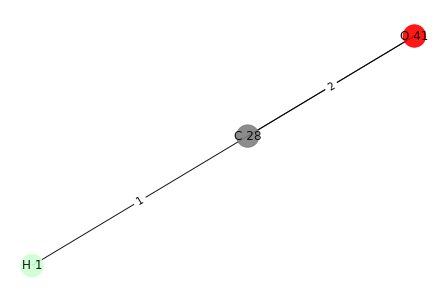

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


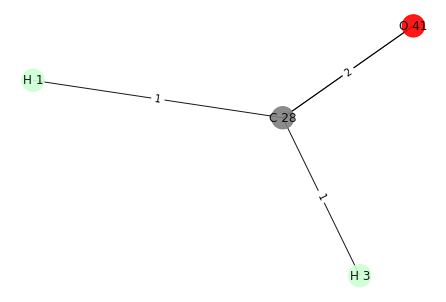

i: 3
Removing edge between: N 55 C 29
Adding edge between: N 55 H 2
C 28 0
C 29 1
H 1 0
O 41 0
H 2 0
N 55 0


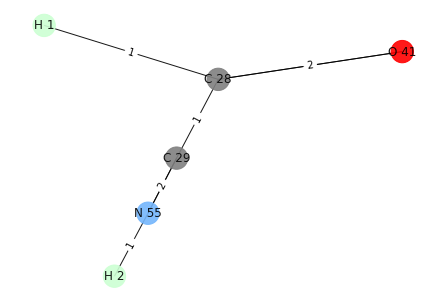

C 28 0
O 41 0
C 29 1
N 55 0
[C 29] H 3


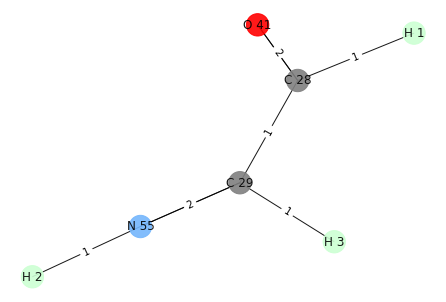

[{N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


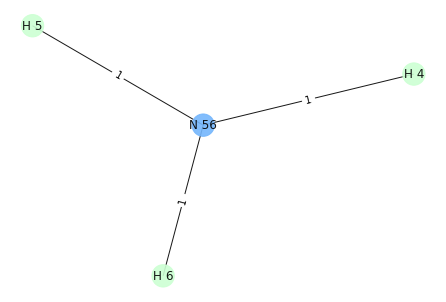

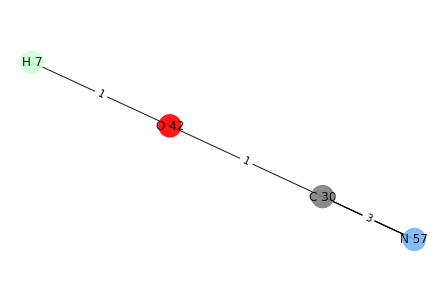

H 4
H 7
N 56 O 42


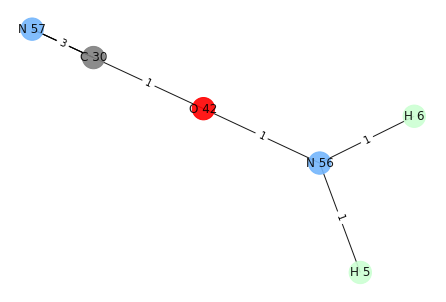

{H 6, O 42, C 30, H 5, N 56, N 57}
[O 42, N 56, C 30, N 57]
i: 0
Removing edge between: O 42 C 30
Adding edge between: O 42 H 4
H 6 0
O 42 0
H 4 0
H 5 0
N 56 0


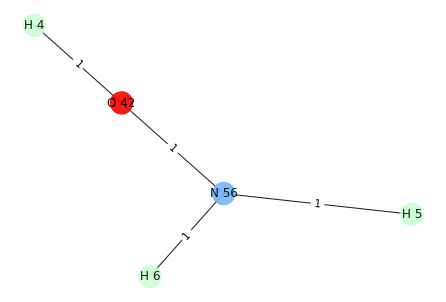

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


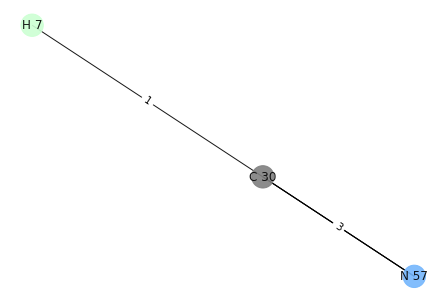

i: 1
Removing edge between: N 56 O 42
Adding edge between: N 56 H 4
N 56 0
H 6 0
H 4 0
H 5 0


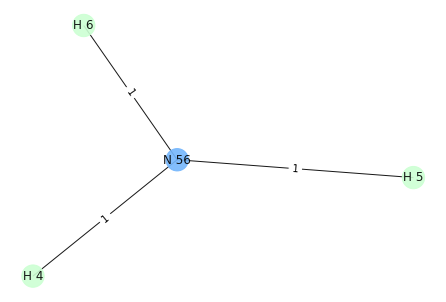

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


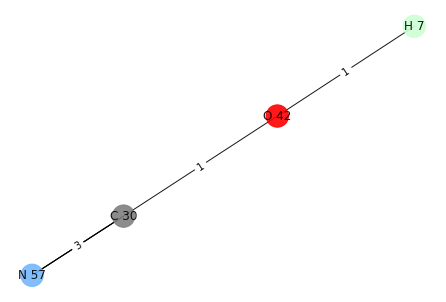

i: 2
Removing edge between: C 30 O 42
Adding edge between: C 30 H 4
N 57 0
C 30 0
H 4 0


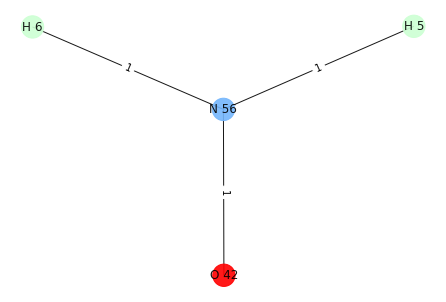

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


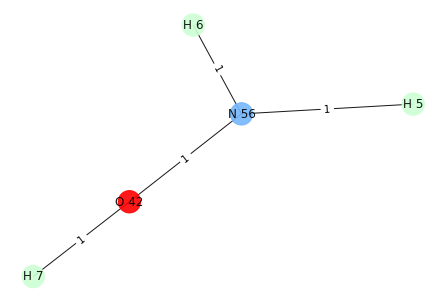

i: 3
Removing edge between: N 57 C 30
Adding edge between: N 57 H 4
H 6 0
O 42 0
H 4 0
C 30 1
H 5 0
N 57 0
N 56 0


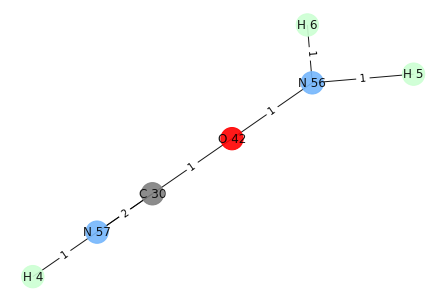

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


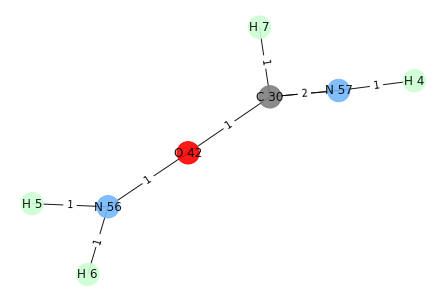

[{H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


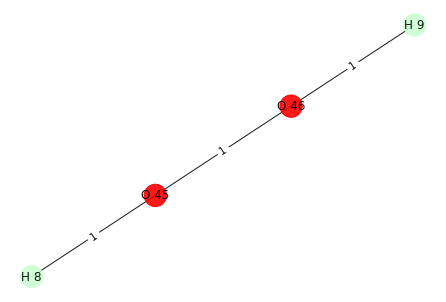

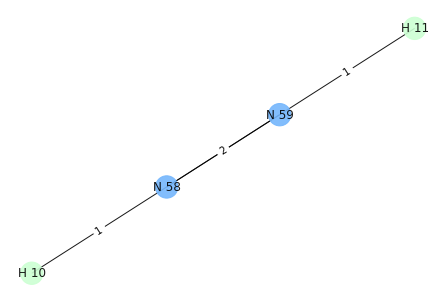

H 9
H 10
O 46 N 58


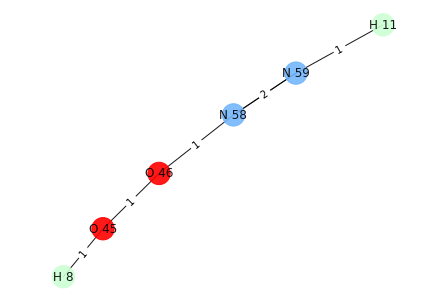

{O 45, H 11, N 58, O 46, H 8, N 59}
[O 45, N 59, O 46, N 58]
i: 0
Removing edge between: O 45 O 46
Adding edge between: O 45 H 9
H 9 0
H 8 0
O 45 0


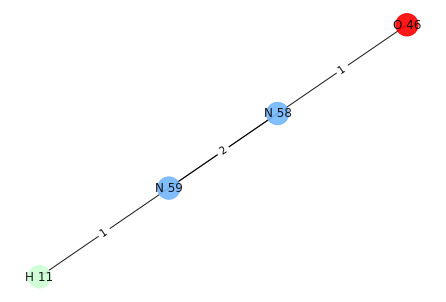

O 45 0
N 59 0
O 46 1
N 58 0
[O 46] H 10


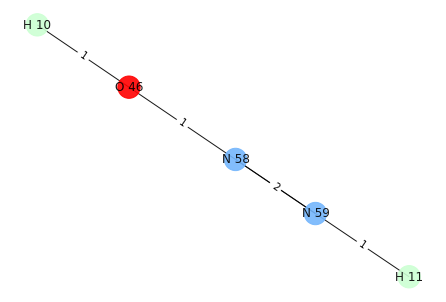

i: 1
Removing edge between: N 59 N 58
Adding edge between: N 59 H 9
O 45 0
H 11 0
N 58 1
O 46 0
H 8 0
N 59 0
H 9 0


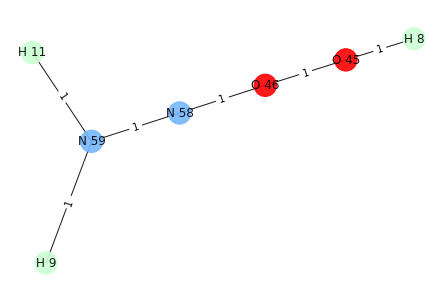

O 45 0
N 59 0
O 46 0
N 58 1
[N 58] H 10


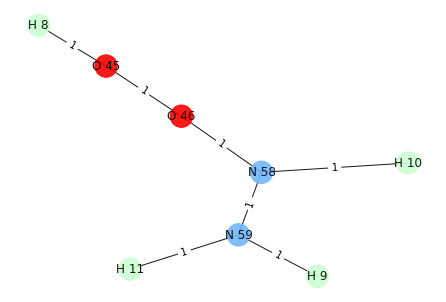

i: 2
Removing edge between: O 46 O 45
Adding edge between: O 46 H 9
H 11 0
N 58 0
O 46 0
N 59 0
H 9 0


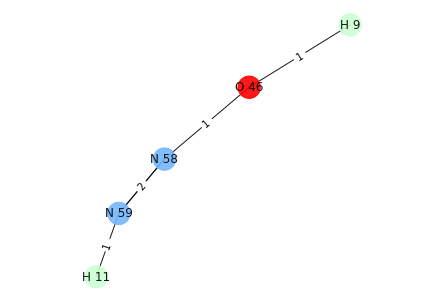

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 10


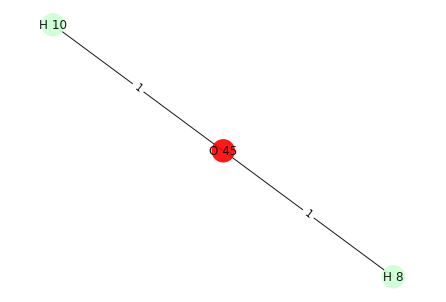

i: 3
Removing edge between: N 58 N 59
Adding edge between: N 58 H 9
O 45 0
H 11 0
N 58 0
O 46 0
H 8 0
N 59 1
H 9 0


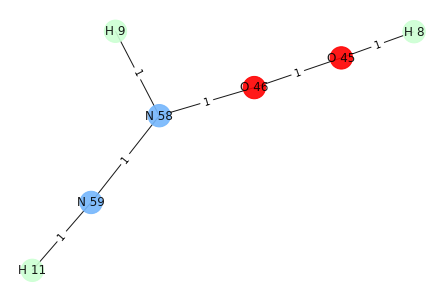

O 45 0
N 59 1
O 46 0
N 58 0
[N 59] H 10


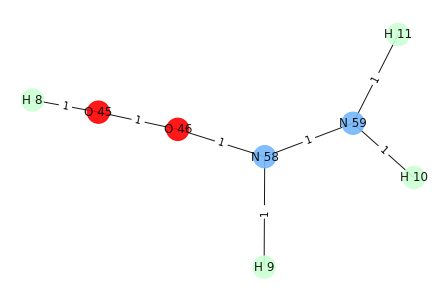

[{N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


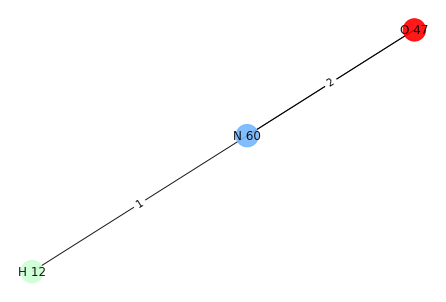

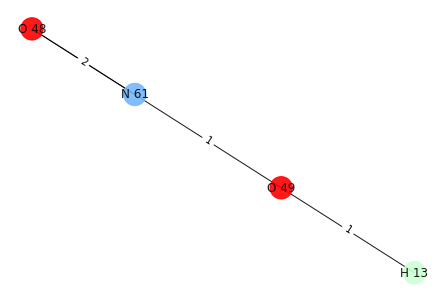

H 12
H 13
N 60 O 49


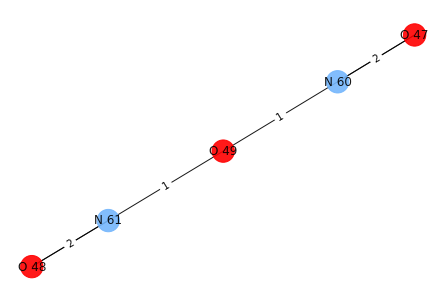

{N 60, O 49, N 61, O 47, O 48}
[N 60, O 49, N 61, O 47, O 48]
i: 0
Removing edge between: N 60 O 47
Adding edge between: N 60 H 12
N 60 0
O 49 0
N 61 0
H 12 0
O 47 1
O 48 0


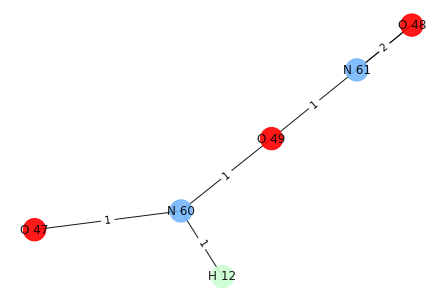

N 60 0
O 49 0
N 61 0
O 47 1
O 48 0
[O 47] H 13


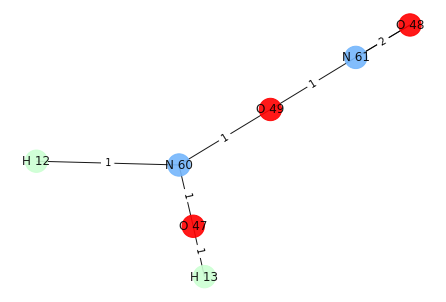

i: 1
Removing edge between: O 49 N 60
Adding edge between: O 49 H 12
N 61 0
O 49 0
H 12 0
O 48 0


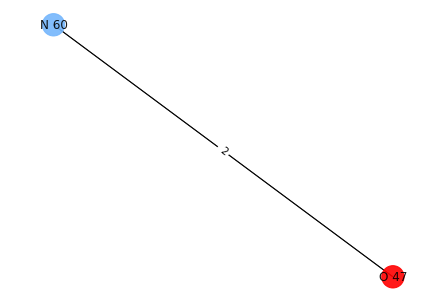

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


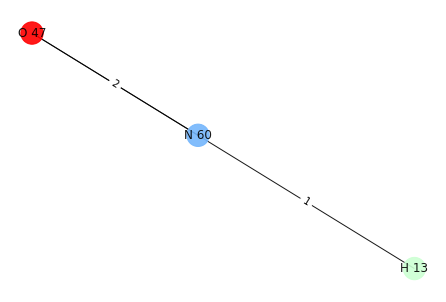

i: 2
Removing edge between: N 61 O 49
Adding edge between: N 61 H 12
N 61 0
H 12 0
O 48 0


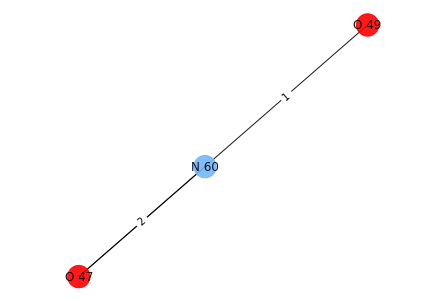

N 60 0
O 49 1
N 61 0
O 47 0
O 48 0
[O 49] H 13


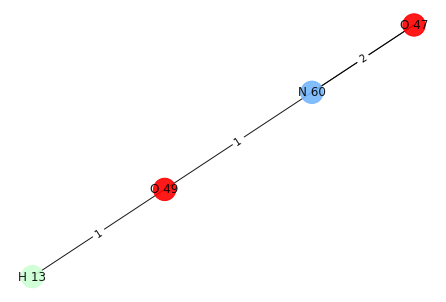

i: 3
Removing edge between: O 47 N 60
Adding edge between: O 47 H 12
N 60 1
O 49 0
N 61 0
H 12 0
O 47 0
O 48 0


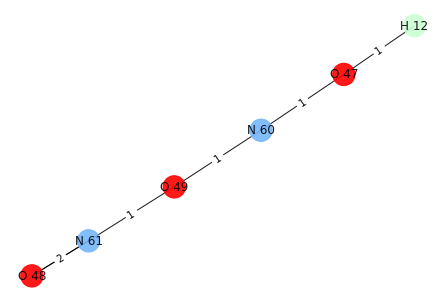

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


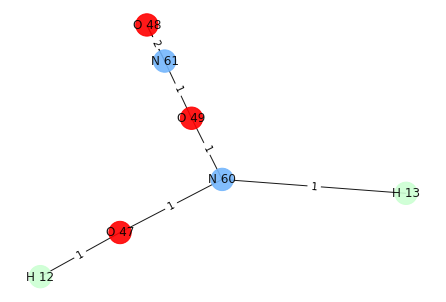

i: 4
Removing edge between: O 48 N 61
Adding edge between: O 48 H 12
N 60 0
O 49 0
N 61 1
H 12 0
O 47 0
O 48 0


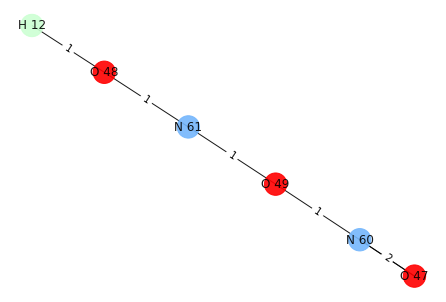

N 60 0
O 49 0
N 61 1
O 47 0
O 48 0
[N 61] H 13


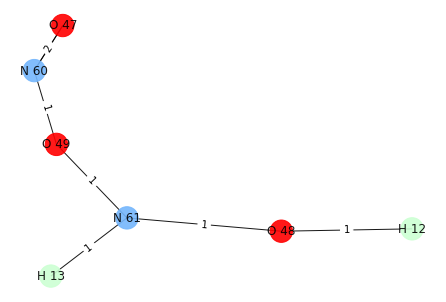

[{O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


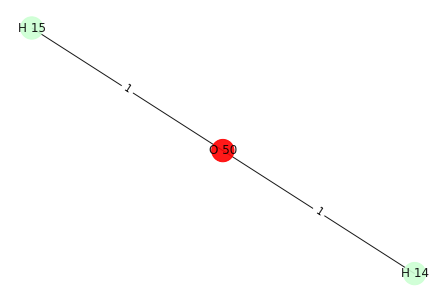

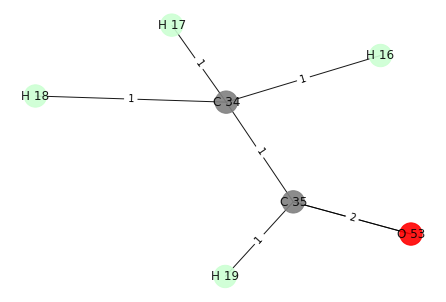

H 14
H 17
O 50 C 34


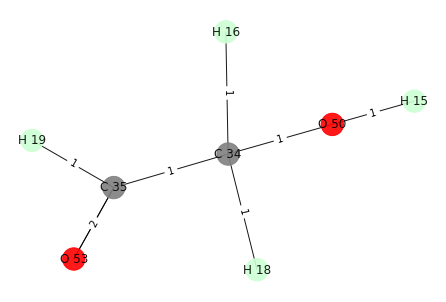

{O 53, H 15, H 19, O 50, C 34, H 16, C 35, H 18}
[O 53, C 34, C 35, O 50]
i: 0
Removing edge between: O 53 C 35
Adding edge between: O 53 H 14
O 53 0
H 19 0
H 15 0
C 34 0
O 50 0
H 18 0
H 16 0
C 35 1
H 14 0


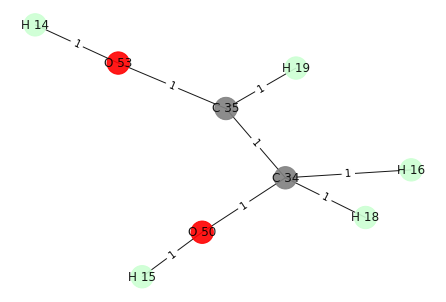

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 17


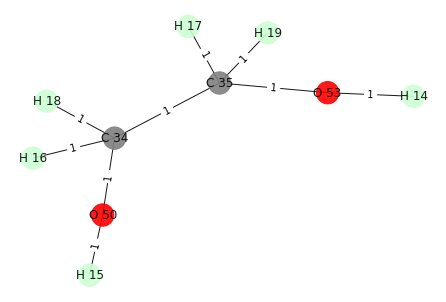

i: 1
Removing edge between: C 34 O 50
Adding edge between: C 34 H 14
O 53 0
H 19 0
C 34 0
H 18 0
H 16 0
C 35 0
H 14 0


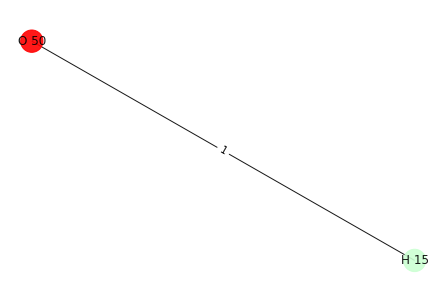

O 53 0
C 34 0
C 35 0
O 50 1
[O 50] H 17


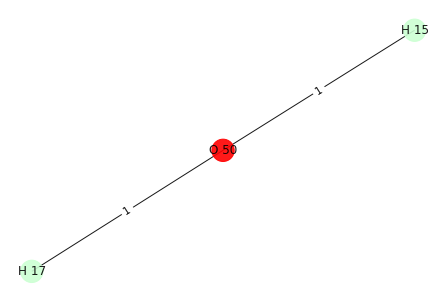

i: 2
Removing edge between: C 35 O 53
Adding edge between: C 35 H 14
O 53 1
H 19 0
H 15 0
C 34 0
O 50 0
H 18 0
H 16 0
C 35 0
H 14 0


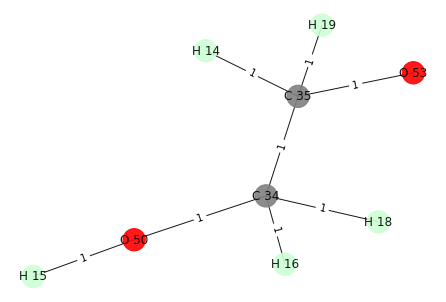

O 53 1
C 34 0
C 35 0
O 50 0
[O 53] H 17


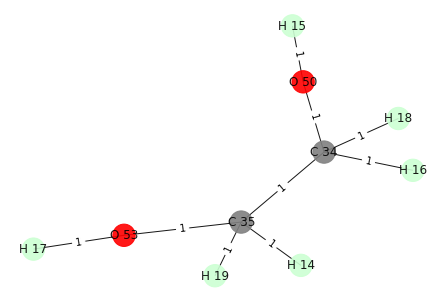

i: 3
Removing edge between: O 50 C 34
Adding edge between: O 50 H 14
O 50 0
H 14 0
H 15 0


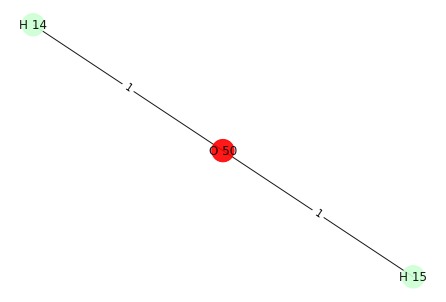

O 53 0
C 34 1
C 35 0
O 50 0
[C 34] H 17


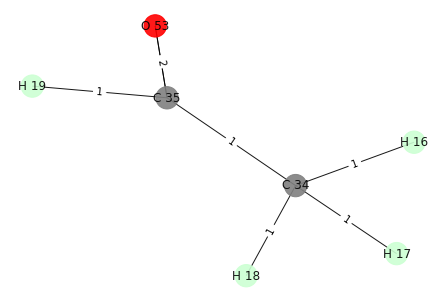

[{H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


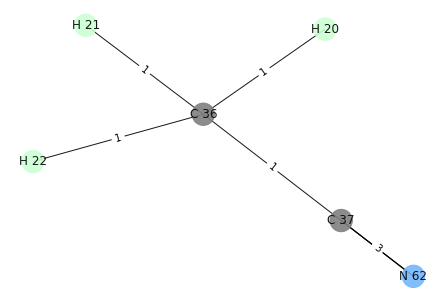

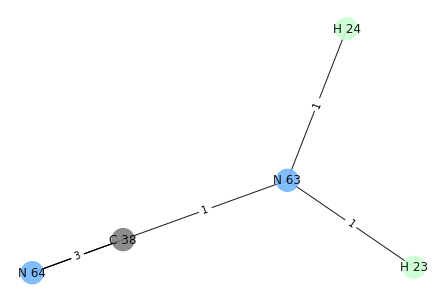

H 20
H 24
C 36 N 63


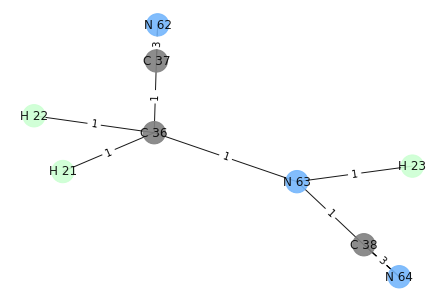

{N 63, C 38, H 23, C 37, N 62, N 64, H 21, C 36, H 22}
[C 38, C 37, N 62, N 63, C 36, N 64]
i: 0
Removing edge between: C 38 N 63
Adding edge between: C 38 H 20
N 64 0
H 20 0
C 38 0


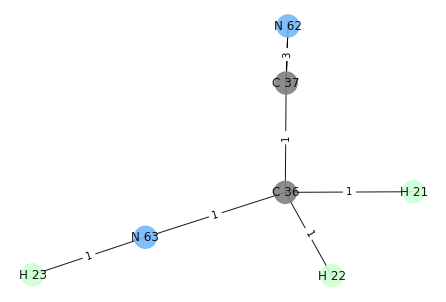

C 38 0
C 37 0
N 62 0
N 63 1
C 36 0
N 64 0
[N 63] H 24


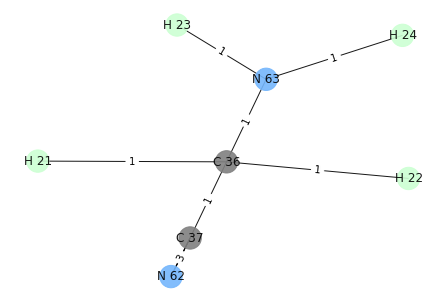

i: 1
Removing edge between: C 37 C 36
Adding edge between: C 37 H 20
C 37 0
H 20 0
N 62 0


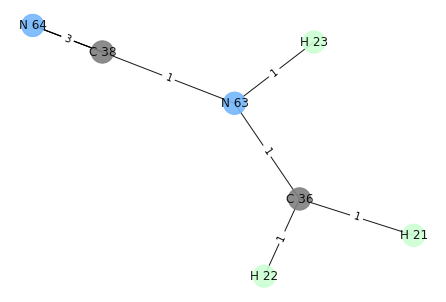

C 38 0
C 37 0
N 62 0
N 63 0
C 36 1
N 64 0
[C 36] H 24


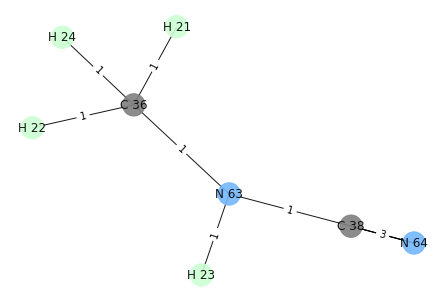

i: 2
Removing edge between: N 62 C 37
Adding edge between: N 62 H 20
N 63 0
H 23 0
C 38 0
H 20 0
C 37 1
N 62 0
N 64 0
H 21 0
C 36 0
H 22 0


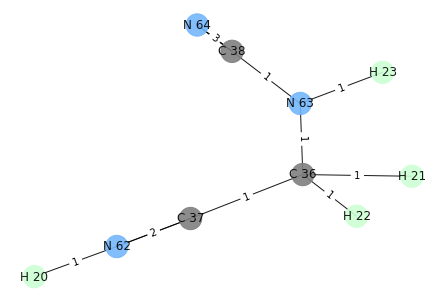

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


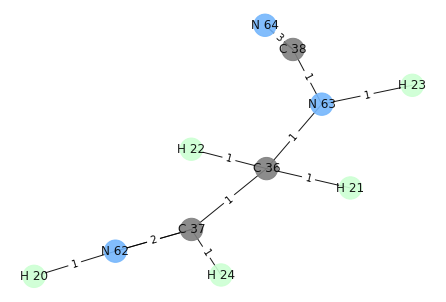

i: 3
Removing edge between: N 63 C 38
Adding edge between: N 63 H 20
H 23 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
H 22 0


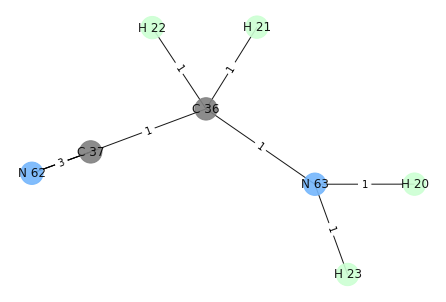

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


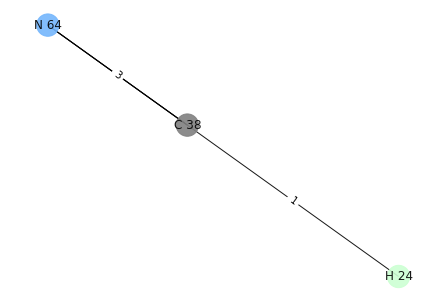

i: 4
Removing edge between: C 36 C 37
Adding edge between: C 36 H 20
N 63 0
H 23 0
C 38 0
H 20 0
N 64 0
H 21 0
C 36 0
H 22 0


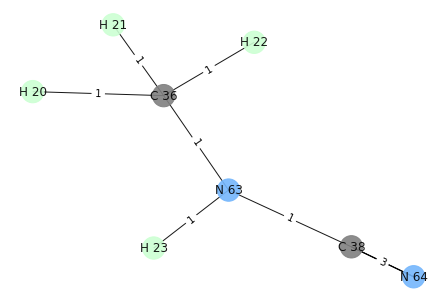

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


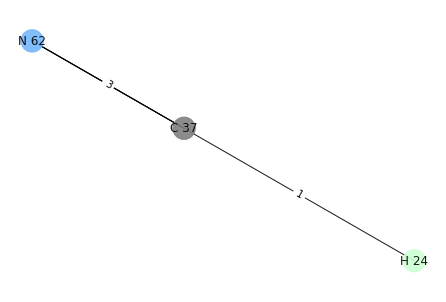

i: 5
Removing edge between: N 64 C 38
Adding edge between: N 64 H 20
C 38 1
H 23 0
H 22 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
N 64 0


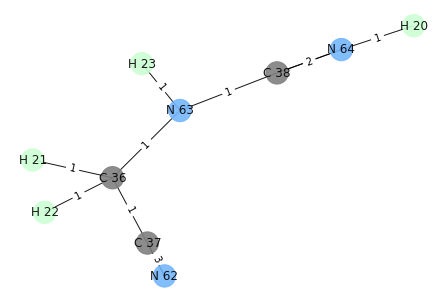

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


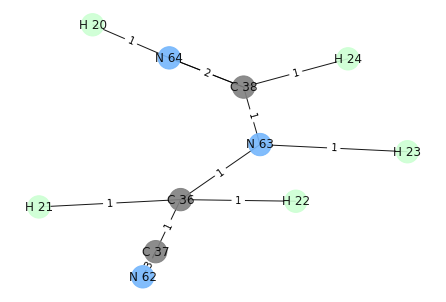

[{H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


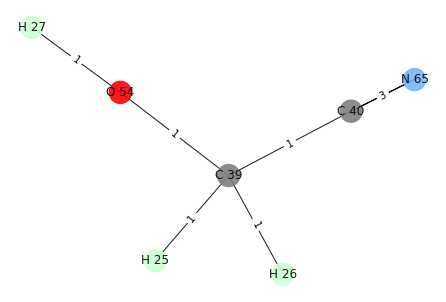

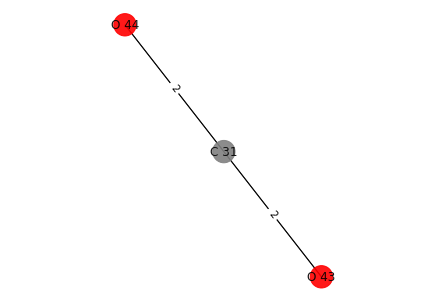

[{O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


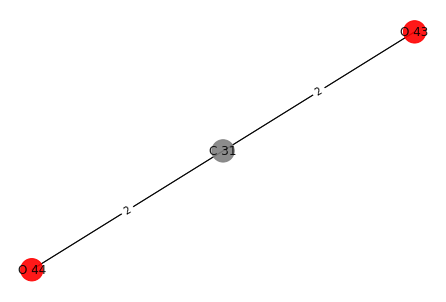

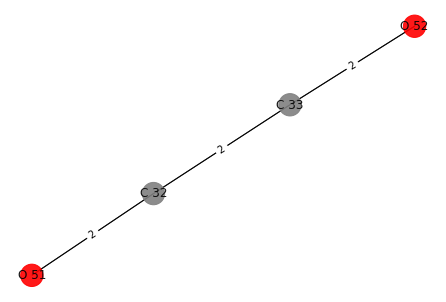

[{C 32, C 33, O 51, O 52}]
15
[{C 28, H 2, O 41, H 1}, {H 3, C 29, N 55}, {N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]
{C 28, H 2, O 41, H 1}
{H 3, C 29, N 55}
7


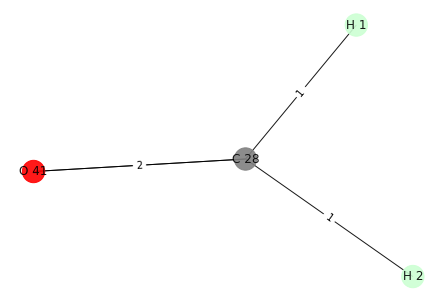

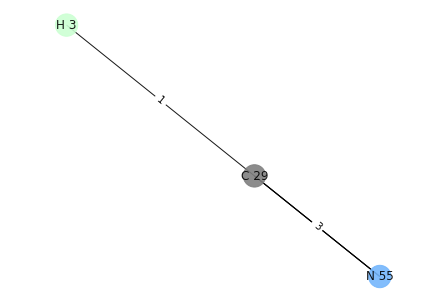

H 1
H 3
C 28 C 29


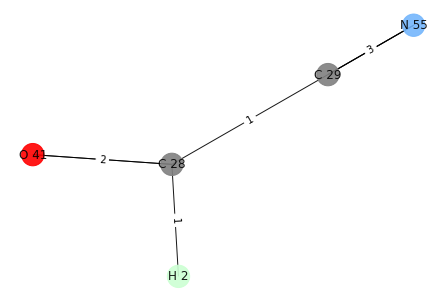

{C 28, C 29, H 2, O 41, N 55}
[C 28, O 41, C 29, N 55]
i: 0
Removing edge between: C 28 O 41
Adding edge between: C 28 H 1
C 28 0
H 1 0
C 29 0
H 2 0
O 41 1
N 55 0


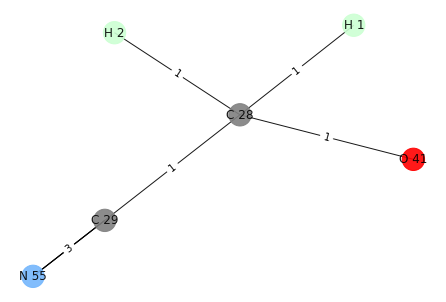

C 28 0
O 41 1
C 29 0
N 55 0
[O 41] H 3


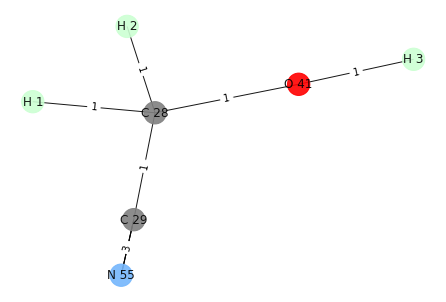

i: 1
Removing edge between: O 41 C 28
Adding edge between: O 41 H 1
C 28 1
H 1 0
C 29 0
H 2 0
O 41 0
N 55 0


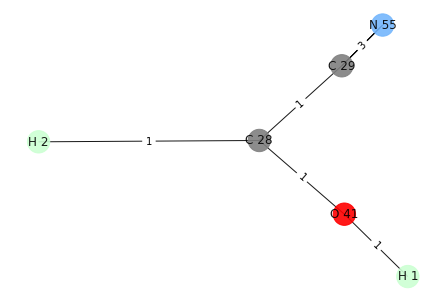

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


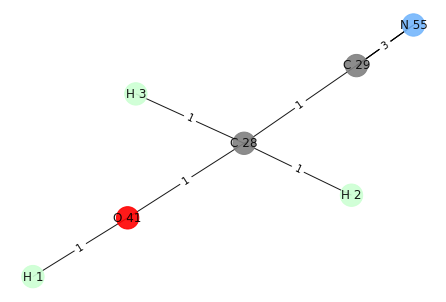

i: 2
Removing edge between: C 29 C 28
Adding edge between: C 29 H 1
H 1 0
C 29 0
N 55 0


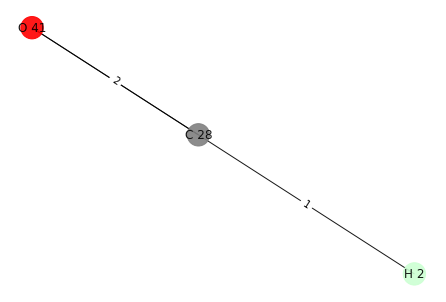

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


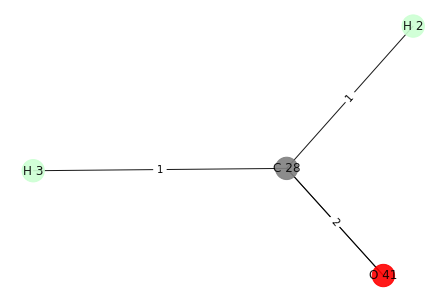

i: 3
Removing edge between: N 55 C 29
Adding edge between: N 55 H 1
C 28 0
H 1 0
C 29 1
O 41 0
H 2 0
N 55 0


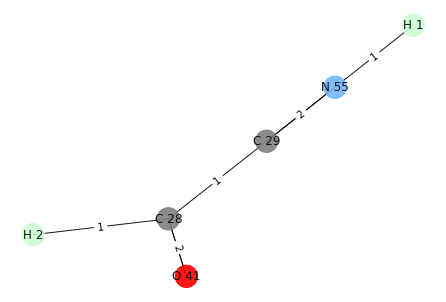

C 28 0
O 41 0
C 29 1
N 55 0
[C 29] H 3


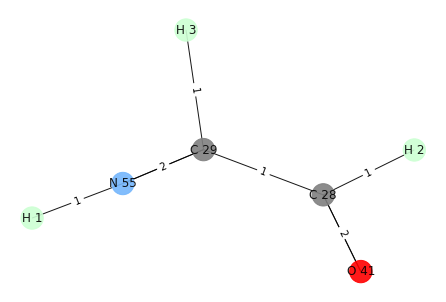

[{N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


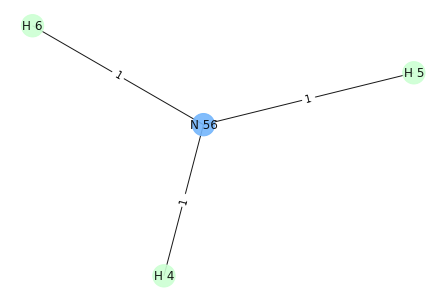

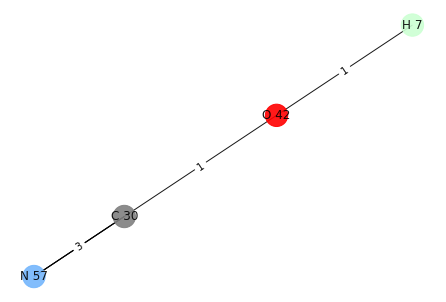

H 5
H 7
N 56 O 42


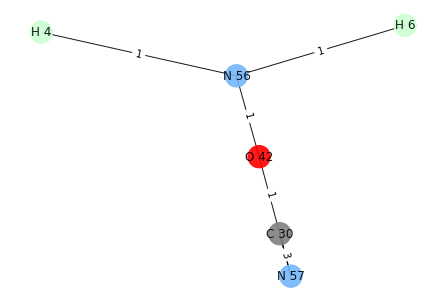

{H 6, O 42, H 4, C 30, N 56, N 57}
[O 42, N 56, C 30, N 57]
i: 0
Removing edge between: O 42 C 30
Adding edge between: O 42 H 5
H 6 0
O 42 0
H 4 0
H 5 0
N 56 0


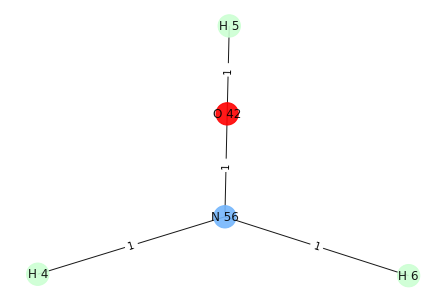

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


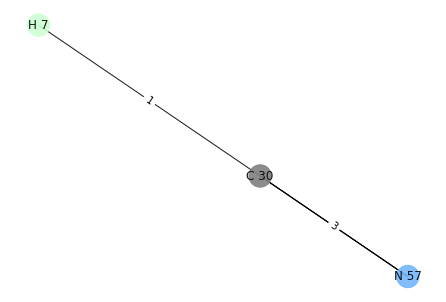

i: 1
Removing edge between: N 56 O 42
Adding edge between: N 56 H 5
N 56 0
H 6 0
H 5 0
H 4 0


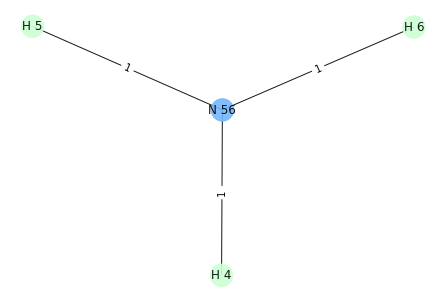

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


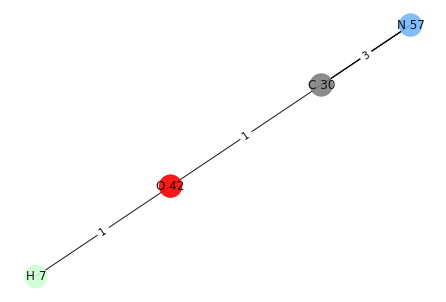

i: 2
Removing edge between: C 30 O 42
Adding edge between: C 30 H 5
N 57 0
C 30 0
H 5 0


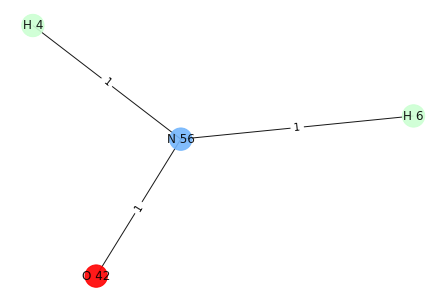

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


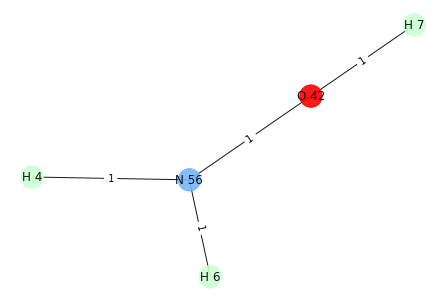

i: 3
Removing edge between: N 57 C 30
Adding edge between: N 57 H 5
H 6 0
O 42 0
H 4 0
C 30 1
H 5 0
N 57 0
N 56 0


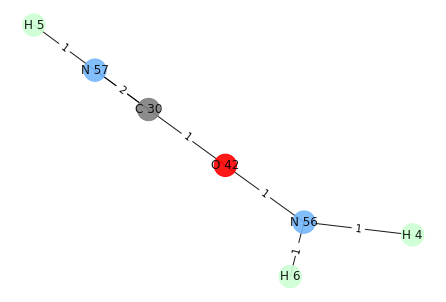

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


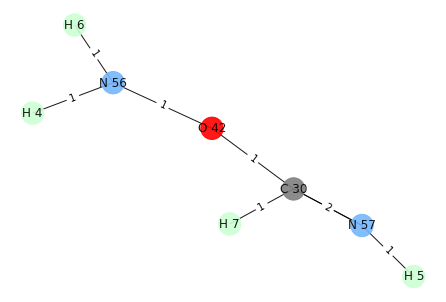

[{H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


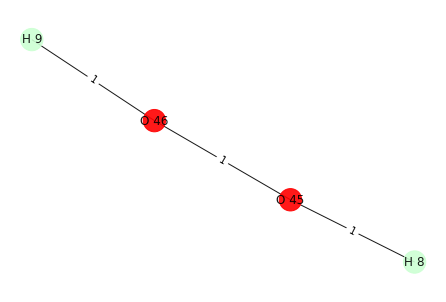

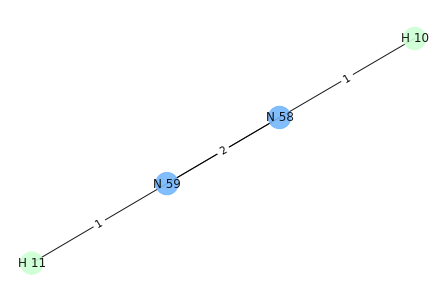

H 9
H 10
O 46 N 58


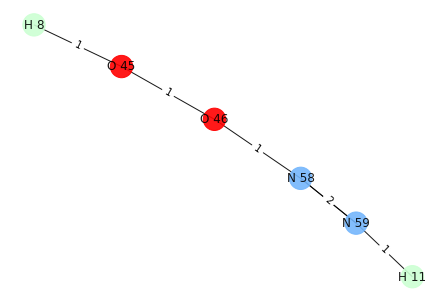

{O 45, H 11, N 58, O 46, H 8, N 59}
[O 45, N 59, O 46, N 58]
i: 0
Removing edge between: O 45 O 46
Adding edge between: O 45 H 9
H 9 0
H 8 0
O 45 0


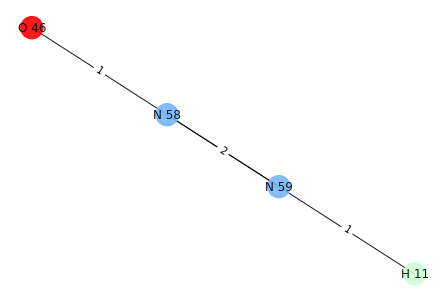

O 45 0
N 59 0
O 46 1
N 58 0
[O 46] H 10


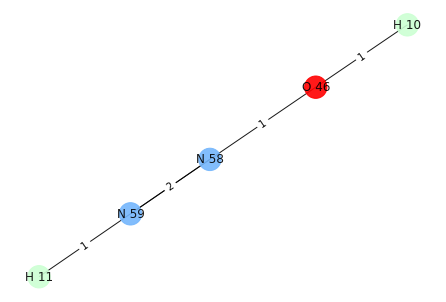

i: 1
Removing edge between: N 59 N 58
Adding edge between: N 59 H 9
O 45 0
H 11 0
N 58 1
O 46 0
H 8 0
N 59 0
H 9 0


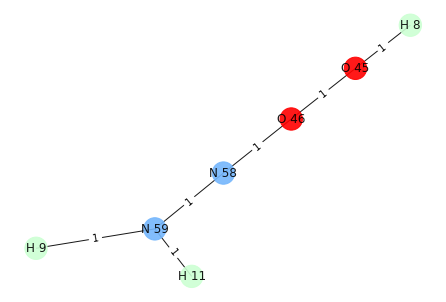

O 45 0
N 59 0
O 46 0
N 58 1
[N 58] H 10


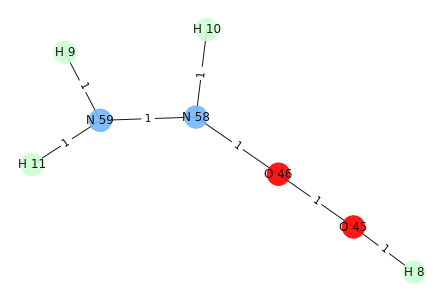

i: 2
Removing edge between: O 46 O 45
Adding edge between: O 46 H 9
H 11 0
N 58 0
O 46 0
N 59 0
H 9 0


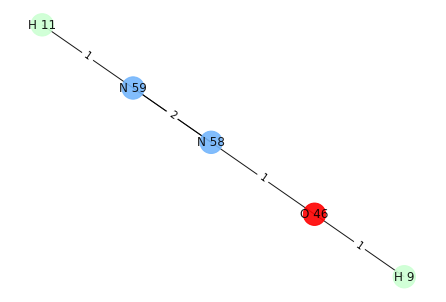

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 10


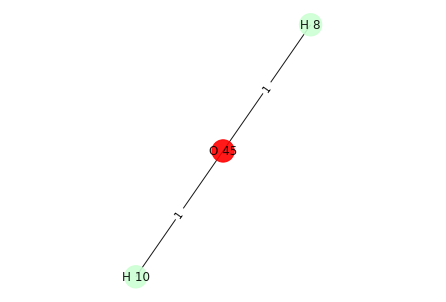

i: 3
Removing edge between: N 58 N 59
Adding edge between: N 58 H 9
O 45 0
H 11 0
N 58 0
O 46 0
H 8 0
N 59 1
H 9 0


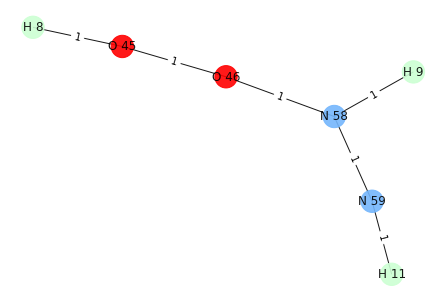

O 45 0
N 59 1
O 46 0
N 58 0
[N 59] H 10


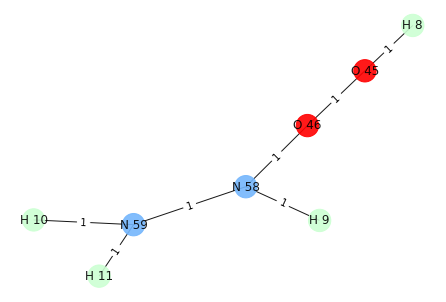

[{N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


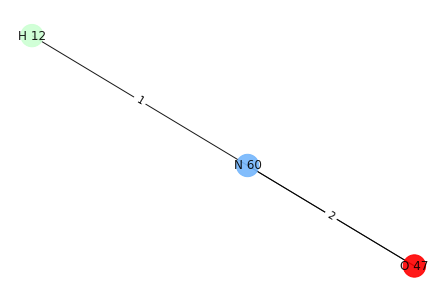

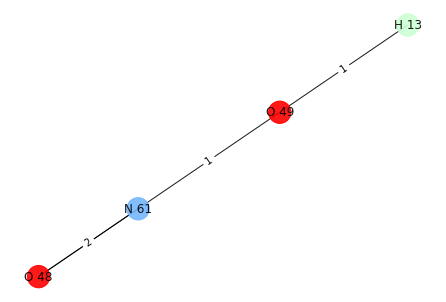

H 12
H 13
N 60 O 49


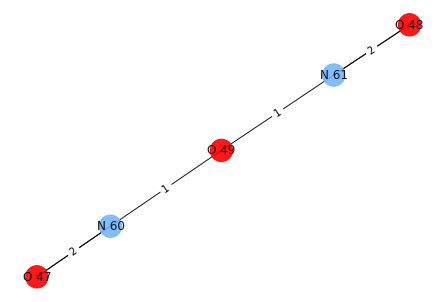

{N 60, O 49, N 61, O 47, O 48}
[N 60, O 49, N 61, O 47, O 48]
i: 0
Removing edge between: N 60 O 47
Adding edge between: N 60 H 12
N 60 0
O 49 0
N 61 0
H 12 0
O 47 1
O 48 0


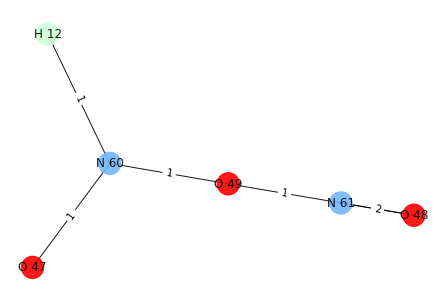

N 60 0
O 49 0
N 61 0
O 47 1
O 48 0
[O 47] H 13


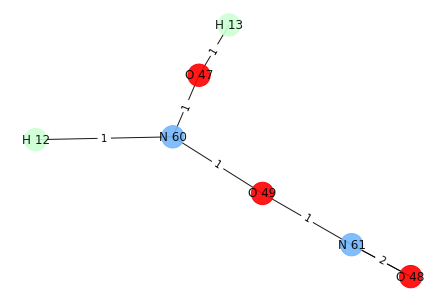

i: 1
Removing edge between: O 49 N 60
Adding edge between: O 49 H 12
N 61 0
O 49 0
H 12 0
O 48 0


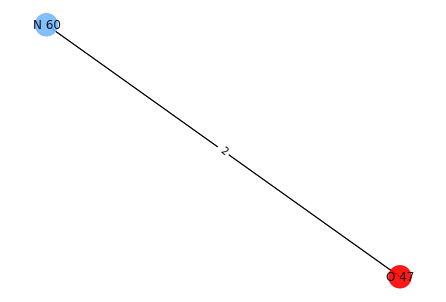

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


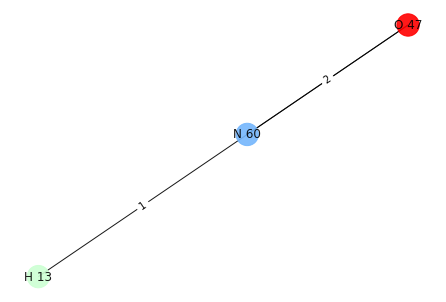

i: 2
Removing edge between: N 61 O 49
Adding edge between: N 61 H 12
N 61 0
H 12 0
O 48 0


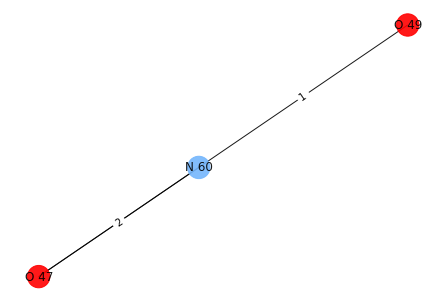

N 60 0
O 49 1
N 61 0
O 47 0
O 48 0
[O 49] H 13


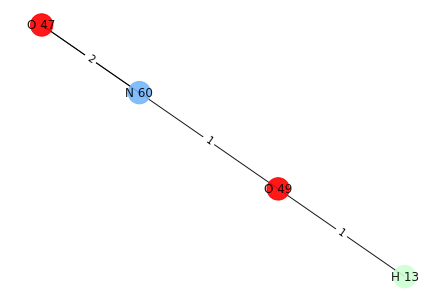

i: 3
Removing edge between: O 47 N 60
Adding edge between: O 47 H 12
N 60 1
O 49 0
N 61 0
H 12 0
O 47 0
O 48 0


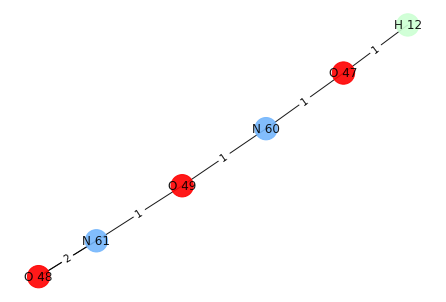

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


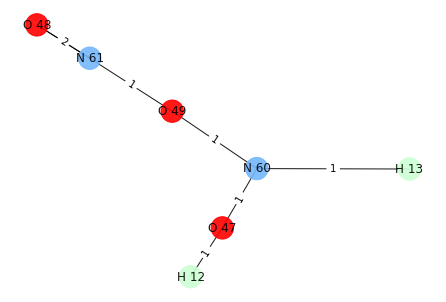

i: 4
Removing edge between: O 48 N 61
Adding edge between: O 48 H 12
N 60 0
O 49 0
N 61 1
H 12 0
O 47 0
O 48 0


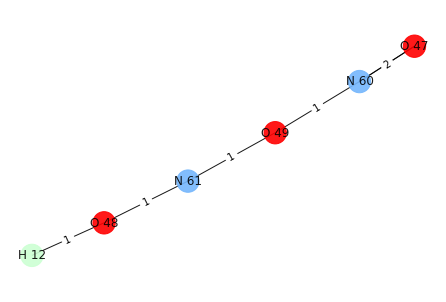

N 60 0
O 49 0
N 61 1
O 47 0
O 48 0
[N 61] H 13


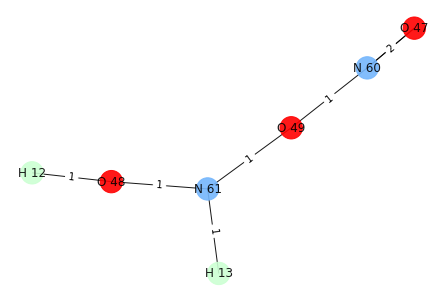

[{O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


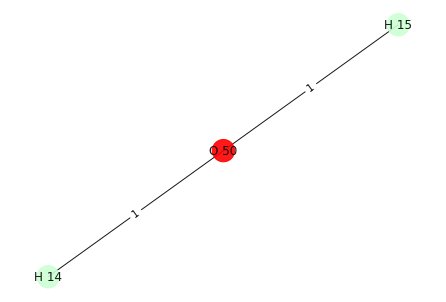

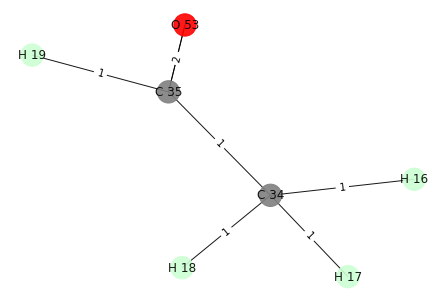

H 14
H 16
O 50 C 34


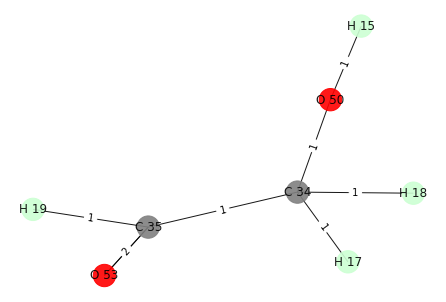

{O 53, H 15, H 19, O 50, C 34, C 35, H 17, H 18}
[O 53, C 34, C 35, O 50]
i: 0
Removing edge between: O 53 C 35
Adding edge between: O 53 H 14
O 53 0
H 19 0
H 15 0
C 34 0
O 50 0
H 18 0
C 35 1
H 17 0
H 14 0


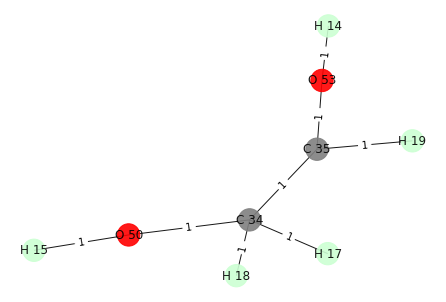

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 16


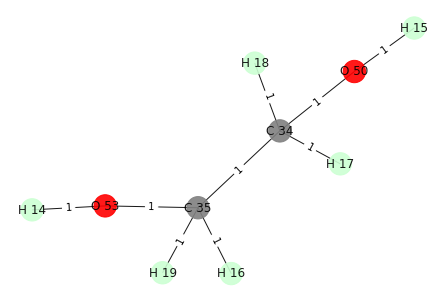

i: 1
Removing edge between: C 34 O 50
Adding edge between: C 34 H 14
O 53 0
H 19 0
C 34 0
H 18 0
C 35 0
H 17 0
H 14 0


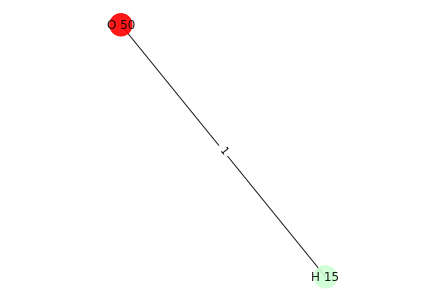

O 53 0
C 34 0
C 35 0
O 50 1
[O 50] H 16


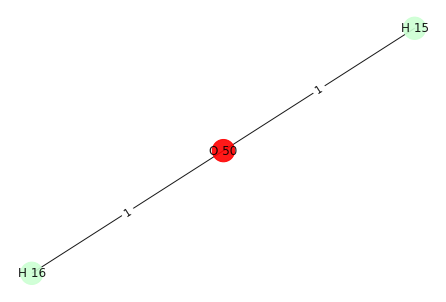

i: 2
Removing edge between: C 35 O 53
Adding edge between: C 35 H 14
O 53 1
H 19 0
H 15 0
C 34 0
O 50 0
H 18 0
C 35 0
H 17 0
H 14 0


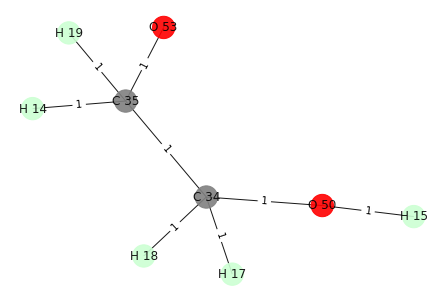

O 53 1
C 34 0
C 35 0
O 50 0
[O 53] H 16


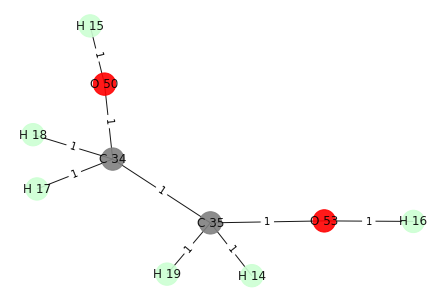

i: 3
Removing edge between: O 50 C 34
Adding edge between: O 50 H 14
O 50 0
H 14 0
H 15 0


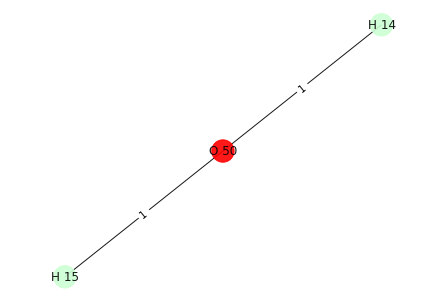

O 53 0
C 34 1
C 35 0
O 50 0
[C 34] H 16


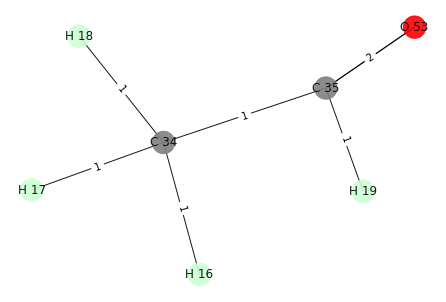

[{H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


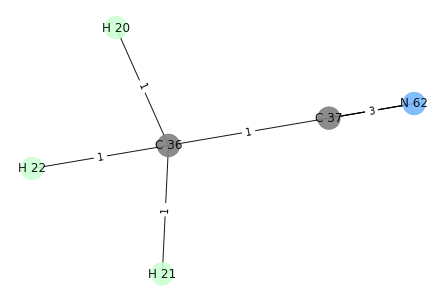

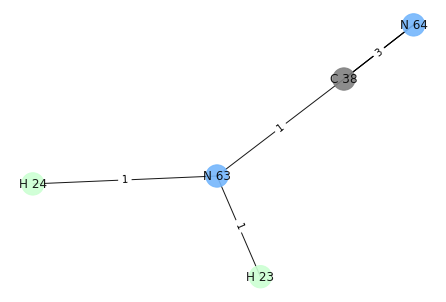

H 22
H 24
C 36 N 63


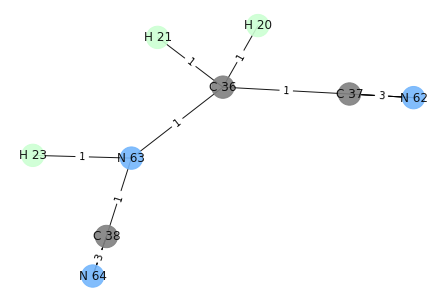

{N 63, C 38, H 23, H 20, C 37, N 62, H 21, C 36, N 64}
[C 38, C 37, N 62, N 63, C 36, N 64]
i: 0
Removing edge between: C 38 N 63
Adding edge between: C 38 H 22
N 64 0
H 22 0
C 38 0


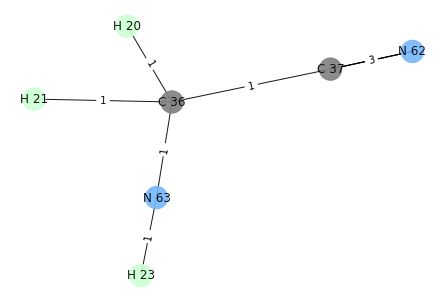

C 38 0
C 37 0
N 62 0
N 63 1
C 36 0
N 64 0
[N 63] H 24


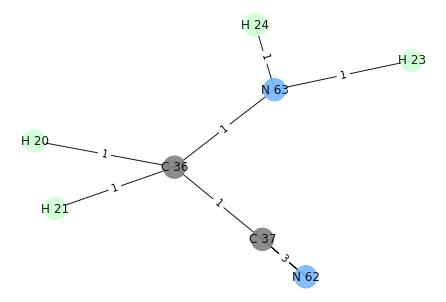

i: 1
Removing edge between: C 37 C 36
Adding edge between: C 37 H 22
C 37 0
H 22 0
N 62 0


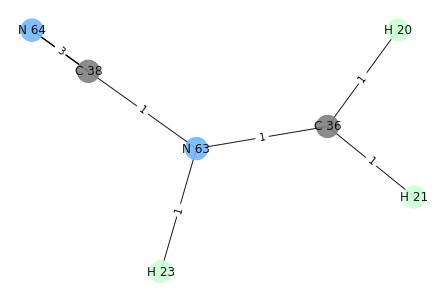

C 38 0
C 37 0
N 62 0
N 63 0
C 36 1
N 64 0
[C 36] H 24


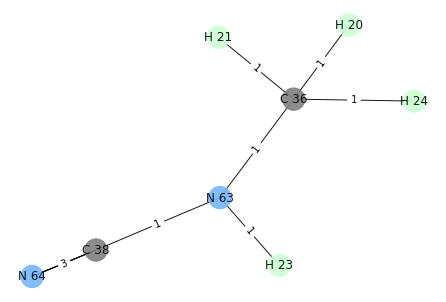

i: 2
Removing edge between: N 62 C 37
Adding edge between: N 62 H 22
N 63 0
H 23 0
C 38 0
H 20 0
C 37 1
N 62 0
N 64 0
H 21 0
C 36 0
H 22 0


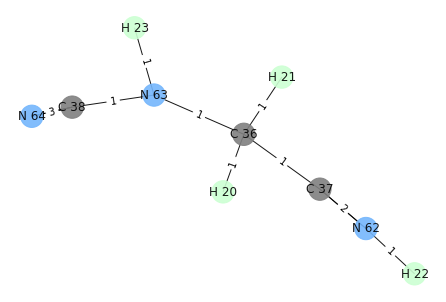

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


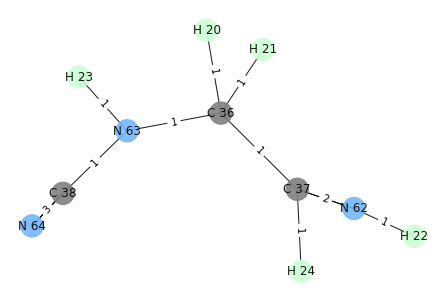

i: 3
Removing edge between: N 63 C 38
Adding edge between: N 63 H 22
H 23 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
H 22 0


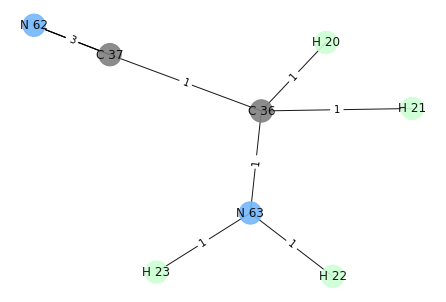

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


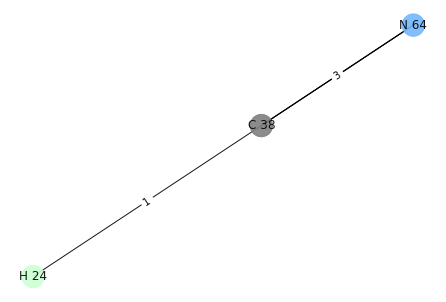

i: 4
Removing edge between: C 36 C 37
Adding edge between: C 36 H 22
N 63 0
H 23 0
C 38 0
H 20 0
N 64 0
H 21 0
C 36 0
H 22 0


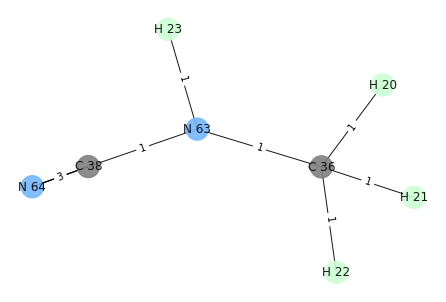

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


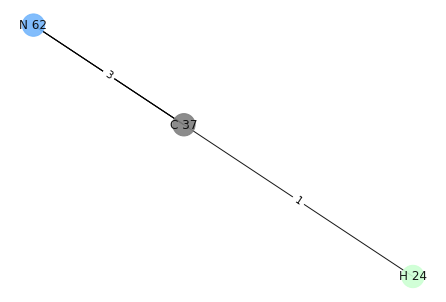

i: 5
Removing edge between: N 64 C 38
Adding edge between: N 64 H 22
C 38 1
H 23 0
H 22 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
N 64 0


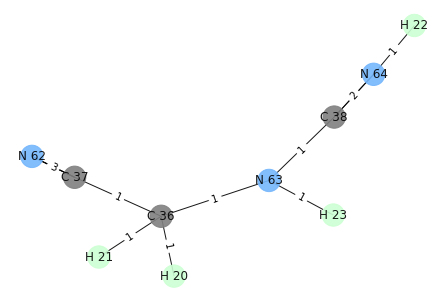

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


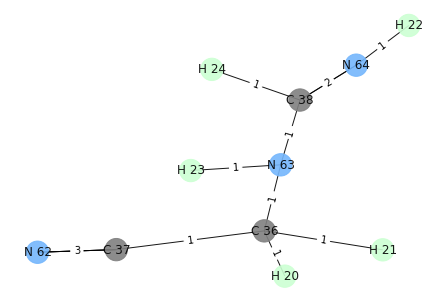

[{H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


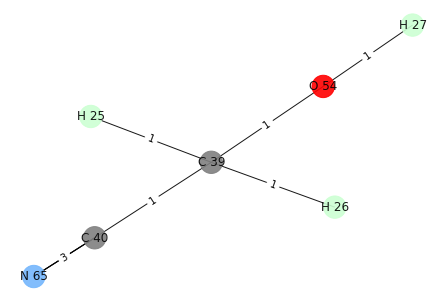

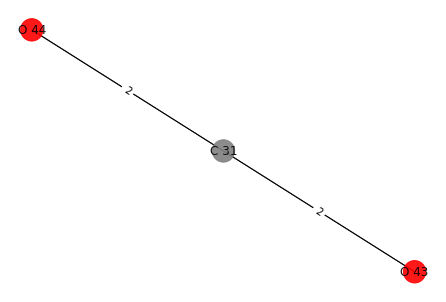

[{O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


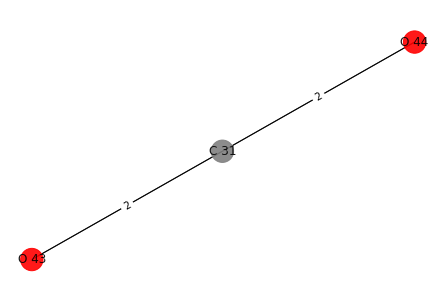

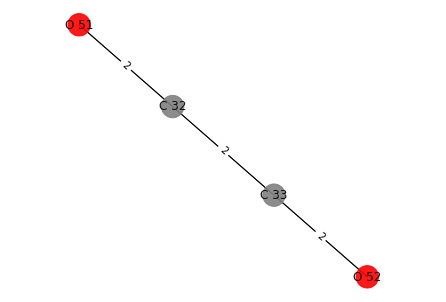

[{C 32, C 33, O 51, O 52}]
15
[{C 28, H 2, O 41, H 1}, {H 3, C 29, N 55}, {N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]
{C 28, H 2, O 41, H 1}
{H 3, C 29, N 55}
7


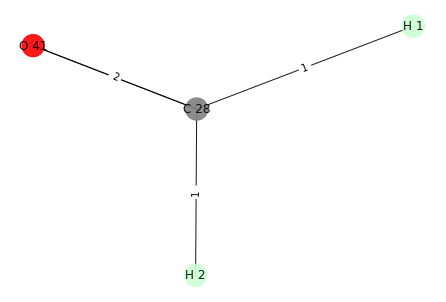

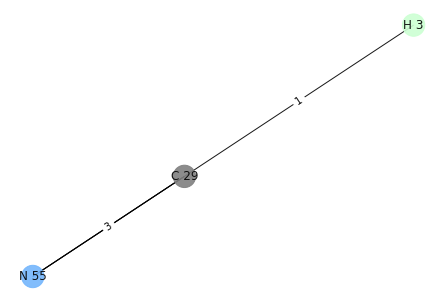

H 2
H 3
C 28 C 29


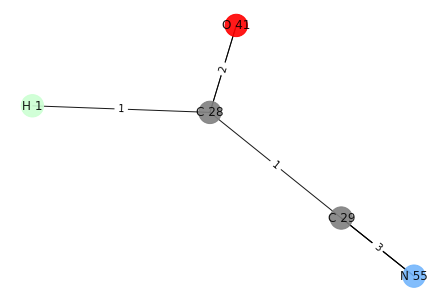

{C 28, H 1, C 29, O 41, N 55}
[C 28, O 41, C 29, N 55]
i: 0
Removing edge between: C 28 O 41
Adding edge between: C 28 H 2
C 28 0
C 29 0
H 1 0
O 41 1
H 2 0
N 55 0


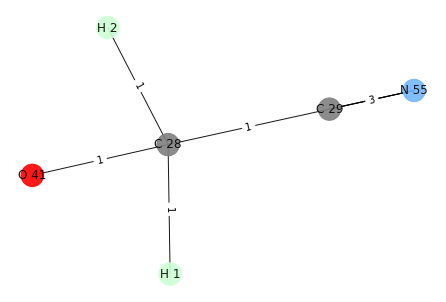

C 28 0
O 41 1
C 29 0
N 55 0
[O 41] H 3


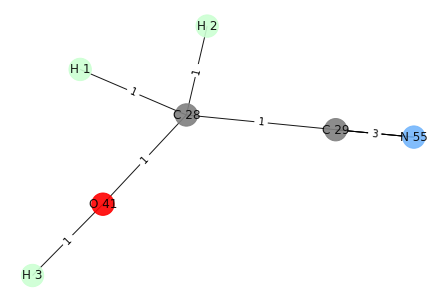

i: 1
Removing edge between: O 41 C 28
Adding edge between: O 41 H 2
C 28 1
C 29 0
H 1 0
O 41 0
H 2 0
N 55 0


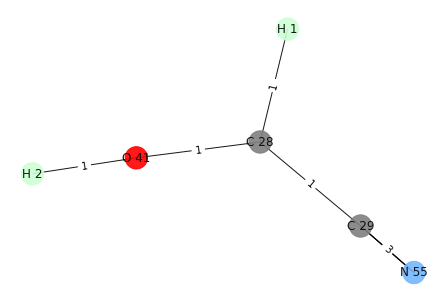

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


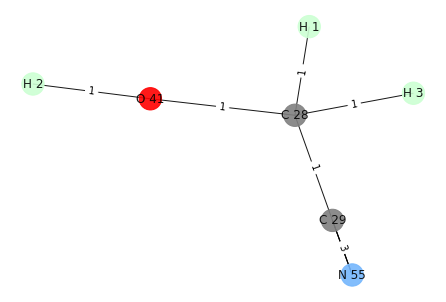

i: 2
Removing edge between: C 29 C 28
Adding edge between: C 29 H 2
H 2 0
C 29 0
N 55 0


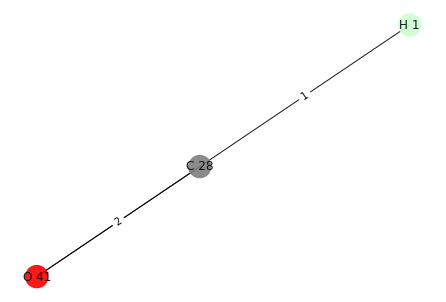

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


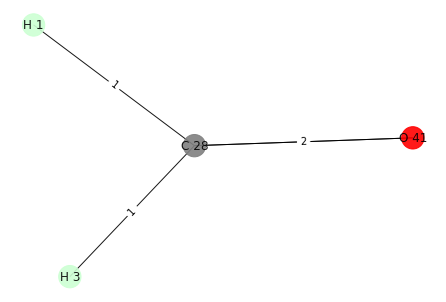

i: 3
Removing edge between: N 55 C 29
Adding edge between: N 55 H 2
C 28 0
C 29 1
H 1 0
O 41 0
H 2 0
N 55 0


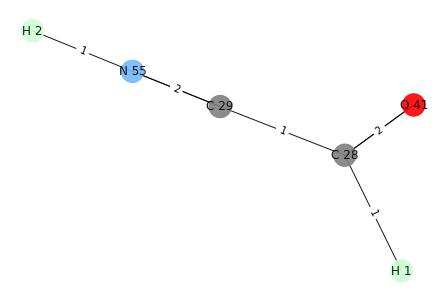

C 28 0
O 41 0
C 29 1
N 55 0
[C 29] H 3


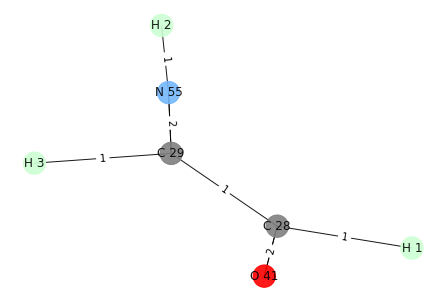

[{N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


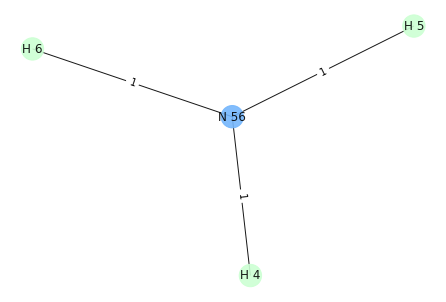

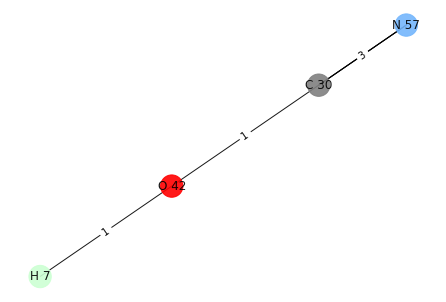

H 5
H 7
N 56 O 42


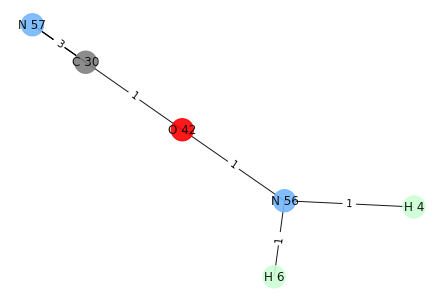

{H 6, O 42, H 4, C 30, N 56, N 57}
[O 42, N 56, C 30, N 57]
i: 0
Removing edge between: O 42 C 30
Adding edge between: O 42 H 5
H 6 0
O 42 0
H 4 0
H 5 0
N 56 0


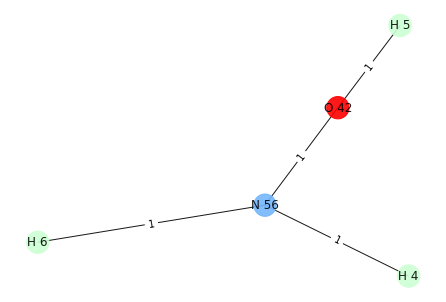

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


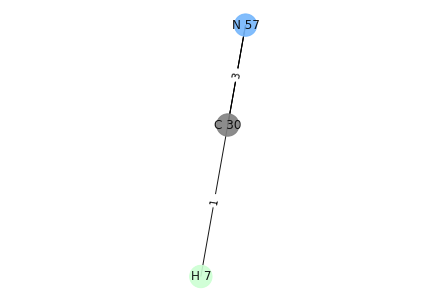

i: 1
Removing edge between: N 56 O 42
Adding edge between: N 56 H 5
N 56 0
H 6 0
H 5 0
H 4 0


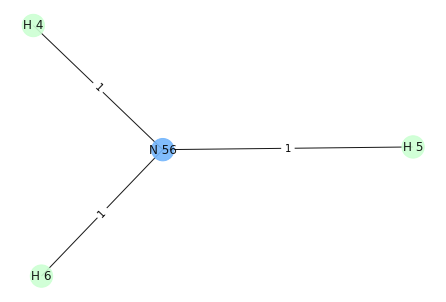

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


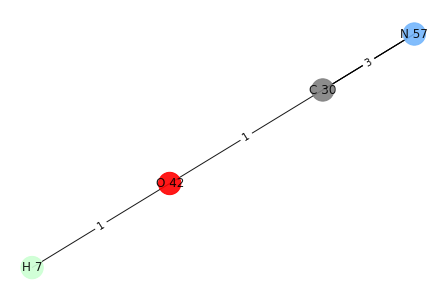

i: 2
Removing edge between: C 30 O 42
Adding edge between: C 30 H 5
N 57 0
C 30 0
H 5 0


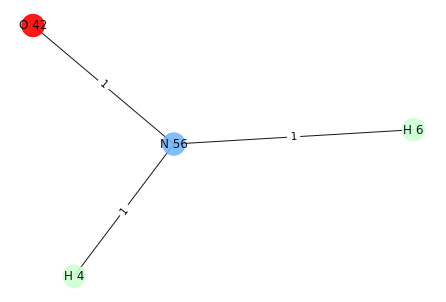

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


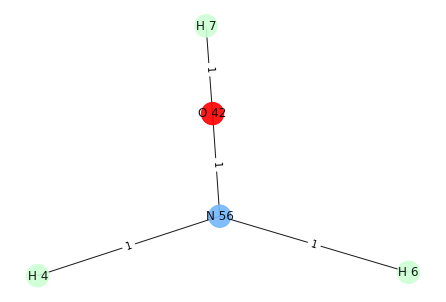

i: 3
Removing edge between: N 57 C 30
Adding edge between: N 57 H 5
H 6 0
O 42 0
H 4 0
C 30 1
H 5 0
N 57 0
N 56 0


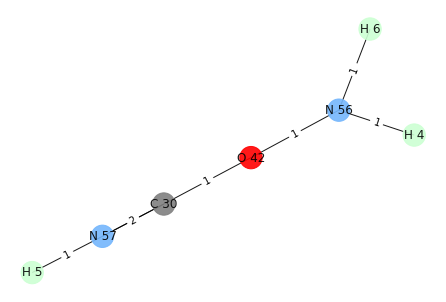

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


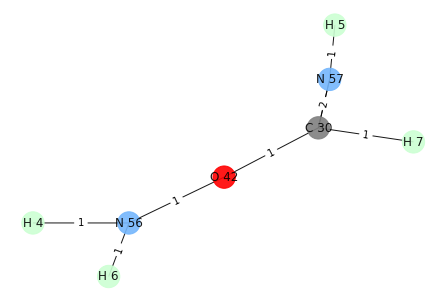

[{H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


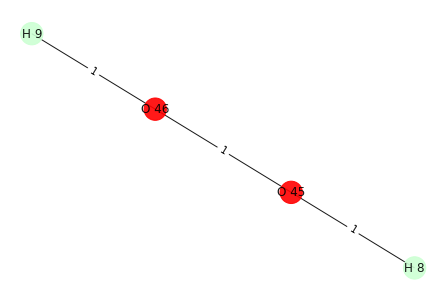

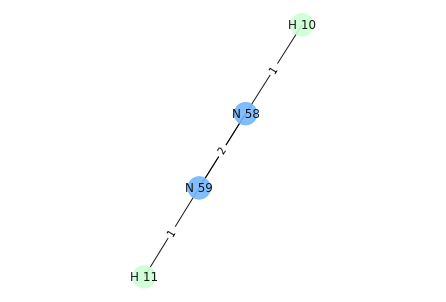

H 9
H 10
O 46 N 58


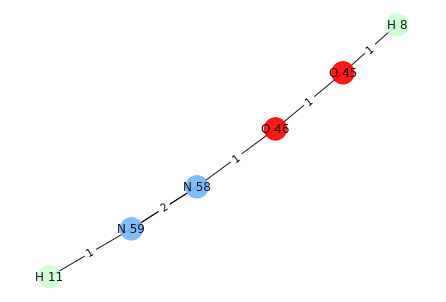

{O 45, H 11, N 58, O 46, H 8, N 59}
[O 45, N 59, O 46, N 58]
i: 0
Removing edge between: O 45 O 46
Adding edge between: O 45 H 9
H 9 0
H 8 0
O 45 0


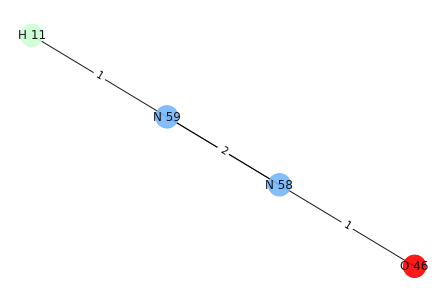

O 45 0
N 59 0
O 46 1
N 58 0
[O 46] H 10


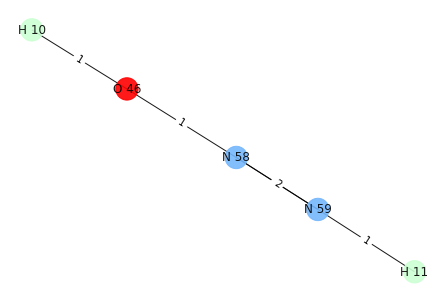

i: 1
Removing edge between: N 59 N 58
Adding edge between: N 59 H 9
O 45 0
H 11 0
N 58 1
O 46 0
H 8 0
N 59 0
H 9 0


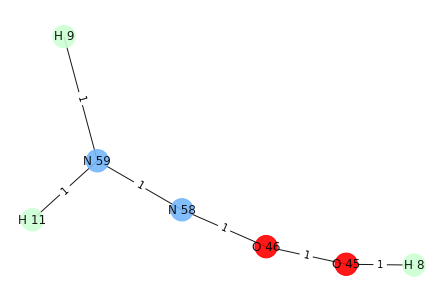

O 45 0
N 59 0
O 46 0
N 58 1
[N 58] H 10


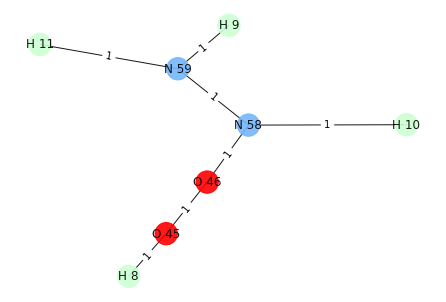

i: 2
Removing edge between: O 46 O 45
Adding edge between: O 46 H 9
H 11 0
N 58 0
O 46 0
N 59 0
H 9 0


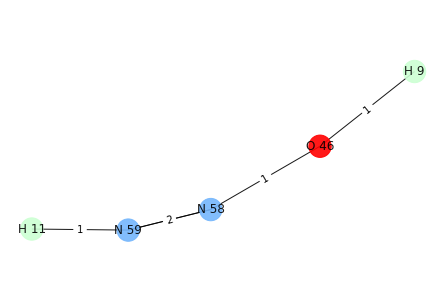

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 10


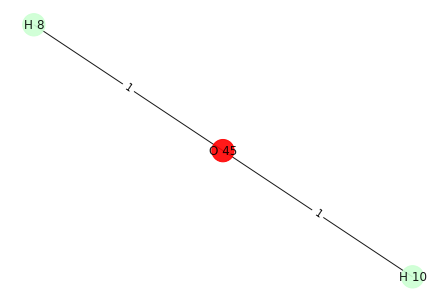

i: 3
Removing edge between: N 58 N 59
Adding edge between: N 58 H 9
O 45 0
H 11 0
N 58 0
O 46 0
H 8 0
N 59 1
H 9 0


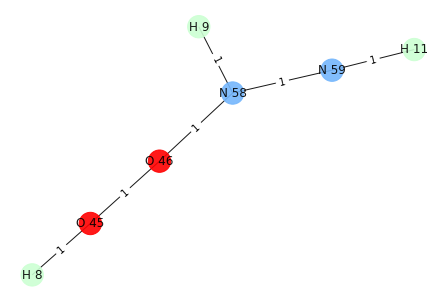

O 45 0
N 59 1
O 46 0
N 58 0
[N 59] H 10


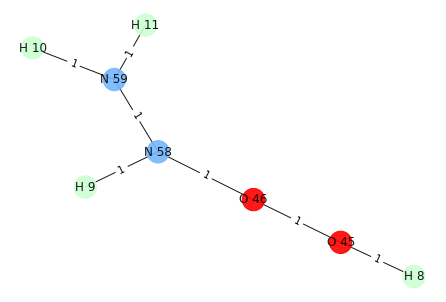

[{N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


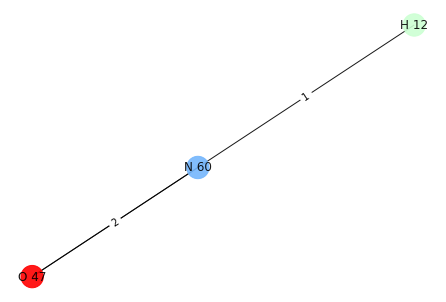

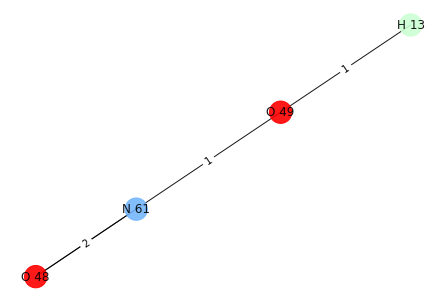

H 12
H 13
N 60 O 49


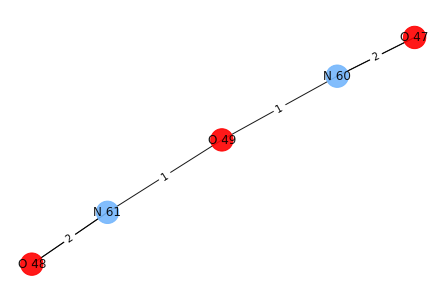

{N 60, O 49, N 61, O 47, O 48}
[N 60, O 49, N 61, O 47, O 48]
i: 0
Removing edge between: N 60 O 47
Adding edge between: N 60 H 12
N 60 0
O 49 0
N 61 0
H 12 0
O 47 1
O 48 0


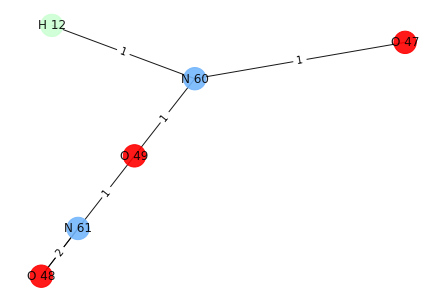

N 60 0
O 49 0
N 61 0
O 47 1
O 48 0
[O 47] H 13


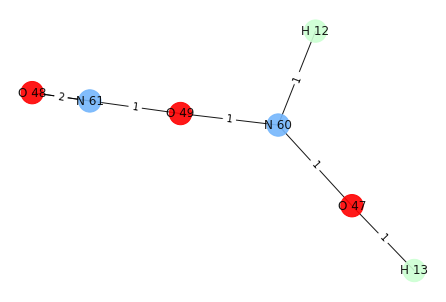

i: 1
Removing edge between: O 49 N 60
Adding edge between: O 49 H 12
N 61 0
O 49 0
H 12 0
O 48 0


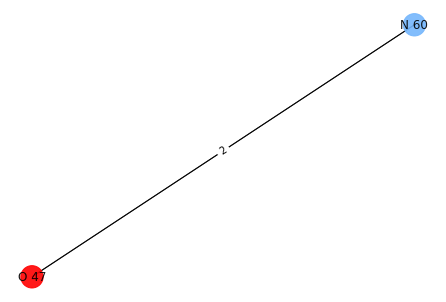

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


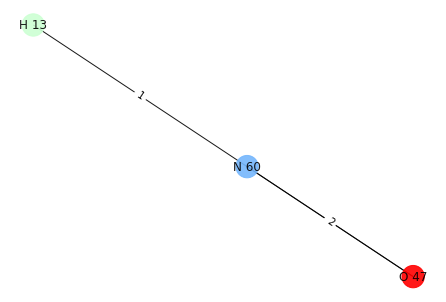

i: 2
Removing edge between: N 61 O 49
Adding edge between: N 61 H 12
N 61 0
H 12 0
O 48 0


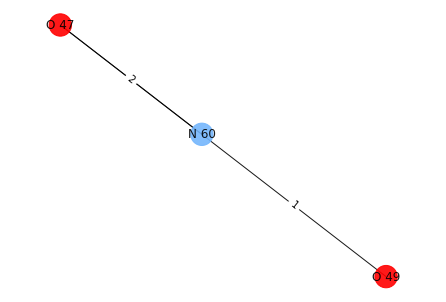

N 60 0
O 49 1
N 61 0
O 47 0
O 48 0
[O 49] H 13


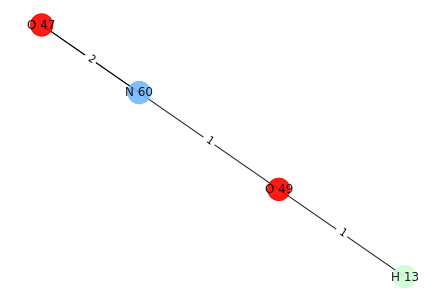

i: 3
Removing edge between: O 47 N 60
Adding edge between: O 47 H 12
N 60 1
O 49 0
N 61 0
H 12 0
O 47 0
O 48 0


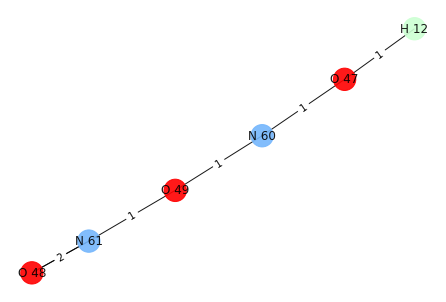

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


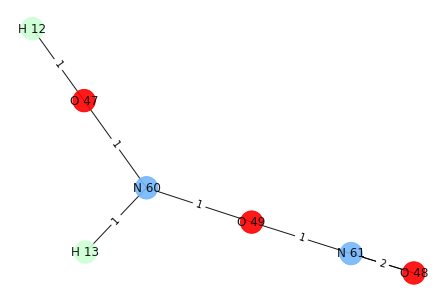

i: 4
Removing edge between: O 48 N 61
Adding edge between: O 48 H 12
N 60 0
O 49 0
N 61 1
H 12 0
O 47 0
O 48 0


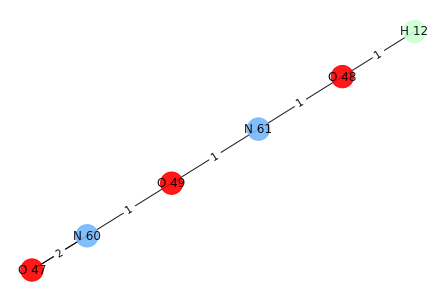

N 60 0
O 49 0
N 61 1
O 47 0
O 48 0
[N 61] H 13


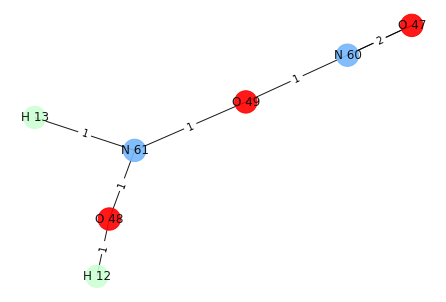

[{O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


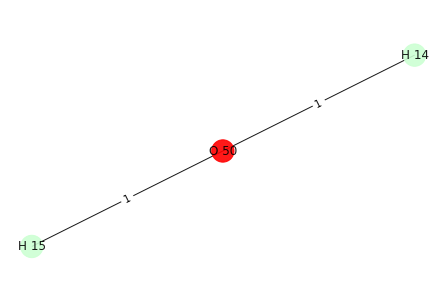

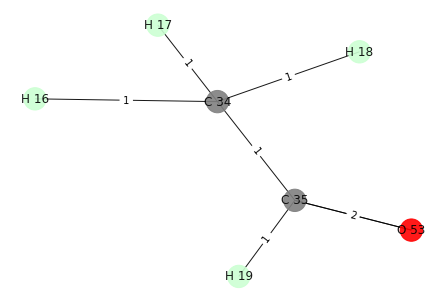

H 15
H 19
O 50 C 35


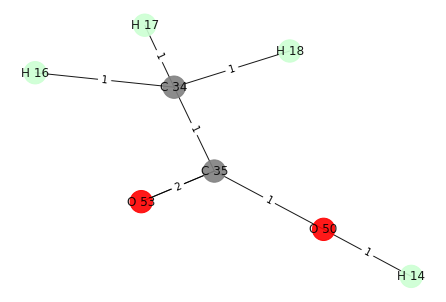

{O 53, O 50, C 34, H 18, H 16, C 35, H 17, H 14}
[O 53, C 34, C 35, O 50]
i: 0
Removing edge between: O 53 C 35
Adding edge between: O 53 H 15
O 53 0
H 15 0
H 14 0
O 50 0
C 34 0
H 16 0
C 35 1
H 17 0
H 18 0


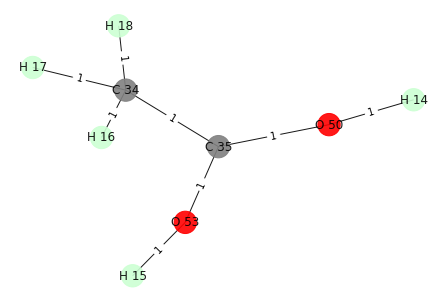

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 19


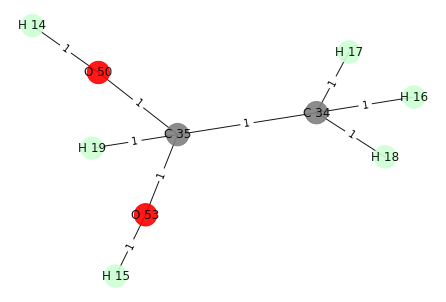

i: 1
Removing edge between: C 34 C 35
Adding edge between: C 34 H 15
H 15 0
C 34 0
H 16 0
H 17 0
H 18 0


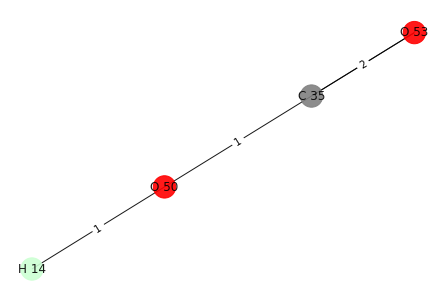

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 19


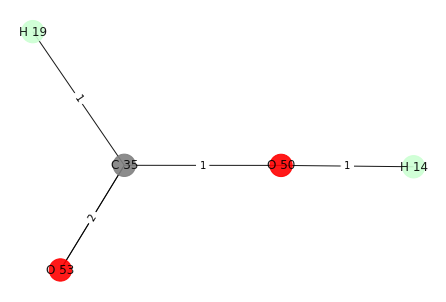

i: 2
Removing edge between: C 35 O 53
Adding edge between: C 35 H 15
O 53 1
H 15 0
H 14 0
C 34 0
O 50 0
H 16 0
C 35 0
H 17 0
H 18 0


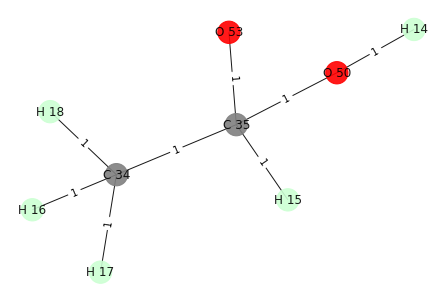

O 53 1
C 34 0
C 35 0
O 50 0
[O 53] H 19


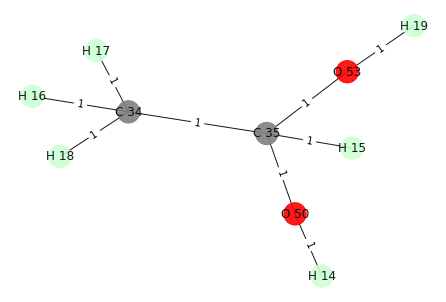

i: 3
Removing edge between: O 50 C 35
Adding edge between: O 50 H 15
O 50 0
H 15 0
H 14 0


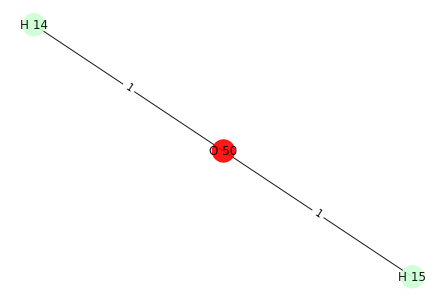

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 19


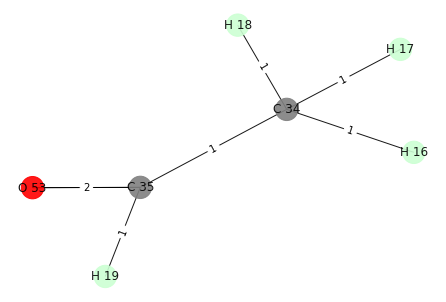

[{H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


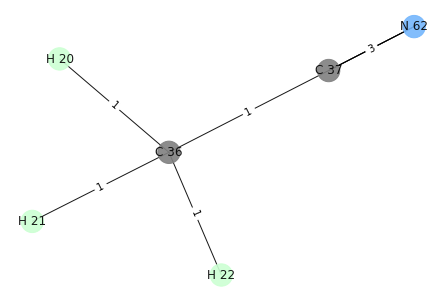

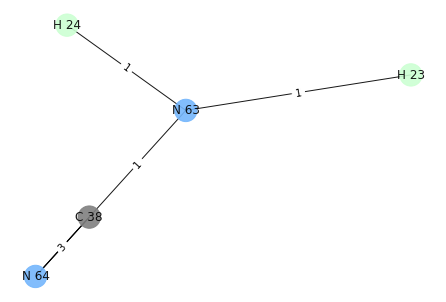

H 20
H 24
C 36 N 63


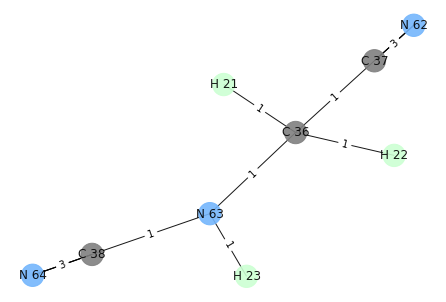

{N 63, C 38, H 23, C 37, N 62, N 64, H 21, C 36, H 22}
[C 38, C 37, N 62, N 63, C 36, N 64]
i: 0
Removing edge between: C 38 N 63
Adding edge between: C 38 H 20
N 64 0
H 20 0
C 38 0


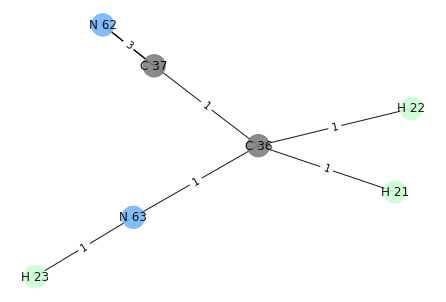

C 38 0
C 37 0
N 62 0
N 63 1
C 36 0
N 64 0
[N 63] H 24


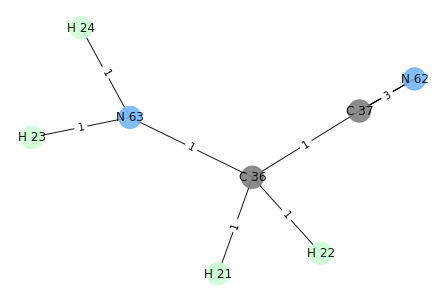

i: 1
Removing edge between: C 37 C 36
Adding edge between: C 37 H 20
C 37 0
H 20 0
N 62 0


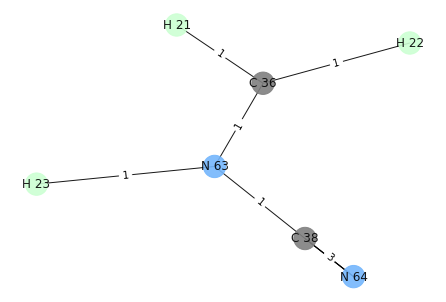

C 38 0
C 37 0
N 62 0
N 63 0
C 36 1
N 64 0
[C 36] H 24


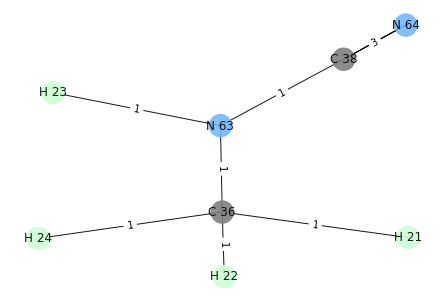

i: 2
Removing edge between: N 62 C 37
Adding edge between: N 62 H 20
N 63 0
H 23 0
C 38 0
H 20 0
C 37 1
N 62 0
N 64 0
H 21 0
C 36 0
H 22 0


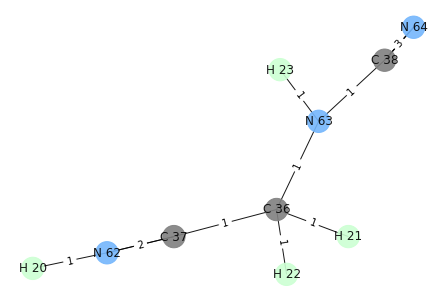

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


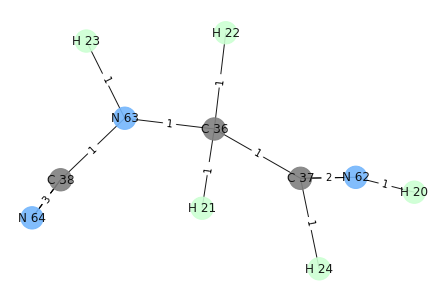

i: 3
Removing edge between: N 63 C 38
Adding edge between: N 63 H 20
H 23 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
H 22 0


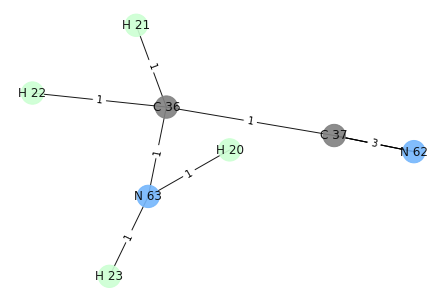

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


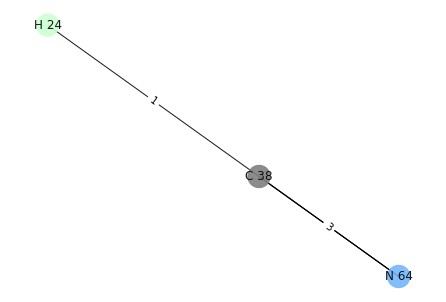

i: 4
Removing edge between: C 36 C 37
Adding edge between: C 36 H 20
N 63 0
H 23 0
C 38 0
H 20 0
N 64 0
H 21 0
C 36 0
H 22 0


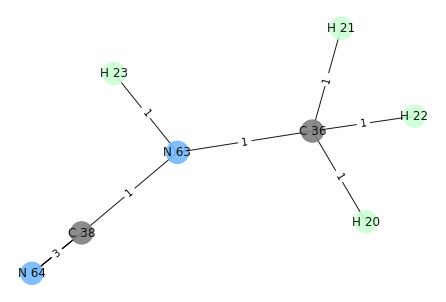

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


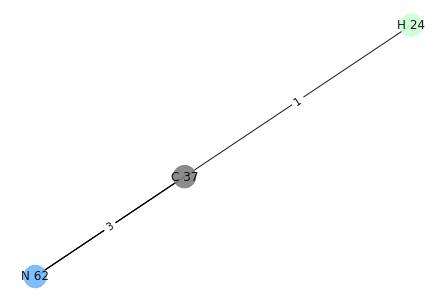

i: 5
Removing edge between: N 64 C 38
Adding edge between: N 64 H 20
C 38 1
H 23 0
H 22 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
N 64 0


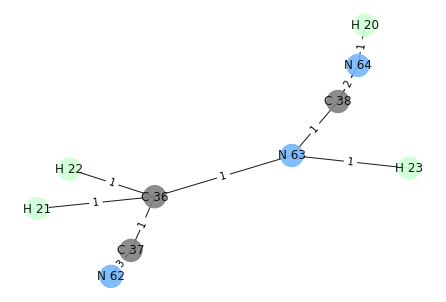

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


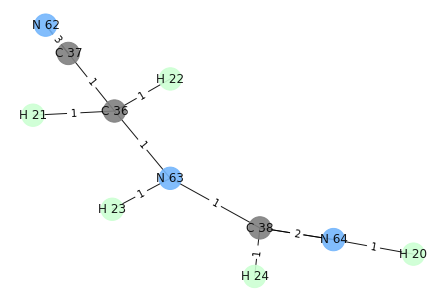

[{H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


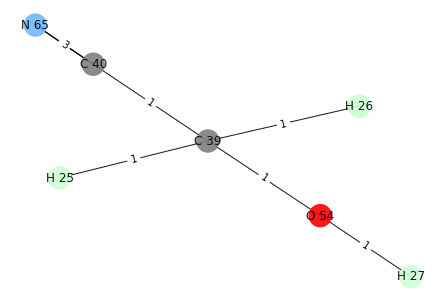

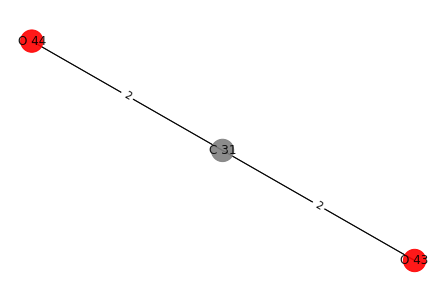

[{O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


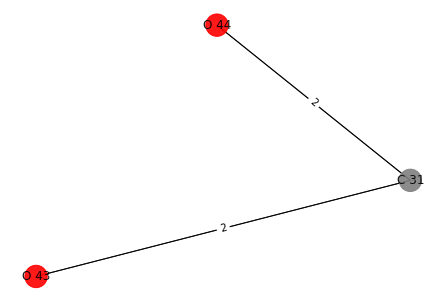

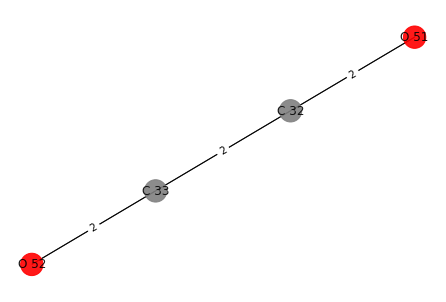

[{C 32, C 33, O 51, O 52}]
15
[{C 28, H 2, O 41, H 1}, {H 3, C 29, N 55}, {N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]
{C 28, H 2, O 41, H 1}
{H 3, C 29, N 55}
7


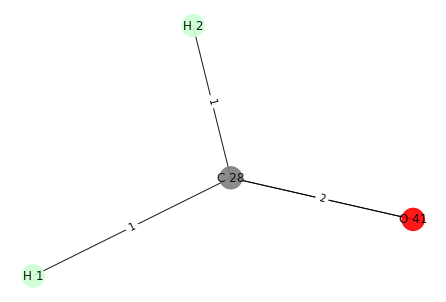

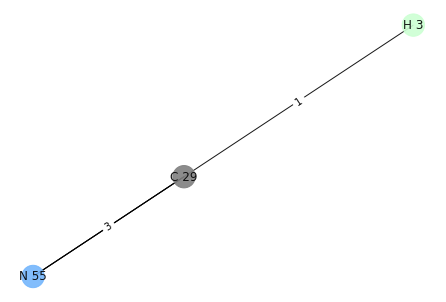

H 1
H 3
C 28 C 29


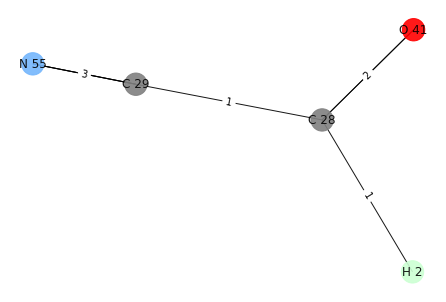

{C 28, C 29, H 2, O 41, N 55}
[C 28, O 41, C 29, N 55]
i: 0
Removing edge between: C 28 O 41
Adding edge between: C 28 H 1
C 28 0
H 1 0
C 29 0
H 2 0
O 41 1
N 55 0


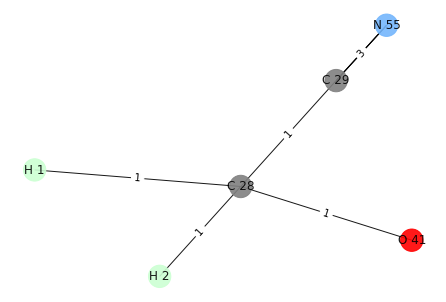

C 28 0
O 41 1
C 29 0
N 55 0
[O 41] H 3


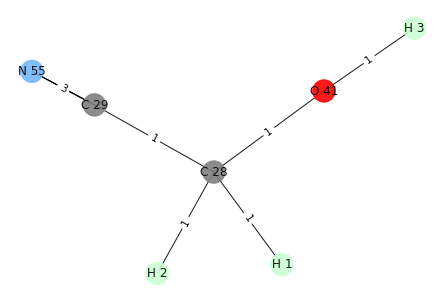

i: 1
Removing edge between: O 41 C 28
Adding edge between: O 41 H 1
C 28 1
H 1 0
C 29 0
H 2 0
O 41 0
N 55 0


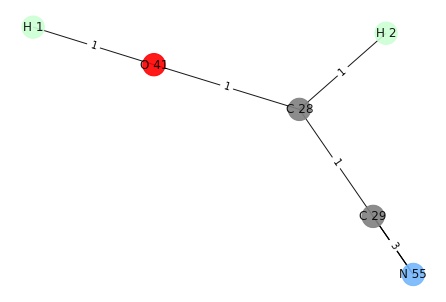

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


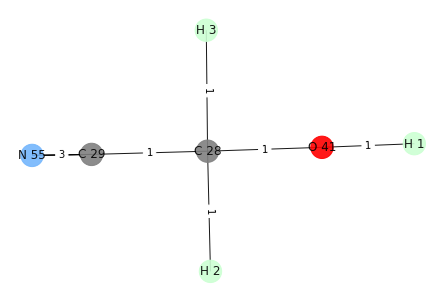

i: 2
Removing edge between: C 29 C 28
Adding edge between: C 29 H 1
H 1 0
C 29 0
N 55 0


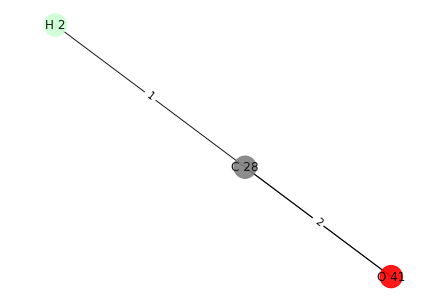

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


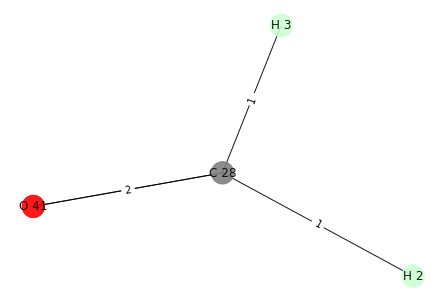

i: 3
Removing edge between: N 55 C 29
Adding edge between: N 55 H 1
C 28 0
H 1 0
C 29 1
O 41 0
H 2 0
N 55 0


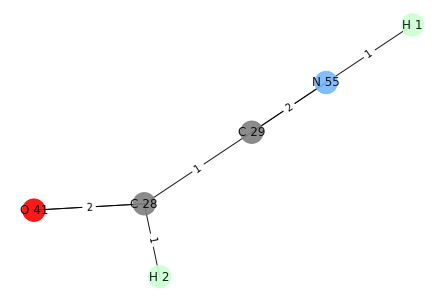

C 28 0
O 41 0
C 29 1
N 55 0
[C 29] H 3


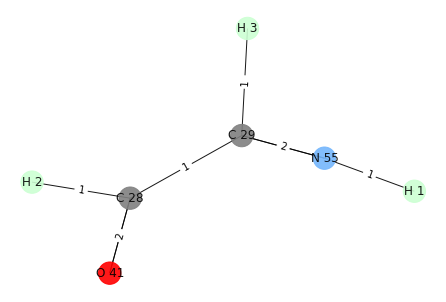

[{N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


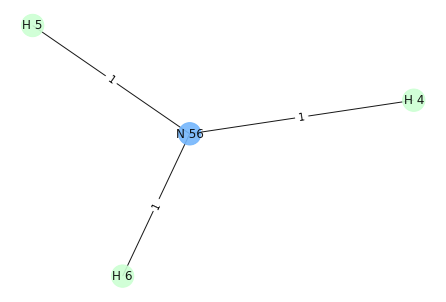

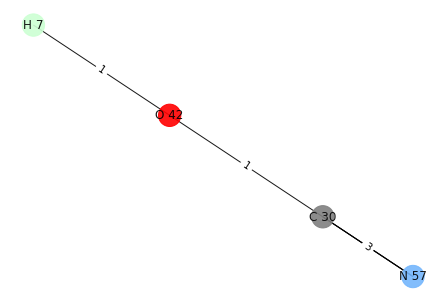

H 4
H 7
N 56 O 42


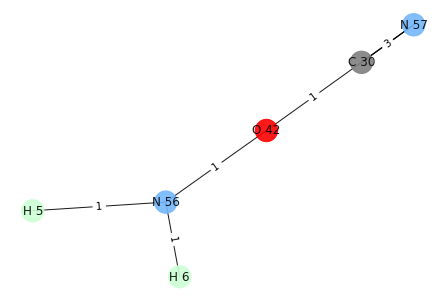

{H 6, O 42, C 30, H 5, N 56, N 57}
[O 42, N 56, C 30, N 57]
i: 0
Removing edge between: O 42 C 30
Adding edge between: O 42 H 4
H 6 0
O 42 0
H 4 0
H 5 0
N 56 0


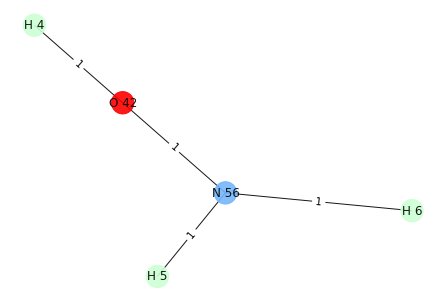

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


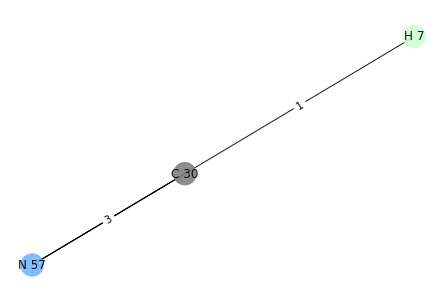

i: 1
Removing edge between: N 56 O 42
Adding edge between: N 56 H 4
N 56 0
H 6 0
H 4 0
H 5 0


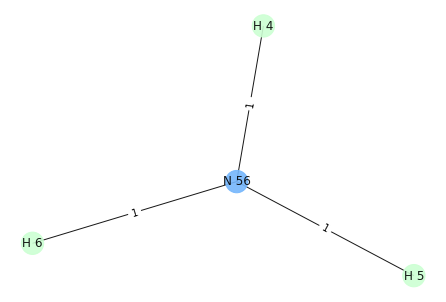

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


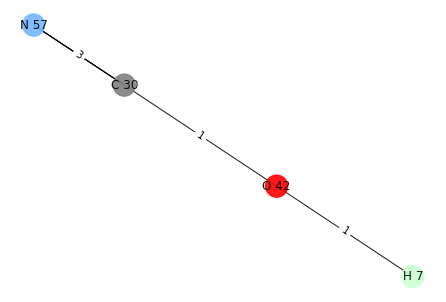

i: 2
Removing edge between: C 30 O 42
Adding edge between: C 30 H 4
N 57 0
C 30 0
H 4 0


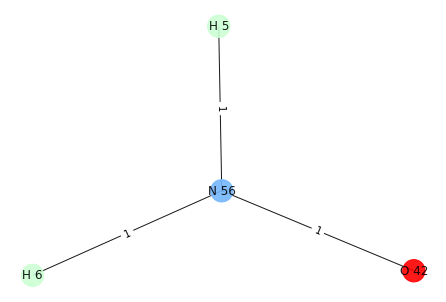

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


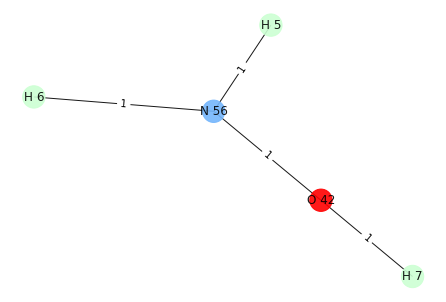

i: 3
Removing edge between: N 57 C 30
Adding edge between: N 57 H 4
H 6 0
O 42 0
H 4 0
C 30 1
H 5 0
N 57 0
N 56 0


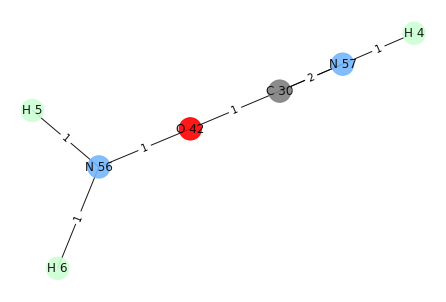

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


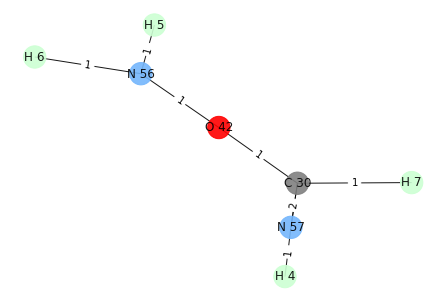

[{H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


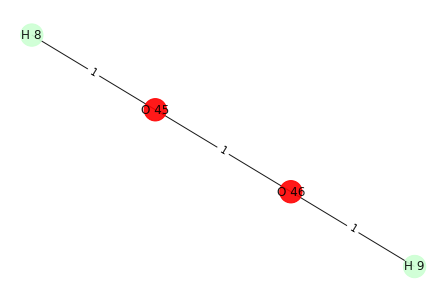

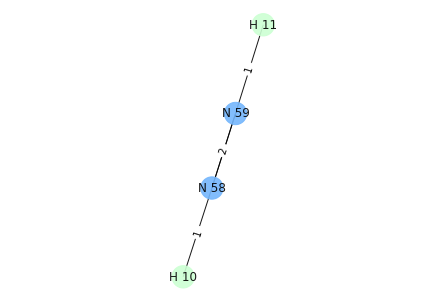

H 9
H 11
O 46 N 59


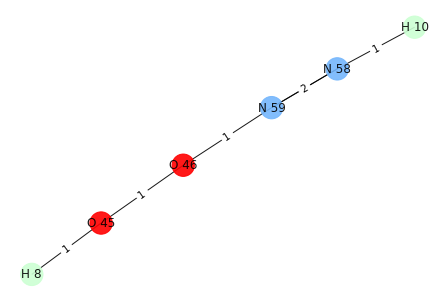

{O 45, N 58, O 46, H 8, N 59, H 10}
[O 45, N 59, O 46, N 58]
i: 0
Removing edge between: O 45 O 46
Adding edge between: O 45 H 9
H 9 0
H 8 0
O 45 0


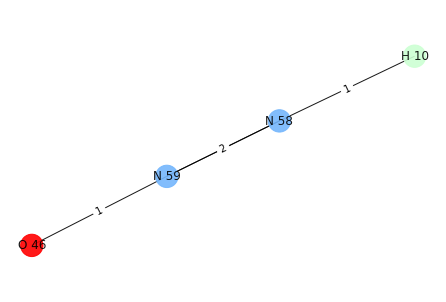

O 45 0
N 59 0
O 46 1
N 58 0
[O 46] H 11


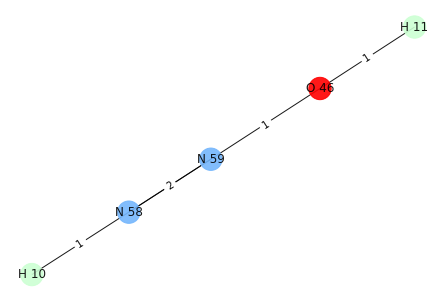

i: 1
Removing edge between: N 59 N 58
Adding edge between: N 59 H 9
O 45 0
N 58 1
O 46 0
H 8 0
N 59 0
H 9 0
H 10 0


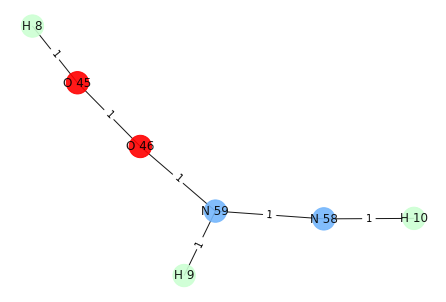

O 45 0
N 59 0
O 46 0
N 58 1
[N 58] H 11


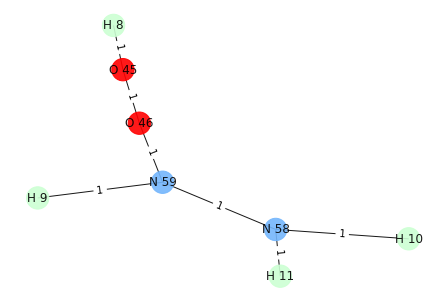

i: 2
Removing edge between: O 46 O 45
Adding edge between: O 46 H 9
N 58 0
O 46 0
N 59 0
H 9 0
H 10 0


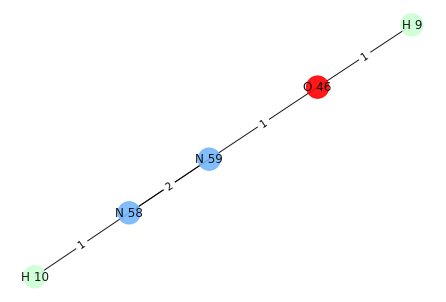

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 11


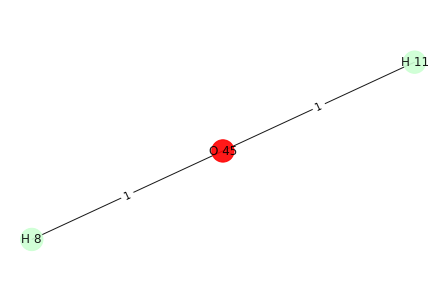

i: 3
Removing edge between: N 58 N 59
Adding edge between: N 58 H 9
O 45 0
N 58 0
O 46 0
H 8 0
N 59 1
H 9 0
H 10 0


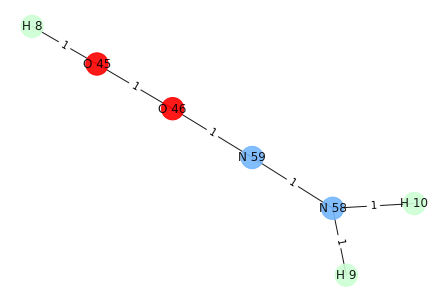

O 45 0
N 59 1
O 46 0
N 58 0
[N 59] H 11


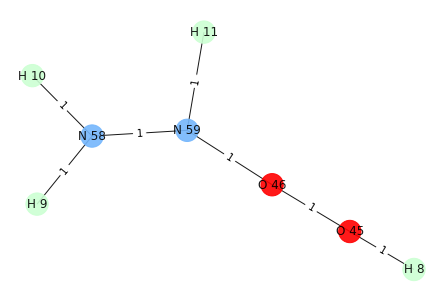

[{N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


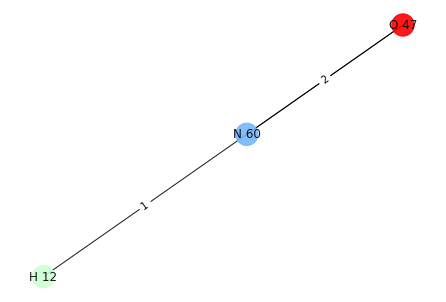

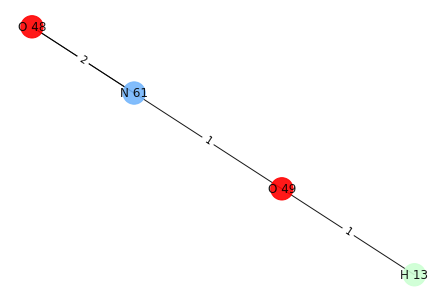

H 12
H 13
N 60 O 49


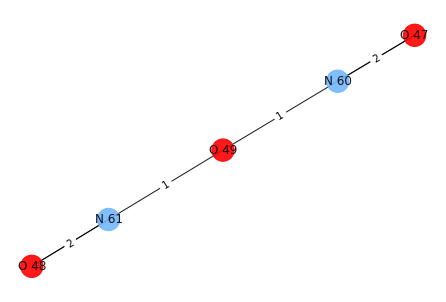

{N 60, O 49, N 61, O 47, O 48}
[N 60, O 49, N 61, O 47, O 48]
i: 0
Removing edge between: N 60 O 47
Adding edge between: N 60 H 12
N 60 0
O 49 0
N 61 0
H 12 0
O 47 1
O 48 0


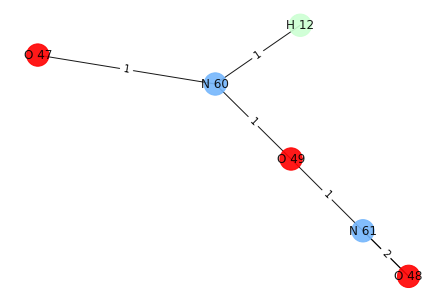

N 60 0
O 49 0
N 61 0
O 47 1
O 48 0
[O 47] H 13


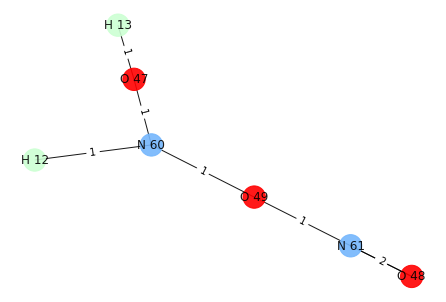

i: 1
Removing edge between: O 49 N 60
Adding edge between: O 49 H 12
N 61 0
O 49 0
H 12 0
O 48 0


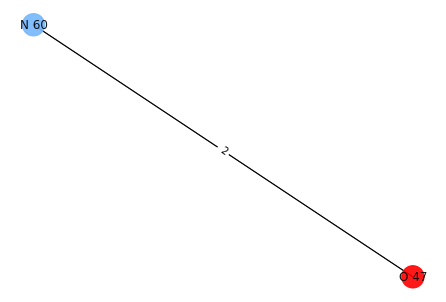

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


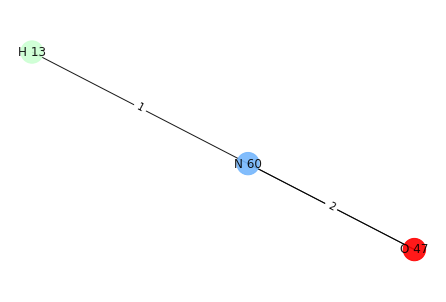

i: 2
Removing edge between: N 61 O 49
Adding edge between: N 61 H 12
N 61 0
H 12 0
O 48 0


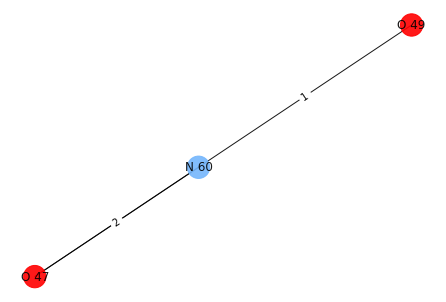

N 60 0
O 49 1
N 61 0
O 47 0
O 48 0
[O 49] H 13


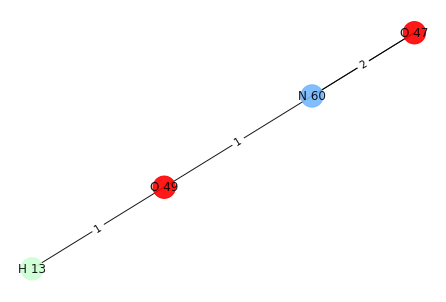

i: 3
Removing edge between: O 47 N 60
Adding edge between: O 47 H 12
N 60 1
O 49 0
N 61 0
H 12 0
O 47 0
O 48 0


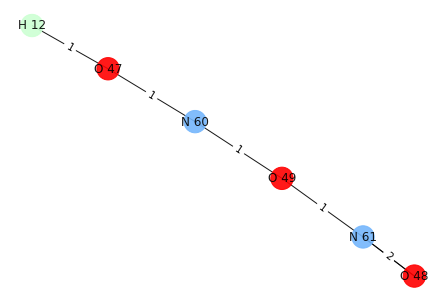

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


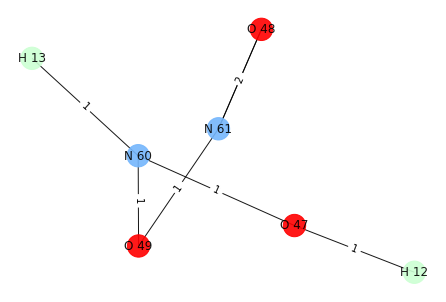

i: 4
Removing edge between: O 48 N 61
Adding edge between: O 48 H 12
N 60 0
O 49 0
N 61 1
H 12 0
O 47 0
O 48 0


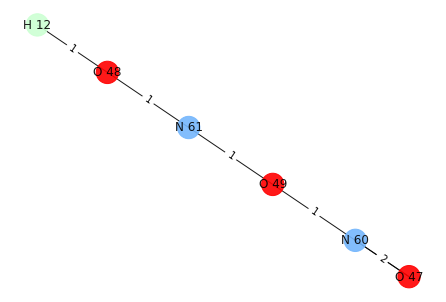

N 60 0
O 49 0
N 61 1
O 47 0
O 48 0
[N 61] H 13


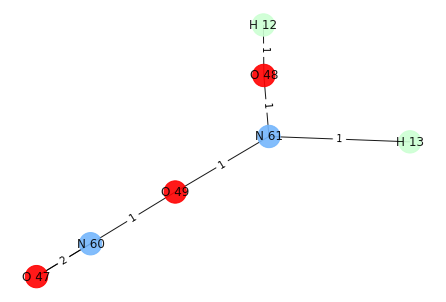

[{O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


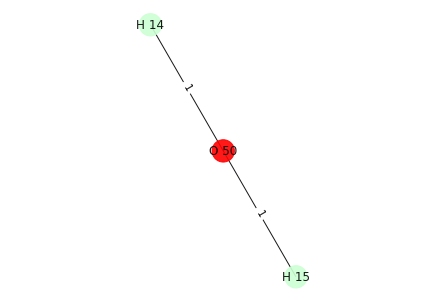

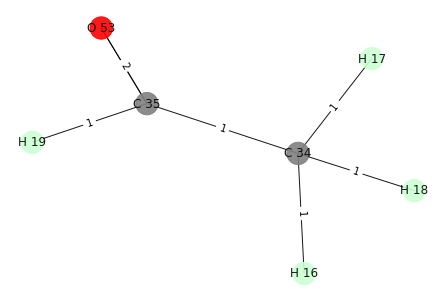

H 14
H 19
O 50 C 35


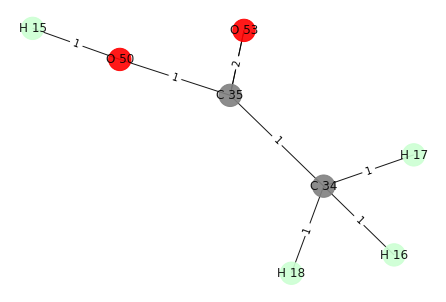

{O 53, H 15, O 50, C 34, H 16, C 35, H 17, H 18}
[O 53, C 34, C 35, O 50]
i: 0
Removing edge between: O 53 C 35
Adding edge between: O 53 H 14
O 53 0
H 15 0
O 50 0
C 34 0
H 18 0
H 16 0
C 35 1
H 17 0
H 14 0


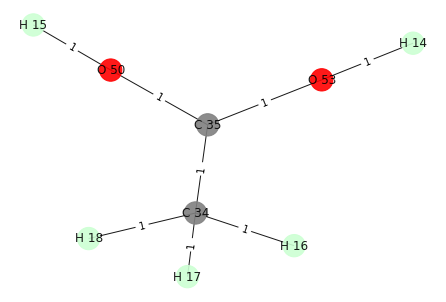

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 19


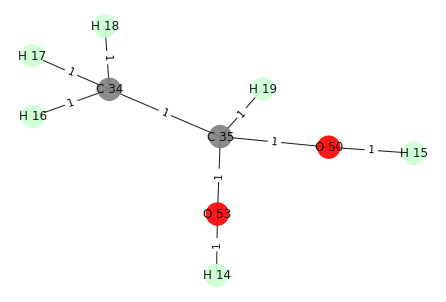

i: 1
Removing edge between: C 34 C 35
Adding edge between: C 34 H 14
H 14 0
C 34 0
H 16 0
H 17 0
H 18 0


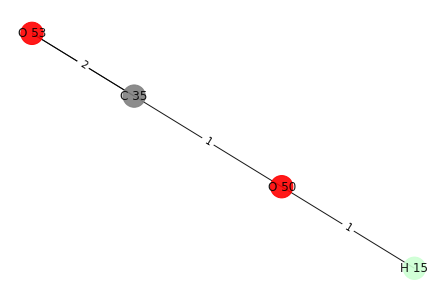

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 19


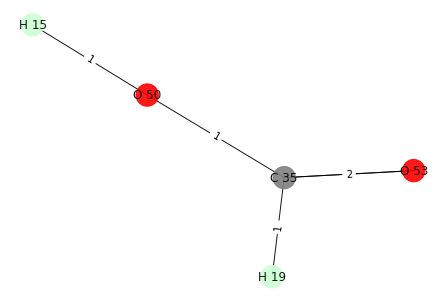

i: 2
Removing edge between: C 35 O 53
Adding edge between: C 35 H 14
O 53 1
H 15 0
C 34 0
O 50 0
H 18 0
H 16 0
C 35 0
H 17 0
H 14 0


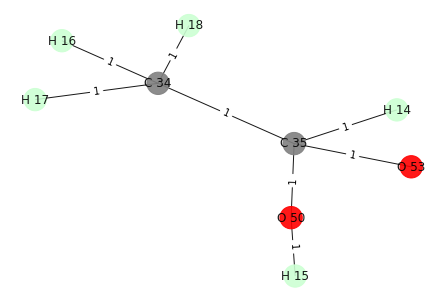

O 53 1
C 34 0
C 35 0
O 50 0
[O 53] H 19


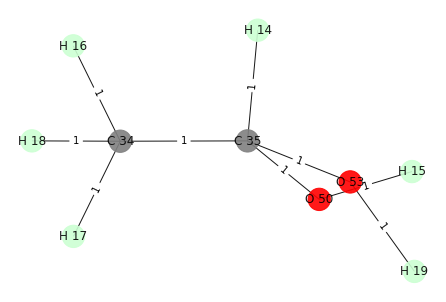

i: 3
Removing edge between: O 50 C 35
Adding edge between: O 50 H 14
O 50 0
H 14 0
H 15 0


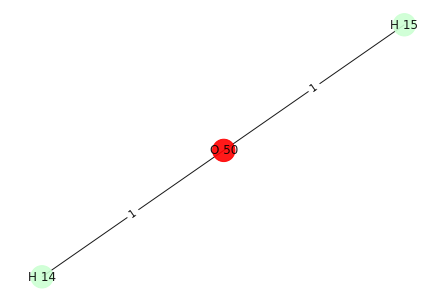

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 19


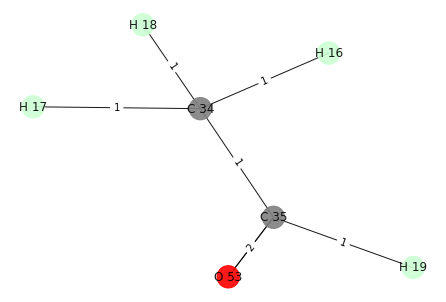

[{H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


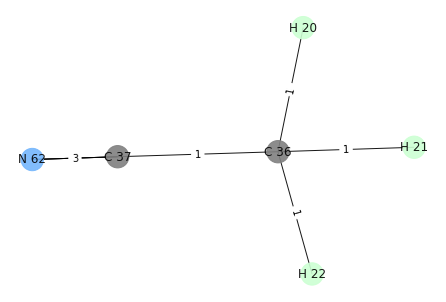

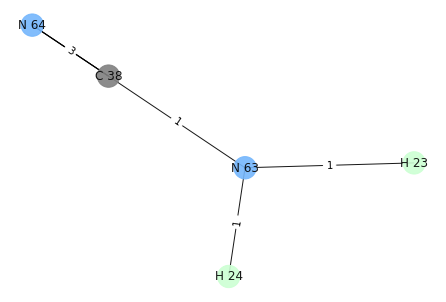

H 20
H 23
C 36 N 63


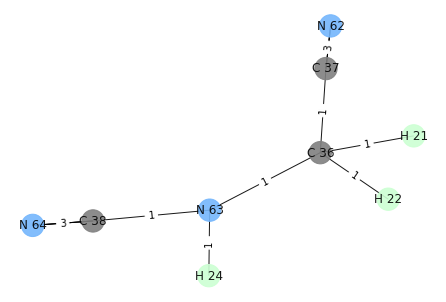

{N 63, C 38, H 24, C 37, N 62, N 64, H 21, C 36, H 22}
[C 38, C 37, N 62, N 63, C 36, N 64]
i: 0
Removing edge between: C 38 N 63
Adding edge between: C 38 H 20
N 64 0
H 20 0
C 38 0


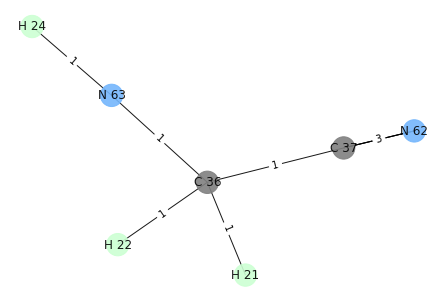

C 38 0
C 37 0
N 62 0
N 63 1
C 36 0
N 64 0
[N 63] H 23


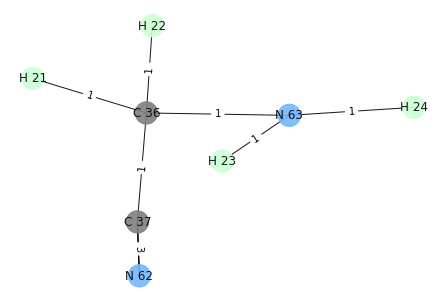

i: 1
Removing edge between: C 37 C 36
Adding edge between: C 37 H 20
C 37 0
H 20 0
N 62 0


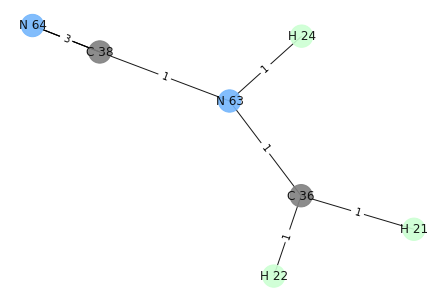

C 38 0
C 37 0
N 62 0
N 63 0
C 36 1
N 64 0
[C 36] H 23


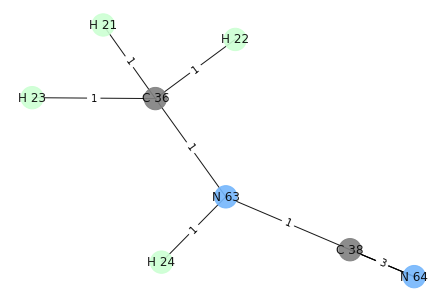

i: 2
Removing edge between: N 62 C 37
Adding edge between: N 62 H 20
N 63 0
C 38 0
H 20 0
H 24 0
C 37 1
N 62 0
N 64 0
H 21 0
C 36 0
H 22 0


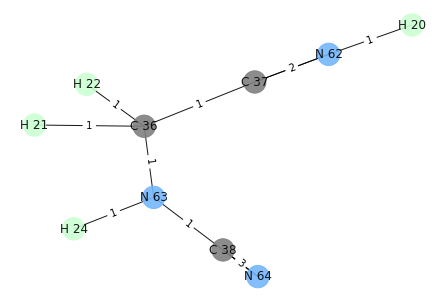

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 23


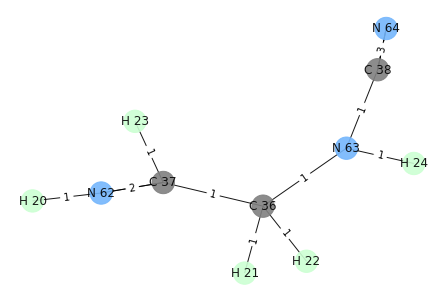

i: 3
Removing edge between: N 63 C 38
Adding edge between: N 63 H 20
H 24 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
H 22 0


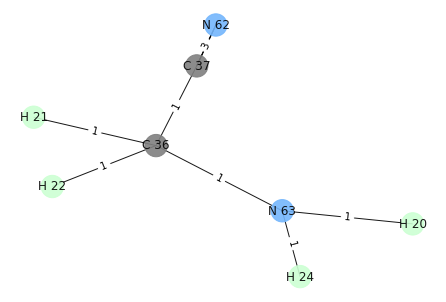

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 23


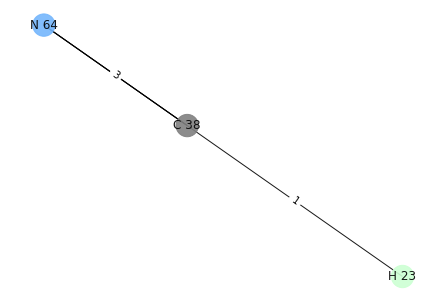

i: 4
Removing edge between: C 36 C 37
Adding edge between: C 36 H 20
N 63 0
C 38 0
H 20 0
H 24 0
N 64 0
H 21 0
C 36 0
H 22 0


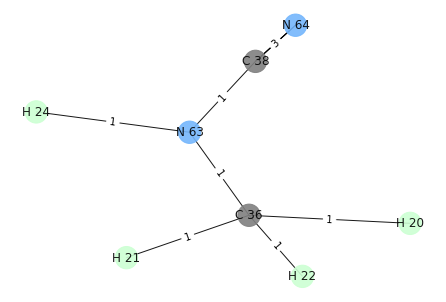

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 23


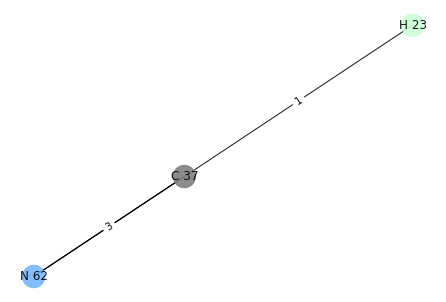

i: 5
Removing edge between: N 64 C 38
Adding edge between: N 64 H 20
C 38 1
H 22 0
H 20 0
H 24 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
N 64 0


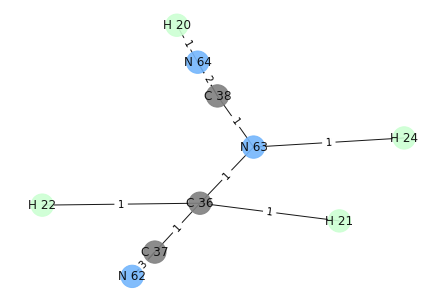

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 23


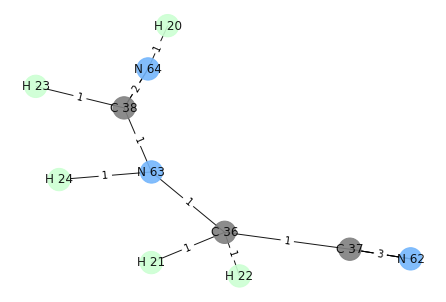

[{H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


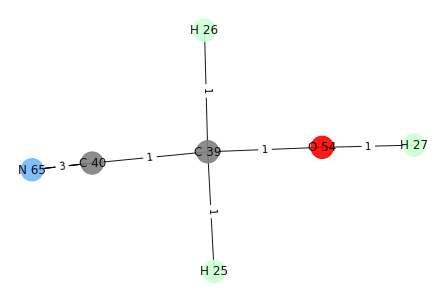

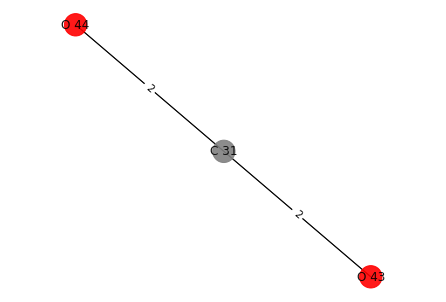

[{O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


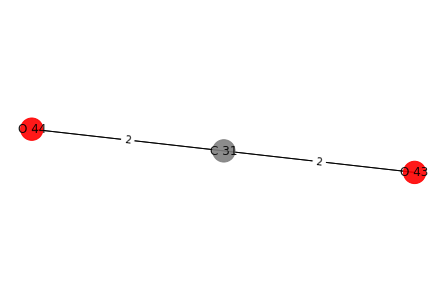

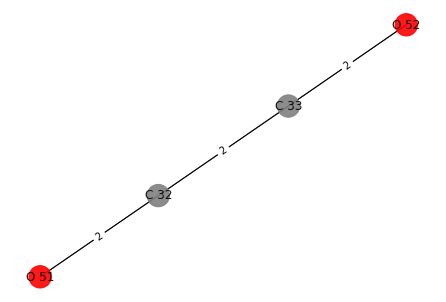

[{C 32, C 33, O 51, O 52}]
15
[{C 28, H 2, O 41, H 1}, {H 3, C 29, N 55}, {N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]
{C 28, H 2, O 41, H 1}
{H 3, C 29, N 55}
7


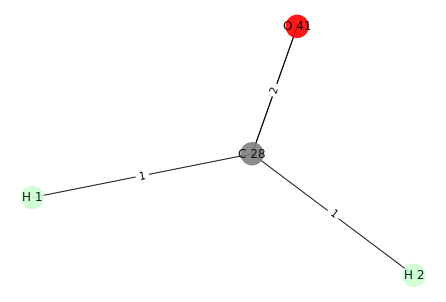

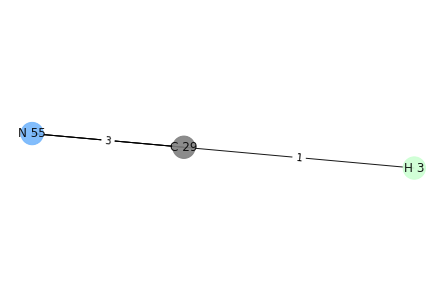

H 1
H 3
C 28 C 29


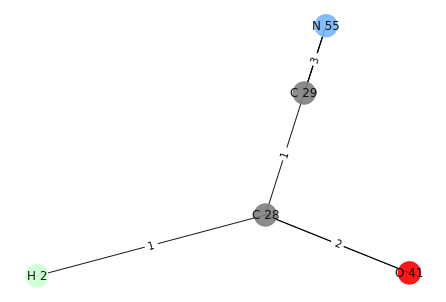

{C 28, C 29, H 2, O 41, N 55}
[C 28, O 41, C 29, N 55]
i: 0
Removing edge between: C 28 O 41
Adding edge between: C 28 H 1
C 28 0
H 1 0
C 29 0
H 2 0
O 41 1
N 55 0


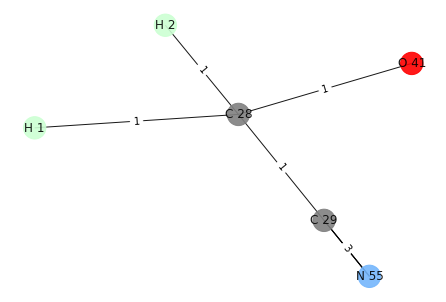

C 28 0
O 41 1
C 29 0
N 55 0
[O 41] H 3


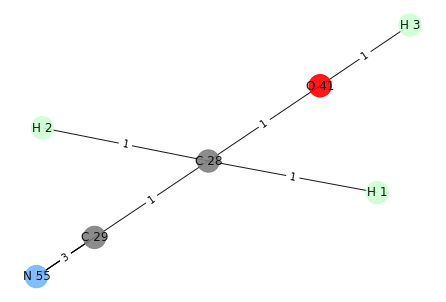

i: 1
Removing edge between: O 41 C 28
Adding edge between: O 41 H 1
C 28 1
H 1 0
C 29 0
H 2 0
O 41 0
N 55 0


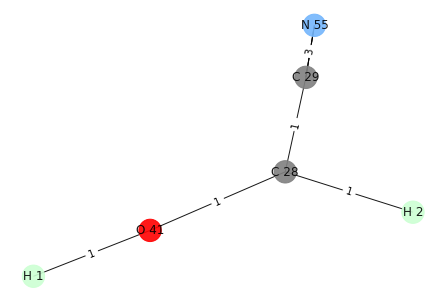

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


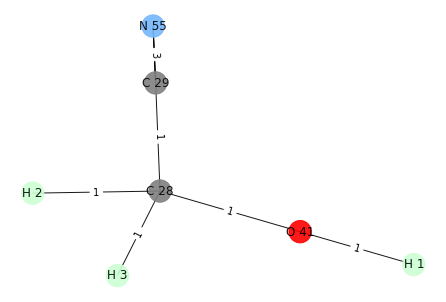

i: 2
Removing edge between: C 29 C 28
Adding edge between: C 29 H 1
H 1 0
C 29 0
N 55 0


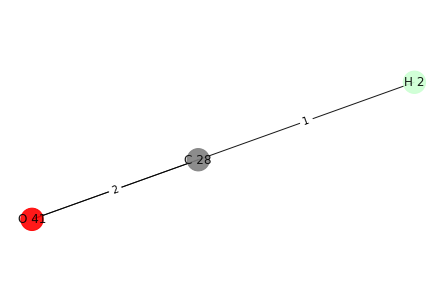

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


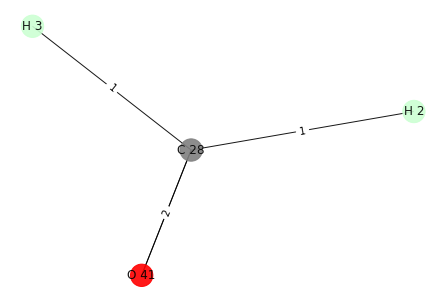

i: 3
Removing edge between: N 55 C 29
Adding edge between: N 55 H 1
C 28 0
H 1 0
C 29 1
O 41 0
H 2 0
N 55 0


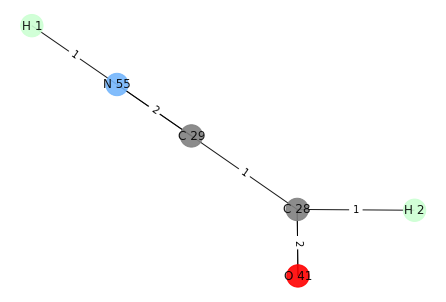

C 28 0
O 41 0
C 29 1
N 55 0
[C 29] H 3


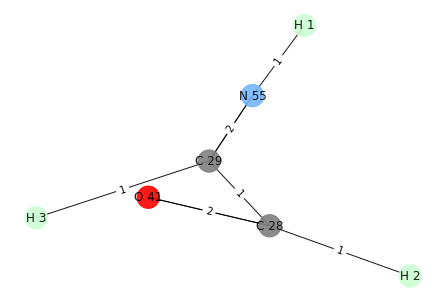

[{N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


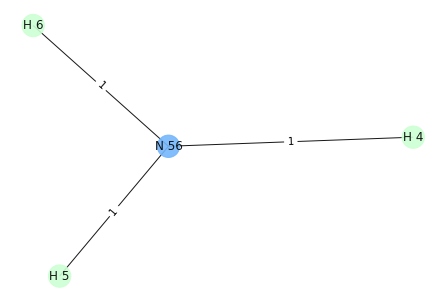

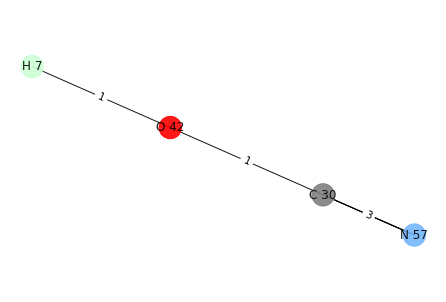

H 5
H 7
N 56 O 42


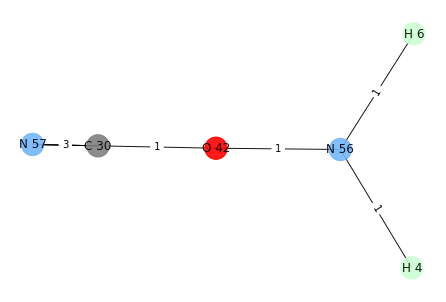

{H 6, O 42, H 4, C 30, N 56, N 57}
[O 42, N 56, C 30, N 57]
i: 0
Removing edge between: O 42 C 30
Adding edge between: O 42 H 5
H 6 0
O 42 0
H 4 0
H 5 0
N 56 0


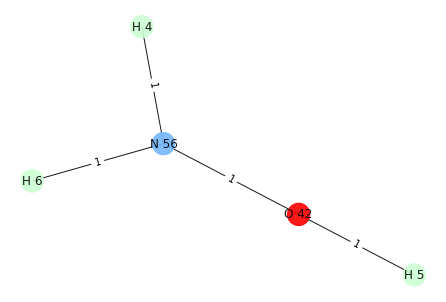

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


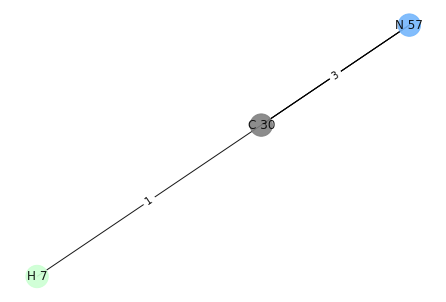

i: 1
Removing edge between: N 56 O 42
Adding edge between: N 56 H 5
N 56 0
H 6 0
H 5 0
H 4 0


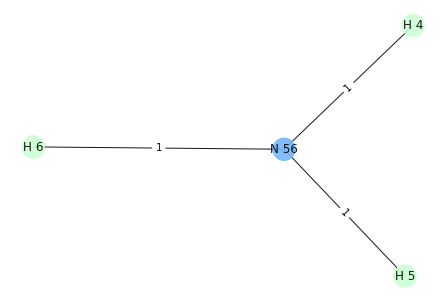

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


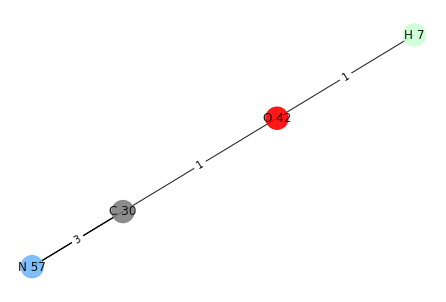

i: 2
Removing edge between: C 30 O 42
Adding edge between: C 30 H 5
N 57 0
C 30 0
H 5 0


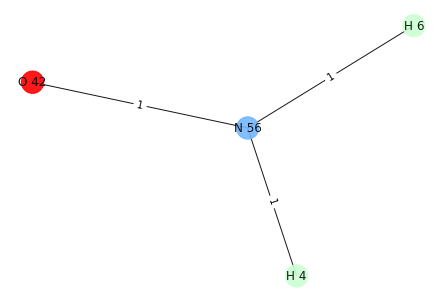

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


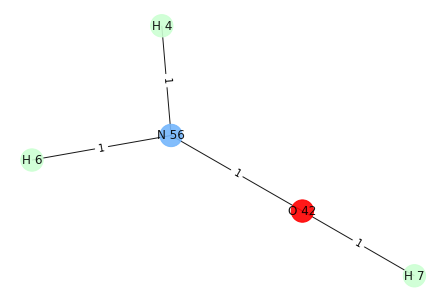

i: 3
Removing edge between: N 57 C 30
Adding edge between: N 57 H 5
H 6 0
O 42 0
H 4 0
C 30 1
H 5 0
N 57 0
N 56 0


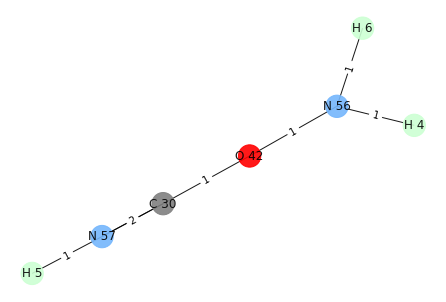

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


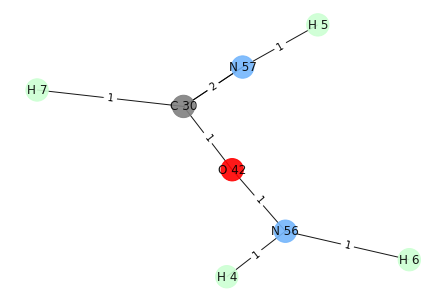

[{H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


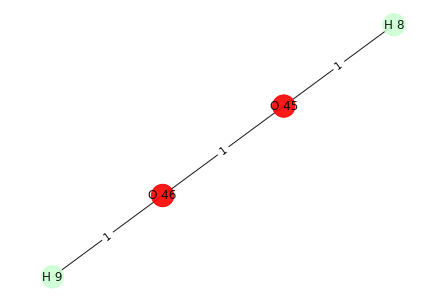

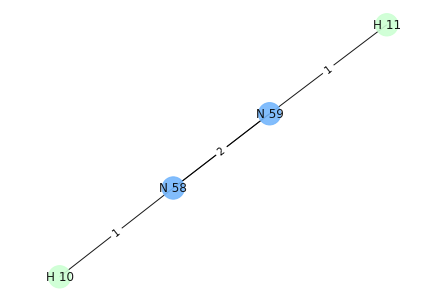

H 8
H 11
O 45 N 59


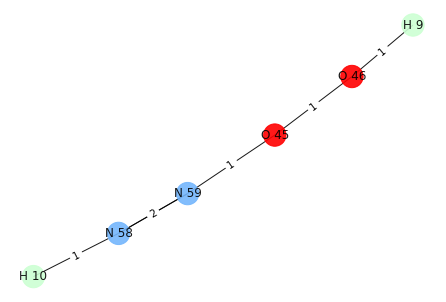

{O 45, N 58, O 46, N 59, H 9, H 10}
[O 45, N 59, O 46, N 58]
i: 0
Removing edge between: O 45 O 46
Adding edge between: O 45 H 8
O 45 0
N 58 0
H 8 0
N 59 0
H 10 0


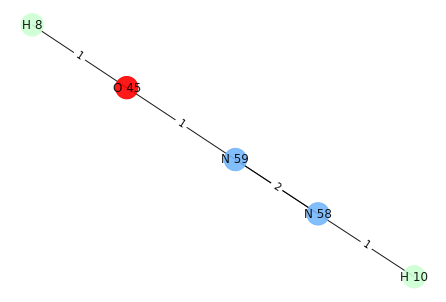

O 45 0
N 59 0
O 46 1
N 58 0
[O 46] H 11


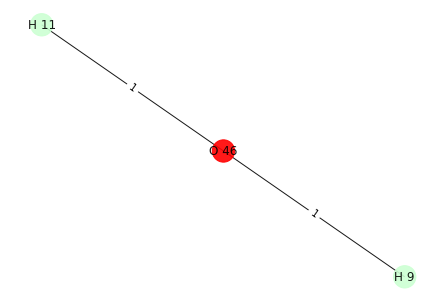

i: 1
Removing edge between: N 59 O 45
Adding edge between: N 59 H 8
H 8 0
N 59 0
H 10 0
N 58 0


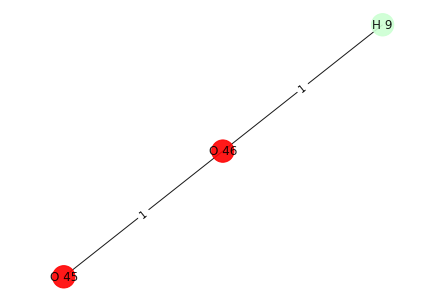

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 11


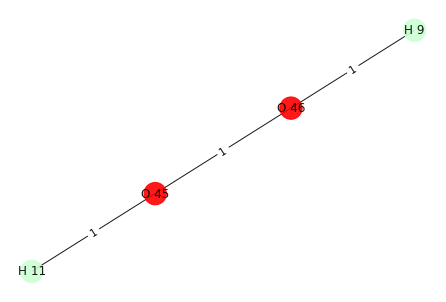

i: 2
Removing edge between: O 46 O 45
Adding edge between: O 46 H 8
H 8 0
H 9 0
O 46 0


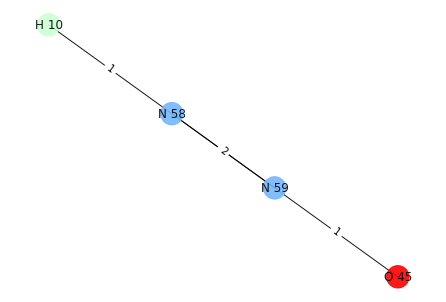

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 11


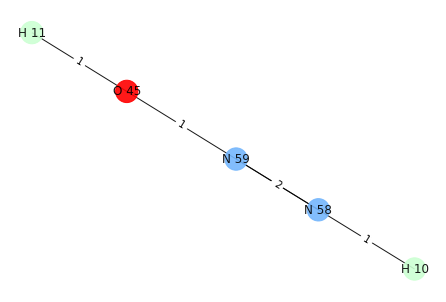

i: 3
Removing edge between: N 58 N 59
Adding edge between: N 58 H 8
O 45 0
N 58 0
O 46 0
H 8 0
N 59 1
H 9 0
H 10 0


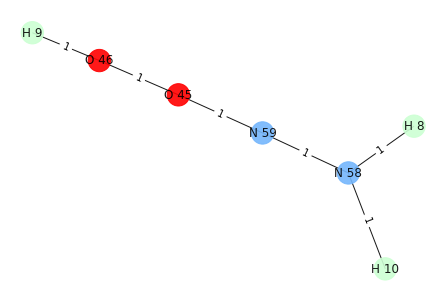

O 45 0
N 59 1
O 46 0
N 58 0
[N 59] H 11


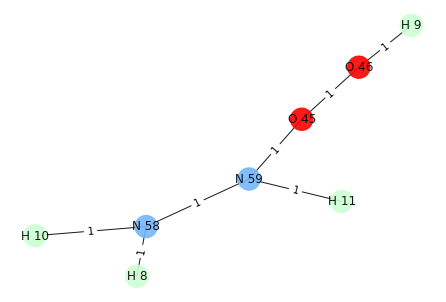

[{N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


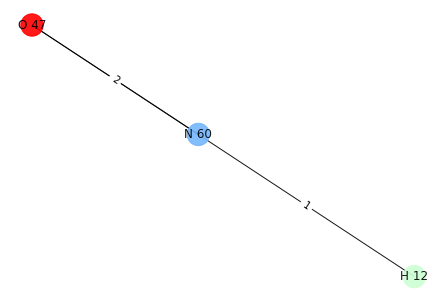

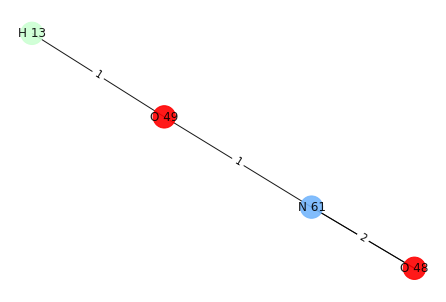

H 12
H 13
N 60 O 49


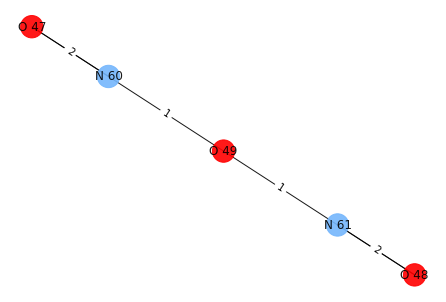

{N 60, O 49, N 61, O 47, O 48}
[N 60, O 49, N 61, O 47, O 48]
i: 0
Removing edge between: N 60 O 47
Adding edge between: N 60 H 12
N 60 0
O 49 0
N 61 0
H 12 0
O 47 1
O 48 0


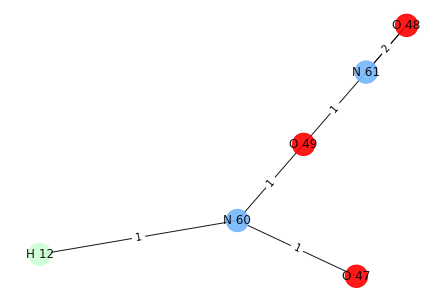

N 60 0
O 49 0
N 61 0
O 47 1
O 48 0
[O 47] H 13


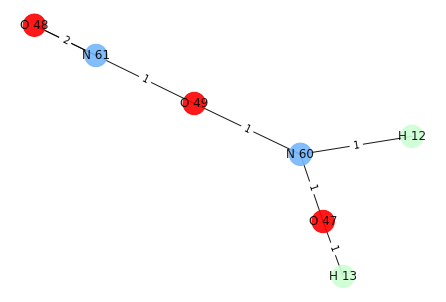

i: 1
Removing edge between: O 49 N 60
Adding edge between: O 49 H 12
N 61 0
O 49 0
H 12 0
O 48 0


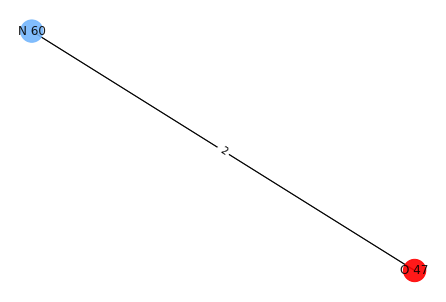

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


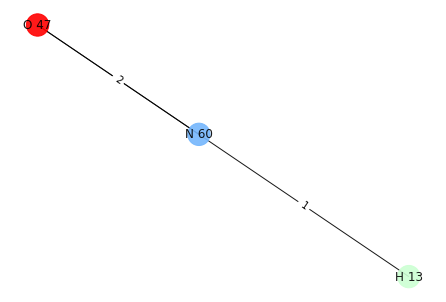

i: 2
Removing edge between: N 61 O 49
Adding edge between: N 61 H 12
N 61 0
H 12 0
O 48 0


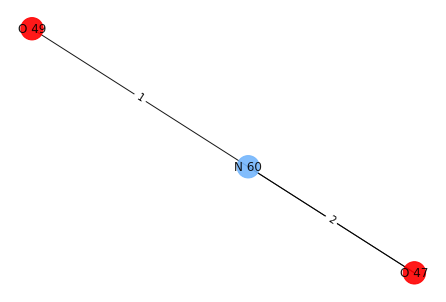

N 60 0
O 49 1
N 61 0
O 47 0
O 48 0
[O 49] H 13


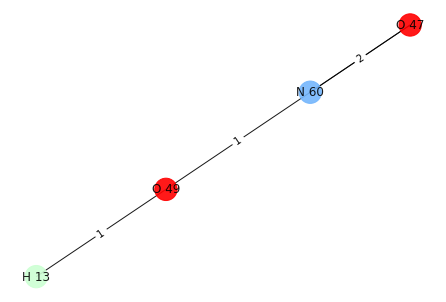

i: 3
Removing edge between: O 47 N 60
Adding edge between: O 47 H 12
N 60 1
O 49 0
N 61 0
H 12 0
O 47 0
O 48 0


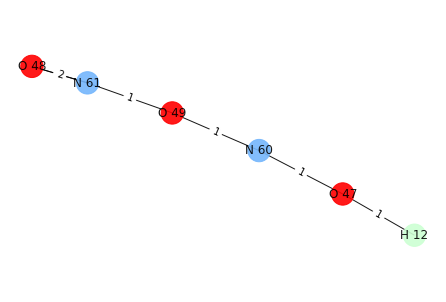

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


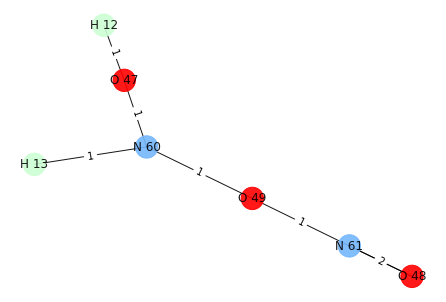

i: 4
Removing edge between: O 48 N 61
Adding edge between: O 48 H 12
N 60 0
O 49 0
N 61 1
H 12 0
O 47 0
O 48 0


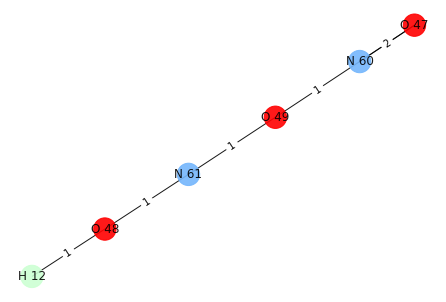

N 60 0
O 49 0
N 61 1
O 47 0
O 48 0
[N 61] H 13


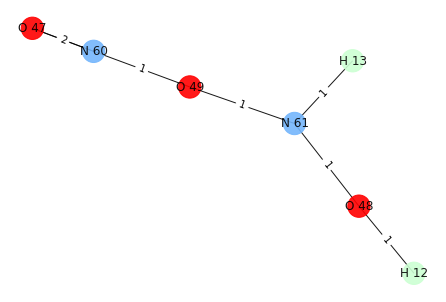

[{O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


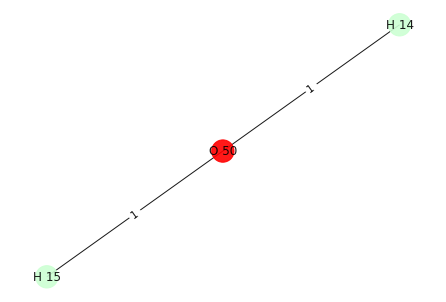

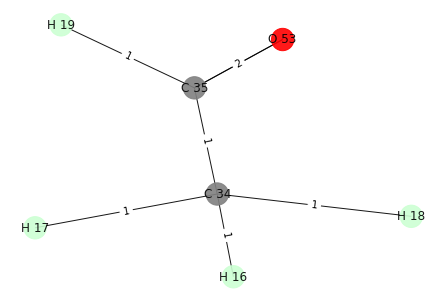

H 15
H 18
O 50 C 34


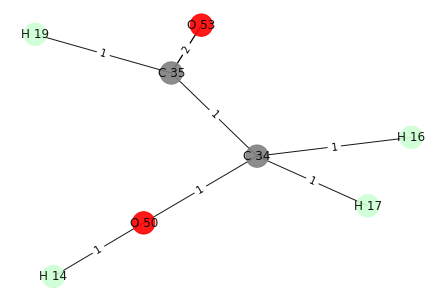

{O 53, H 19, O 50, C 34, H 16, C 35, H 17, H 14}
[O 53, C 34, C 35, O 50]
i: 0
Removing edge between: O 53 C 35
Adding edge between: O 53 H 15
O 53 0
H 19 0
H 15 0
C 34 0
O 50 0
H 16 0
C 35 1
H 17 0
H 14 0


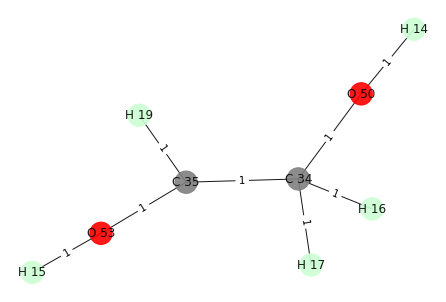

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 18


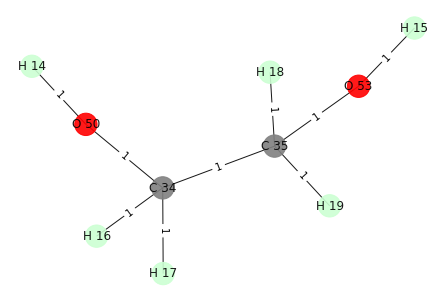

i: 1
Removing edge between: C 34 C 35
Adding edge between: C 34 H 15
H 15 0
C 34 0
O 50 0
H 16 0
H 17 0
H 14 0


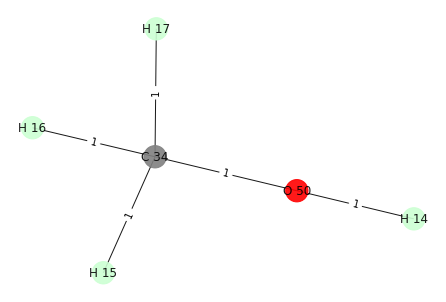

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 18


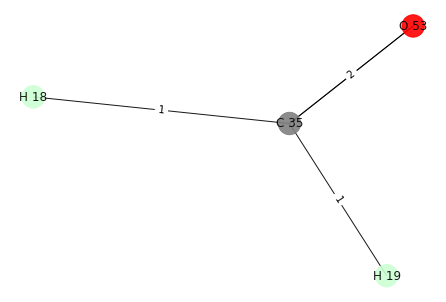

i: 2
Removing edge between: C 35 O 53
Adding edge between: C 35 H 15
O 53 1
H 19 0
H 15 0
C 34 0
O 50 0
H 16 0
C 35 0
H 17 0
H 14 0


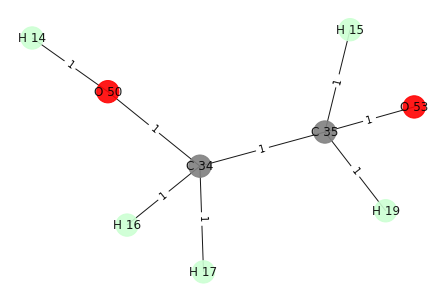

O 53 1
C 34 0
C 35 0
O 50 0
[O 53] H 18


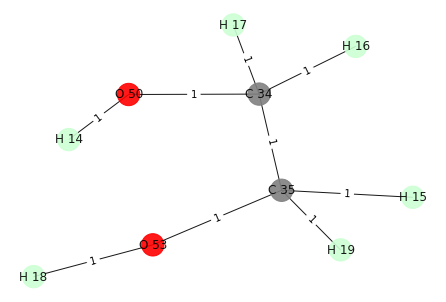

i: 3
Removing edge between: O 50 C 34
Adding edge between: O 50 H 15
O 50 0
H 15 0
H 14 0


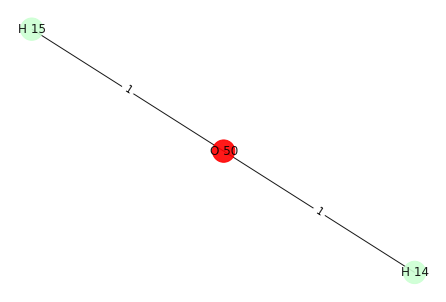

O 53 0
C 34 1
C 35 0
O 50 0
[C 34] H 18


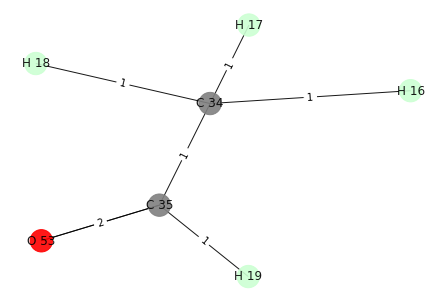

[{H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


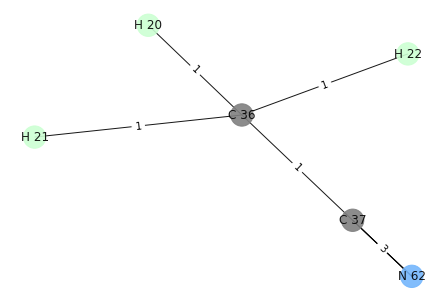

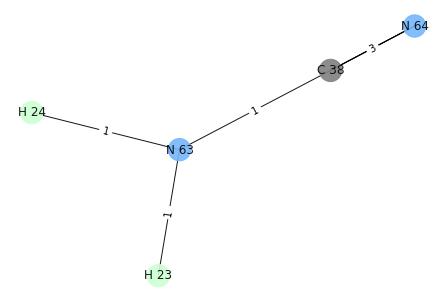

H 22
H 24
C 36 N 63


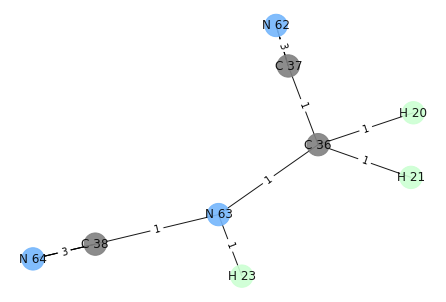

{N 63, C 38, H 23, H 20, C 37, N 62, H 21, C 36, N 64}
[C 38, C 37, N 62, N 63, C 36, N 64]
i: 0
Removing edge between: C 38 N 63
Adding edge between: C 38 H 22
N 64 0
H 22 0
C 38 0


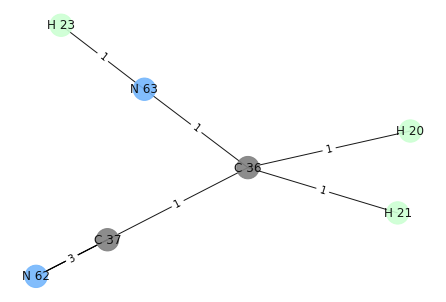

C 38 0
C 37 0
N 62 0
N 63 1
C 36 0
N 64 0
[N 63] H 24


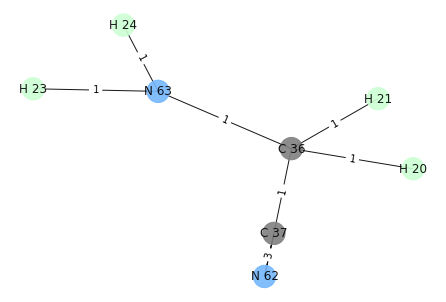

i: 1
Removing edge between: C 37 C 36
Adding edge between: C 37 H 22
C 37 0
H 22 0
N 62 0


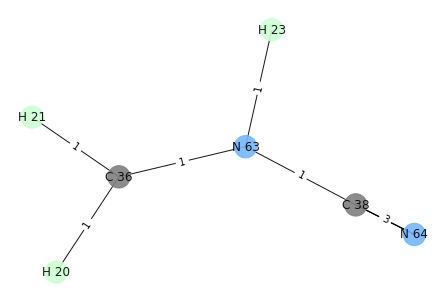

C 38 0
C 37 0
N 62 0
N 63 0
C 36 1
N 64 0
[C 36] H 24


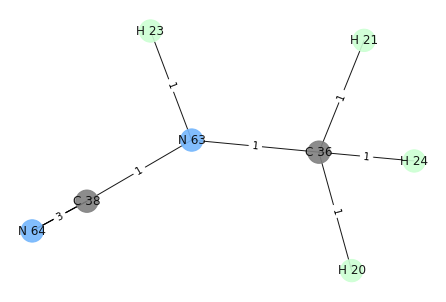

i: 2
Removing edge between: N 62 C 37
Adding edge between: N 62 H 22
N 63 0
H 23 0
C 38 0
H 20 0
C 37 1
N 62 0
N 64 0
H 21 0
C 36 0
H 22 0


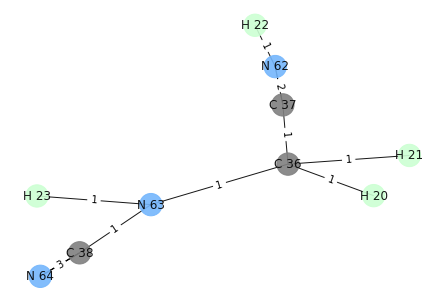

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


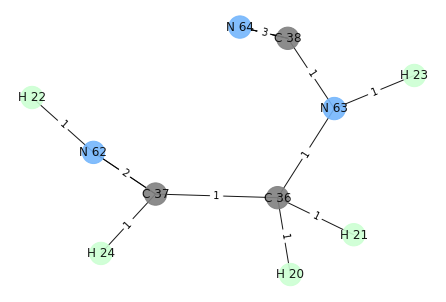

i: 3
Removing edge between: N 63 C 38
Adding edge between: N 63 H 22
H 23 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
H 22 0


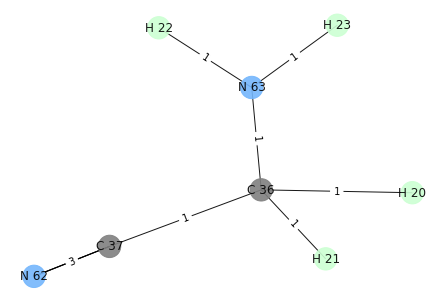

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


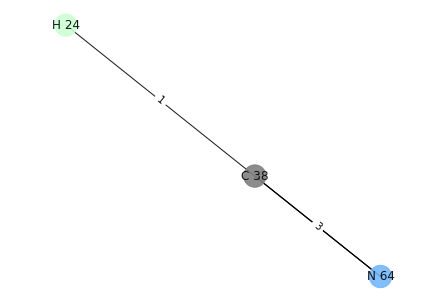

i: 4
Removing edge between: C 36 C 37
Adding edge between: C 36 H 22
N 63 0
H 23 0
C 38 0
H 20 0
N 64 0
H 21 0
C 36 0
H 22 0


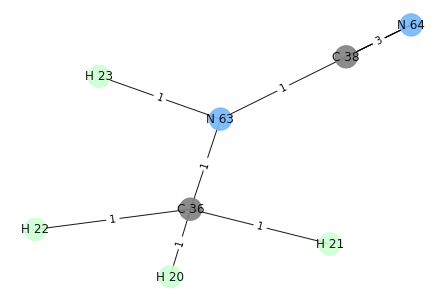

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


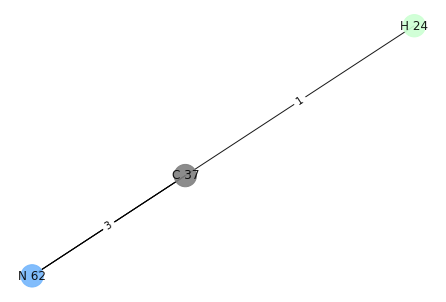

i: 5
Removing edge between: N 64 C 38
Adding edge between: N 64 H 22
C 38 1
H 23 0
H 22 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
N 64 0


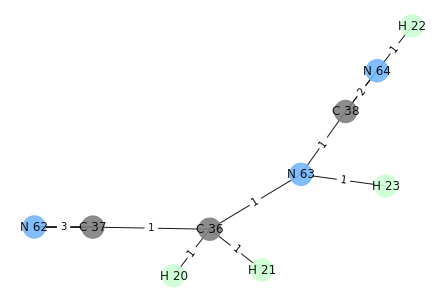

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


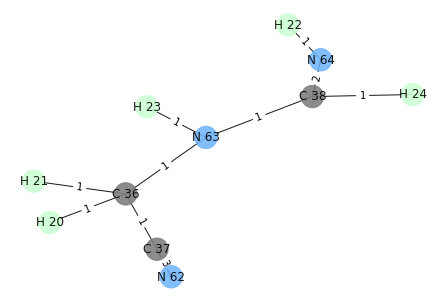

[{H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


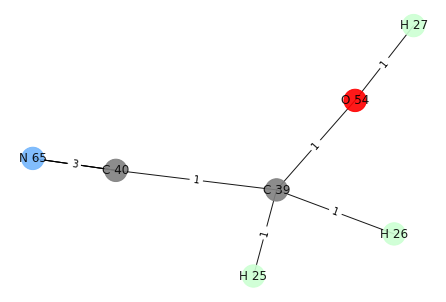

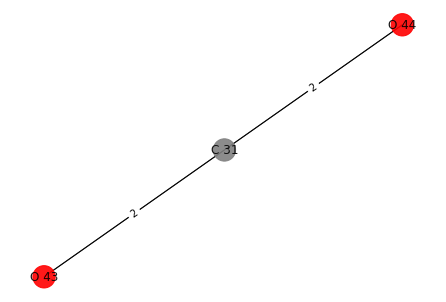

[{O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


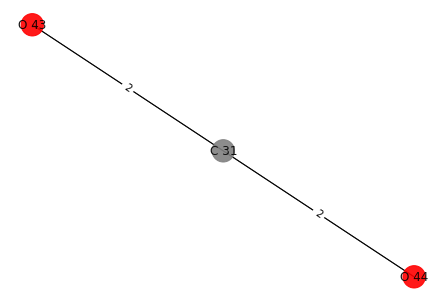

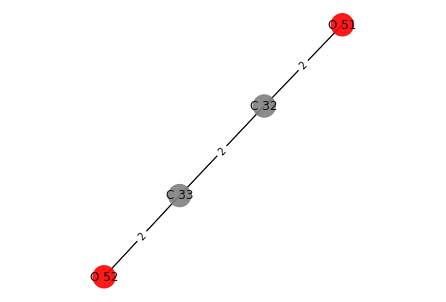

[{C 32, C 33, O 51, O 52}]
15
[{C 28, H 2, O 41, H 1}, {H 3, C 29, N 55}, {N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]
{C 28, H 2, O 41, H 1}
{H 3, C 29, N 55}
7


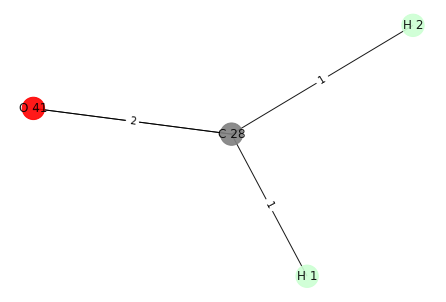

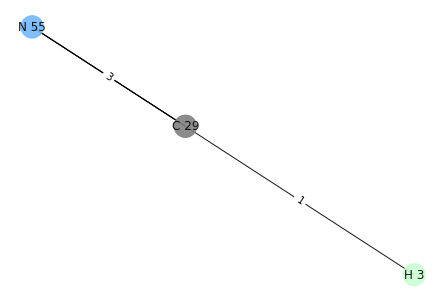

H 1
H 3
C 28 C 29


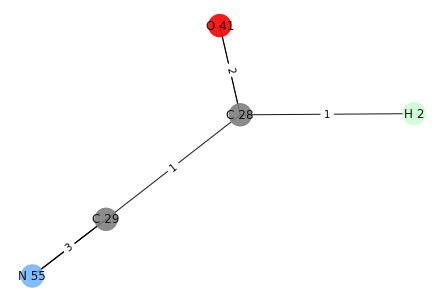

{C 28, C 29, H 2, O 41, N 55}
[C 28, O 41, C 29, N 55]
i: 0
Removing edge between: C 28 O 41
Adding edge between: C 28 H 1
C 28 0
H 1 0
C 29 0
H 2 0
O 41 1
N 55 0


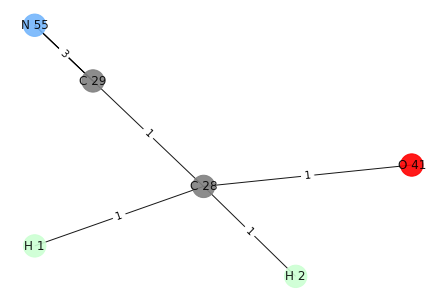

C 28 0
O 41 1
C 29 0
N 55 0
[O 41] H 3


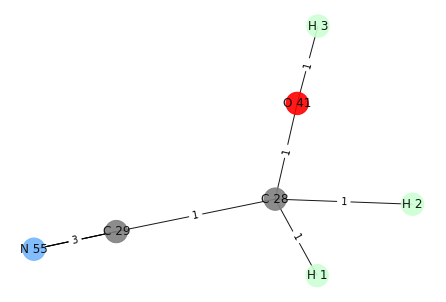

i: 1
Removing edge between: O 41 C 28
Adding edge between: O 41 H 1
C 28 1
H 1 0
C 29 0
H 2 0
O 41 0
N 55 0


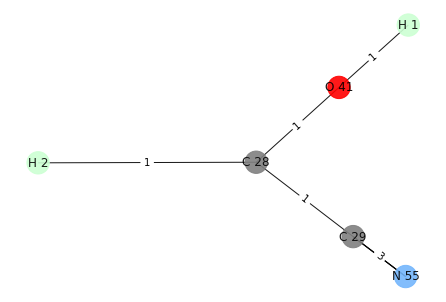

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


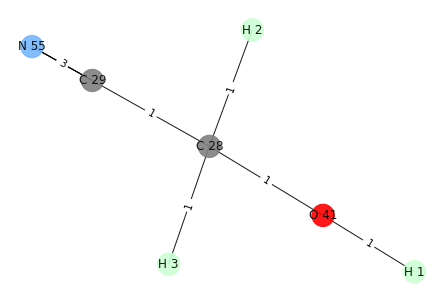

i: 2
Removing edge between: C 29 C 28
Adding edge between: C 29 H 1
H 1 0
C 29 0
N 55 0


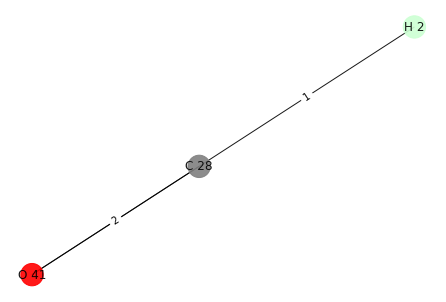

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


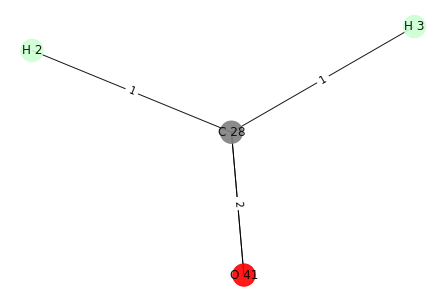

i: 3
Removing edge between: N 55 C 29
Adding edge between: N 55 H 1
C 28 0
H 1 0
C 29 1
O 41 0
H 2 0
N 55 0


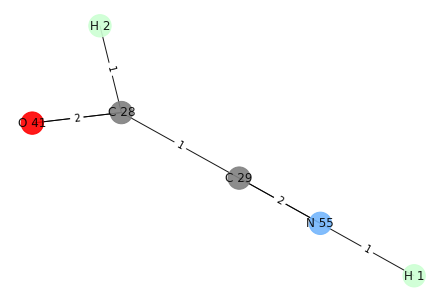

C 28 0
O 41 0
C 29 1
N 55 0
[C 29] H 3


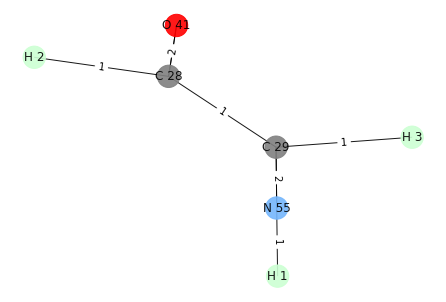

[{N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


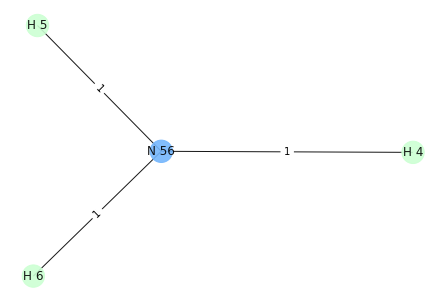

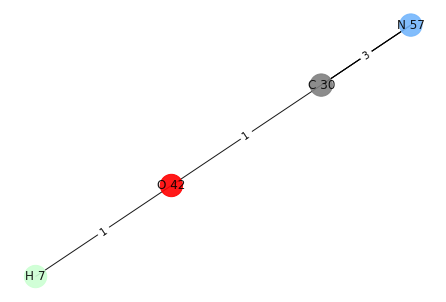

H 4
H 7
N 56 O 42


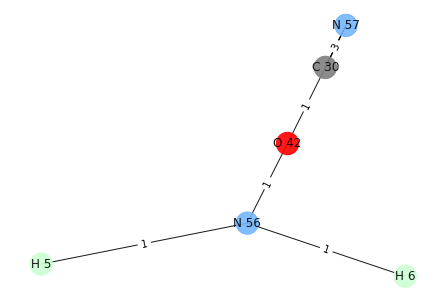

{H 6, O 42, C 30, H 5, N 56, N 57}
[O 42, N 56, C 30, N 57]
i: 0
Removing edge between: O 42 C 30
Adding edge between: O 42 H 4
H 6 0
O 42 0
H 4 0
H 5 0
N 56 0


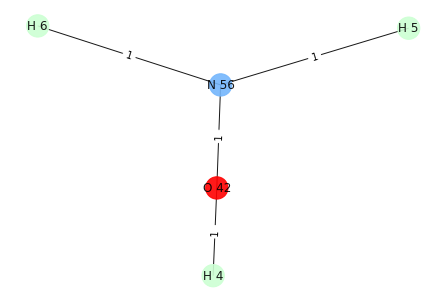

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


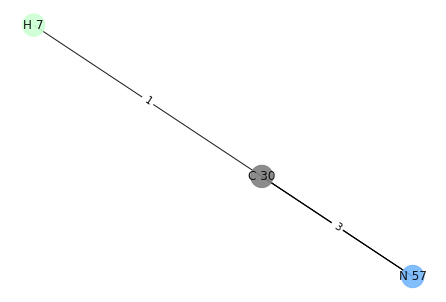

i: 1
Removing edge between: N 56 O 42
Adding edge between: N 56 H 4
N 56 0
H 6 0
H 4 0
H 5 0


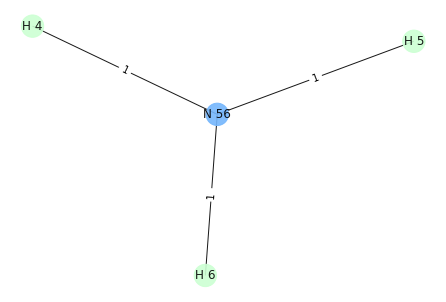

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


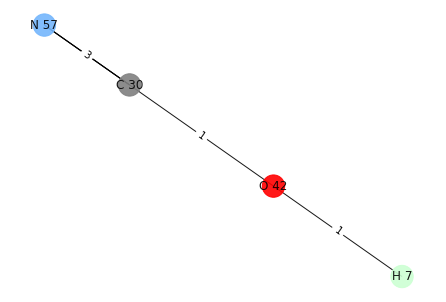

i: 2
Removing edge between: C 30 O 42
Adding edge between: C 30 H 4
N 57 0
C 30 0
H 4 0


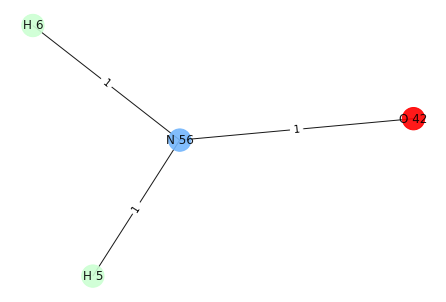

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


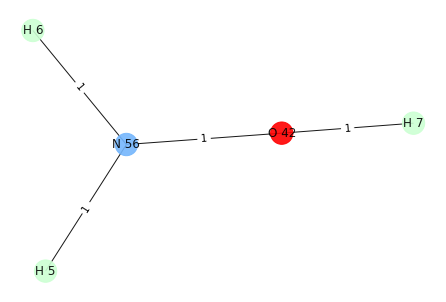

i: 3
Removing edge between: N 57 C 30
Adding edge between: N 57 H 4
H 6 0
O 42 0
H 4 0
C 30 1
H 5 0
N 57 0
N 56 0


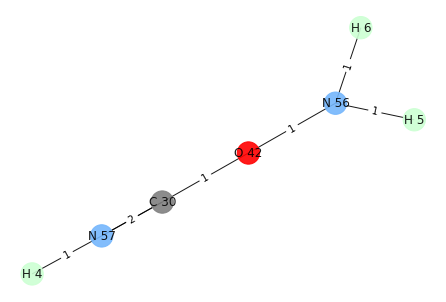

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


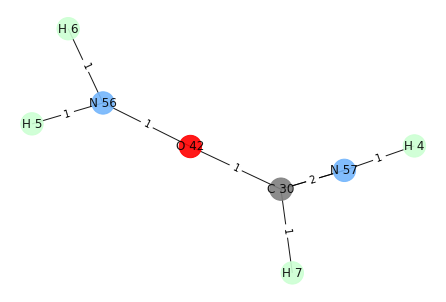

[{H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


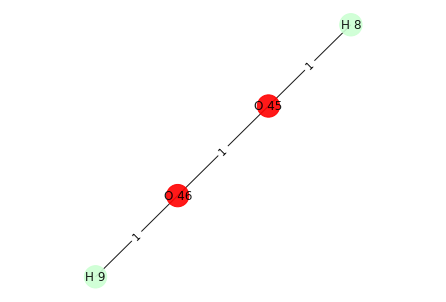

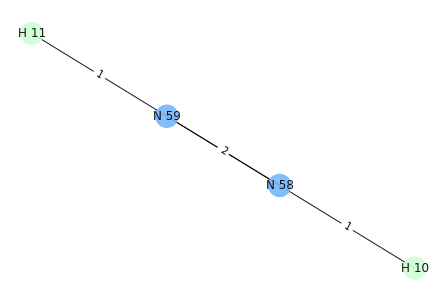

H 9
H 11
O 46 N 59


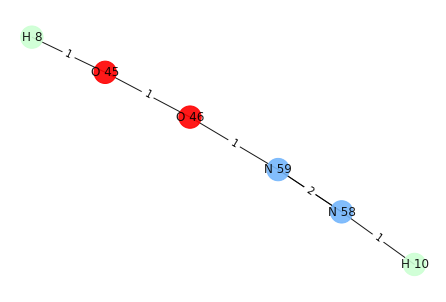

{O 45, N 58, O 46, H 8, N 59, H 10}
[O 45, N 59, O 46, N 58]
i: 0
Removing edge between: O 45 O 46
Adding edge between: O 45 H 9
H 9 0
H 8 0
O 45 0


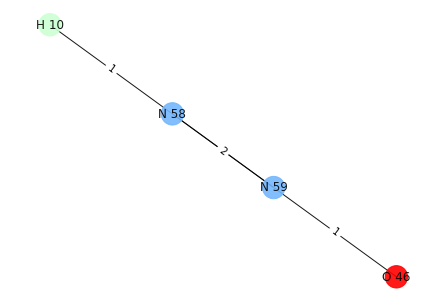

O 45 0
N 59 0
O 46 1
N 58 0
[O 46] H 11


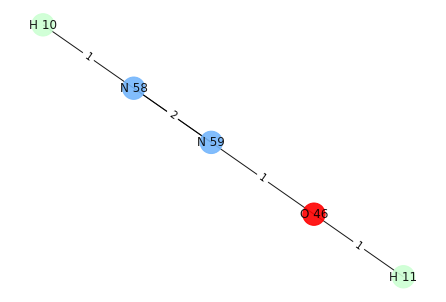

i: 1
Removing edge between: N 59 N 58
Adding edge between: N 59 H 9
O 45 0
N 58 1
O 46 0
H 8 0
N 59 0
H 9 0
H 10 0


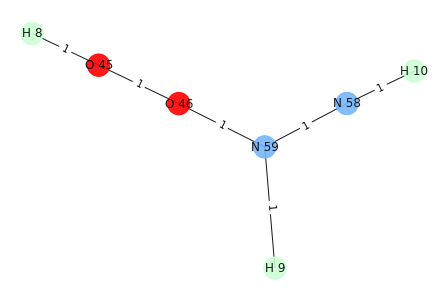

O 45 0
N 59 0
O 46 0
N 58 1
[N 58] H 11


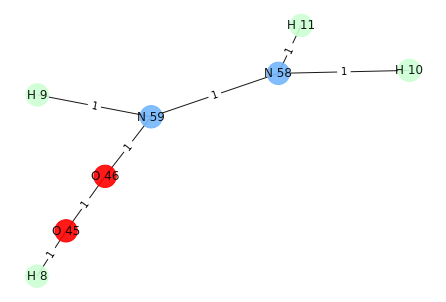

i: 2
Removing edge between: O 46 O 45
Adding edge between: O 46 H 9
N 58 0
O 46 0
N 59 0
H 9 0
H 10 0


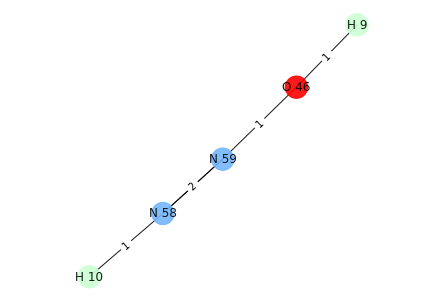

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 11


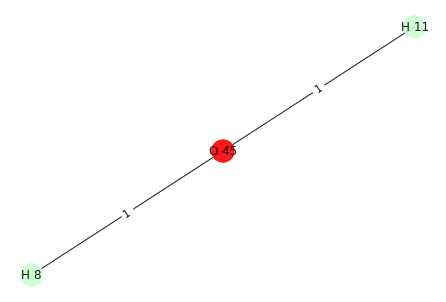

i: 3
Removing edge between: N 58 N 59
Adding edge between: N 58 H 9
O 45 0
N 58 0
O 46 0
H 8 0
N 59 1
H 9 0
H 10 0


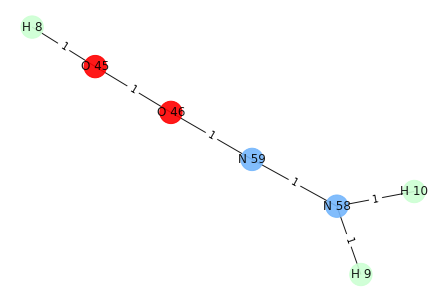

O 45 0
N 59 1
O 46 0
N 58 0
[N 59] H 11


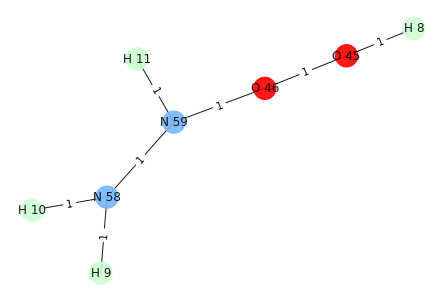

[{N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


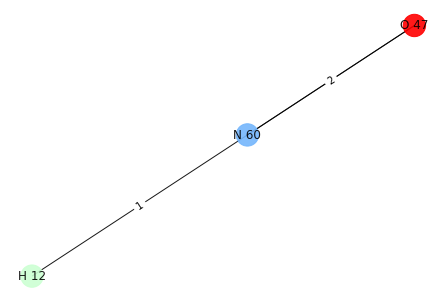

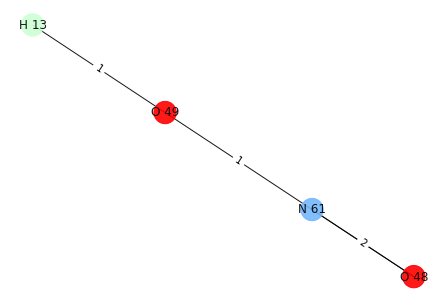

H 12
H 13
N 60 O 49


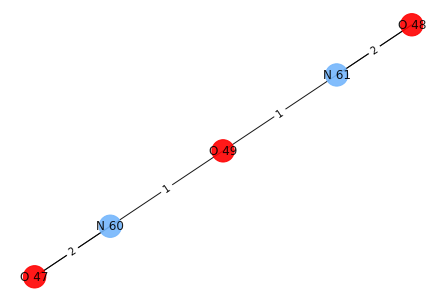

{N 60, O 49, N 61, O 47, O 48}
[N 60, O 49, N 61, O 47, O 48]
i: 0
Removing edge between: N 60 O 47
Adding edge between: N 60 H 12
N 60 0
O 49 0
N 61 0
H 12 0
O 47 1
O 48 0


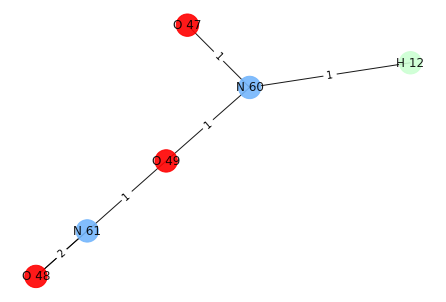

N 60 0
O 49 0
N 61 0
O 47 1
O 48 0
[O 47] H 13


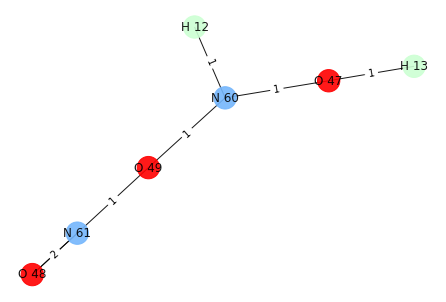

i: 1
Removing edge between: O 49 N 60
Adding edge between: O 49 H 12
N 61 0
O 49 0
H 12 0
O 48 0


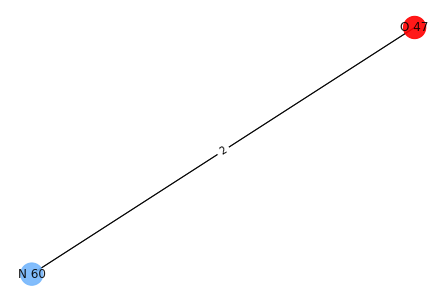

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


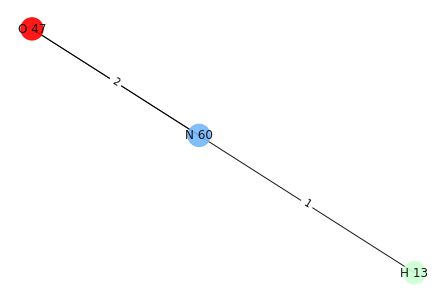

i: 2
Removing edge between: N 61 O 49
Adding edge between: N 61 H 12
N 61 0
H 12 0
O 48 0


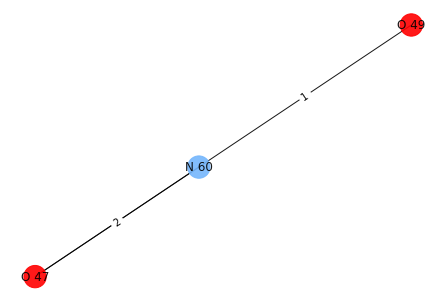

N 60 0
O 49 1
N 61 0
O 47 0
O 48 0
[O 49] H 13


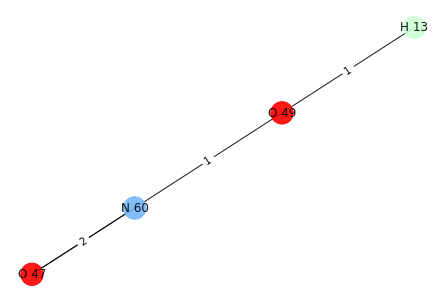

i: 3
Removing edge between: O 47 N 60
Adding edge between: O 47 H 12
N 60 1
O 49 0
N 61 0
H 12 0
O 47 0
O 48 0


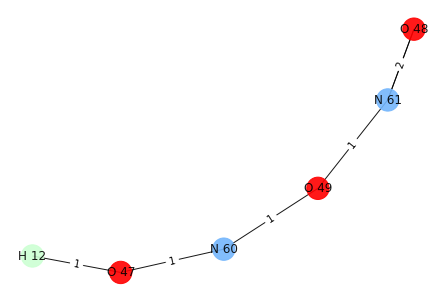

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


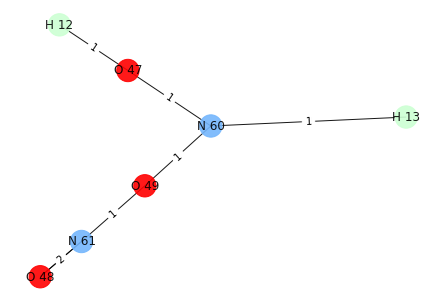

i: 4
Removing edge between: O 48 N 61
Adding edge between: O 48 H 12
N 60 0
O 49 0
N 61 1
H 12 0
O 47 0
O 48 0


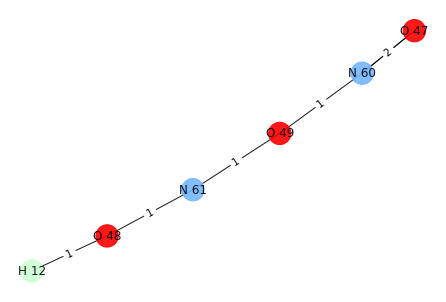

N 60 0
O 49 0
N 61 1
O 47 0
O 48 0
[N 61] H 13


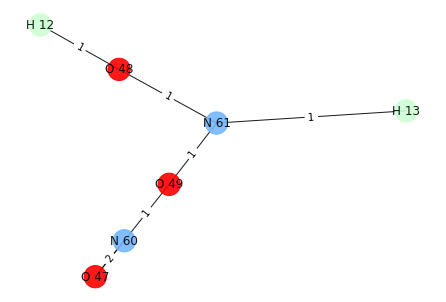

[{O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


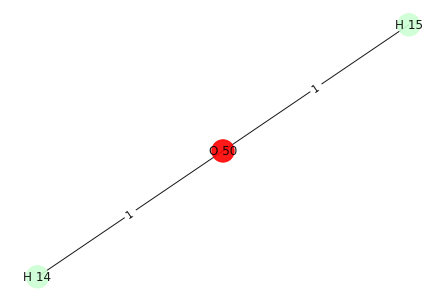

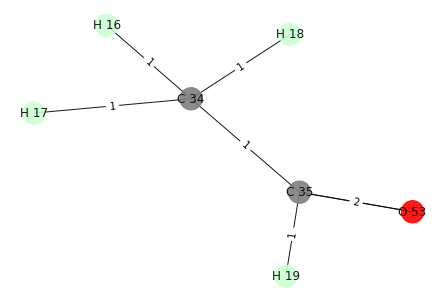

H 15
H 18
O 50 C 34


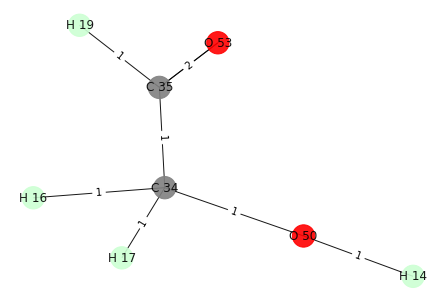

{O 53, H 19, O 50, C 34, H 16, C 35, H 17, H 14}
[O 53, C 34, C 35, O 50]
i: 0
Removing edge between: O 53 C 35
Adding edge between: O 53 H 15
O 53 0
H 19 0
H 15 0
C 34 0
O 50 0
H 16 0
C 35 1
H 17 0
H 14 0


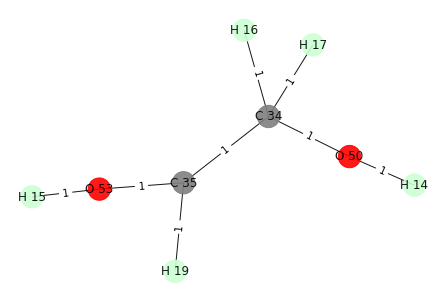

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 18


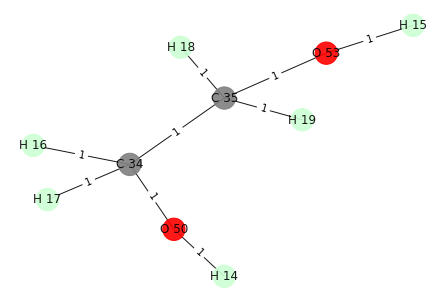

i: 1
Removing edge between: C 34 C 35
Adding edge between: C 34 H 15
H 15 0
C 34 0
O 50 0
H 16 0
H 17 0
H 14 0


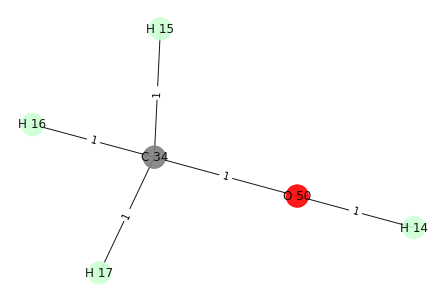

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 18


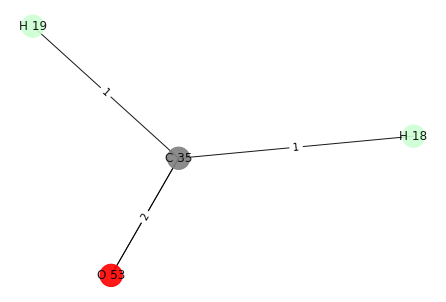

i: 2
Removing edge between: C 35 O 53
Adding edge between: C 35 H 15
O 53 1
H 19 0
H 15 0
C 34 0
O 50 0
H 16 0
C 35 0
H 17 0
H 14 0


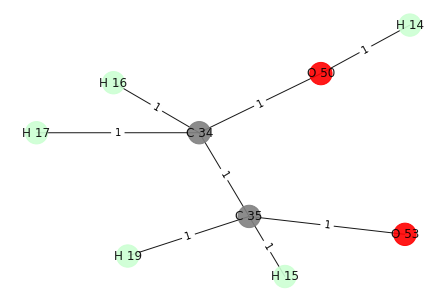

O 53 1
C 34 0
C 35 0
O 50 0
[O 53] H 18


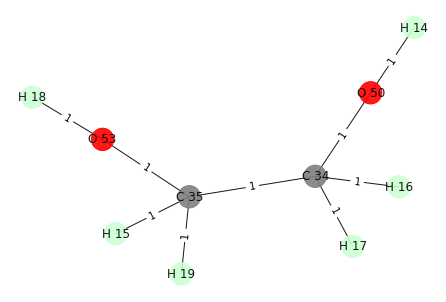

i: 3
Removing edge between: O 50 C 34
Adding edge between: O 50 H 15
O 50 0
H 15 0
H 14 0


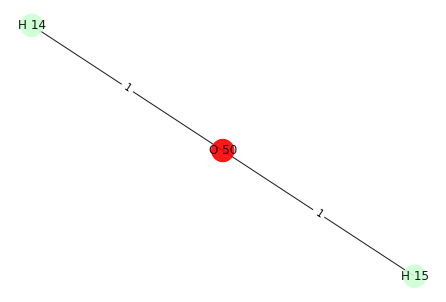

O 53 0
C 34 1
C 35 0
O 50 0
[C 34] H 18


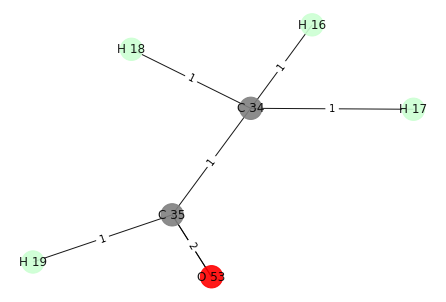

[{H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


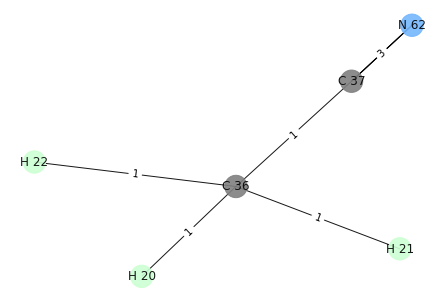

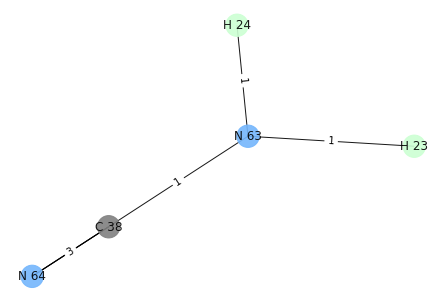

H 22
H 24
C 36 N 63


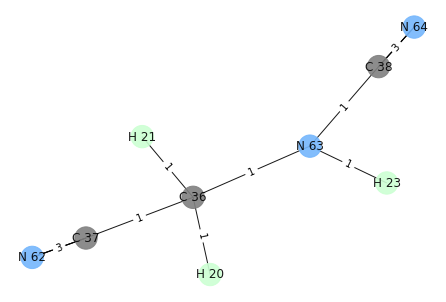

{N 63, C 38, H 23, H 20, C 37, N 62, H 21, C 36, N 64}
[C 38, C 37, N 62, N 63, C 36, N 64]
i: 0
Removing edge between: C 38 N 63
Adding edge between: C 38 H 22
N 64 0
H 22 0
C 38 0


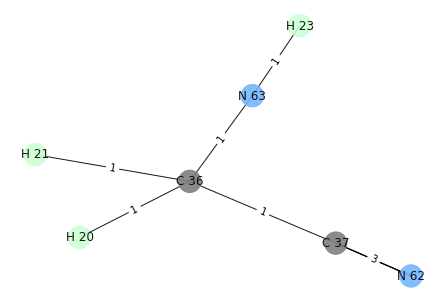

C 38 0
C 37 0
N 62 0
N 63 1
C 36 0
N 64 0
[N 63] H 24


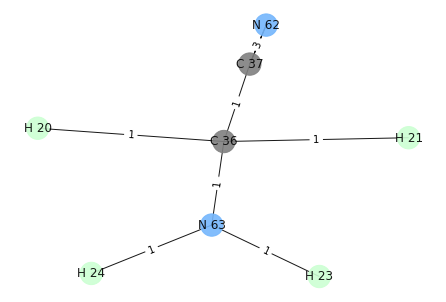

i: 1
Removing edge between: C 37 C 36
Adding edge between: C 37 H 22
C 37 0
H 22 0
N 62 0


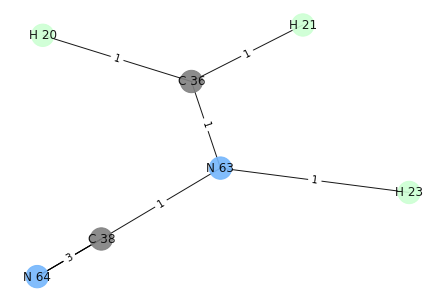

C 38 0
C 37 0
N 62 0
N 63 0
C 36 1
N 64 0
[C 36] H 24


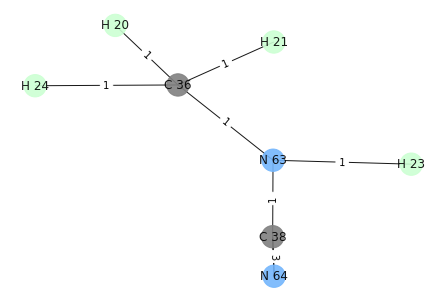

i: 2
Removing edge between: N 62 C 37
Adding edge between: N 62 H 22
N 63 0
H 23 0
C 38 0
H 20 0
C 37 1
N 62 0
N 64 0
H 21 0
C 36 0
H 22 0


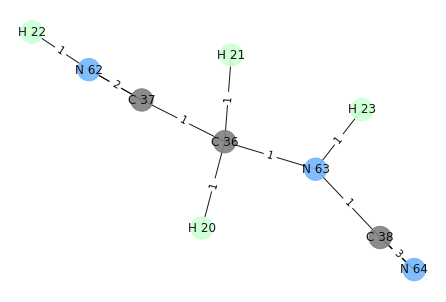

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


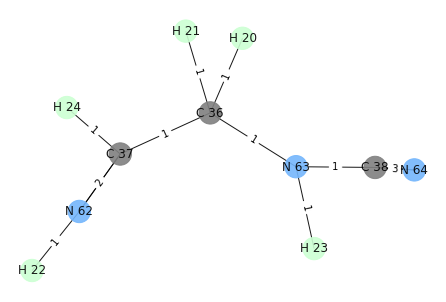

i: 3
Removing edge between: N 63 C 38
Adding edge between: N 63 H 22
H 23 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
H 22 0


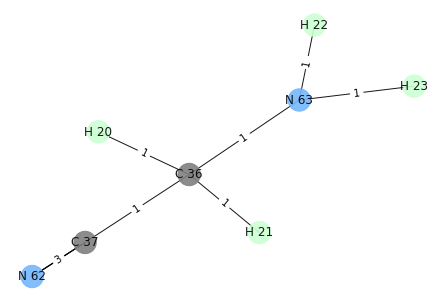

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


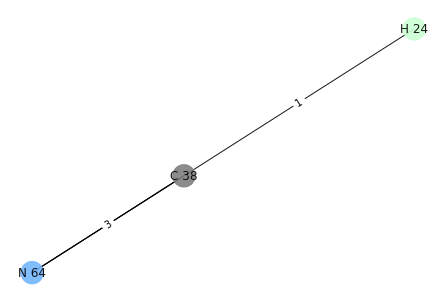

i: 4
Removing edge between: C 36 C 37
Adding edge between: C 36 H 22
N 63 0
H 23 0
C 38 0
H 20 0
N 64 0
H 21 0
C 36 0
H 22 0


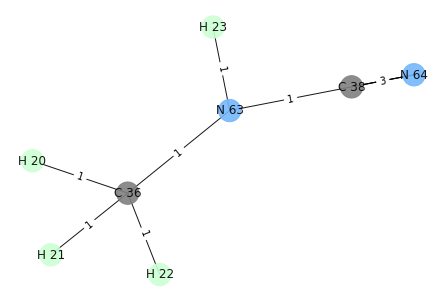

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


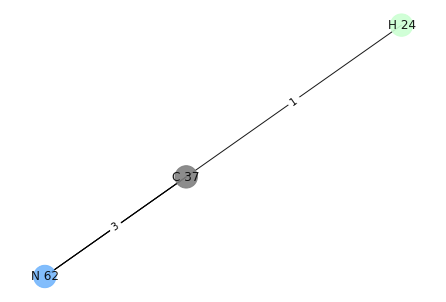

i: 5
Removing edge between: N 64 C 38
Adding edge between: N 64 H 22
C 38 1
H 23 0
H 22 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
N 64 0


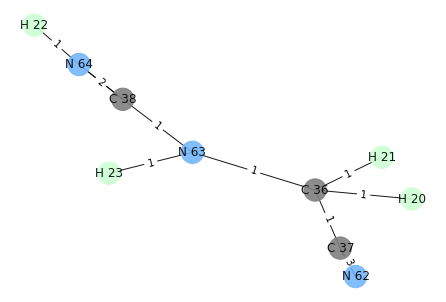

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


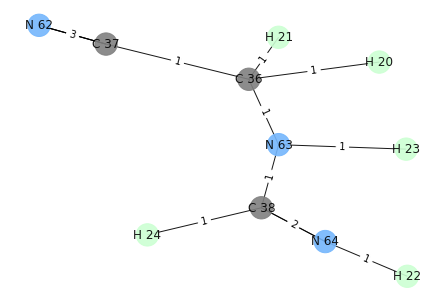

[{H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


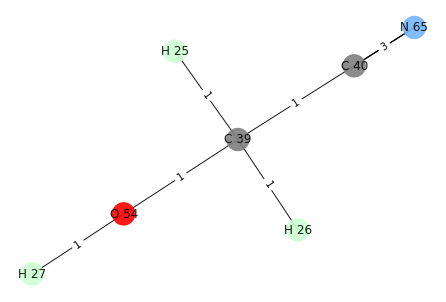

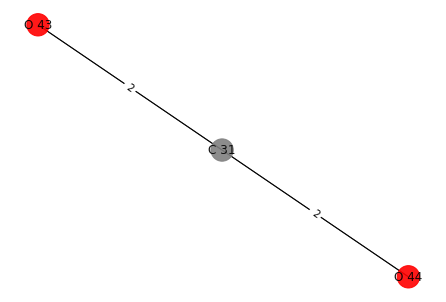

[{O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


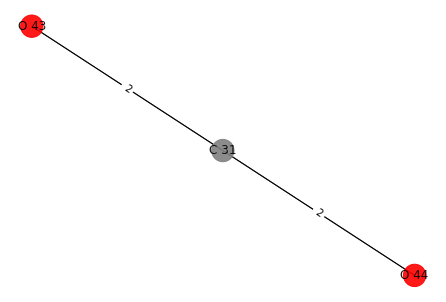

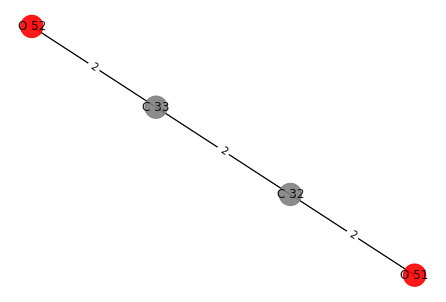

[{C 32, C 33, O 51, O 52}]
15
[{C 28, H 2, O 41, H 1}, {H 3, C 29, N 55}, {N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]
{C 28, H 2, O 41, H 1}
{H 3, C 29, N 55}
7


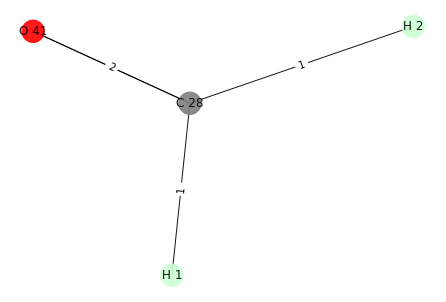

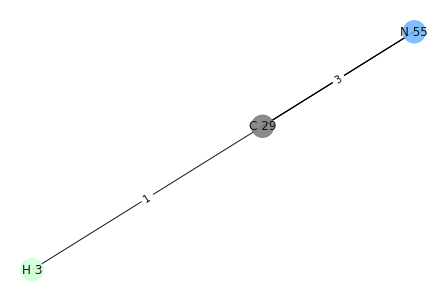

H 1
H 3
C 28 C 29


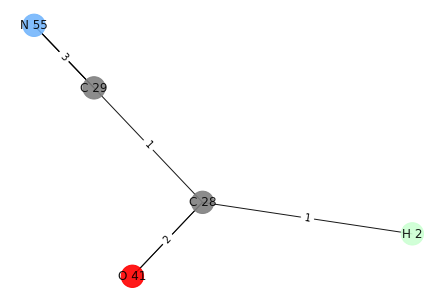

{C 28, C 29, H 2, O 41, N 55}
[C 28, O 41, C 29, N 55]
i: 0
Removing edge between: C 28 O 41
Adding edge between: C 28 H 1
C 28 0
H 1 0
C 29 0
H 2 0
O 41 1
N 55 0


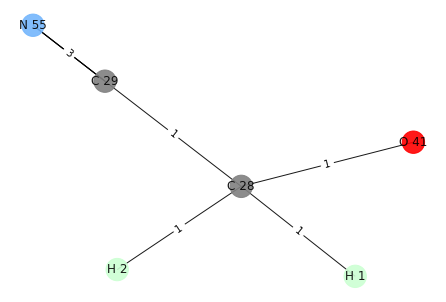

C 28 0
O 41 1
C 29 0
N 55 0
[O 41] H 3


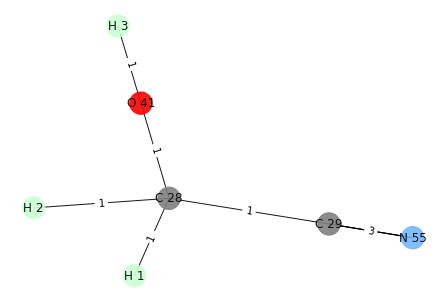

i: 1
Removing edge between: O 41 C 28
Adding edge between: O 41 H 1
C 28 1
H 1 0
C 29 0
H 2 0
O 41 0
N 55 0


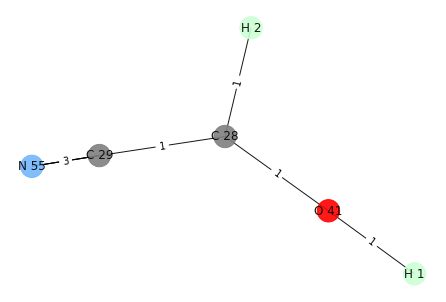

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


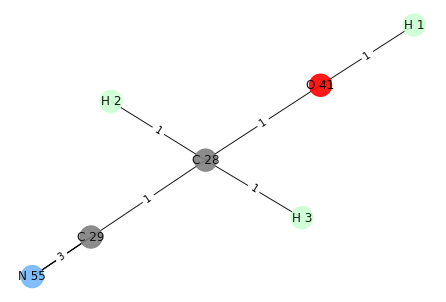

i: 2
Removing edge between: C 29 C 28
Adding edge between: C 29 H 1
H 1 0
C 29 0
N 55 0


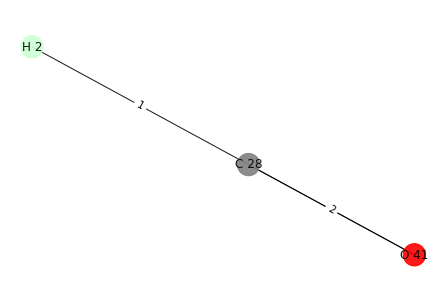

C 28 1
O 41 0
C 29 0
N 55 0
[C 28] H 3


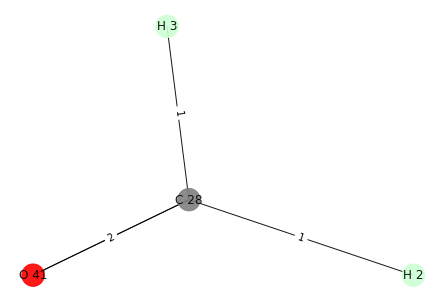

i: 3
Removing edge between: N 55 C 29
Adding edge between: N 55 H 1
C 28 0
H 1 0
C 29 1
O 41 0
H 2 0
N 55 0


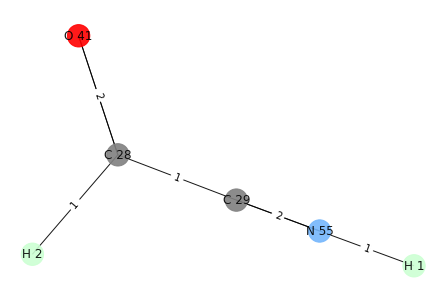

C 28 0
O 41 0
C 29 1
N 55 0
[C 29] H 3


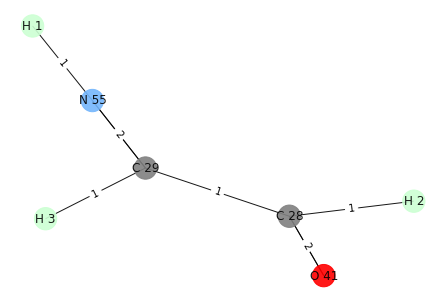

[{N 56, H 6, H 4, H 5}, {H 7, C 30, N 57, O 42}, {H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


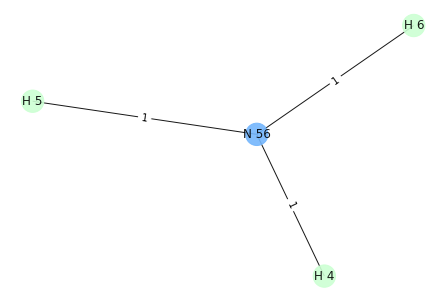

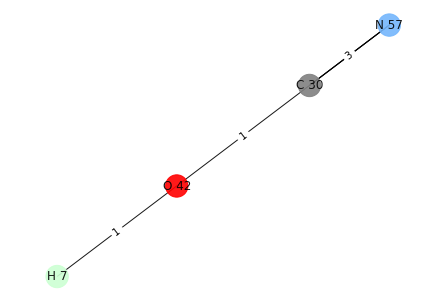

H 5
H 7
N 56 O 42


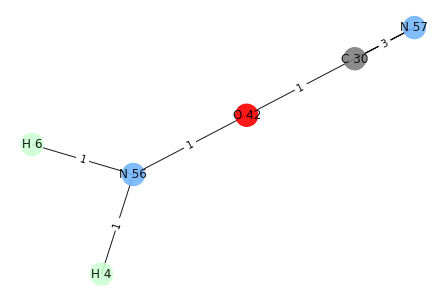

{H 6, O 42, H 4, C 30, N 56, N 57}
[O 42, N 56, C 30, N 57]
i: 0
Removing edge between: O 42 C 30
Adding edge between: O 42 H 5
H 6 0
O 42 0
H 4 0
H 5 0
N 56 0


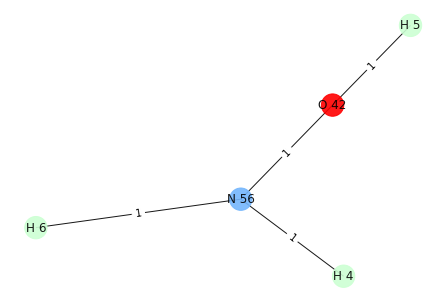

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


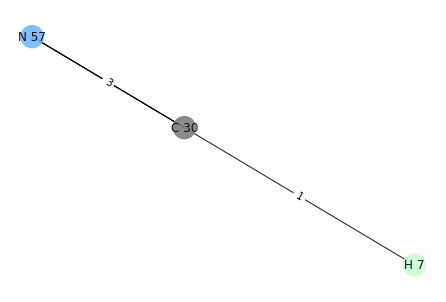

i: 1
Removing edge between: N 56 O 42
Adding edge between: N 56 H 5
N 56 0
H 6 0
H 5 0
H 4 0


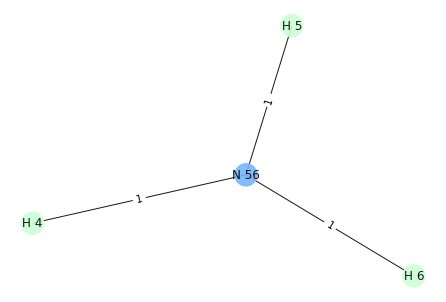

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


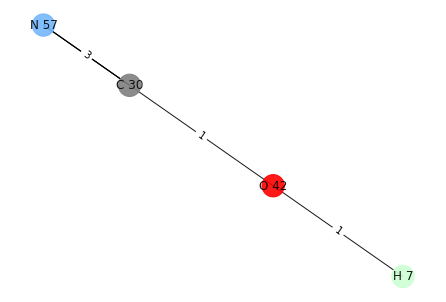

i: 2
Removing edge between: C 30 O 42
Adding edge between: C 30 H 5
N 57 0
C 30 0
H 5 0


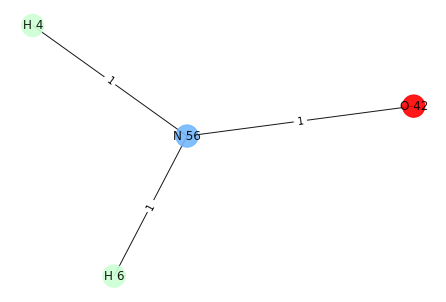

O 42 1
N 56 0
C 30 0
N 57 0
[O 42] H 7


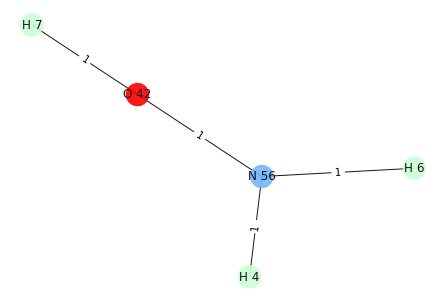

i: 3
Removing edge between: N 57 C 30
Adding edge between: N 57 H 5
H 6 0
O 42 0
H 4 0
C 30 1
H 5 0
N 57 0
N 56 0


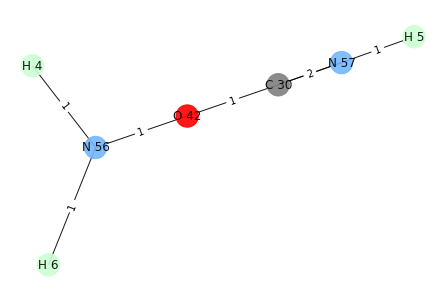

O 42 0
N 56 0
C 30 1
N 57 0
[C 30] H 7


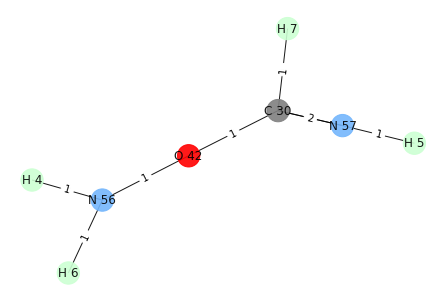

[{H 8, H 9, O 45, O 46}, {N 58, N 59, H 10, H 11}, {N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


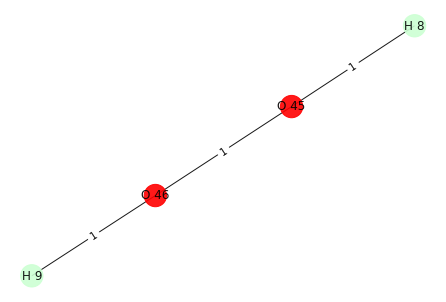

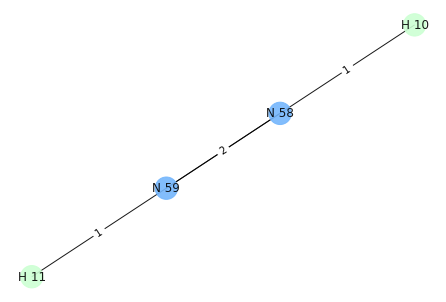

H 8
H 10
O 45 N 58


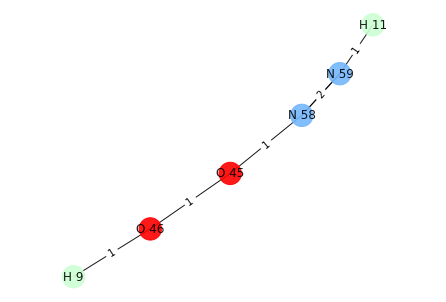

{O 45, H 11, N 58, O 46, N 59, H 9}
[O 45, N 59, O 46, N 58]
i: 0
Removing edge between: O 45 O 46
Adding edge between: O 45 H 8
O 45 0
H 11 0
N 58 0
H 8 0
N 59 0


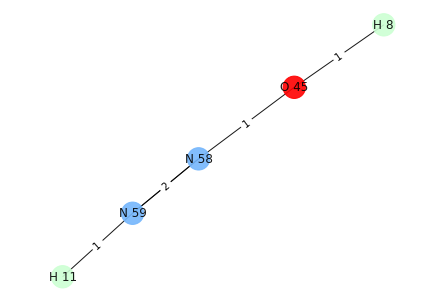

O 45 0
N 59 0
O 46 1
N 58 0
[O 46] H 10


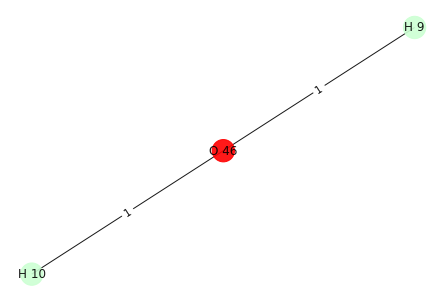

i: 1
Removing edge between: N 59 N 58
Adding edge between: N 59 H 8
O 45 0
H 11 0
N 58 1
O 46 0
H 8 0
N 59 0
H 9 0


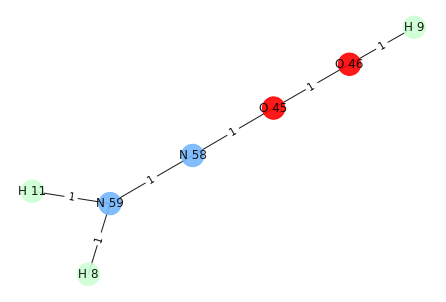

O 45 0
N 59 0
O 46 0
N 58 1
[N 58] H 10


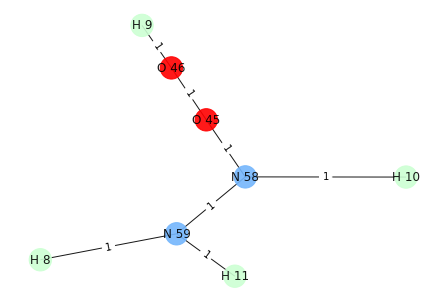

i: 2
Removing edge between: O 46 O 45
Adding edge between: O 46 H 8
H 8 0
H 9 0
O 46 0


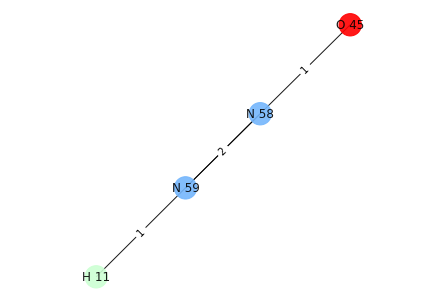

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 10


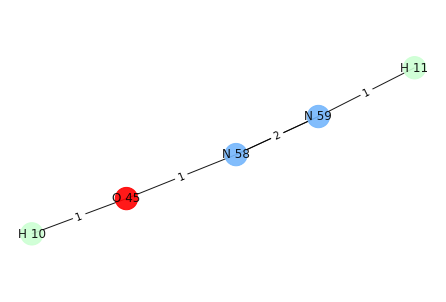

i: 3
Removing edge between: N 58 O 45
Adding edge between: N 58 H 8
H 8 0
H 11 0
N 59 0
N 58 0


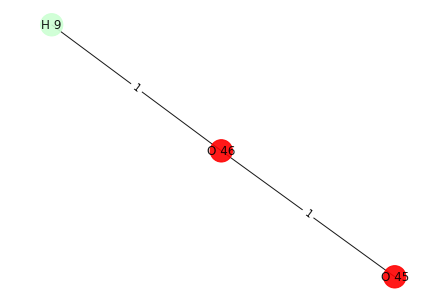

O 45 1
N 59 0
O 46 0
N 58 0
[O 45] H 10


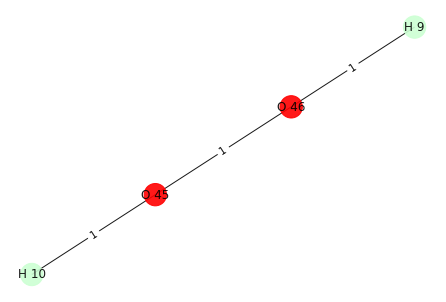

[{N 60, H 12, O 47}, {N 61, O 49, H 13, O 48}, {O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


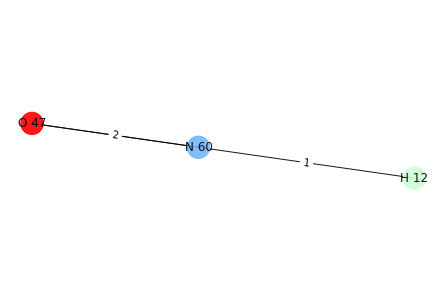

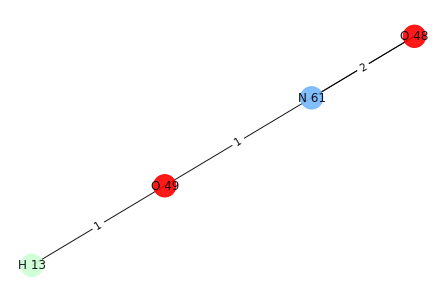

H 12
H 13
N 60 O 49


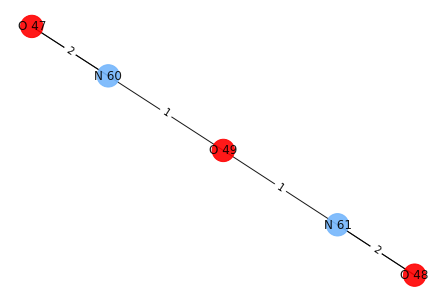

{N 60, O 49, N 61, O 47, O 48}
[N 60, O 49, N 61, O 47, O 48]
i: 0
Removing edge between: N 60 O 47
Adding edge between: N 60 H 12
N 60 0
O 49 0
N 61 0
H 12 0
O 47 1
O 48 0


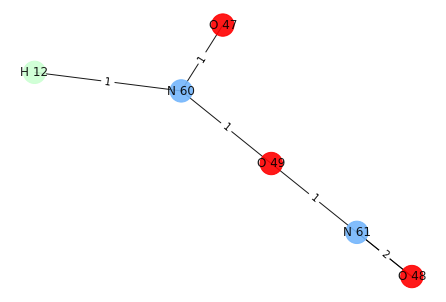

N 60 0
O 49 0
N 61 0
O 47 1
O 48 0
[O 47] H 13


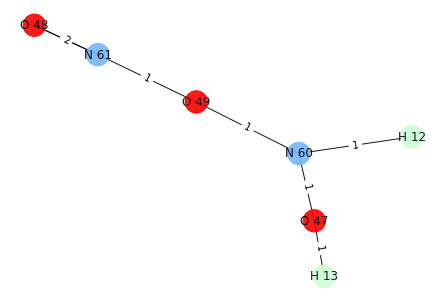

i: 1
Removing edge between: O 49 N 60
Adding edge between: O 49 H 12
N 61 0
O 49 0
H 12 0
O 48 0


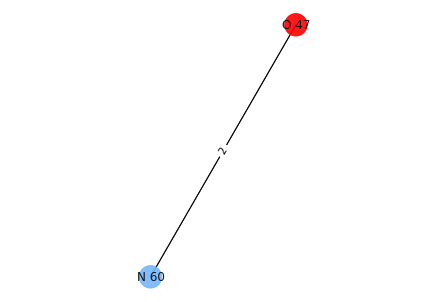

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


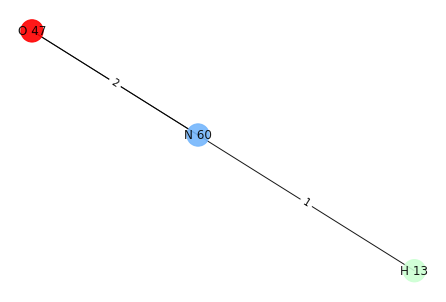

i: 2
Removing edge between: N 61 O 49
Adding edge between: N 61 H 12
N 61 0
H 12 0
O 48 0


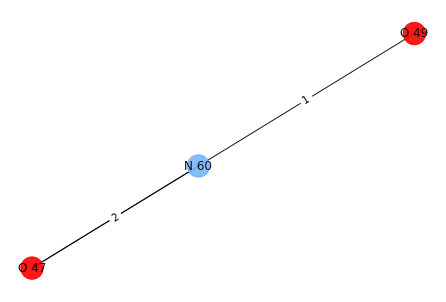

N 60 0
O 49 1
N 61 0
O 47 0
O 48 0
[O 49] H 13


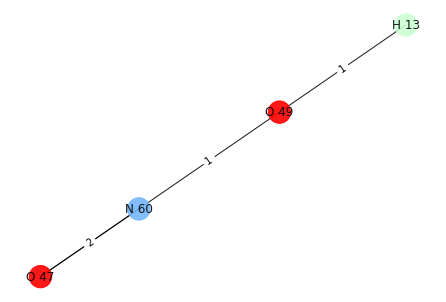

i: 3
Removing edge between: O 47 N 60
Adding edge between: O 47 H 12
N 60 1
O 49 0
N 61 0
H 12 0
O 47 0
O 48 0


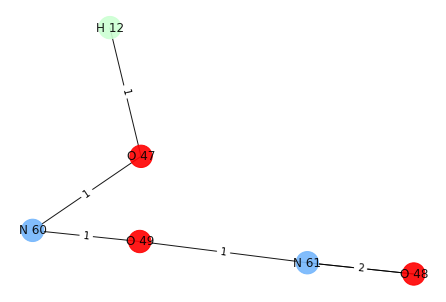

N 60 1
O 49 0
N 61 0
O 47 0
O 48 0
[N 60] H 13


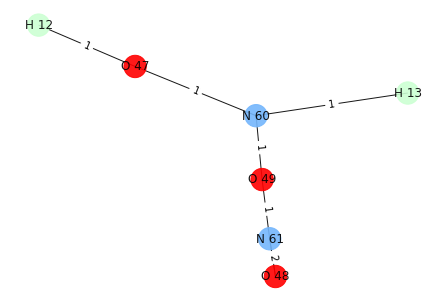

i: 4
Removing edge between: O 48 N 61
Adding edge between: O 48 H 12
N 60 0
O 49 0
N 61 1
H 12 0
O 47 0
O 48 0


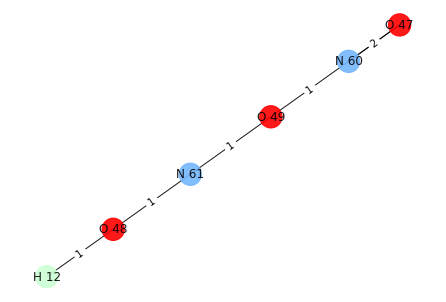

N 60 0
O 49 0
N 61 1
O 47 0
O 48 0
[N 61] H 13


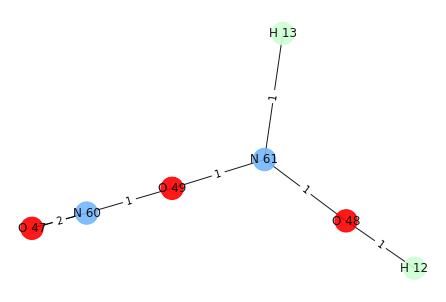

[{O 50, H 14, H 15}, {O 53, H 19, C 34, H 16, C 35, H 17, H 18}, {H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


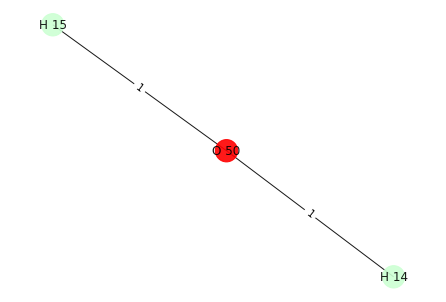

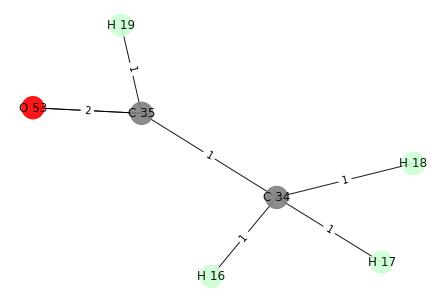

H 15
H 17
O 50 C 34


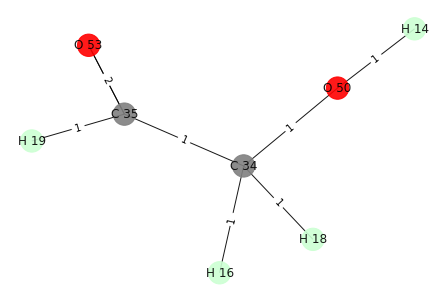

{O 53, H 19, O 50, C 34, H 18, H 16, C 35, H 14}
[O 53, C 34, C 35, O 50]
i: 0
Removing edge between: O 53 C 35
Adding edge between: O 53 H 15
O 53 0
H 19 0
H 15 0
H 14 0
C 34 0
O 50 0
H 16 0
C 35 1
H 18 0


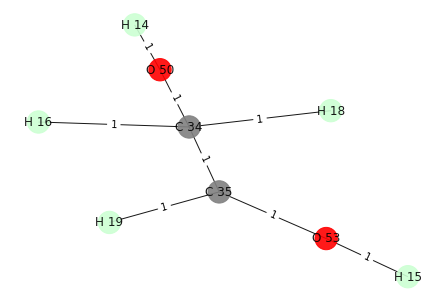

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 17


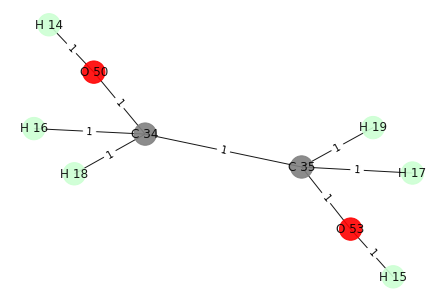

i: 1
Removing edge between: C 34 C 35
Adding edge between: C 34 H 15
H 15 0
H 14 0
C 34 0
O 50 0
H 16 0
H 18 0


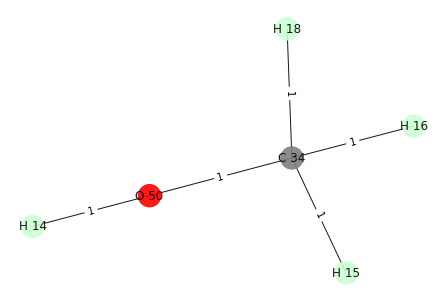

O 53 0
C 34 0
C 35 1
O 50 0
[C 35] H 17


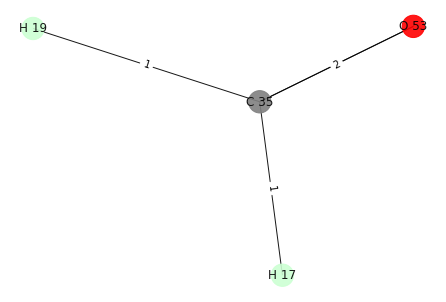

i: 2
Removing edge between: C 35 O 53
Adding edge between: C 35 H 15
O 53 1
H 19 0
H 15 0
H 14 0
C 34 0
O 50 0
H 16 0
C 35 0
H 18 0


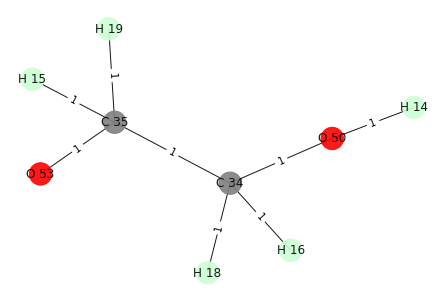

O 53 1
C 34 0
C 35 0
O 50 0
[O 53] H 17


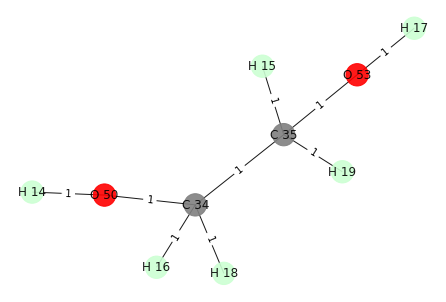

i: 3
Removing edge between: O 50 C 34
Adding edge between: O 50 H 15
O 50 0
H 15 0
H 14 0


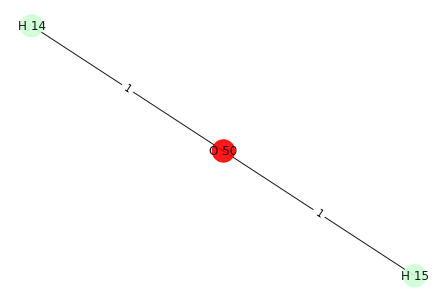

O 53 0
C 34 1
C 35 0
O 50 0
[C 34] H 17


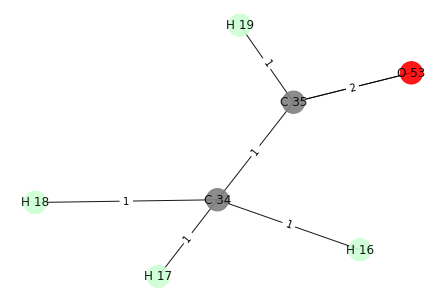

[{H 20, C 37, N 62, H 21, C 36, H 22}, {H 23, C 38, H 24, N 63, N 64}, {H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


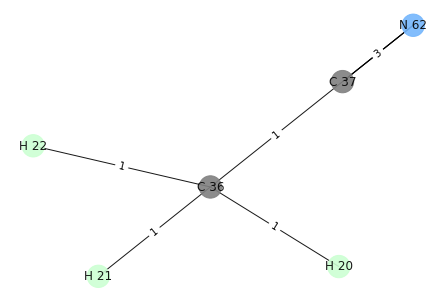

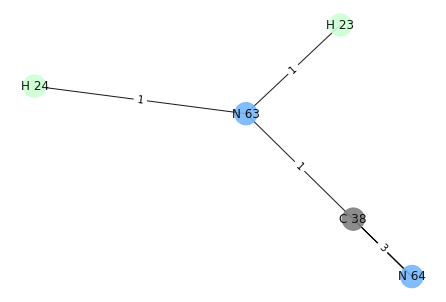

H 22
H 24
C 36 N 63


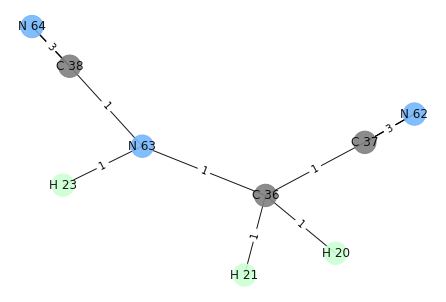

{N 63, C 38, H 23, H 20, C 37, N 62, H 21, C 36, N 64}
[C 38, C 37, N 62, N 63, C 36, N 64]
i: 0
Removing edge between: C 38 N 63
Adding edge between: C 38 H 22
N 64 0
H 22 0
C 38 0


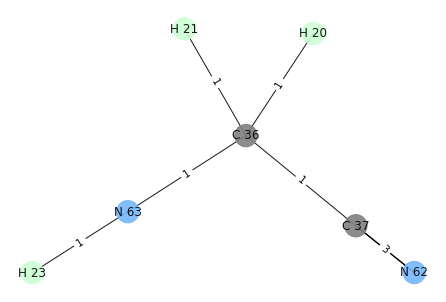

C 38 0
C 37 0
N 62 0
N 63 1
C 36 0
N 64 0
[N 63] H 24


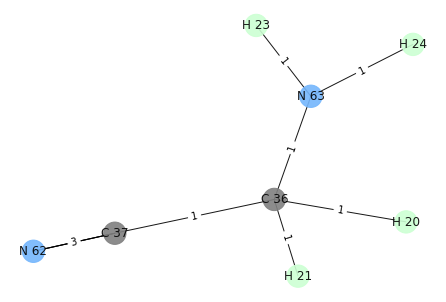

i: 1
Removing edge between: C 37 C 36
Adding edge between: C 37 H 22
C 37 0
H 22 0
N 62 0


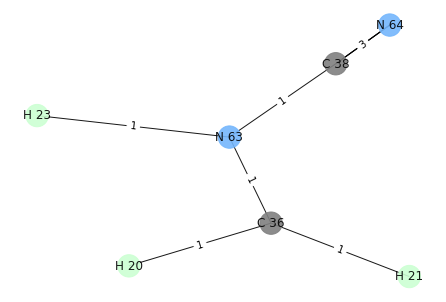

C 38 0
C 37 0
N 62 0
N 63 0
C 36 1
N 64 0
[C 36] H 24


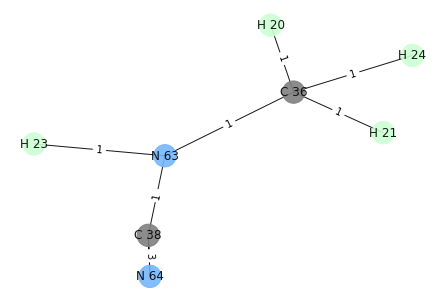

i: 2
Removing edge between: N 62 C 37
Adding edge between: N 62 H 22
N 63 0
H 23 0
C 38 0
H 20 0
C 37 1
N 62 0
N 64 0
H 21 0
C 36 0
H 22 0


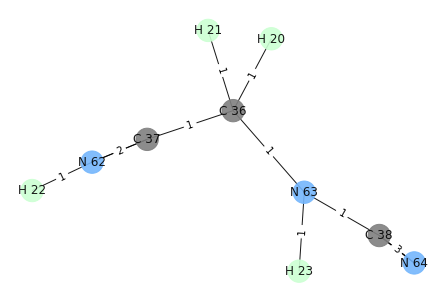

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


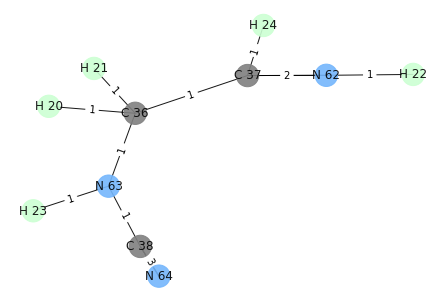

i: 3
Removing edge between: N 63 C 38
Adding edge between: N 63 H 22
H 23 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
H 22 0


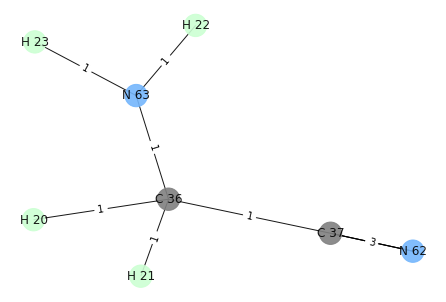

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


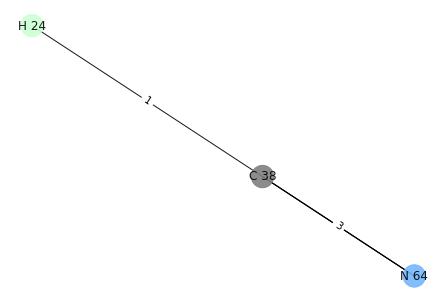

i: 4
Removing edge between: C 36 C 37
Adding edge between: C 36 H 22
N 63 0
H 23 0
C 38 0
H 20 0
N 64 0
H 21 0
C 36 0
H 22 0


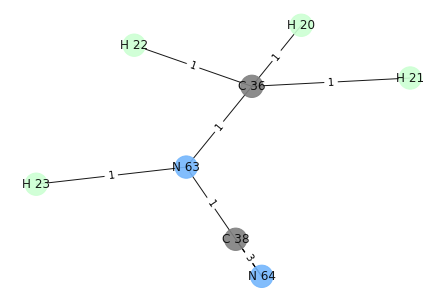

C 38 0
C 37 1
N 62 0
N 63 0
C 36 0
N 64 0
[C 37] H 24


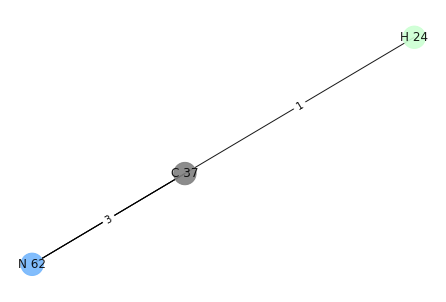

i: 5
Removing edge between: N 64 C 38
Adding edge between: N 64 H 22
C 38 1
H 23 0
H 22 0
H 20 0
C 37 0
N 62 0
H 21 0
N 63 0
C 36 0
N 64 0


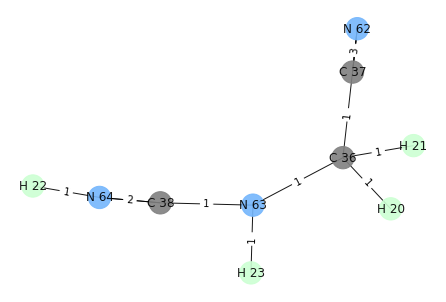

C 38 1
C 37 0
N 62 0
N 63 0
C 36 0
N 64 0
[C 38] H 24


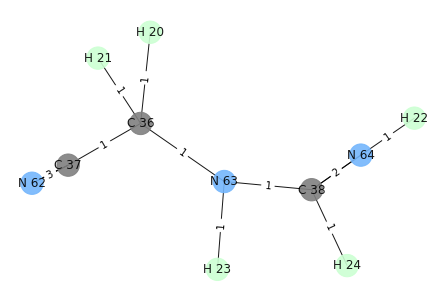

[{H 27, O 54, N 65, C 39, C 40, H 25, H 26}, {O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


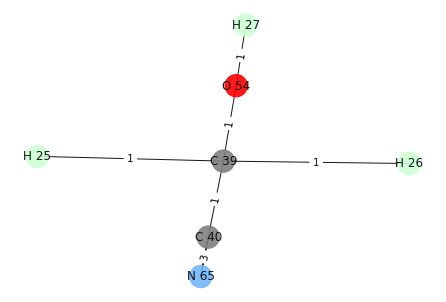

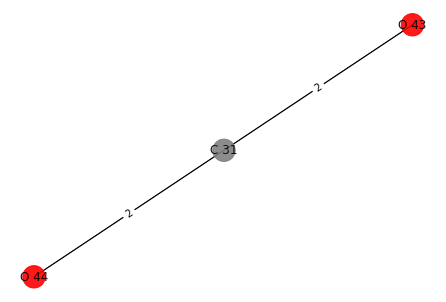

[{O 44, C 31, O 43}, {C 32, C 33, O 51, O 52}]


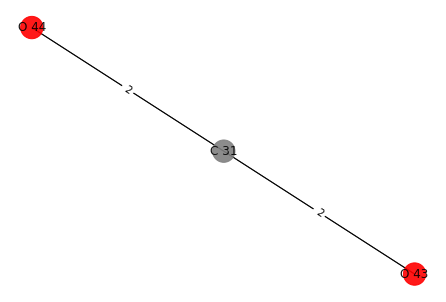

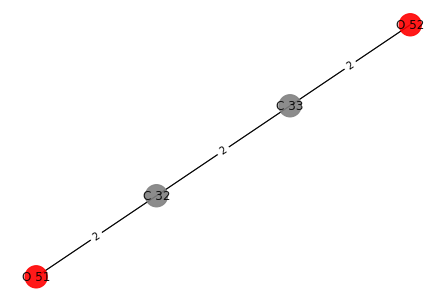

[{C 32, C 33, O 51, O 52}]


In [12]:
#Perform mutiple trials of Simulated Annealing for bonds in N and update them in final_dict.
#In final_dict, keys: subgraphs of N, value: associated G value for each connected component
trails = 10
n = len(list(nx.connected_components(N)))
final_dict = {}
order = [i for i in range(n)]
for i in range(trails):
    final_dict.update(simulated_annealing_bonds(N, order))

In [13]:
# To ensure that the final dictionary also includes the initial compounds, they are added again to the dictionary.

ctr = 0
for cc in nx.connected_components(N):
    sub_N = N.subgraph(list(cc))
    g = G_value_N[ctr]
    final_dict.update({sub_N:g})
    ctr+=1


270
285


In [14]:
#All those networks whose corresponding Gibbs free energy change is greater than 10 kJ are removed from the dictionary.

new_final = final_dict.copy()
for i in final_dict:
    if final_dict[i] > 10:
        new_final.pop(i)
new_final_copy = new_final

del(new_final)
new_final = new_final_copy

In [16]:
# Dictionary cyanides identifies -C:::N in the final_dict and 
# stores that connected component along with the indices of respective C and N.

cyanides = {}
for compound in new_final:
    cyanides[compound] = []
    carbons = [i for i in nx.nodes(compound) if i._name.split()[0]=="C"]
    for i in carbons:
        for j in compound[i]:
            if j._name.split()[0]=="N" and compound[i][j][0]['number']==3:
                cyanides[compound].append((i,j))
                
print(cyanides)

{<networkx.classes.multigraph.MultiGraph object at 0x0000013D4EFF7B88>: [(C 29, N 55)], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DEFF208>: [(C 29, N 55)], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DD1C188>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4D089908>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DFC4F48>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4F0AE488>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DED7348>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4F162408>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4EFB0A48>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DE55548>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DF29208>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4F117F08>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DF9AC08>: [], 

In [17]:
# Dictionary aldehyde_ketones identifies -C::O in the final_dict and 
# stores that connected component along with the indices of respective C and O.

aldehyde_ketones = {}
for compound in new_final:
    aldehyde_ketones[compound] = []
    carbons = [i for i in nx.nodes(compound) if i._name.split()[0]=="C"]
    for i in carbons:
        flag2 = False
        flag3 = False
        neigh = ()
        for j in compound[i]:
            if j._name.split()[0]=="O" and compound[i][j][0]['number']==2:
                neigh = (i,j)
            if (j._name.split()[0]=="H") or (j._name.split()[0]=="C"):
                flag2 = True
            if (j._name.split()[0]=="O") and (compound[i][j][0]['number']==1):
                flag3 = True
        if neigh and flag2 and (not flag3):
            aldehyde_ketones[compound].append(neigh)
                
print(aldehyde_ketones)

{<networkx.classes.multigraph.MultiGraph object at 0x0000013D4EFF7B88>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DEFF208>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DD1C188>: [(C 28, O 41)], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4D089908>: [(C 28, O 41)], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DFC4F48>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4F0AE488>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DED7348>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4F162408>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4EFB0A48>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DE55548>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DF29208>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4F117F08>: [], <networkx.classes.multigraph.MultiGraph object at 0x0000013D4DF9AC08>: [], 

Next compound


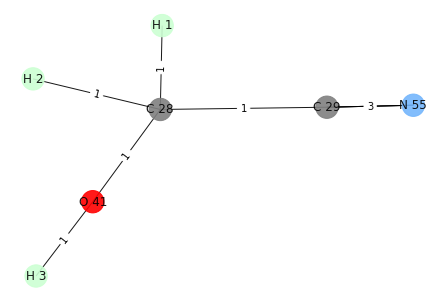

flag == True, CN
(C 29, N 55)


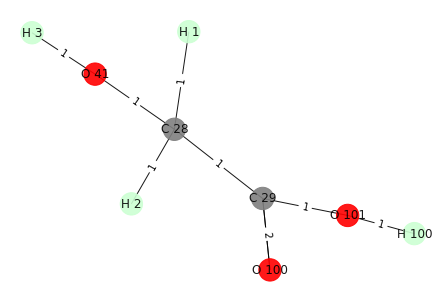

Enter G value of [C 28, H 1, C 29, O 100, H 100, H 2, O 41, H 3, O 101]: -820.39872


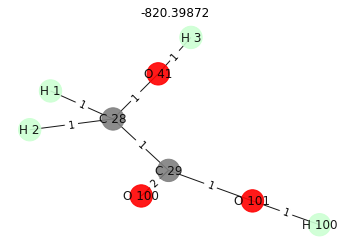

Next compound


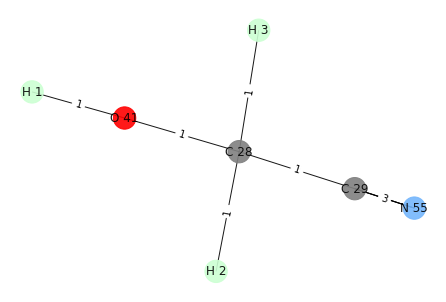

flag == True, CN
(C 29, N 55)


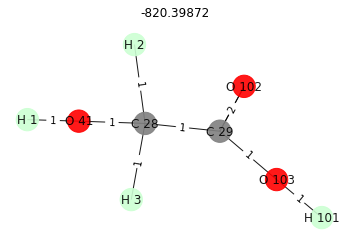

Next compound


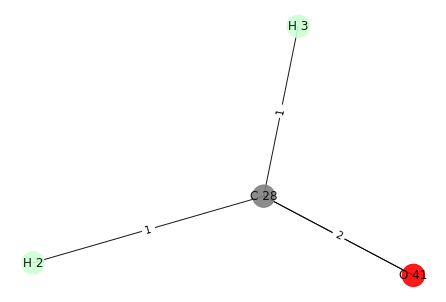

flag == True, CO


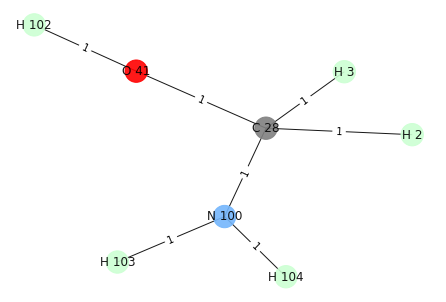

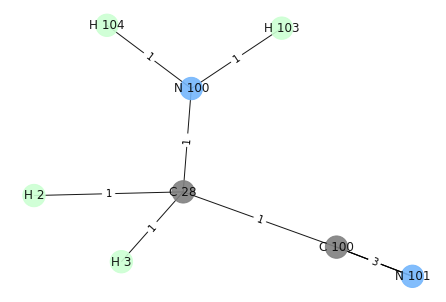

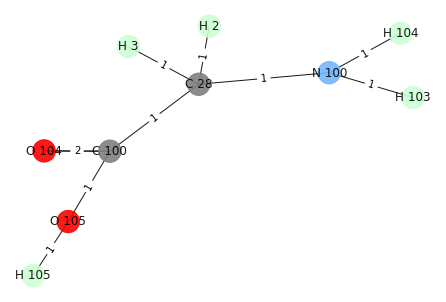

Enter G value of [C 28, N 100, H 103, C 100, H 105, H 2, H 104, O 104, O 105, H 3]: -664.5829247


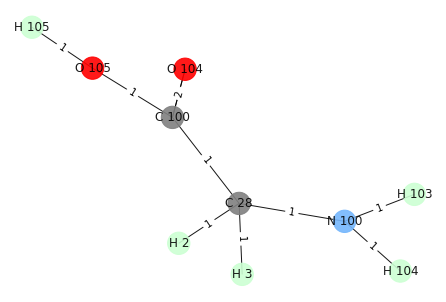

Next compound


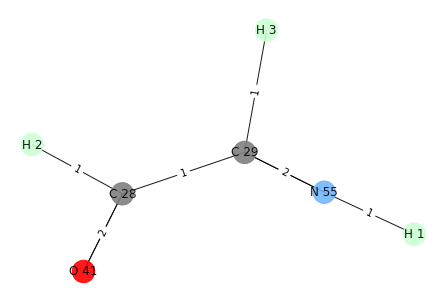

flag == True, CO


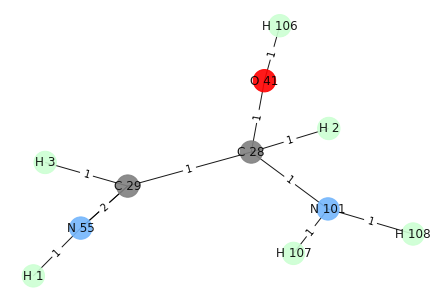

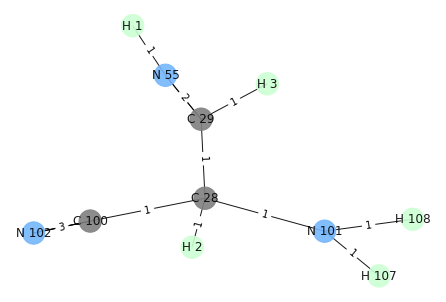

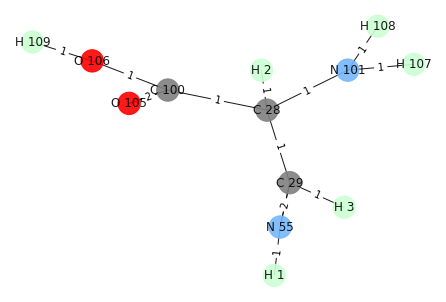

Enter G value of [C 28, N 101, O 106, C 29, H 1, C 100, H 2, H 107, N 55, H 108, H 109, O 105, H 3]: -200


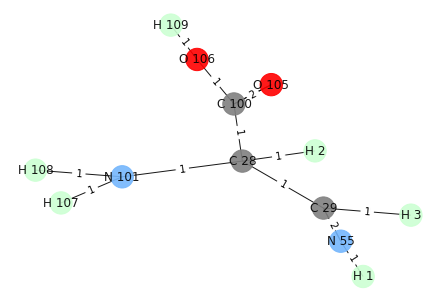

Next compound


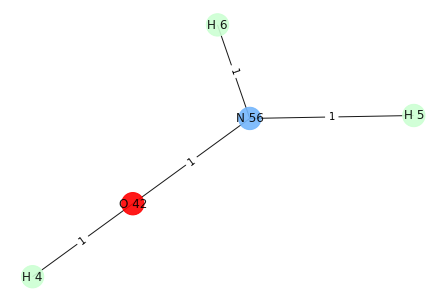

Next compound


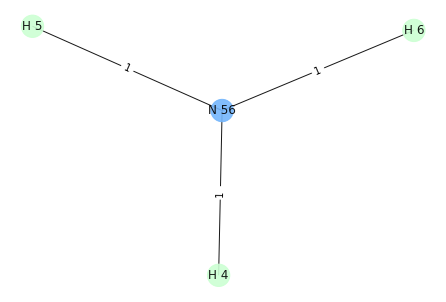

Next compound


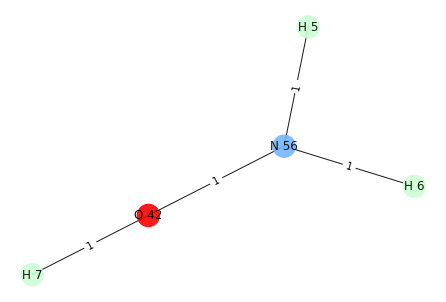

Next compound


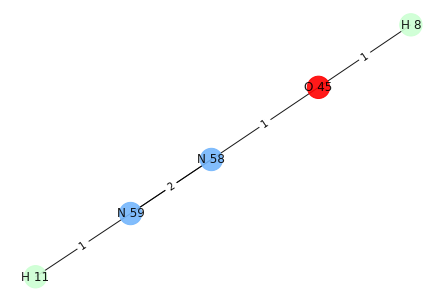

Next compound


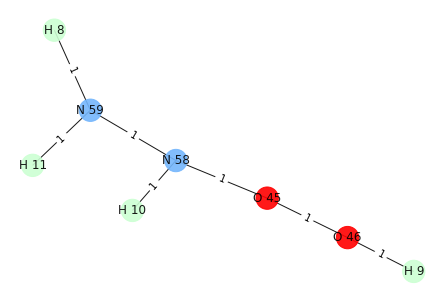

Next compound


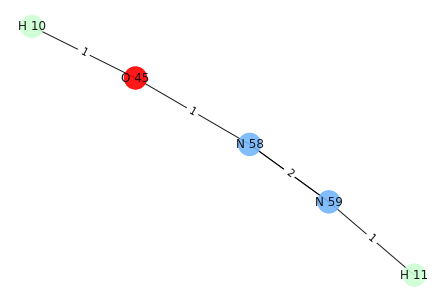

Next compound


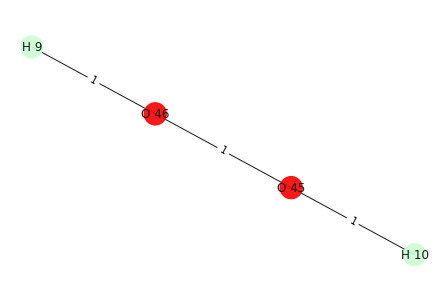

Next compound


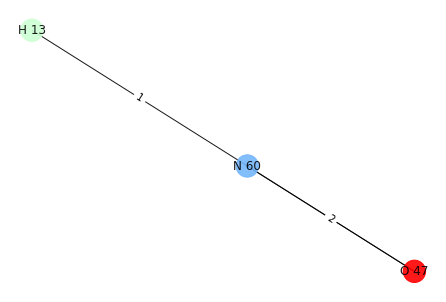

Next compound


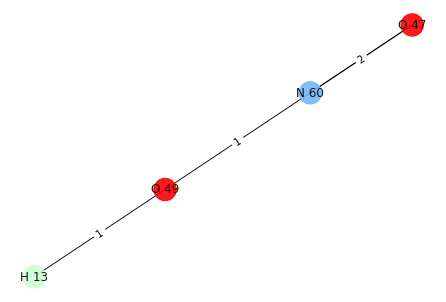

Next compound


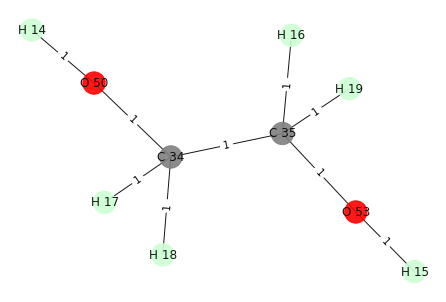

Next compound


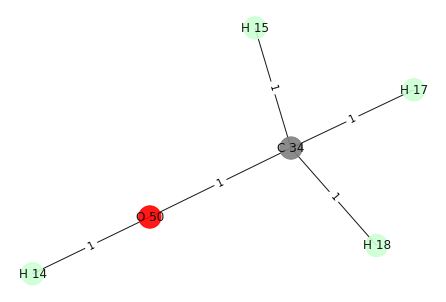

Next compound


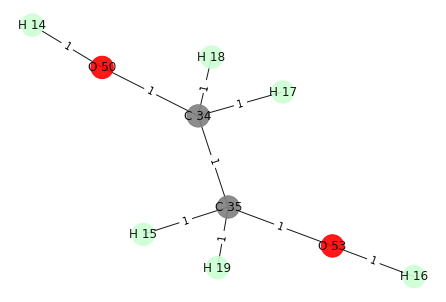

Next compound


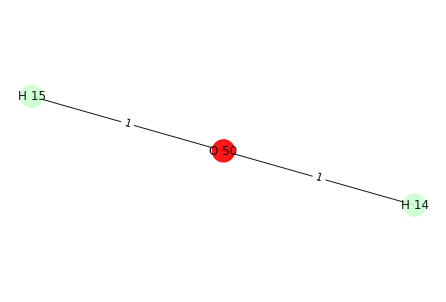

Next compound


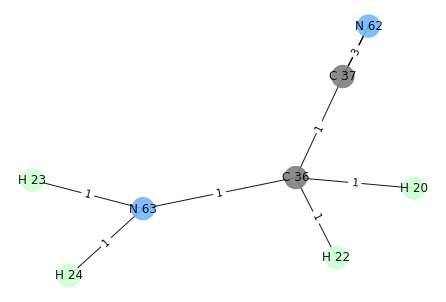

flag == True, CN
(C 37, N 62)


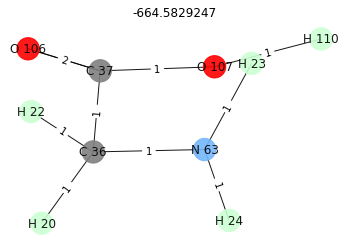

Next compound


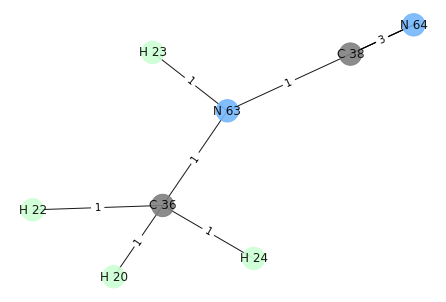

flag == True, CN
(C 38, N 64)


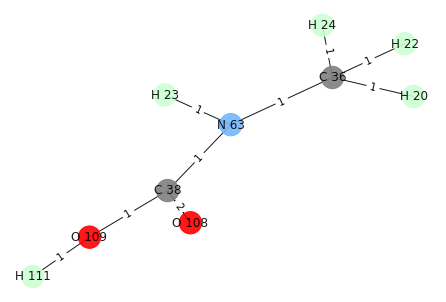

Enter G value of [H 23, C 38, H 111, H 20, H 24, O 108, O 109, N 63, C 36, H 22]: -200


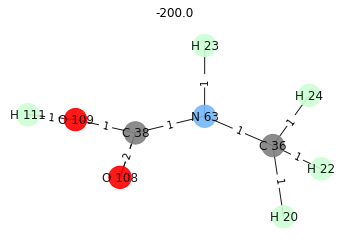

Next compound


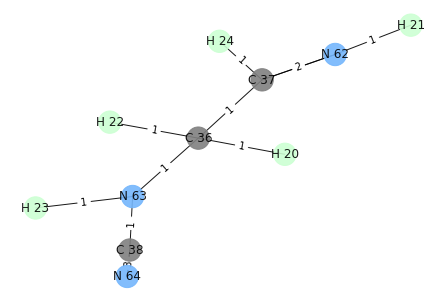

flag == True, CN
(C 38, N 64)


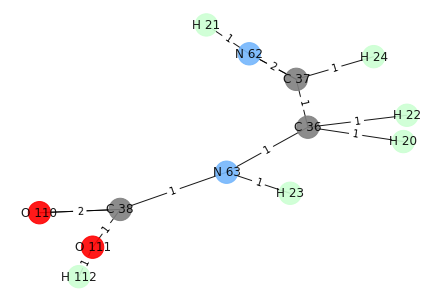

Enter G value of [H 23, C 38, O 111, H 20, H 24, C 37, O 110, H 112, N 62, H 21, N 63, C 36, H 22]: -200


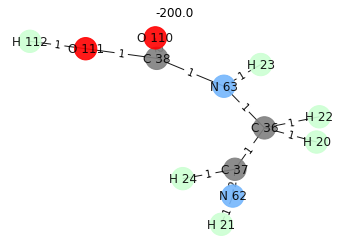

Next compound


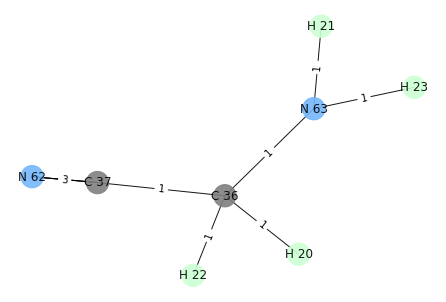

flag == True, CN
(C 37, N 62)


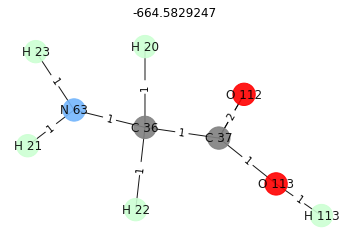

Next compound


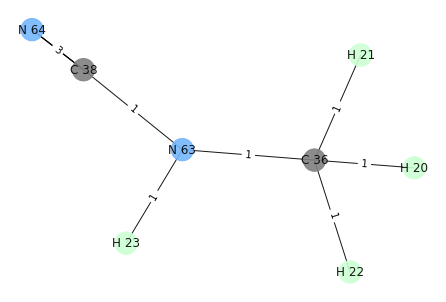

flag == True, CN
(C 38, N 64)


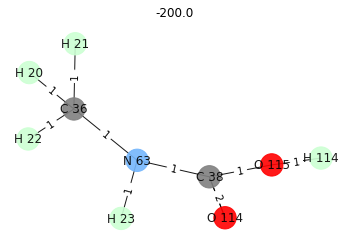

Next compound


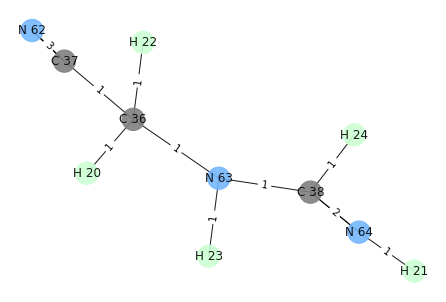

flag == True, CN
(C 37, N 62)


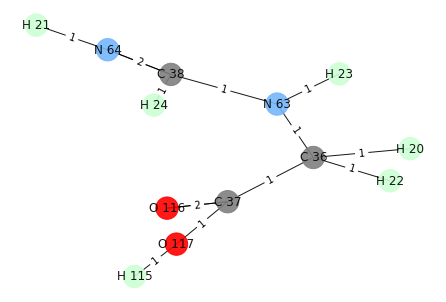

Enter G value of [H 23, C 38, H 115, H 20, H 24, O 116, C 37, N 64, H 21, O 117, N 63, C 36, H 22]: -200


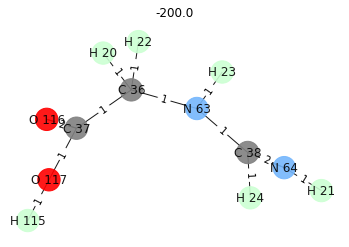

Next compound


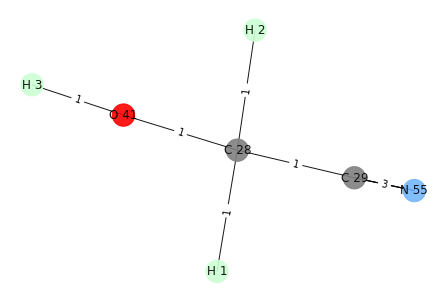

flag == True, CN
(C 29, N 55)


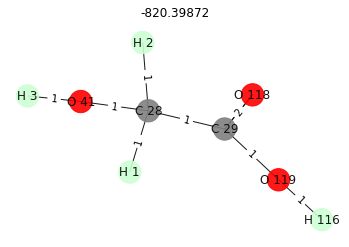

Next compound


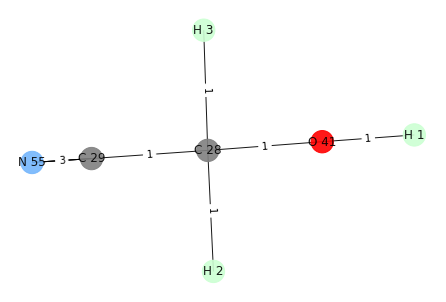

flag == True, CN
(C 29, N 55)


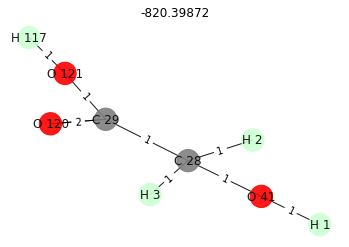

Next compound


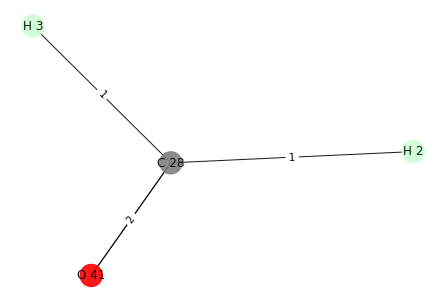

flag == True, CO


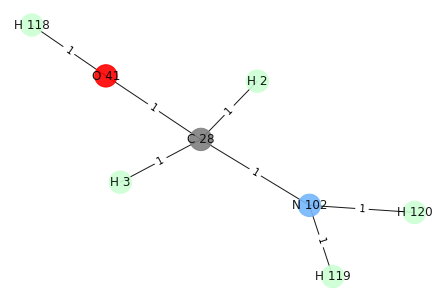

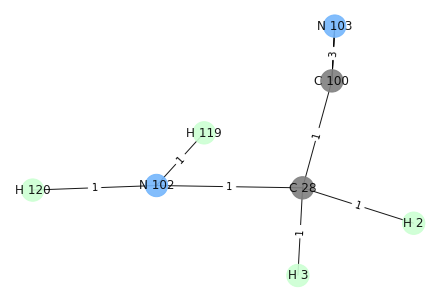

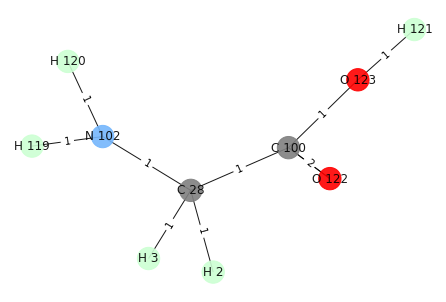

Next compound


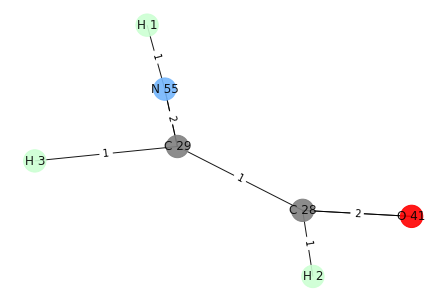

flag == True, CO


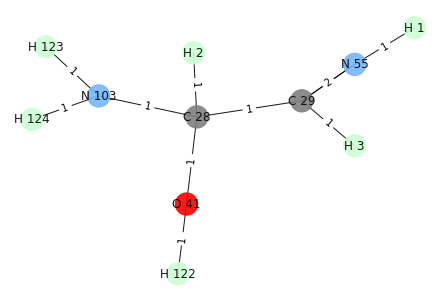

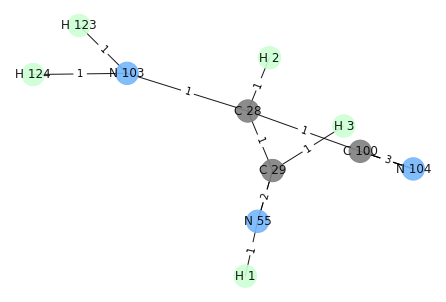

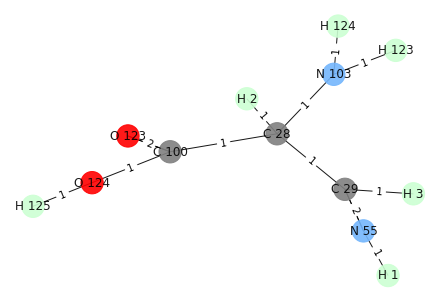

Next compound


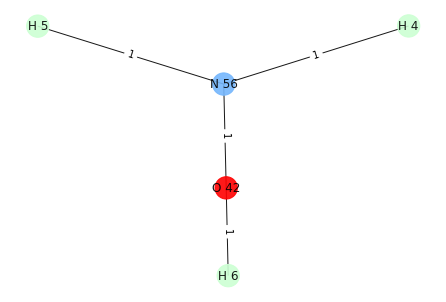

Next compound


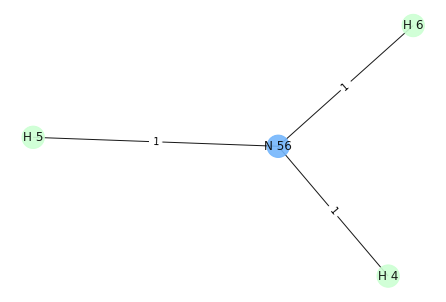

Next compound


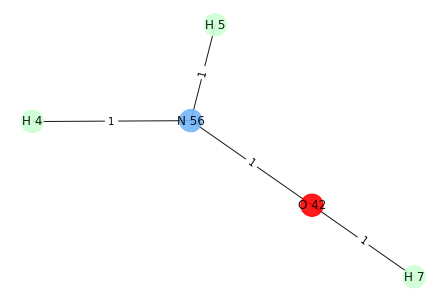

Next compound


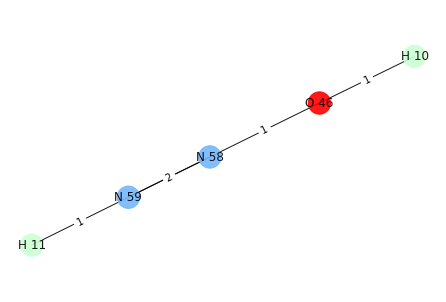

Next compound


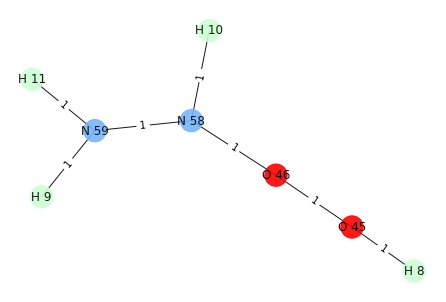

Next compound


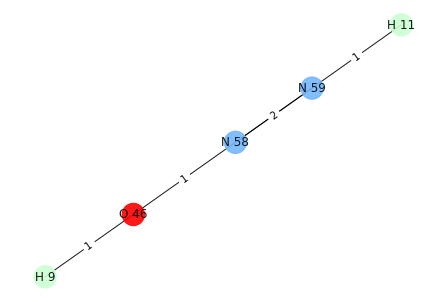

Next compound


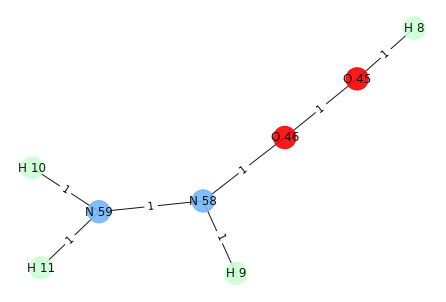

Next compound


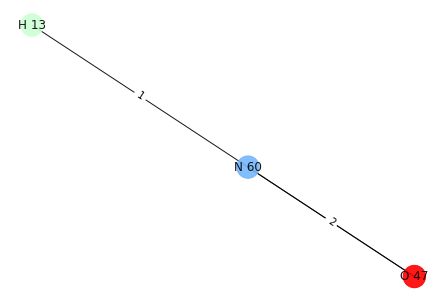

Next compound


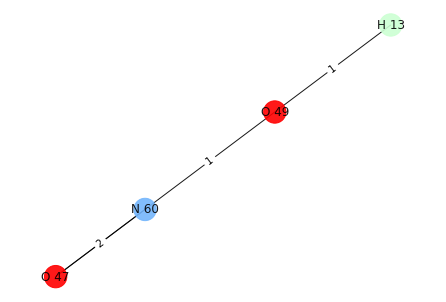

Next compound


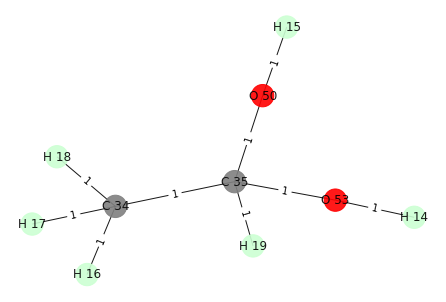

Next compound


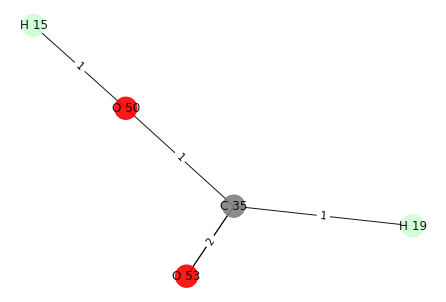

Next compound


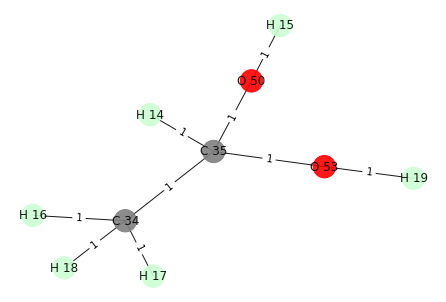

Next compound


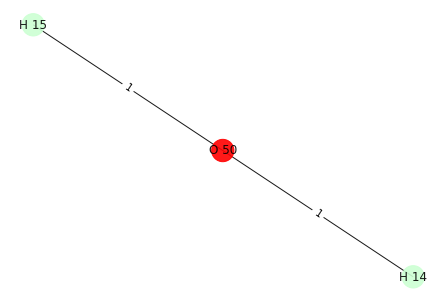

Next compound


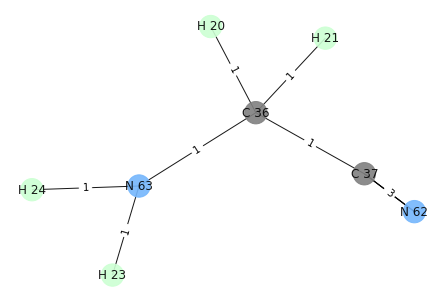

flag == True, CN
(C 37, N 62)


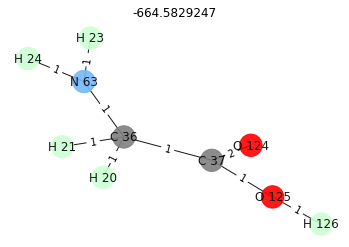

Next compound


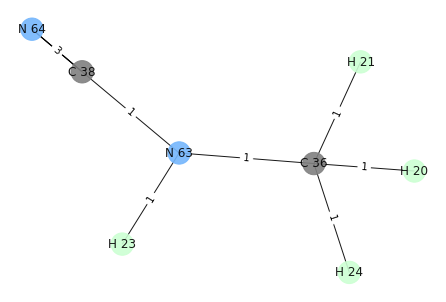

flag == True, CN
(C 38, N 64)


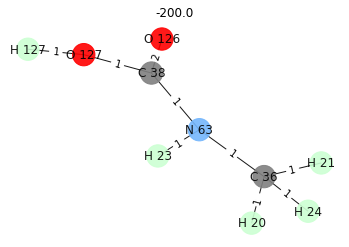

Next compound


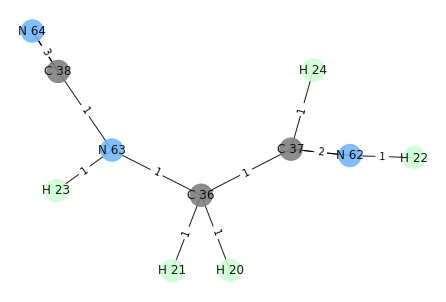

flag == True, CN
(C 38, N 64)


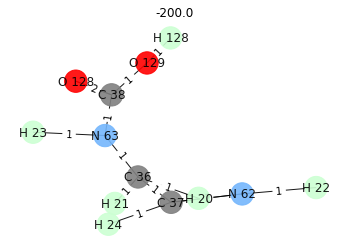

Next compound


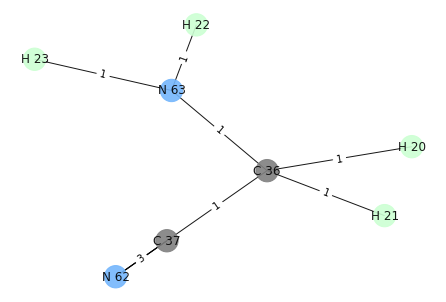

flag == True, CN
(C 37, N 62)


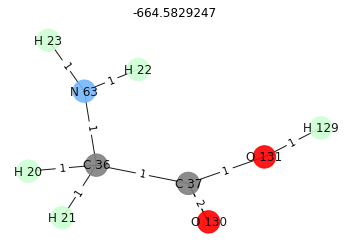

Next compound


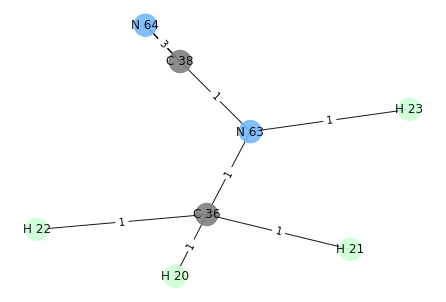

flag == True, CN
(C 38, N 64)


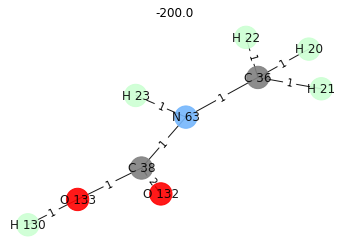

Next compound


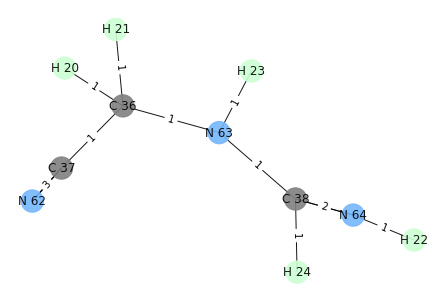

flag == True, CN
(C 37, N 62)


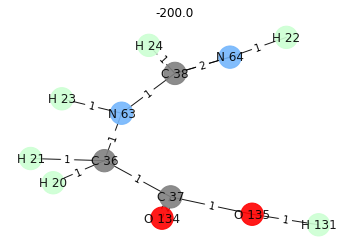

Next compound


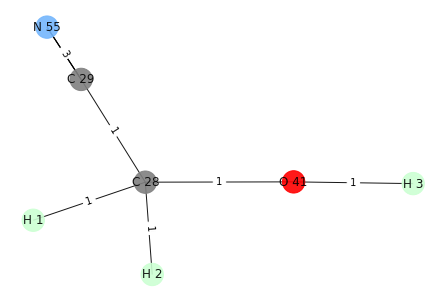

flag == True, CN
(C 29, N 55)


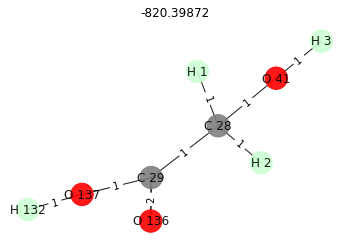

Next compound


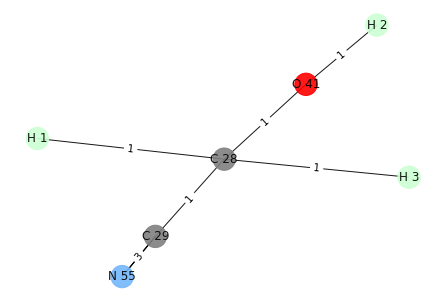

flag == True, CN
(C 29, N 55)


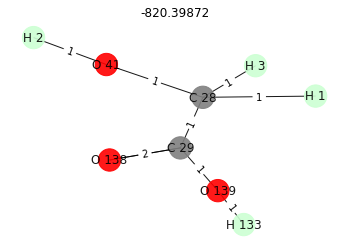

Next compound


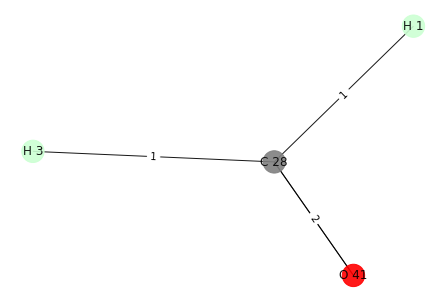

flag == True, CO


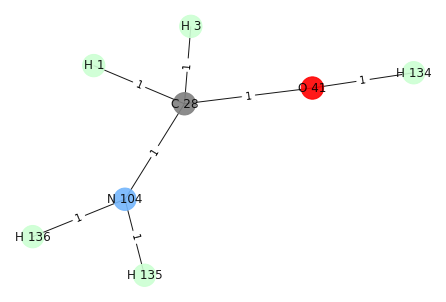

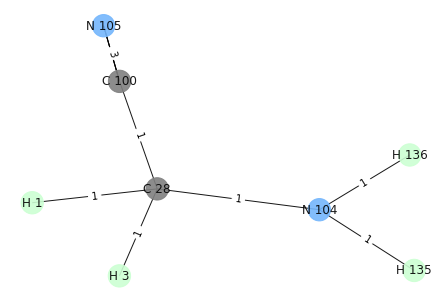

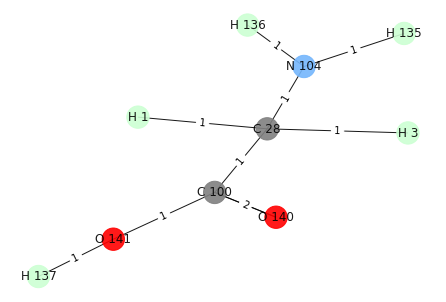

Next compound


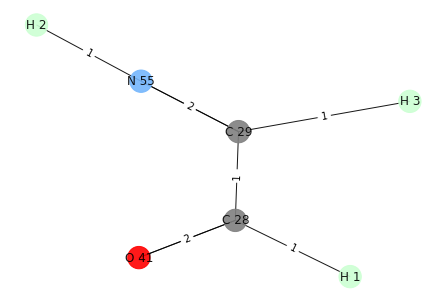

flag == True, CO


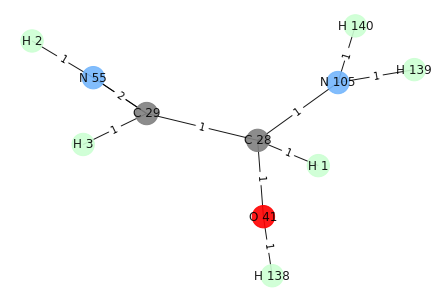

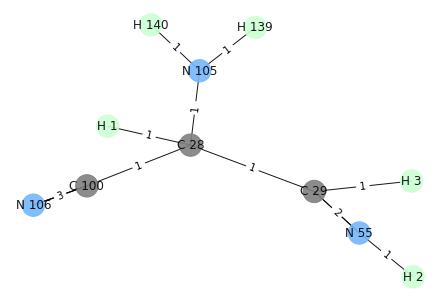

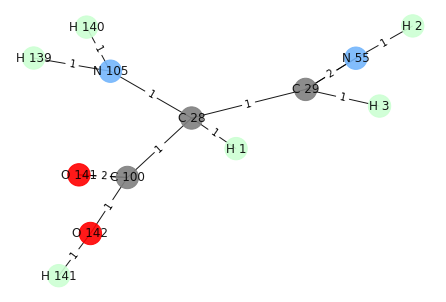

Next compound


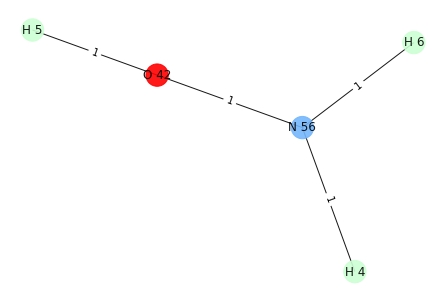

Next compound


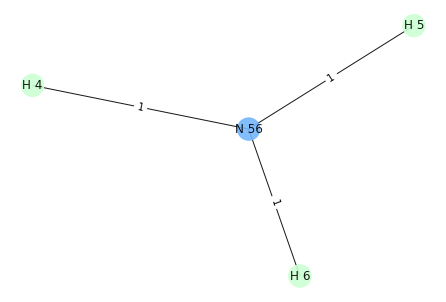

Next compound


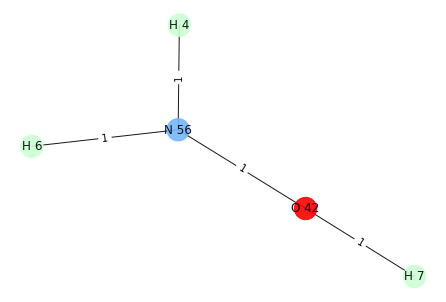

Next compound


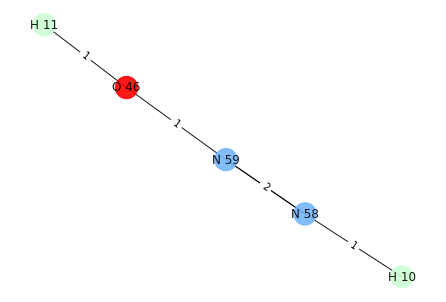

Next compound


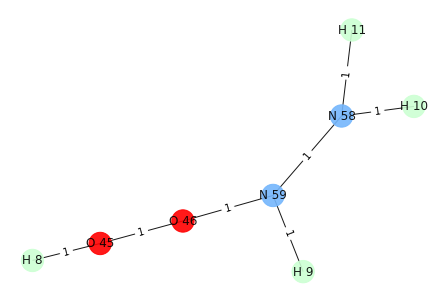

Next compound


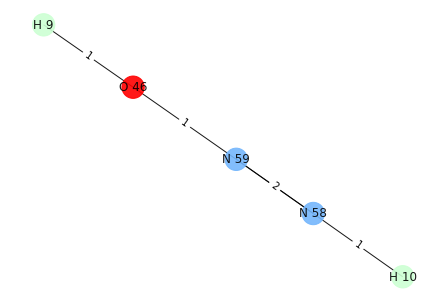

Next compound


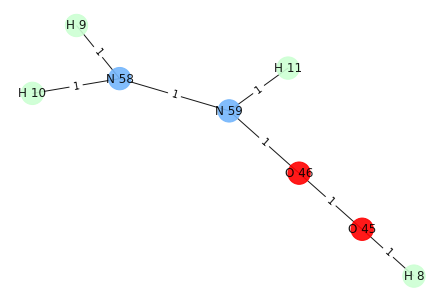

Next compound


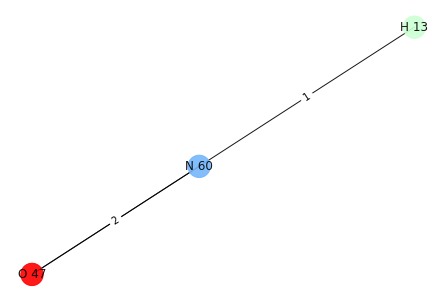

Next compound


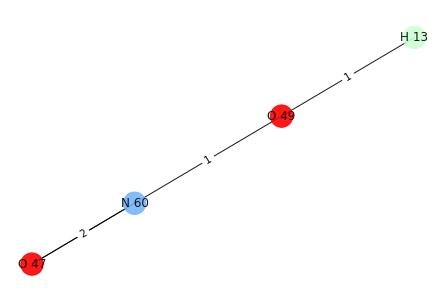

Next compound


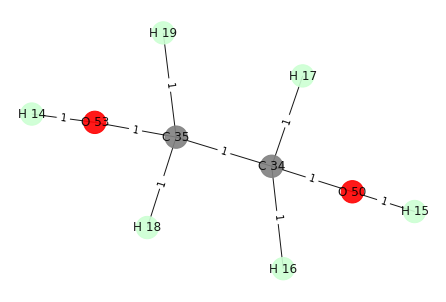

Next compound


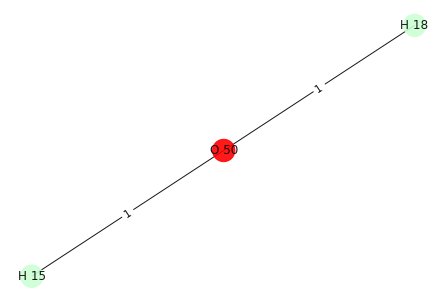

Next compound


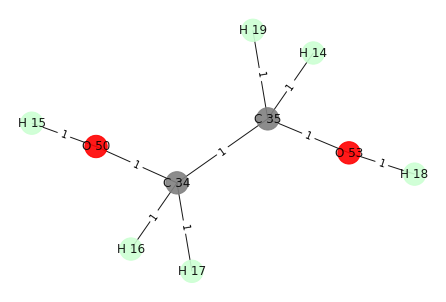

Next compound


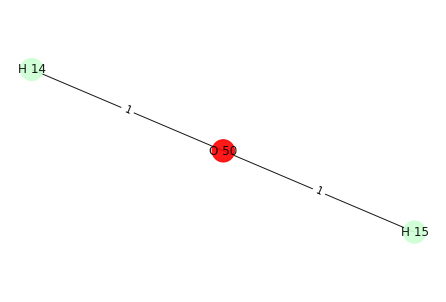

Next compound


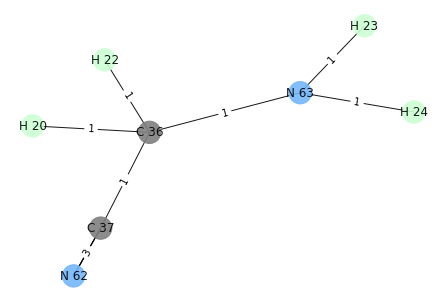

flag == True, CN
(C 37, N 62)


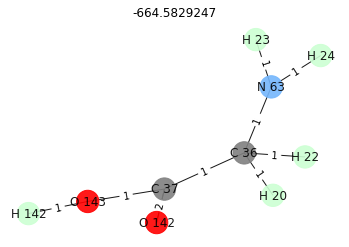

Next compound


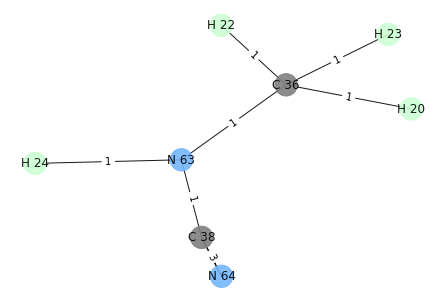

flag == True, CN
(C 38, N 64)


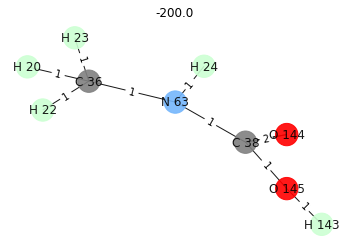

Next compound


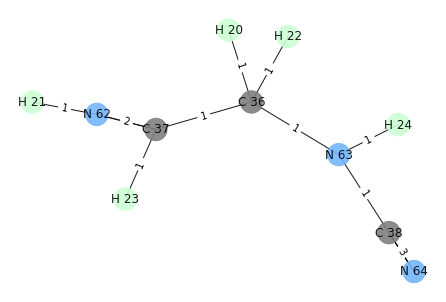

flag == True, CN
(C 38, N 64)


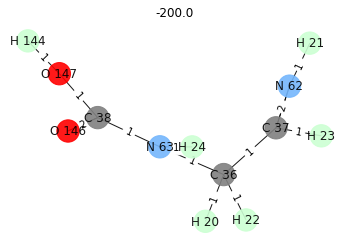

Next compound


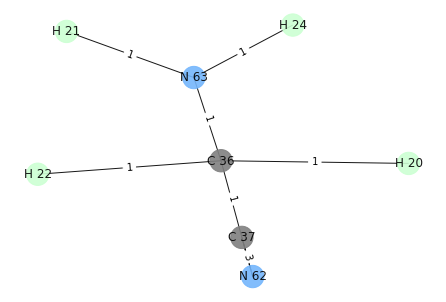

flag == True, CN
(C 37, N 62)


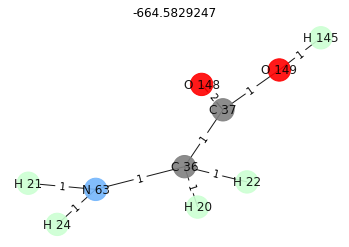

Next compound


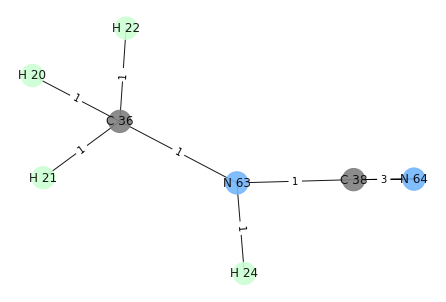

flag == True, CN
(C 38, N 64)


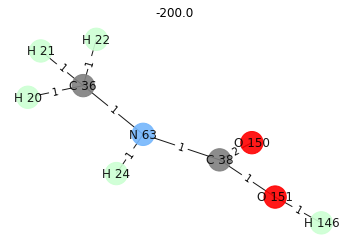

Next compound


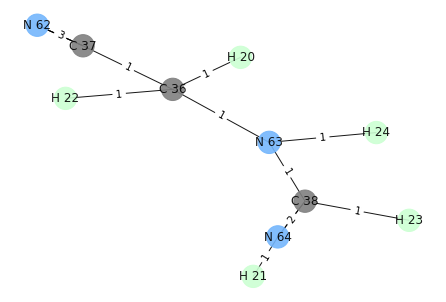

flag == True, CN
(C 37, N 62)


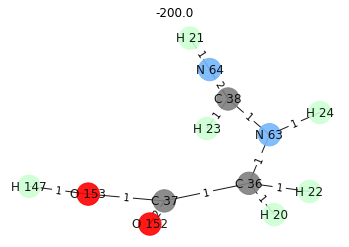

Next compound


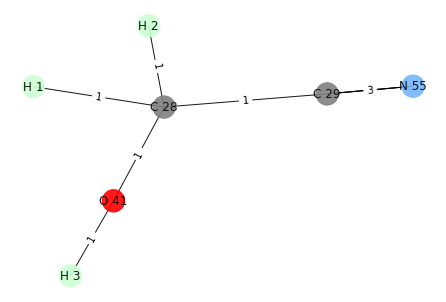

flag == True, CN
(C 29, N 55)


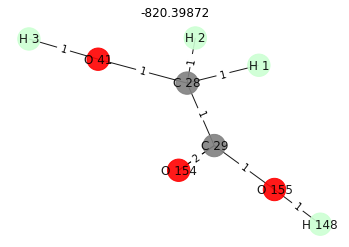

Next compound


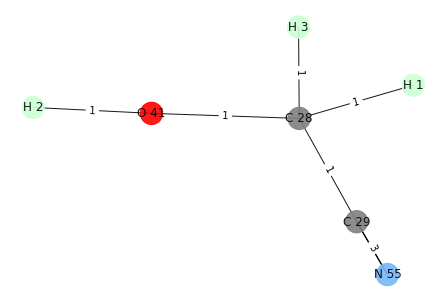

flag == True, CN
(C 29, N 55)


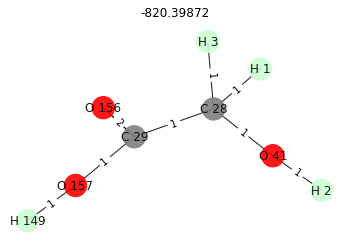

Next compound


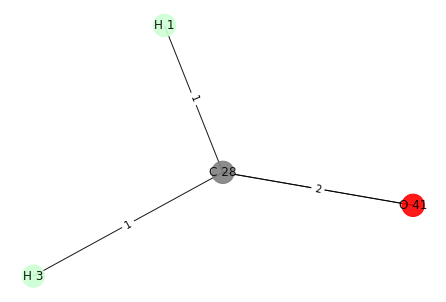

flag == True, CO


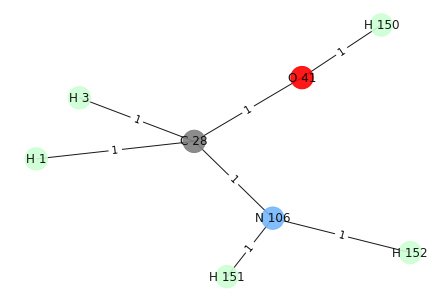

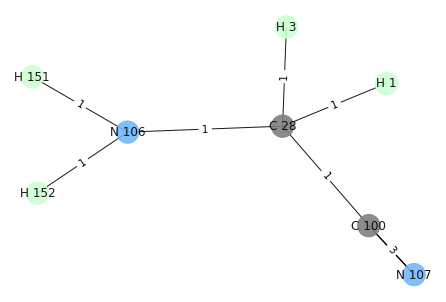

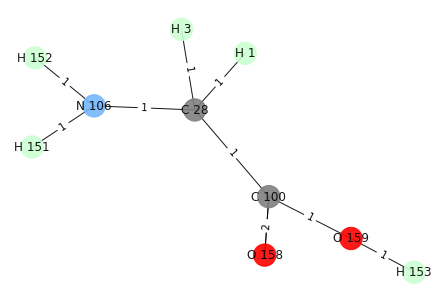

Next compound


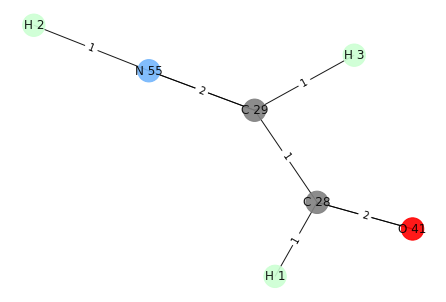

flag == True, CO


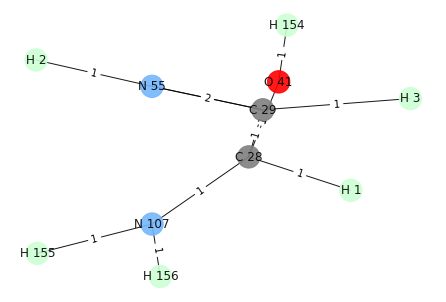

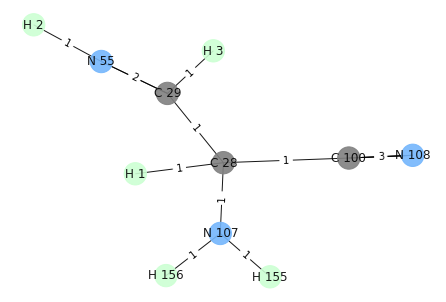

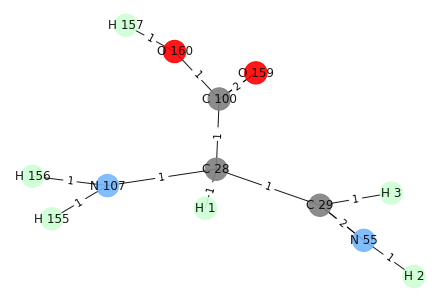

Next compound


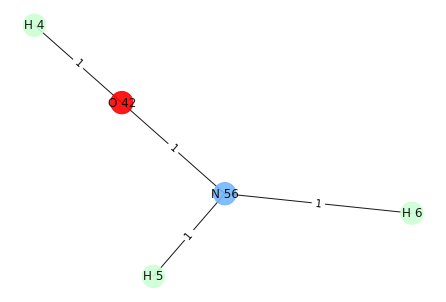

Next compound


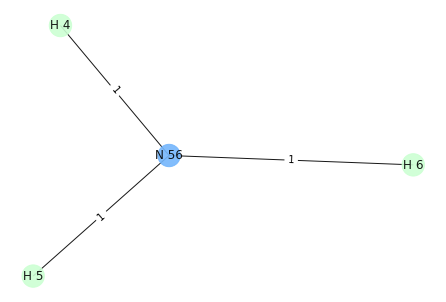

Next compound


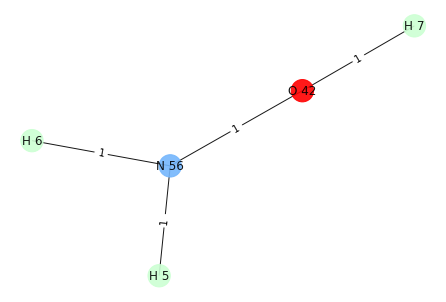

Next compound


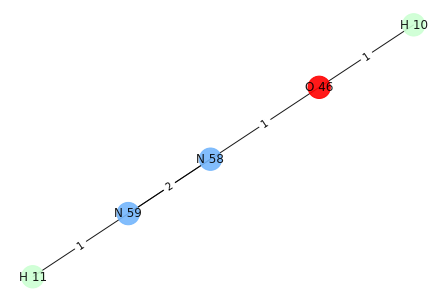

Next compound


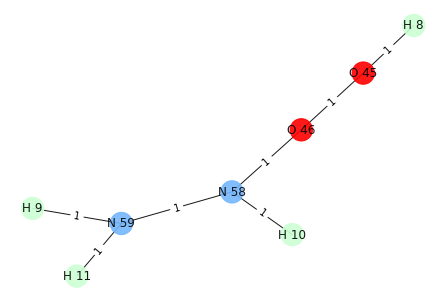

Next compound


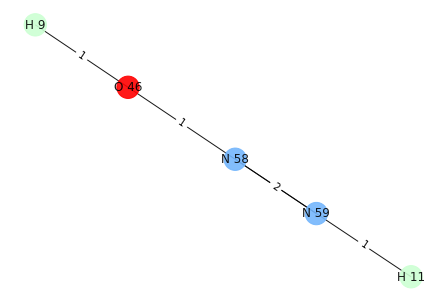

Next compound


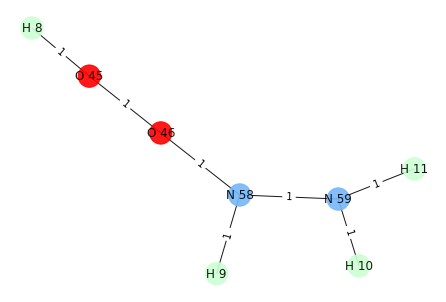

Next compound


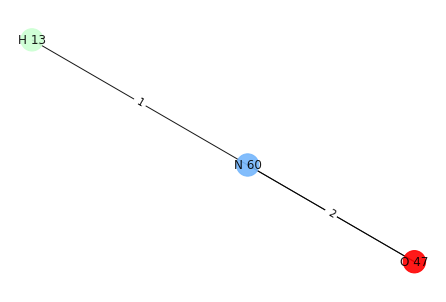

Next compound


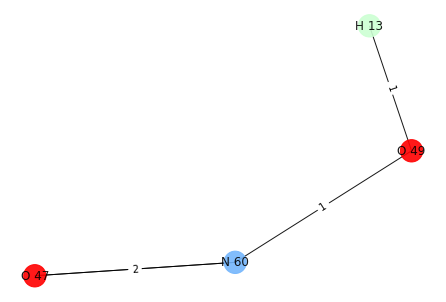

Next compound


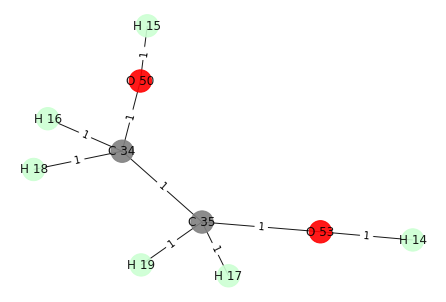

Next compound


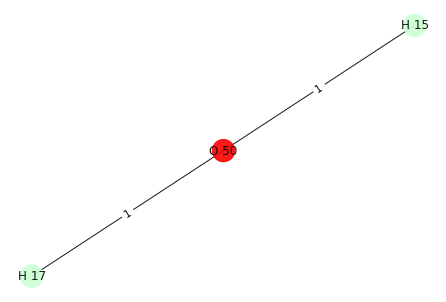

Next compound


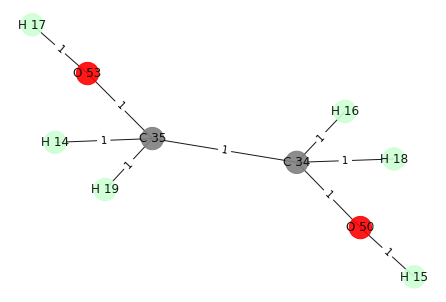

Next compound


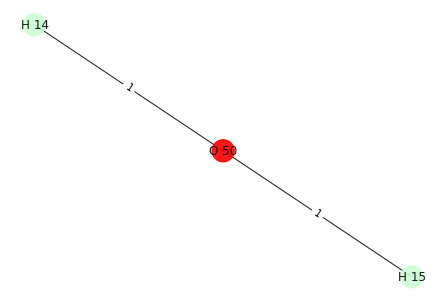

Next compound


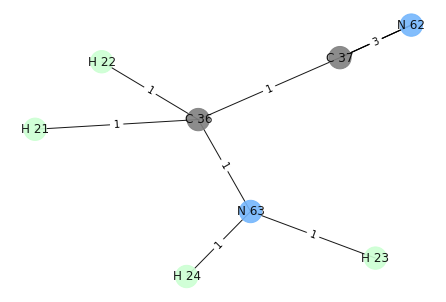

flag == True, CN
(C 37, N 62)


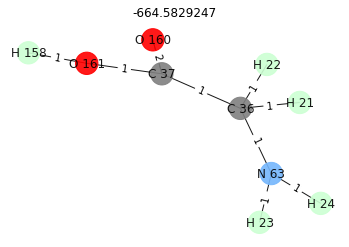

Next compound


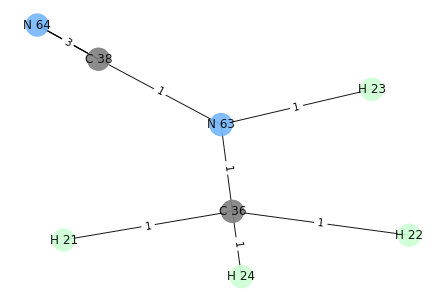

flag == True, CN
(C 38, N 64)


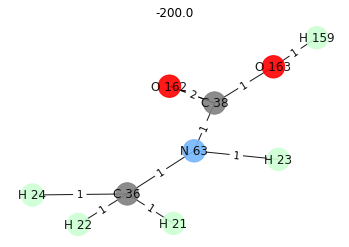

Next compound


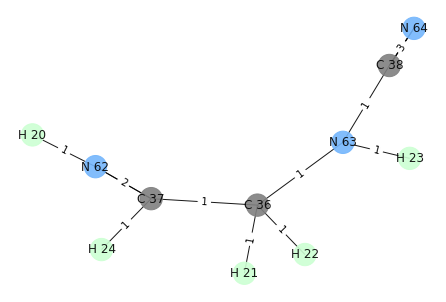

flag == True, CN
(C 38, N 64)


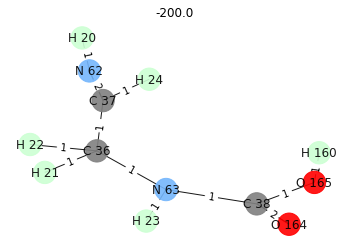

Next compound


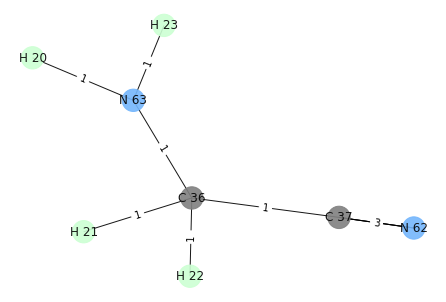

flag == True, CN
(C 37, N 62)


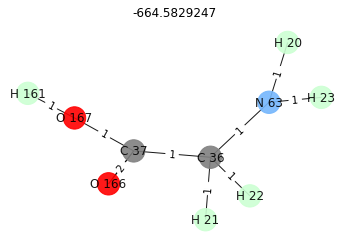

Next compound


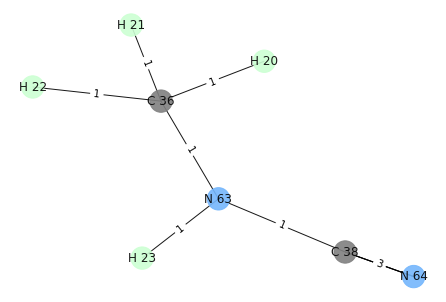

flag == True, CN
(C 38, N 64)


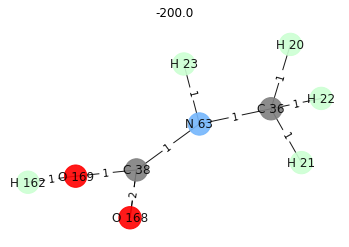

Next compound


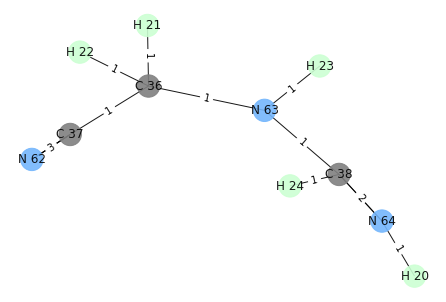

flag == True, CN
(C 37, N 62)


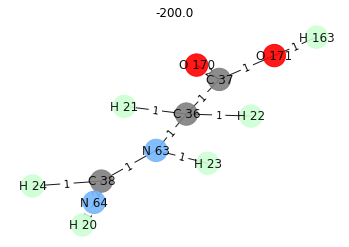

Next compound


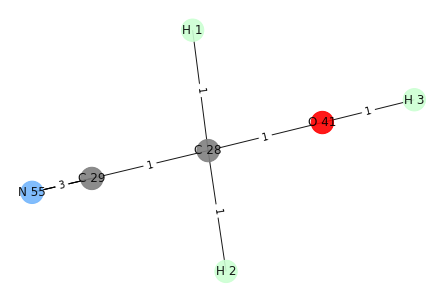

flag == True, CN
(C 29, N 55)


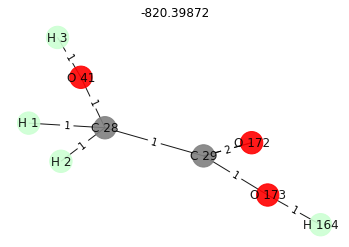

Next compound


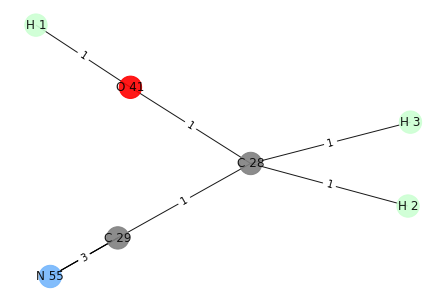

flag == True, CN
(C 29, N 55)


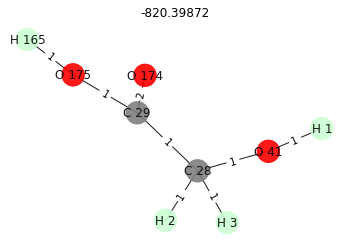

Next compound


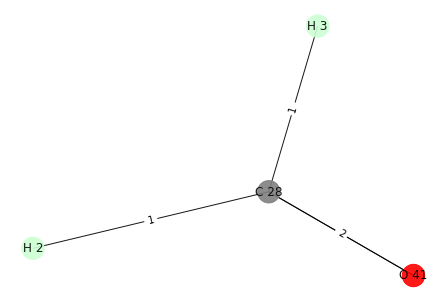

flag == True, CO


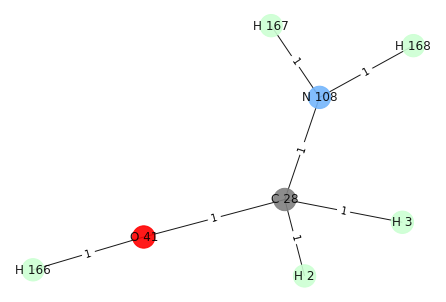

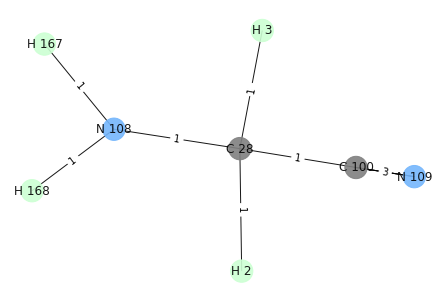

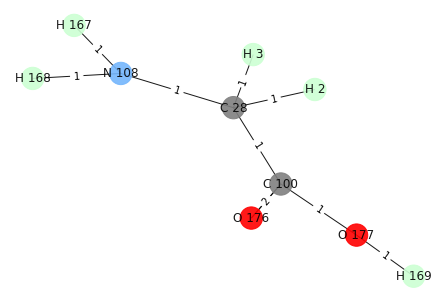

Next compound


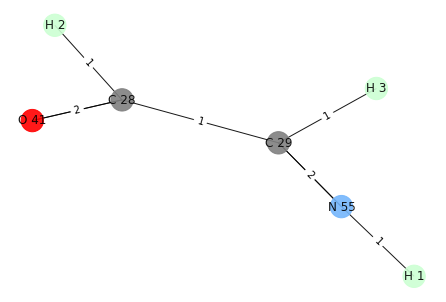

flag == True, CO


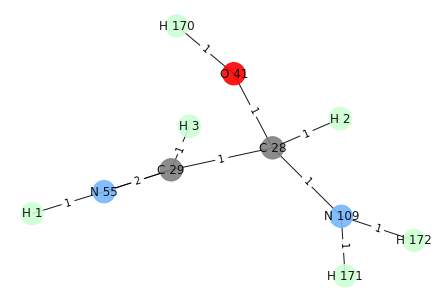

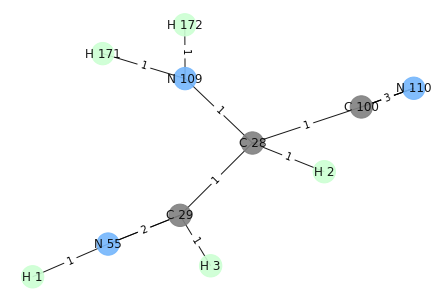

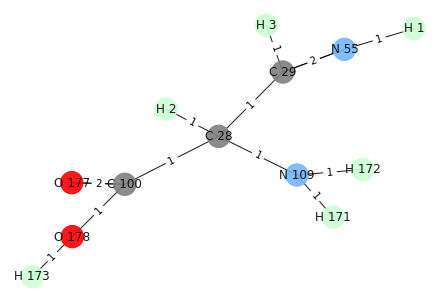

Next compound


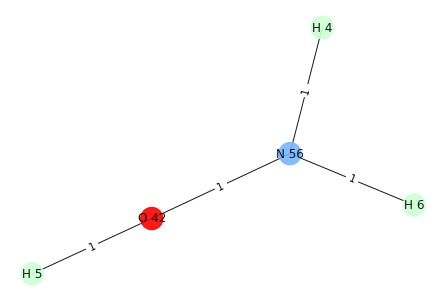

Next compound


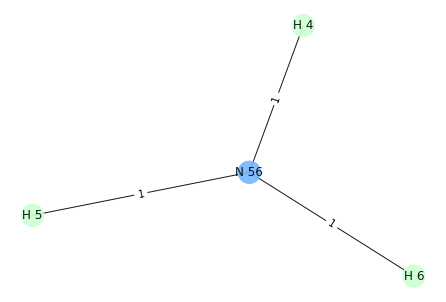

Next compound


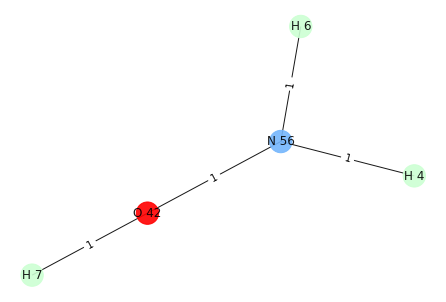

Next compound


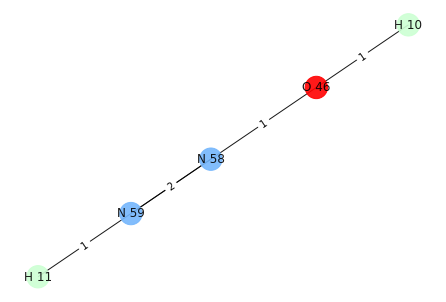

Next compound


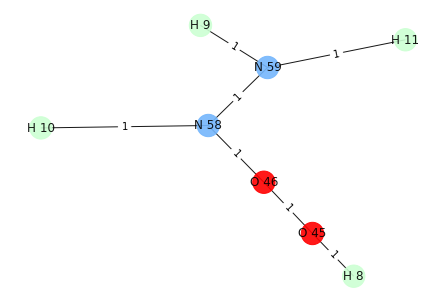

Next compound


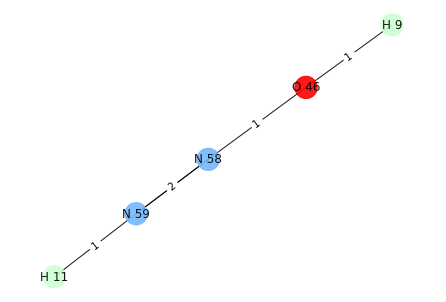

Next compound


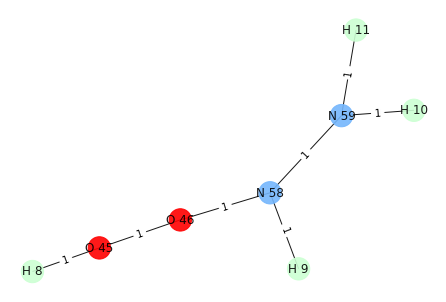

Next compound


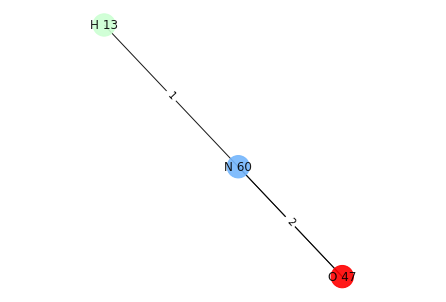

Next compound


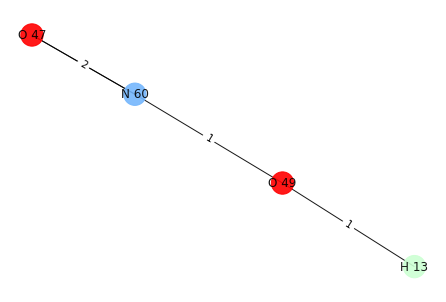

Next compound


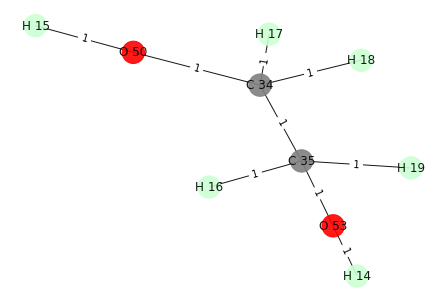

Next compound


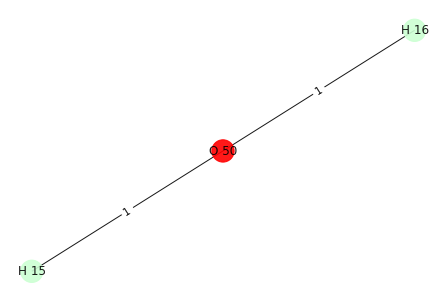

Next compound


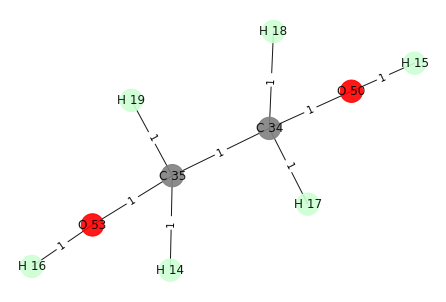

Next compound


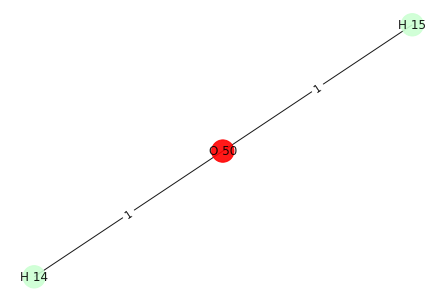

Next compound


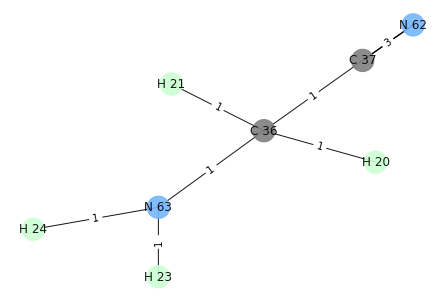

flag == True, CN
(C 37, N 62)


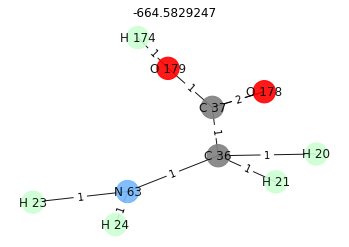

Next compound


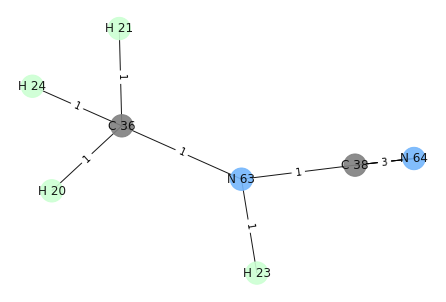

flag == True, CN
(C 38, N 64)


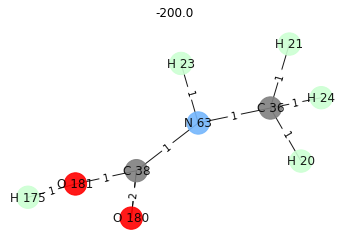

Next compound


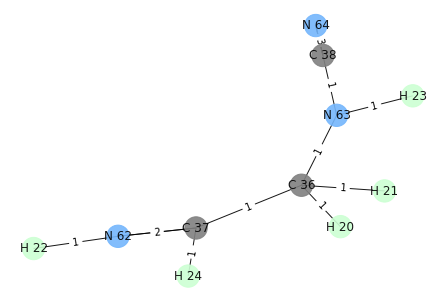

flag == True, CN
(C 38, N 64)


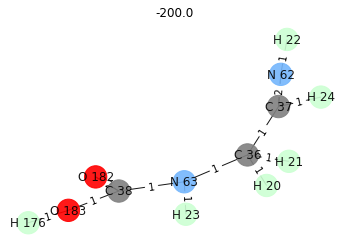

Next compound


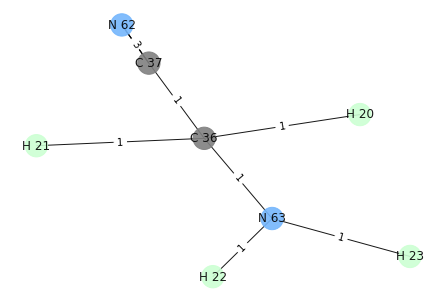

flag == True, CN
(C 37, N 62)


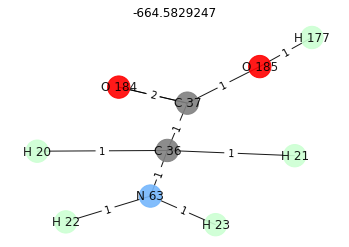

Next compound


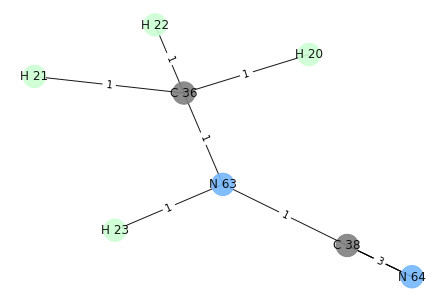

flag == True, CN
(C 38, N 64)


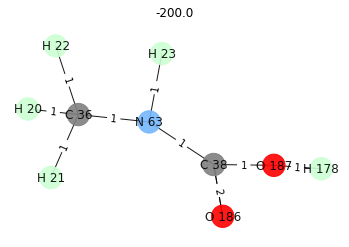

Next compound


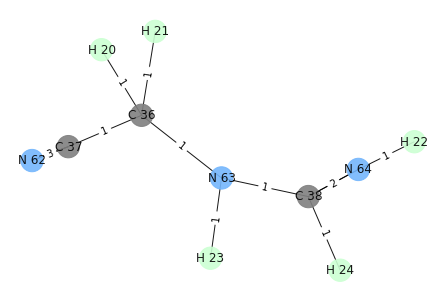

flag == True, CN
(C 37, N 62)


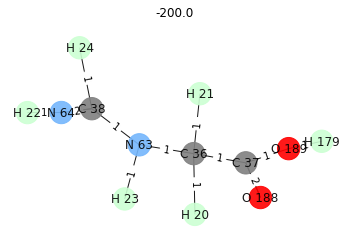

Next compound


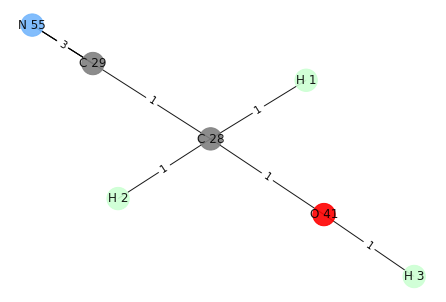

flag == True, CN
(C 29, N 55)


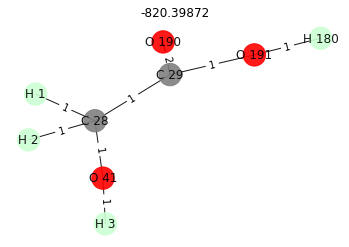

Next compound


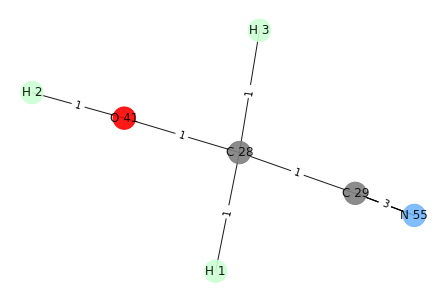

flag == True, CN
(C 29, N 55)


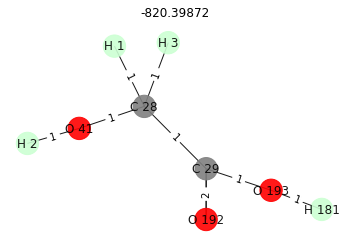

Next compound


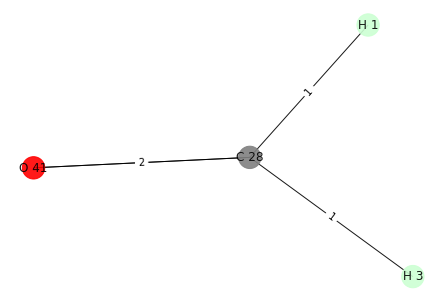

flag == True, CO


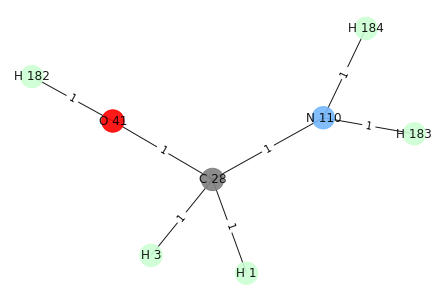

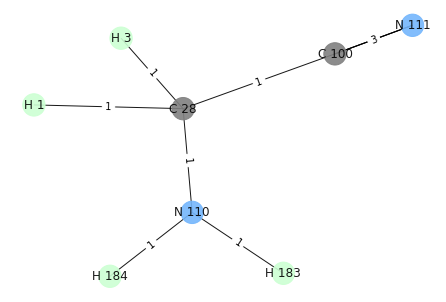

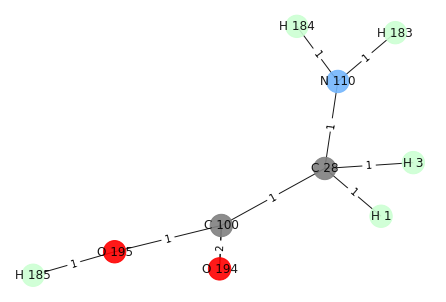

Next compound


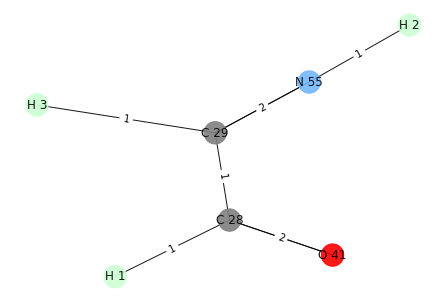

flag == True, CO


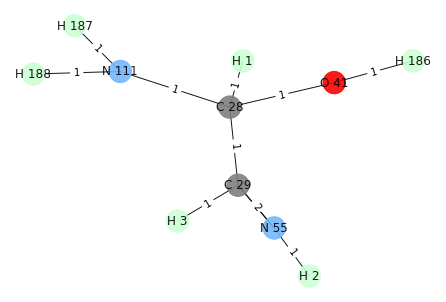

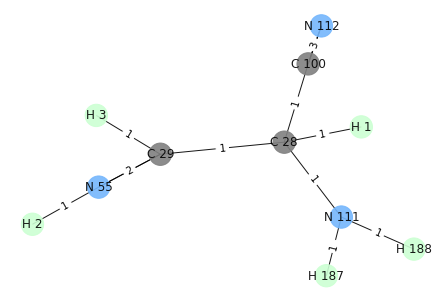

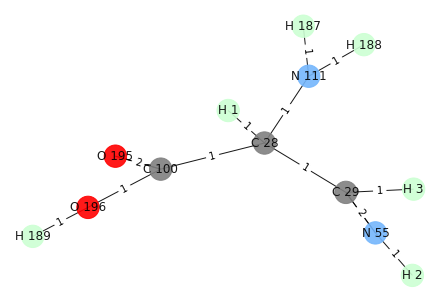

Next compound


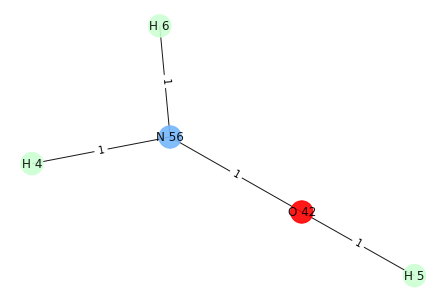

Next compound


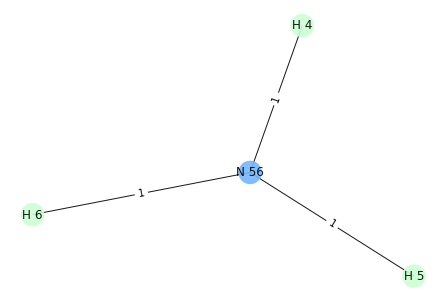

Next compound


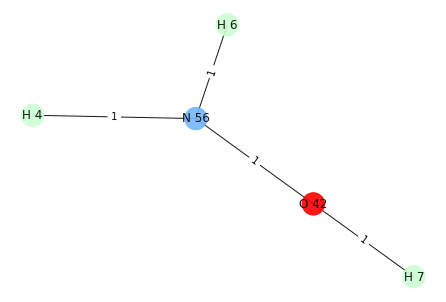

Next compound


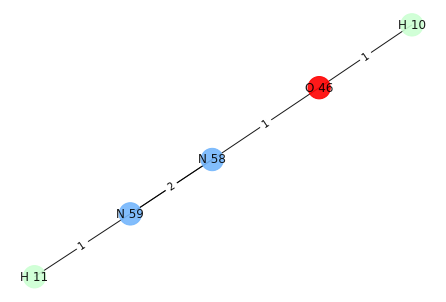

Next compound


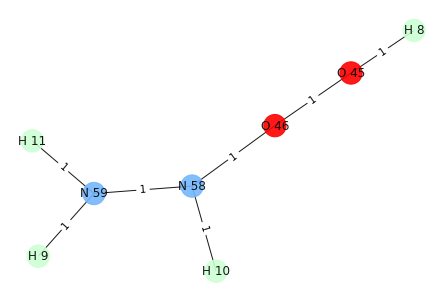

Next compound


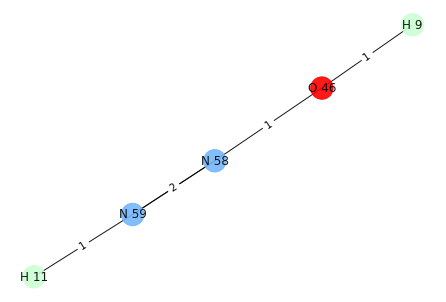

Next compound


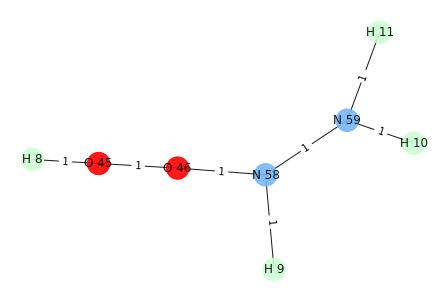

Next compound


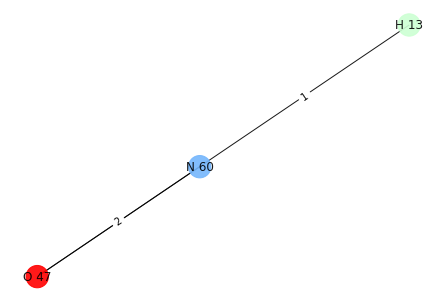

Next compound


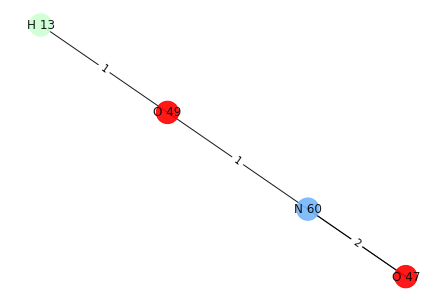

Next compound


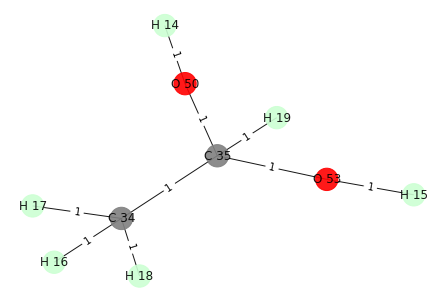

Next compound


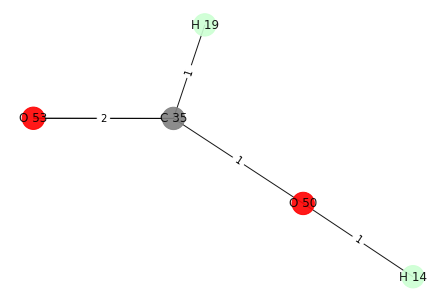

Next compound


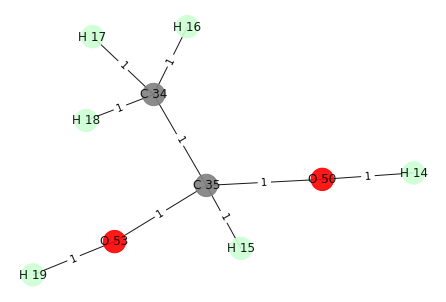

Next compound


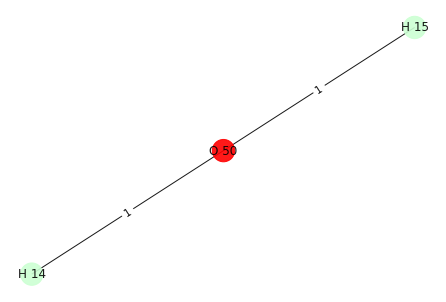

Next compound


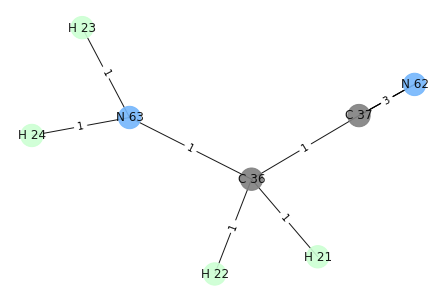

flag == True, CN
(C 37, N 62)


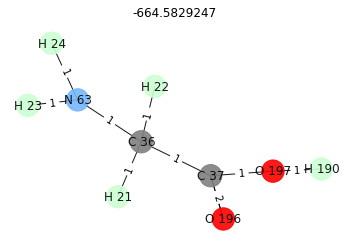

Next compound


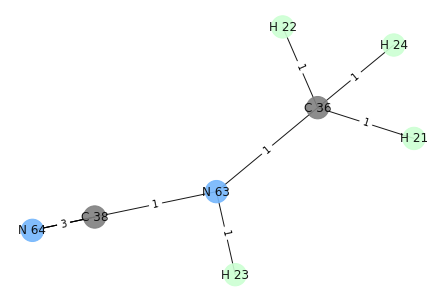

flag == True, CN
(C 38, N 64)


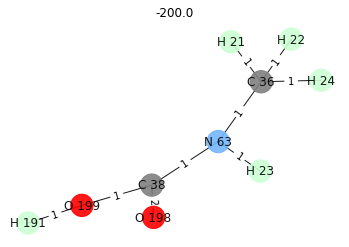

Next compound


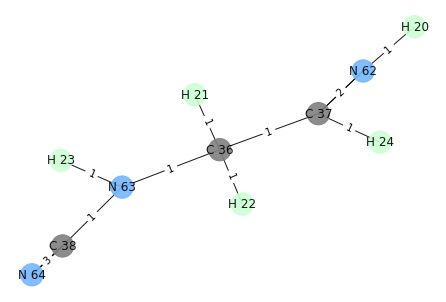

flag == True, CN
(C 38, N 64)


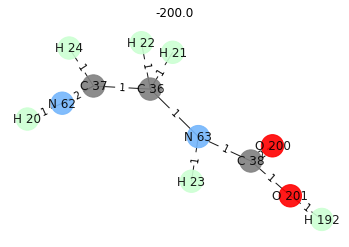

Next compound


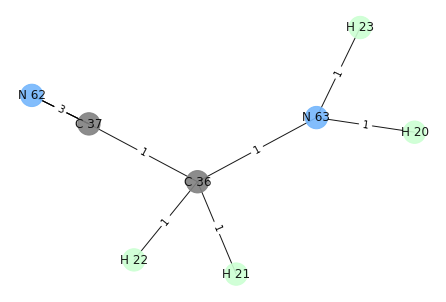

flag == True, CN
(C 37, N 62)


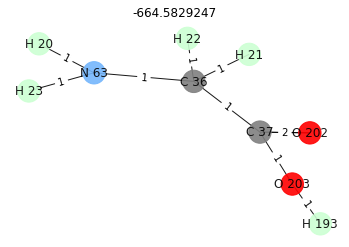

Next compound


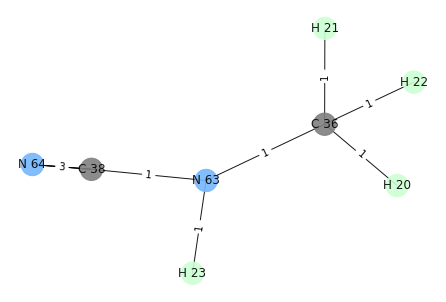

flag == True, CN
(C 38, N 64)


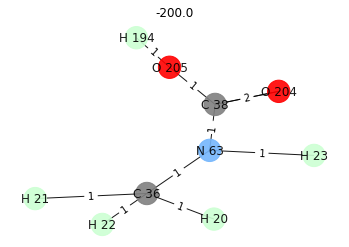

Next compound


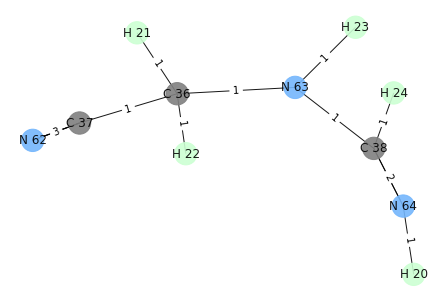

flag == True, CN
(C 37, N 62)


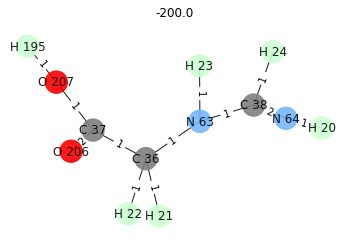

Next compound


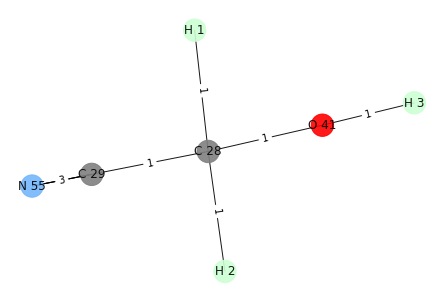

flag == True, CN
(C 29, N 55)


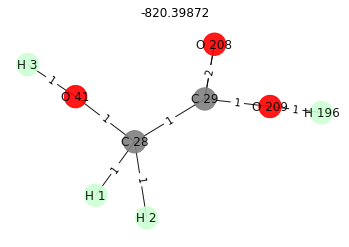

Next compound


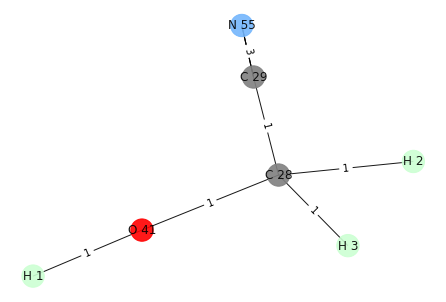

flag == True, CN
(C 29, N 55)


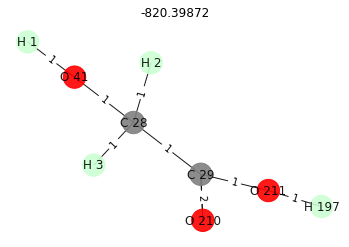

Next compound


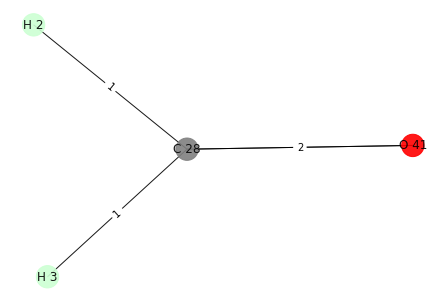

flag == True, CO


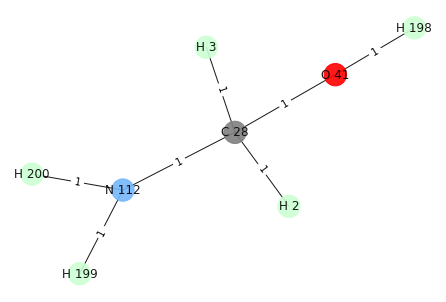

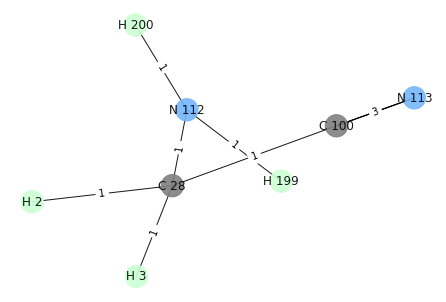

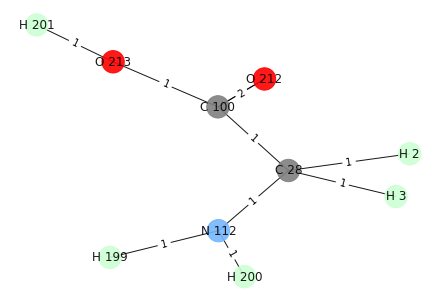

Next compound


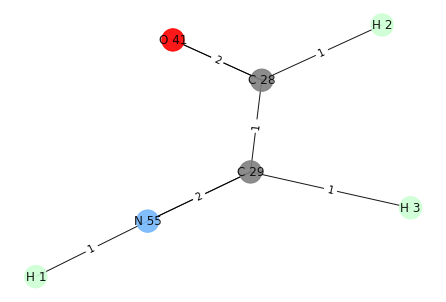

flag == True, CO


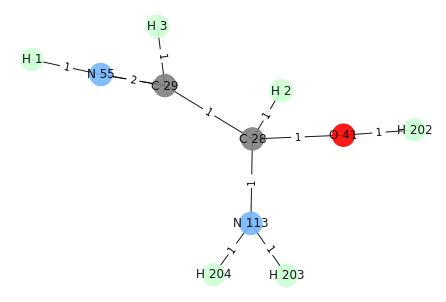

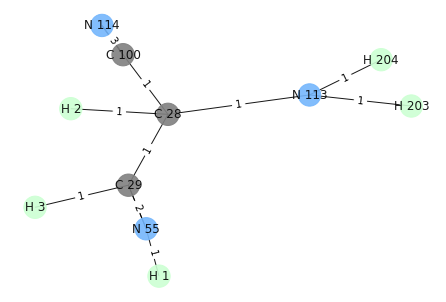

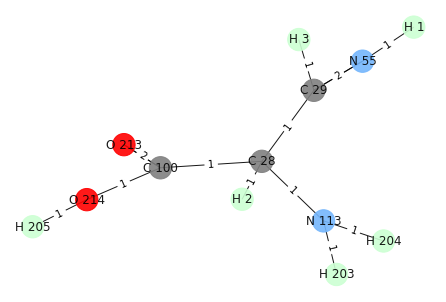

Next compound


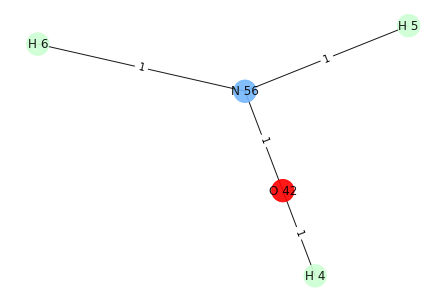

Next compound


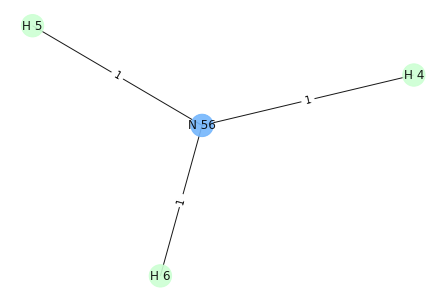

Next compound


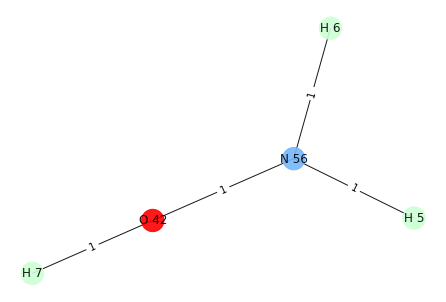

Next compound


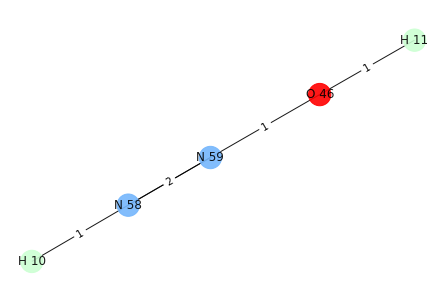

Next compound


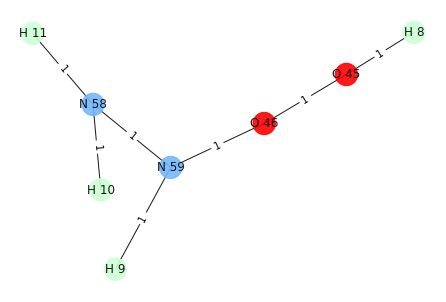

Next compound


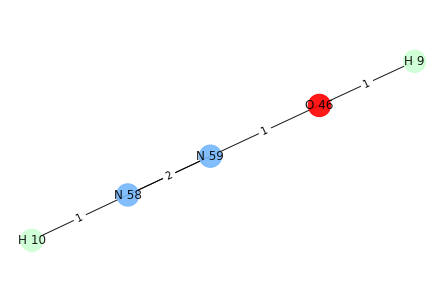

Next compound


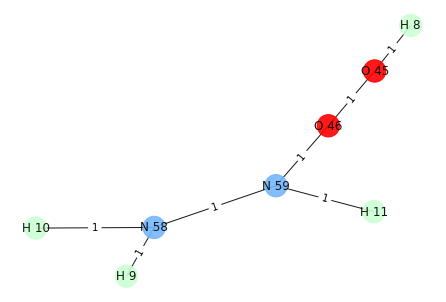

Next compound


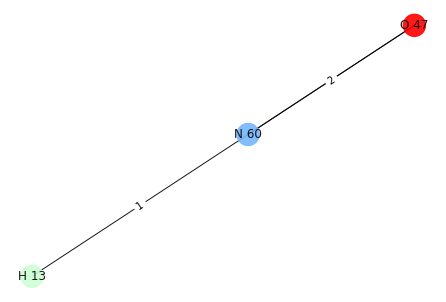

Next compound


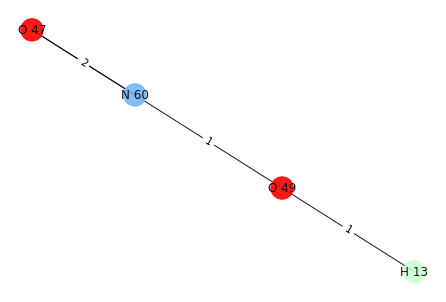

Next compound


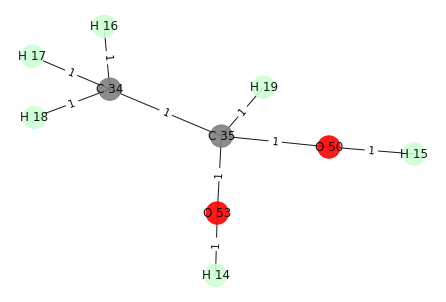

Next compound


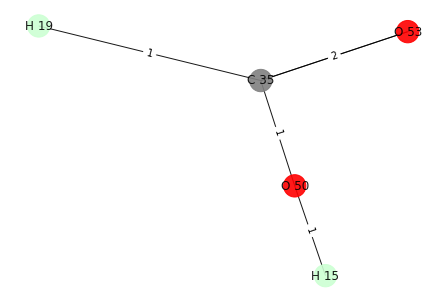

Next compound


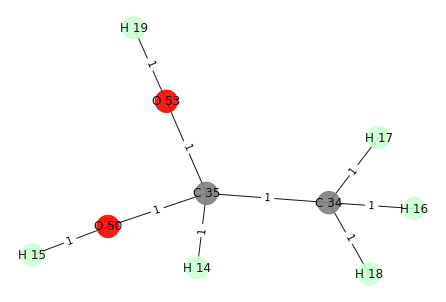

Next compound


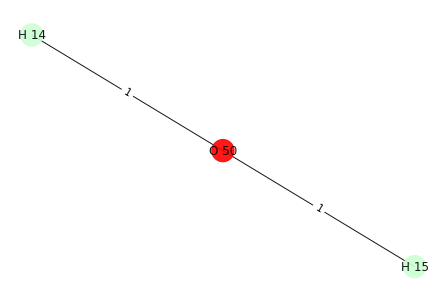

Next compound


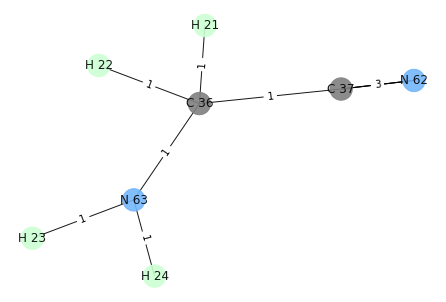

flag == True, CN
(C 37, N 62)


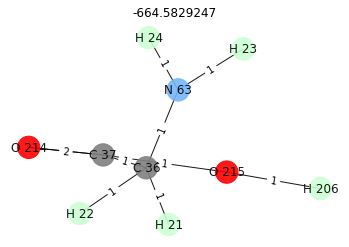

Next compound


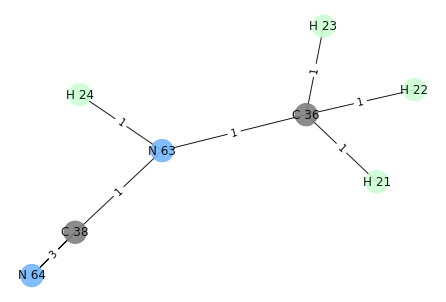

flag == True, CN
(C 38, N 64)


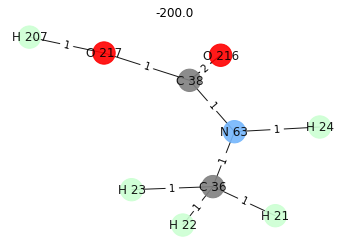

Next compound


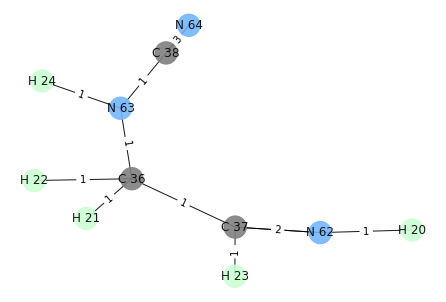

flag == True, CN
(C 38, N 64)


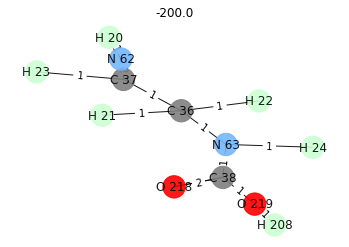

Next compound


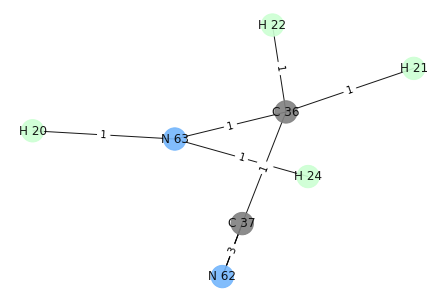

flag == True, CN
(C 37, N 62)


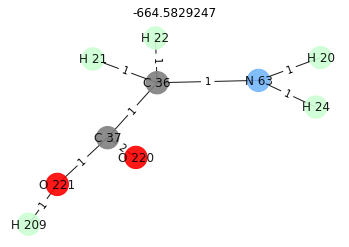

Next compound


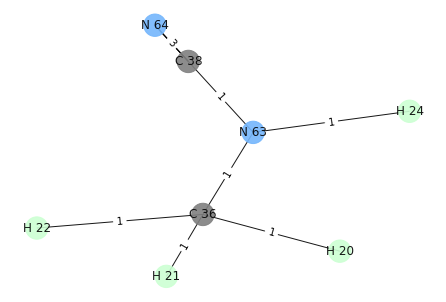

flag == True, CN
(C 38, N 64)


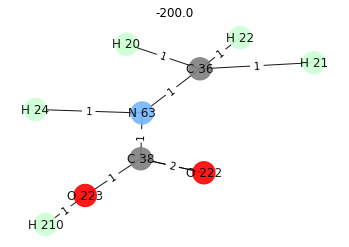

Next compound


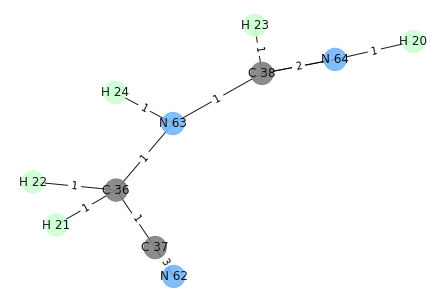

flag == True, CN
(C 37, N 62)


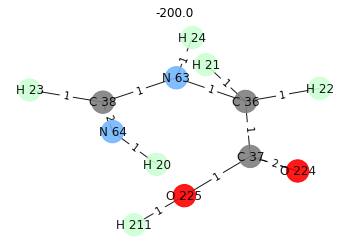

Next compound


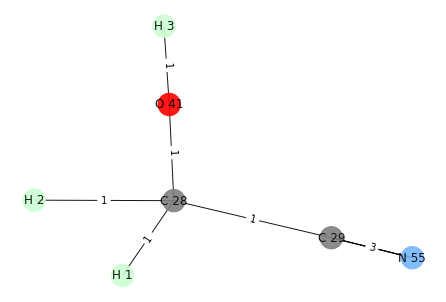

flag == True, CN
(C 29, N 55)


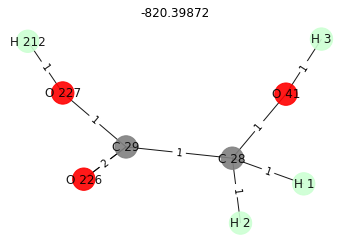

Next compound


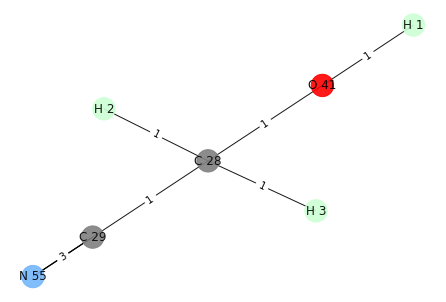

flag == True, CN
(C 29, N 55)


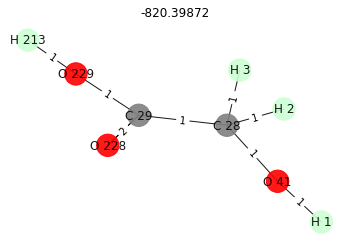

Next compound


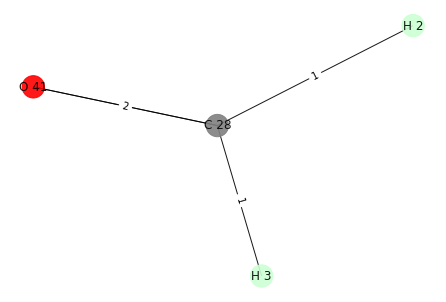

flag == True, CO


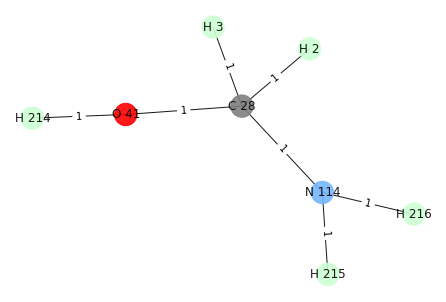

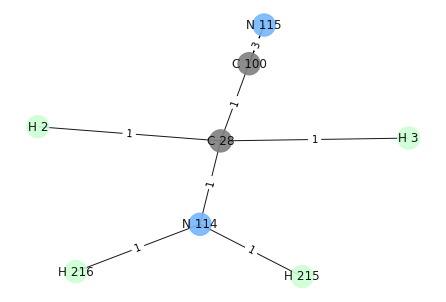

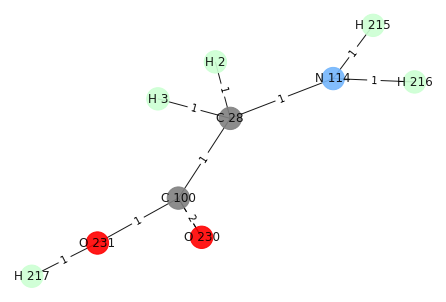

Next compound


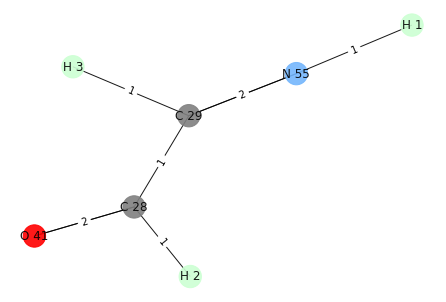

flag == True, CO


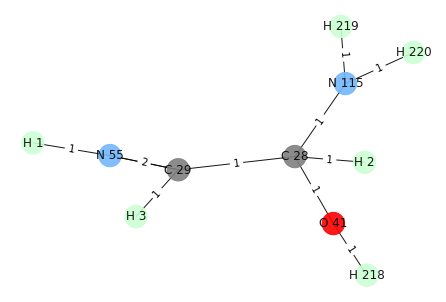

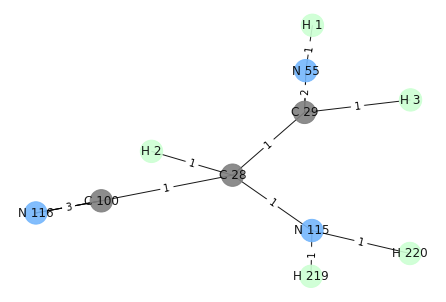

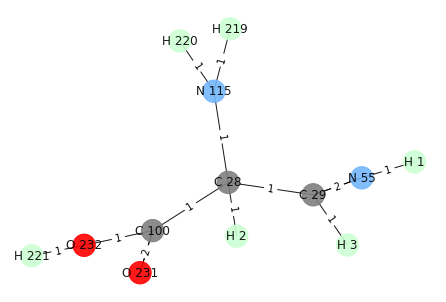

Next compound


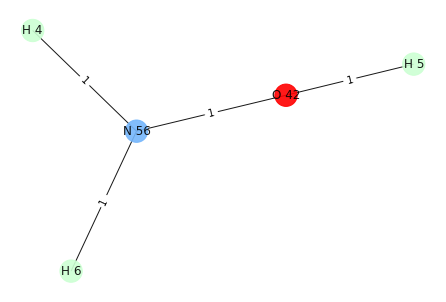

Next compound


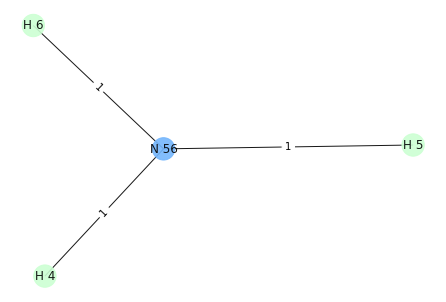

Next compound


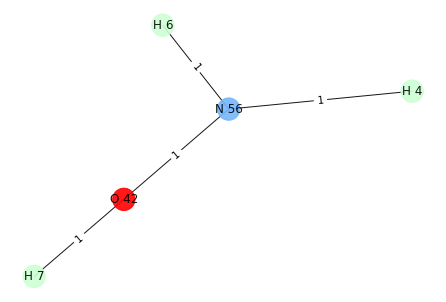

Next compound


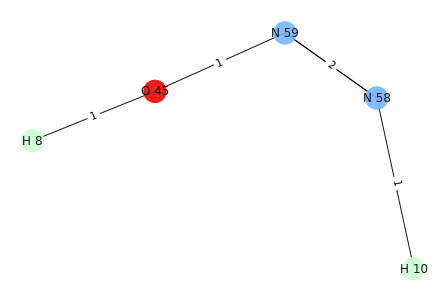

Next compound


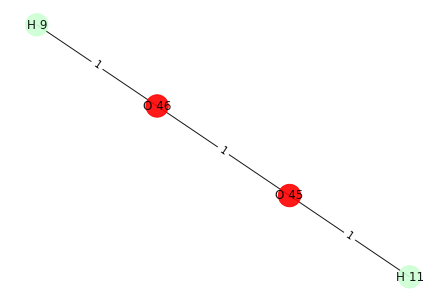

Next compound


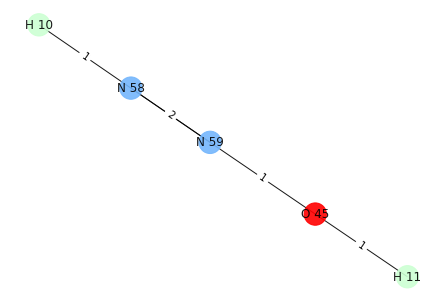

Next compound


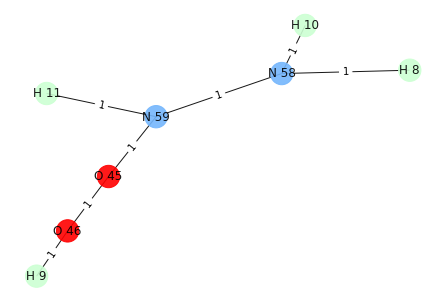

Next compound


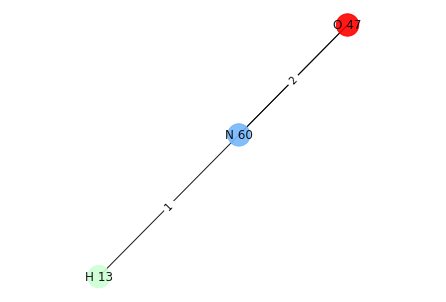

Next compound


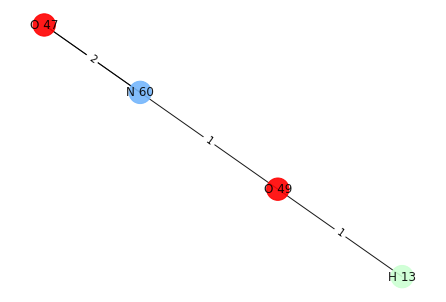

Next compound


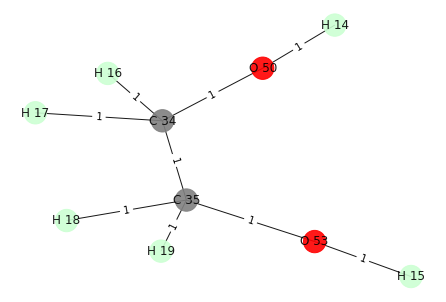

Next compound


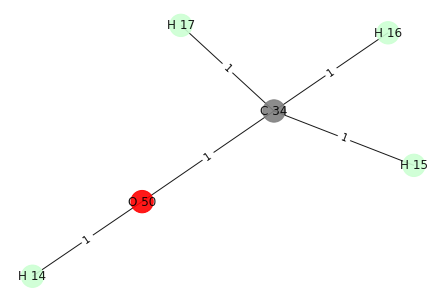

Next compound


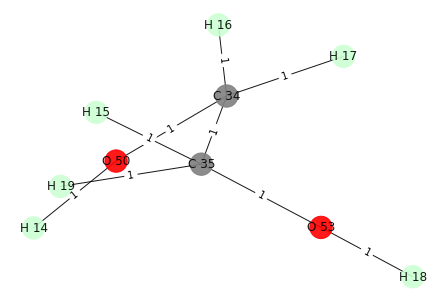

Next compound


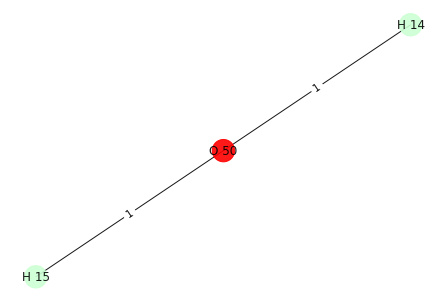

Next compound


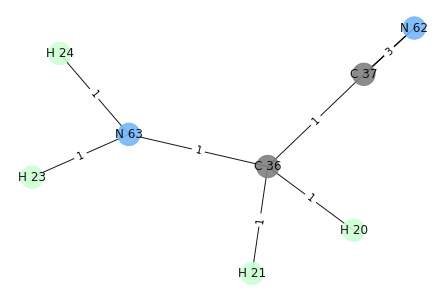

flag == True, CN
(C 37, N 62)


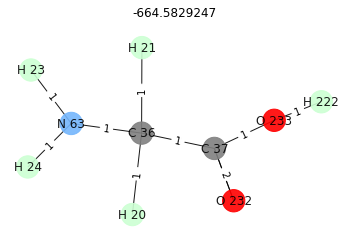

Next compound


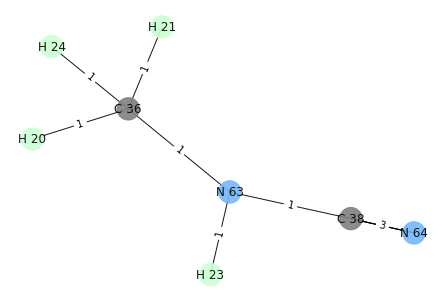

flag == True, CN
(C 38, N 64)


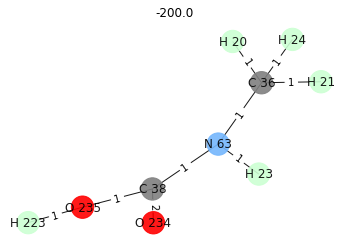

Next compound


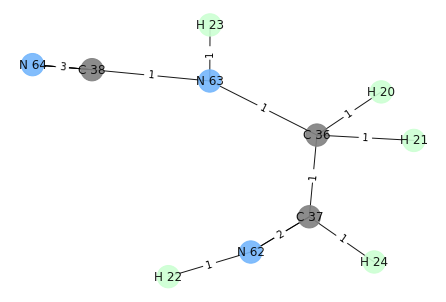

flag == True, CN
(C 38, N 64)


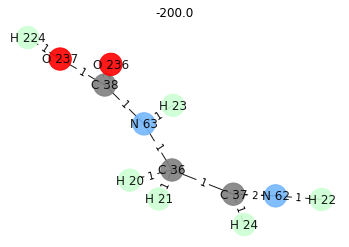

Next compound


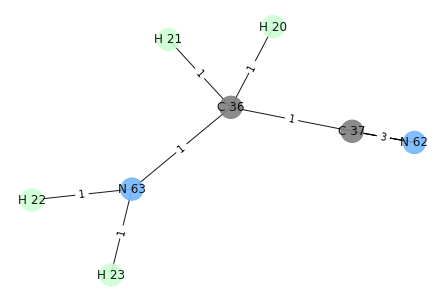

flag == True, CN
(C 37, N 62)


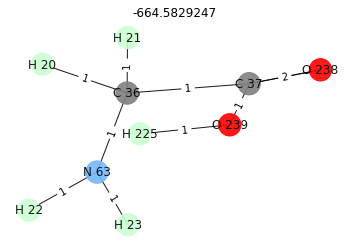

Next compound


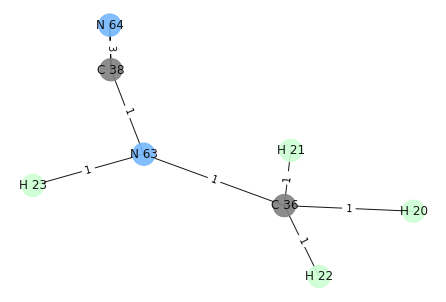

flag == True, CN
(C 38, N 64)


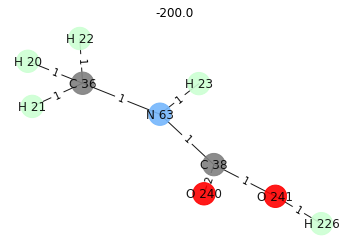

Next compound


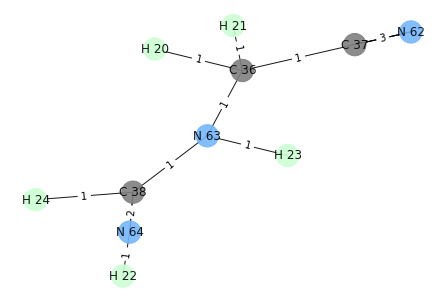

flag == True, CN
(C 37, N 62)


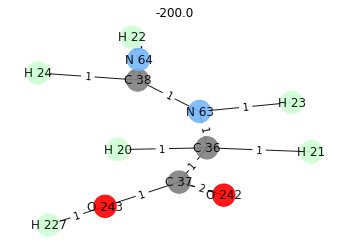

Next compound


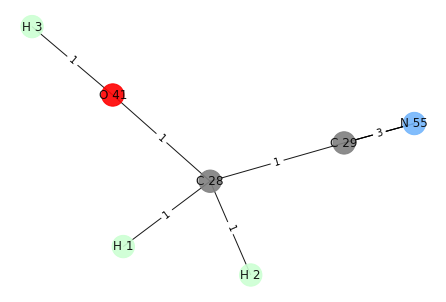

flag == True, CN
(C 29, N 55)


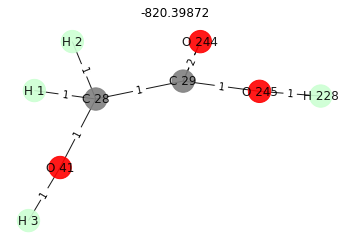

Next compound


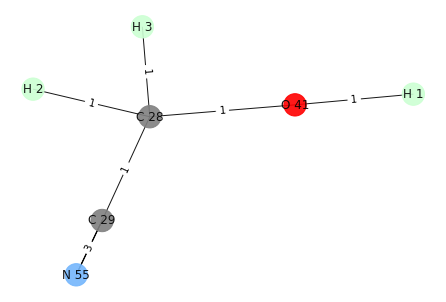

flag == True, CN
(C 29, N 55)


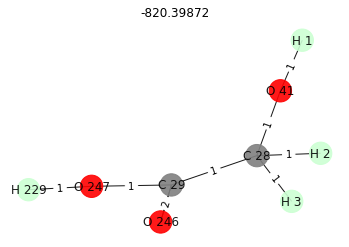

Next compound


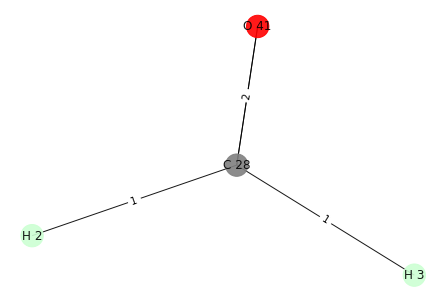

flag == True, CO


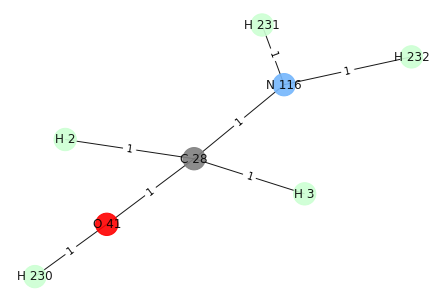

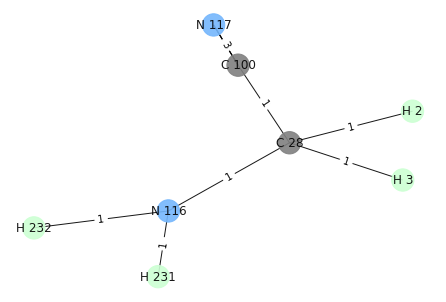

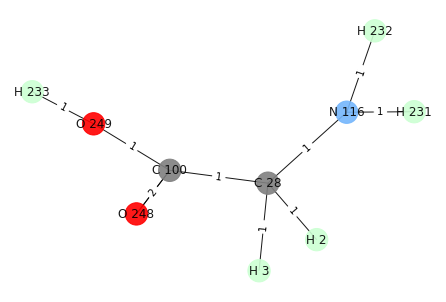

Next compound


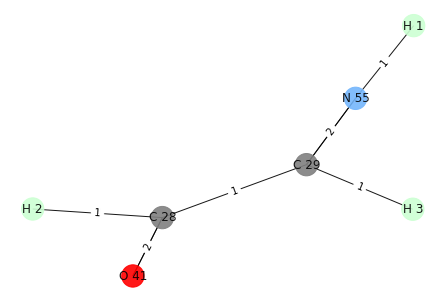

flag == True, CO


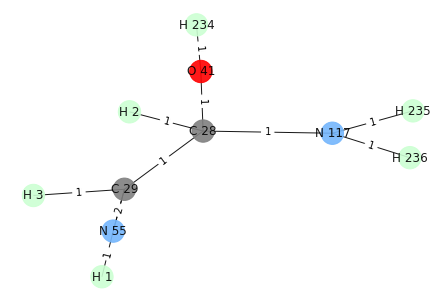

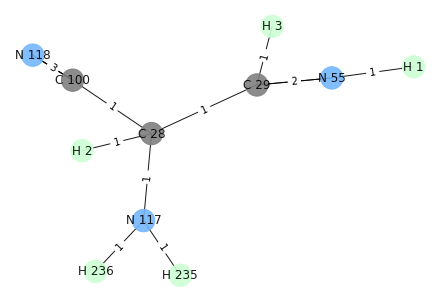

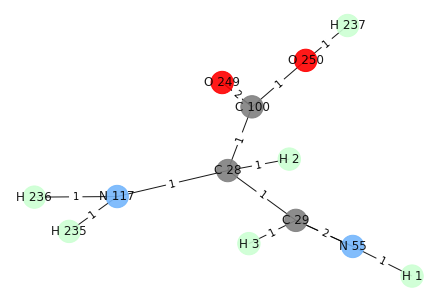

Next compound


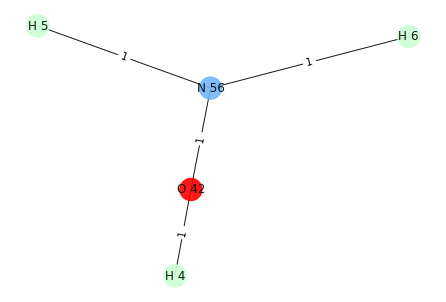

Next compound


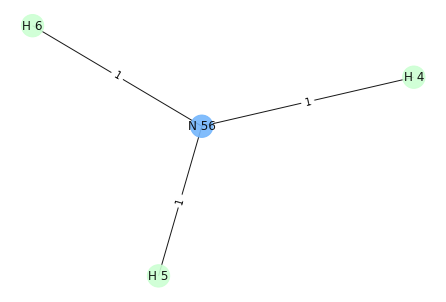

Next compound


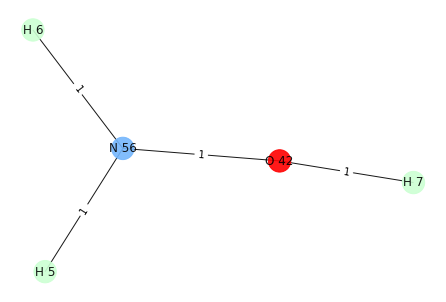

Next compound


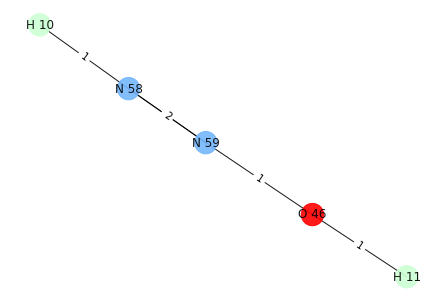

Next compound


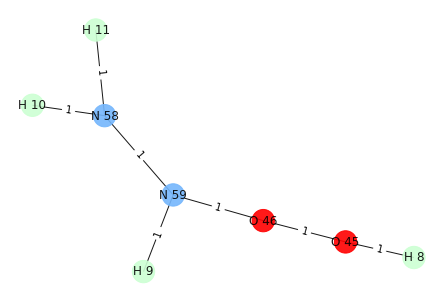

Next compound


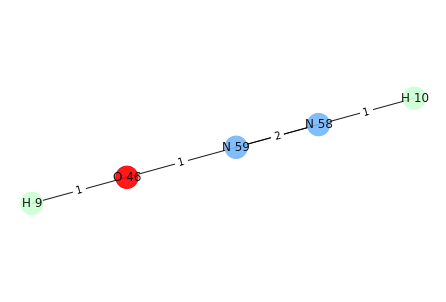

Next compound


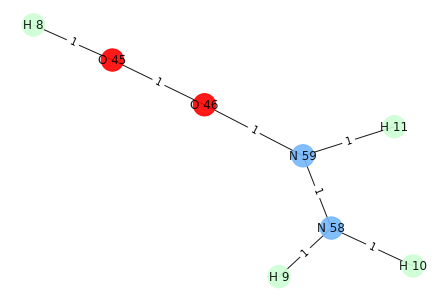

Next compound


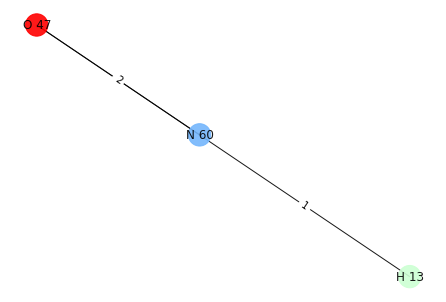

Next compound


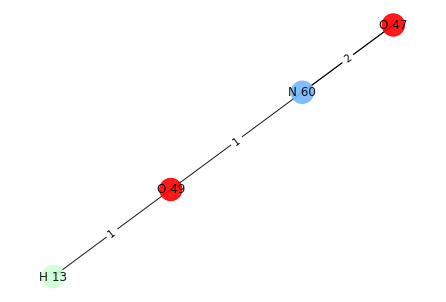

Next compound


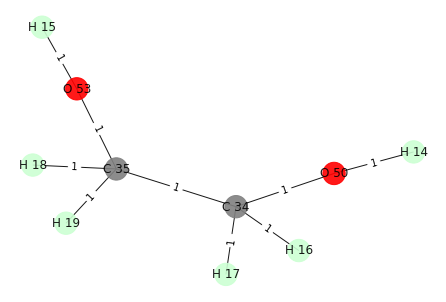

Next compound


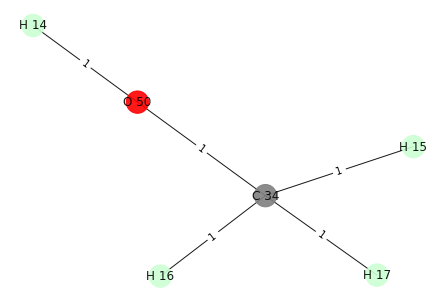

Next compound


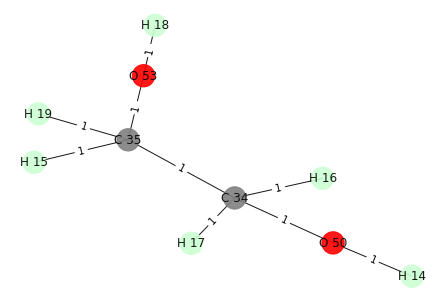

Next compound


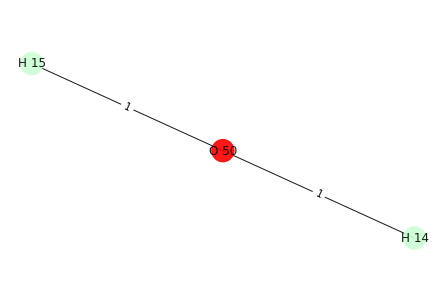

Next compound


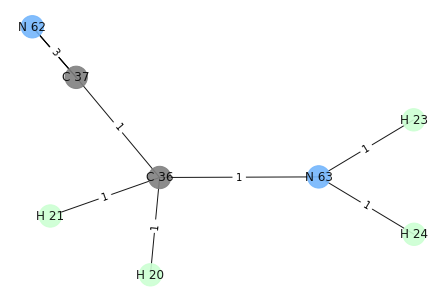

flag == True, CN
(C 37, N 62)


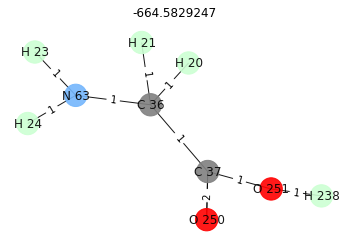

Next compound


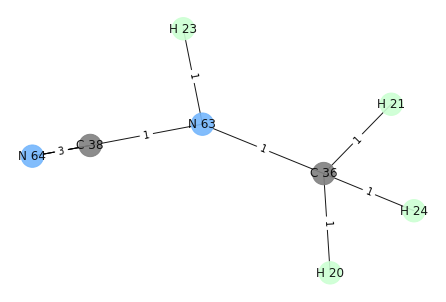

flag == True, CN
(C 38, N 64)


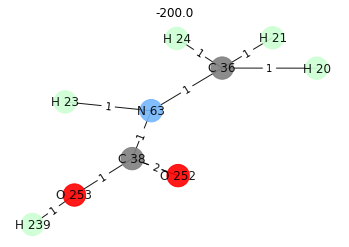

Next compound


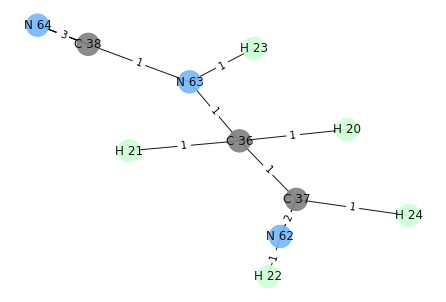

flag == True, CN
(C 38, N 64)


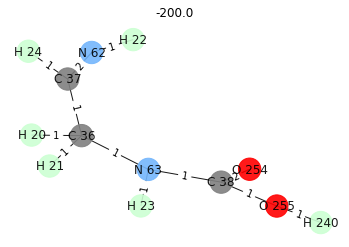

Next compound


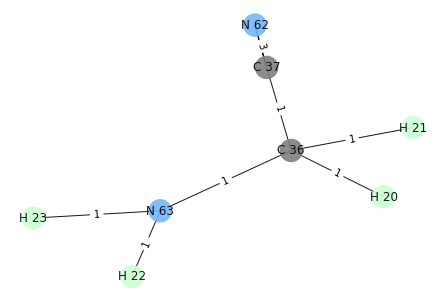

flag == True, CN
(C 37, N 62)


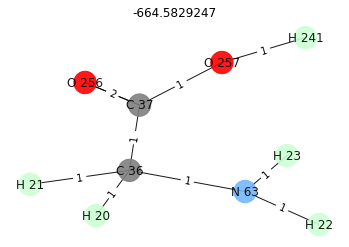

Next compound


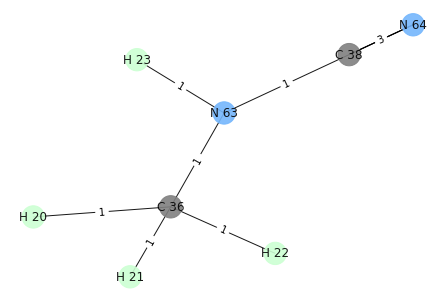

flag == True, CN
(C 38, N 64)


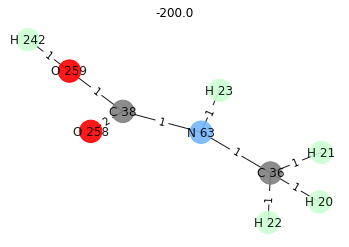

Next compound


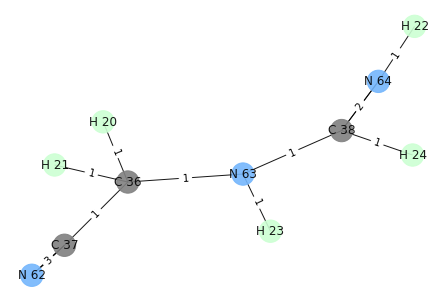

flag == True, CN
(C 37, N 62)


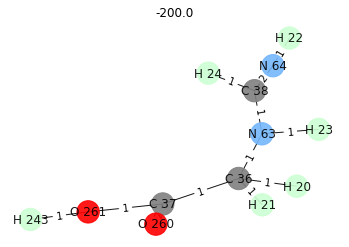

Next compound


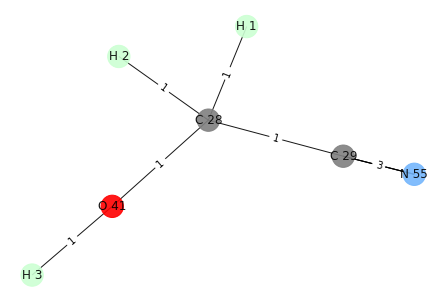

flag == True, CN
(C 29, N 55)


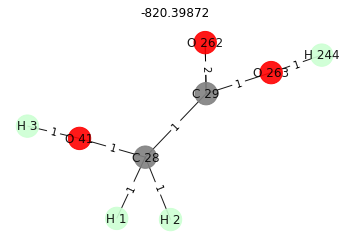

Next compound


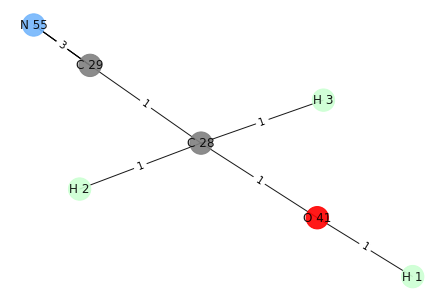

flag == True, CN
(C 29, N 55)


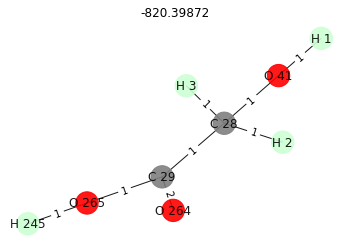

Next compound


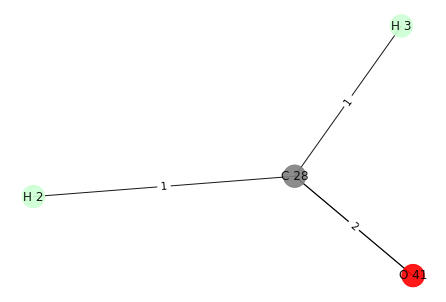

flag == True, CO


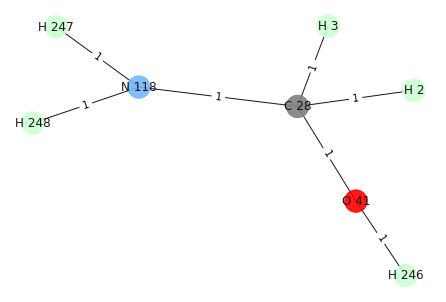

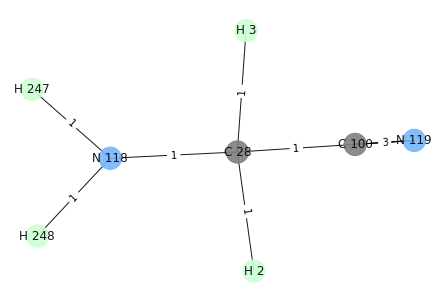

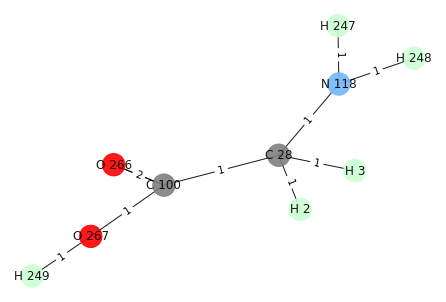

Next compound


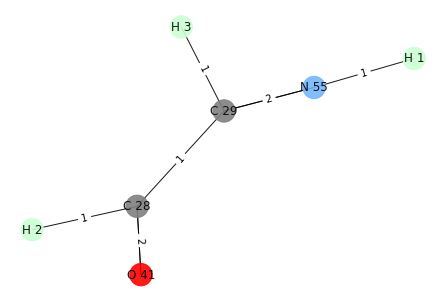

flag == True, CO


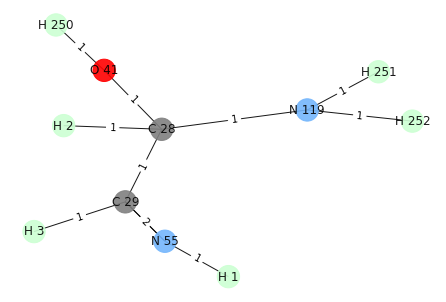

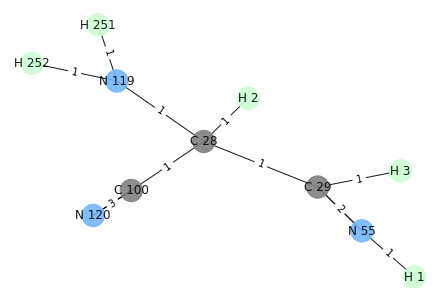

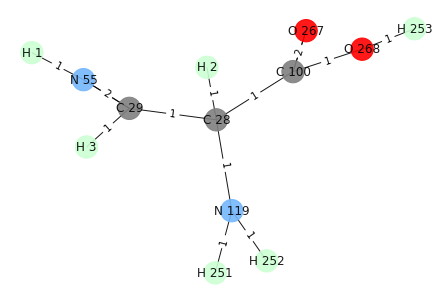

Next compound


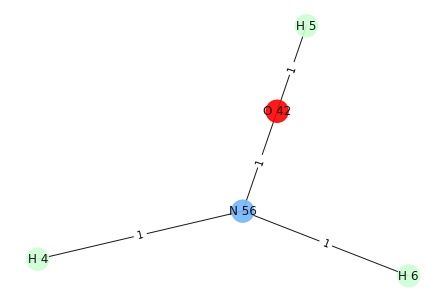

Next compound


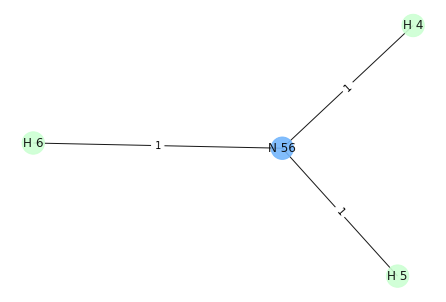

Next compound


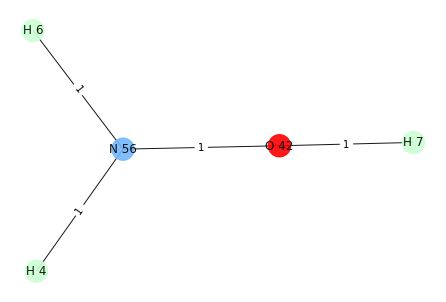

Next compound


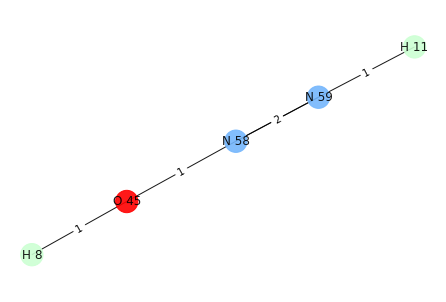

Next compound


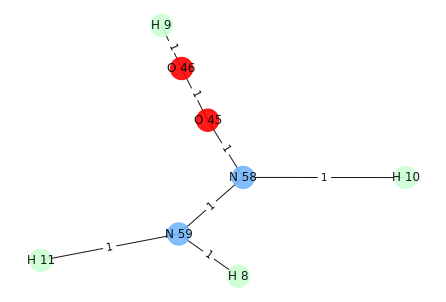

Next compound


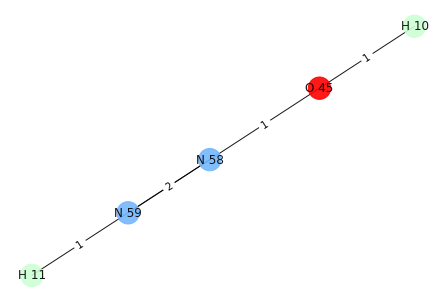

Next compound


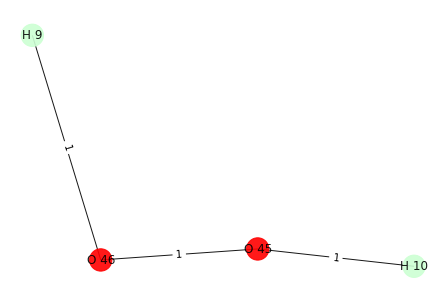

Next compound


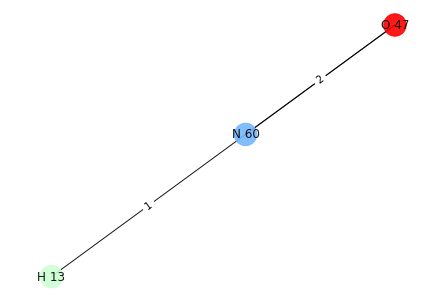

Next compound


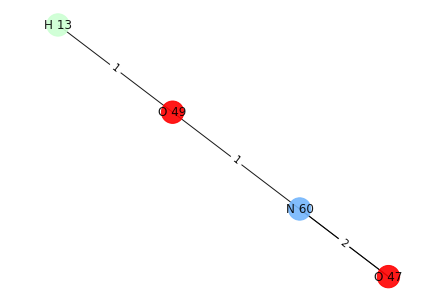

Next compound


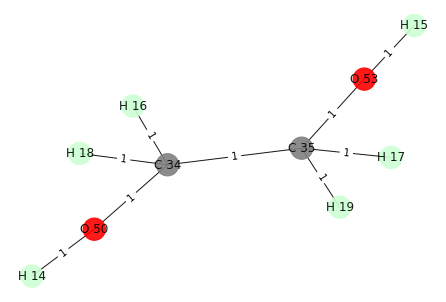

Next compound


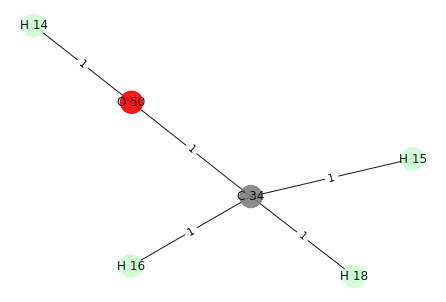

Next compound


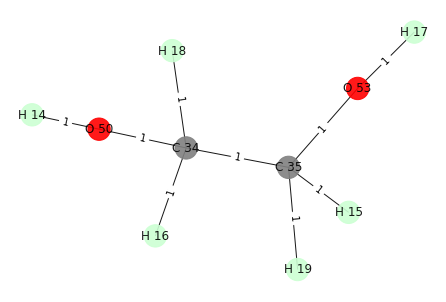

Next compound


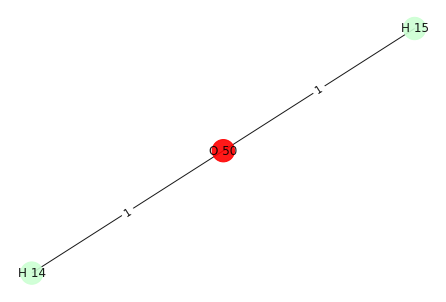

Next compound


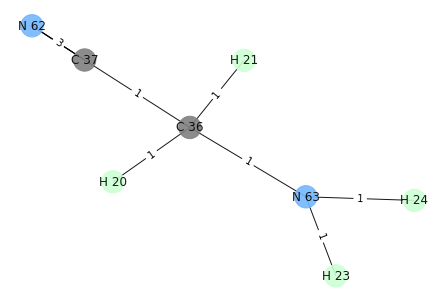

flag == True, CN
(C 37, N 62)


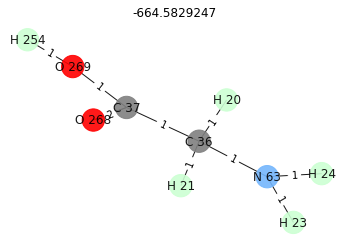

Next compound


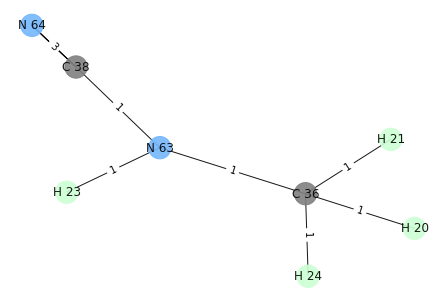

flag == True, CN
(C 38, N 64)


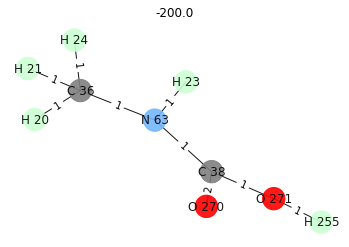

Next compound


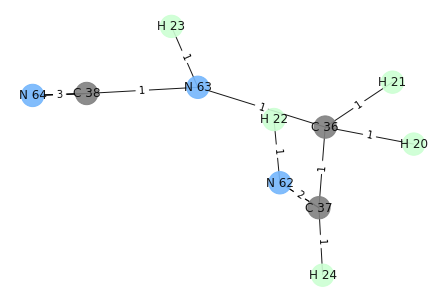

flag == True, CN
(C 38, N 64)


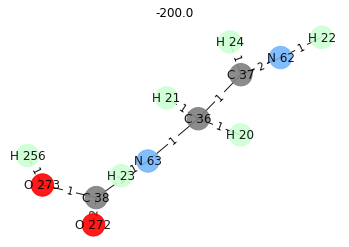

Next compound


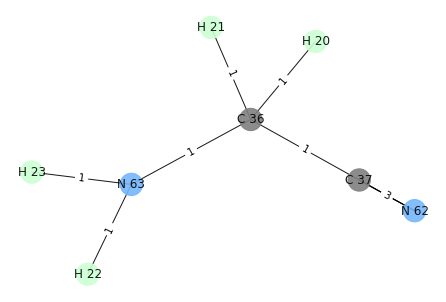

flag == True, CN
(C 37, N 62)


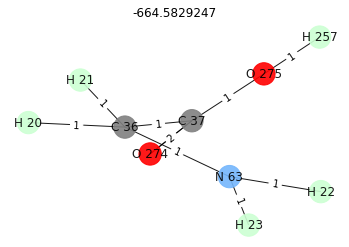

Next compound


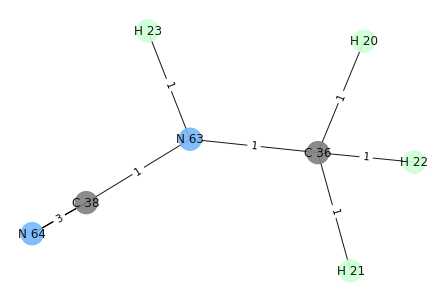

flag == True, CN
(C 38, N 64)


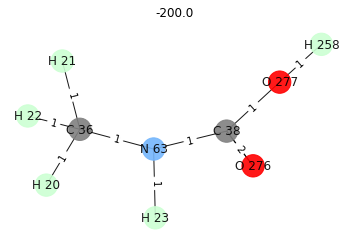

Next compound


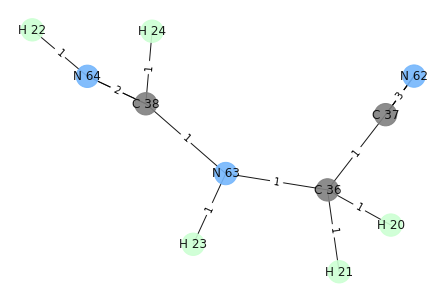

flag == True, CN
(C 37, N 62)


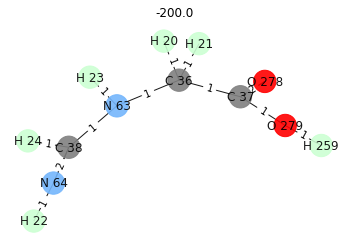

Next compound


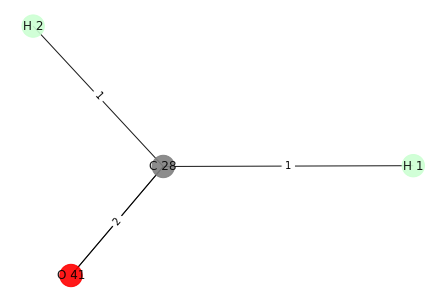

flag == True, CO


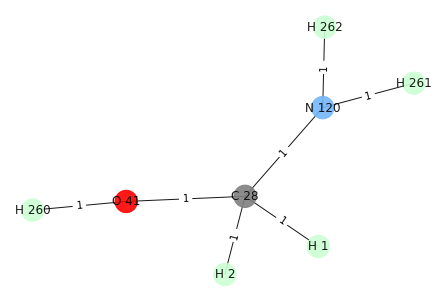

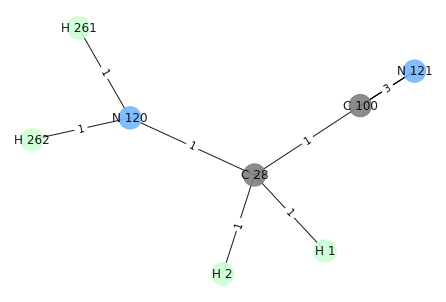

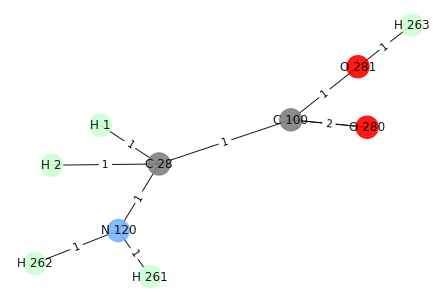

Next compound


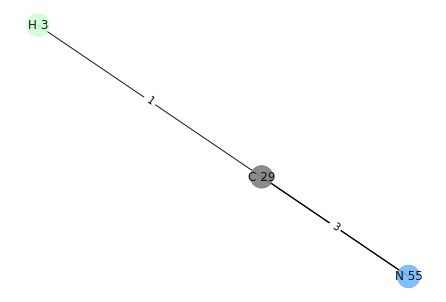

flag == True, CN
(C 29, N 55)


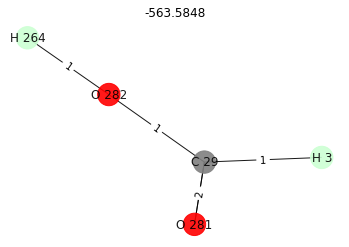

Next compound


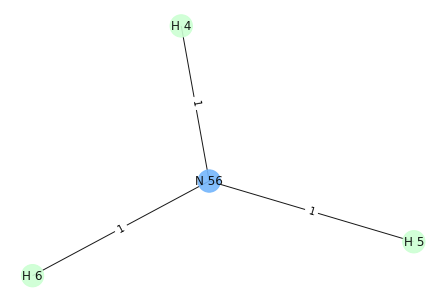

Next compound


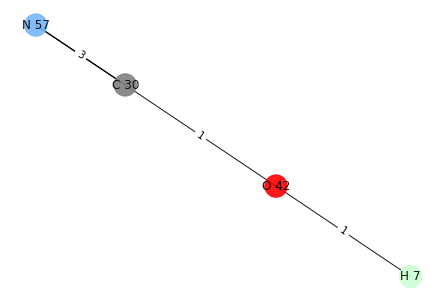

flag == True, CN
(C 30, N 57)


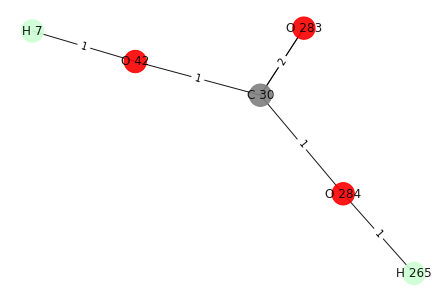

Enter G value of [O 284, H 7, O 42, H 265, C 30, O 283]: -814.49928


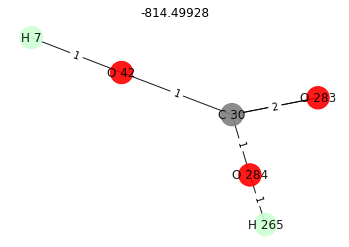

Next compound


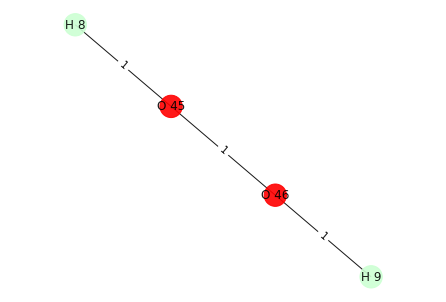

Next compound


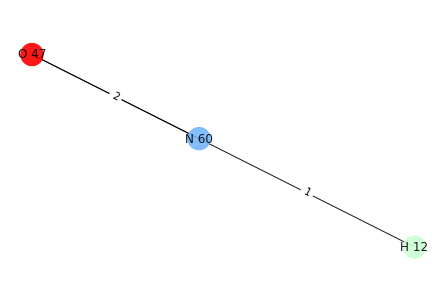

Next compound


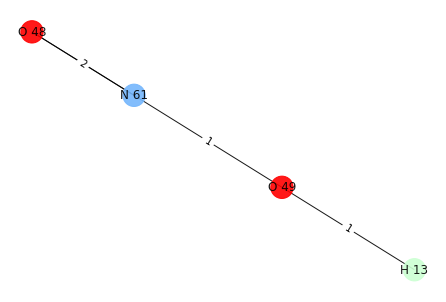

Next compound


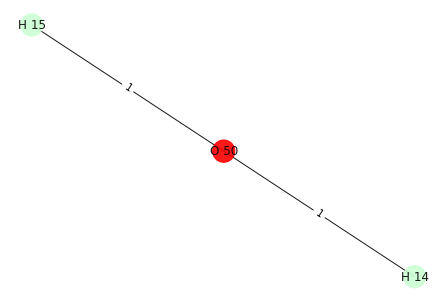

Next compound


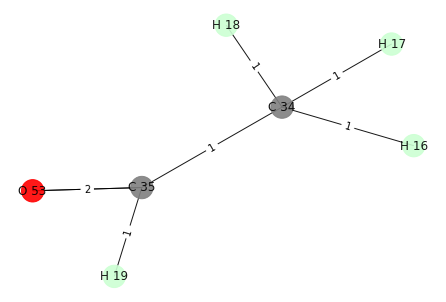

flag == True, CO


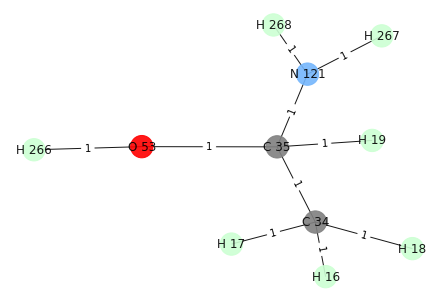

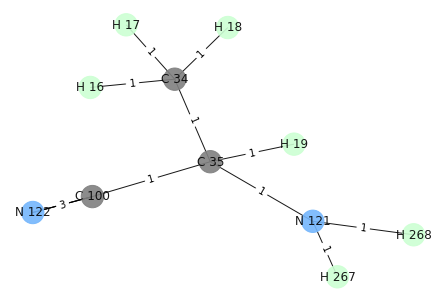

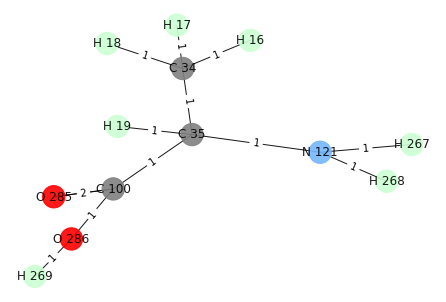

Enter G value of [H 19, H 268, C 34, C 100, H 18, H 16, O 285, H 269, C 35, N 121, H 17, O 286, H 267]: -623.24864


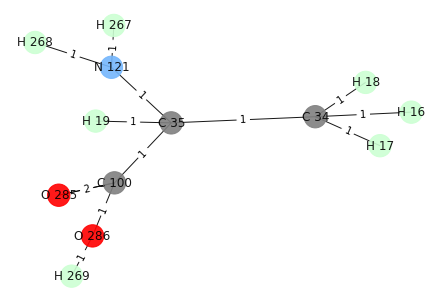

Next compound


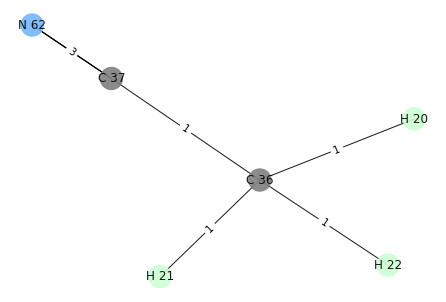

flag == True, CN
(C 37, N 62)


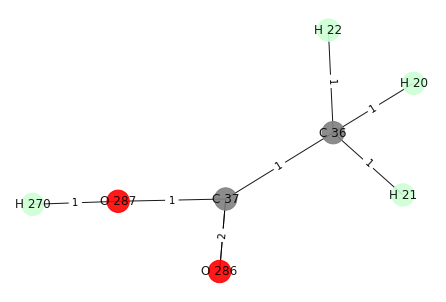

Enter G value of [H 20, O 287, C 37, H 21, O 286, H 270, C 36, H 22]: -646.80456


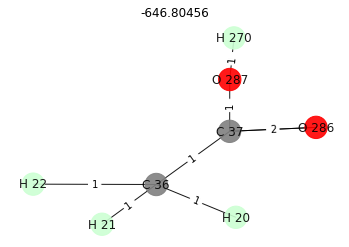

Next compound


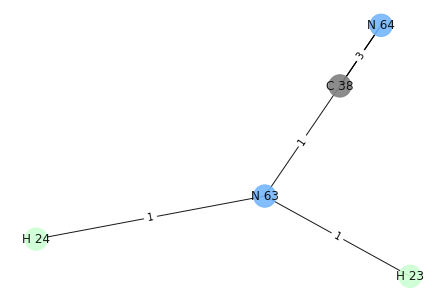

flag == True, CN
(C 38, N 64)


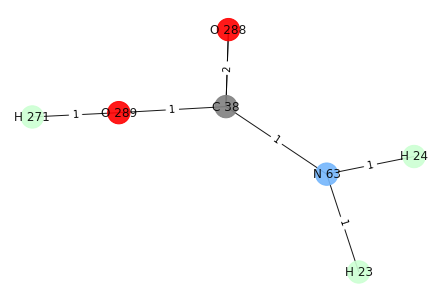

Enter G value of [O 288, H 23, C 38, H 24, O 289, N 63, H 271]: -174.93304


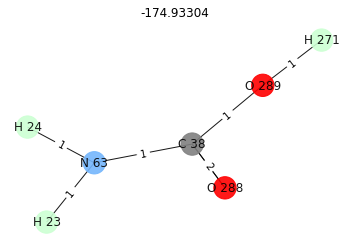

Next compound


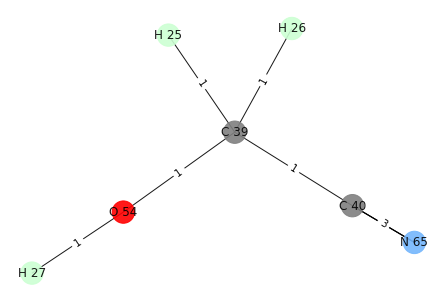

flag == True, CN
(C 40, N 65)


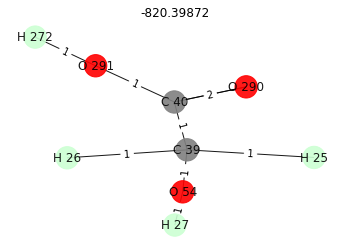

Next compound


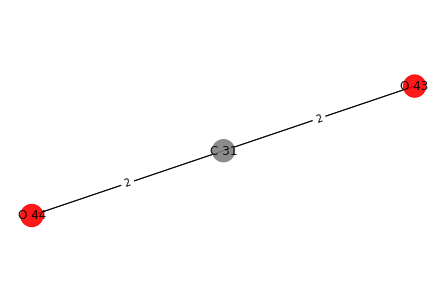

Next compound


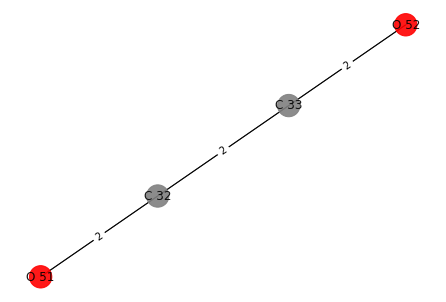

flag == True, CO


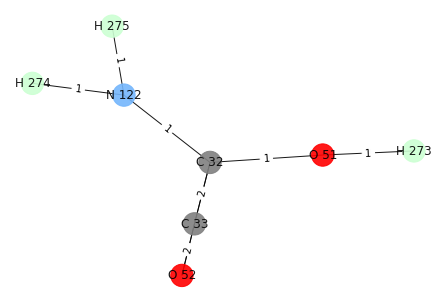

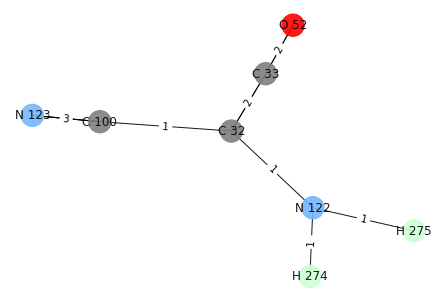

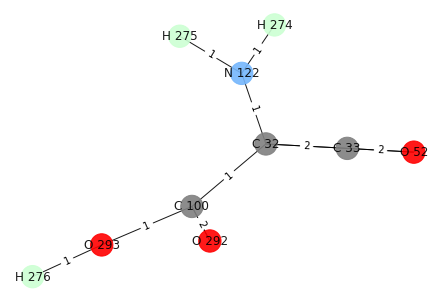

Enter G value of [O 292, H 276, H 275, C 100, O 293, C 32, H 274, N 122, C 33, O 52]: -200


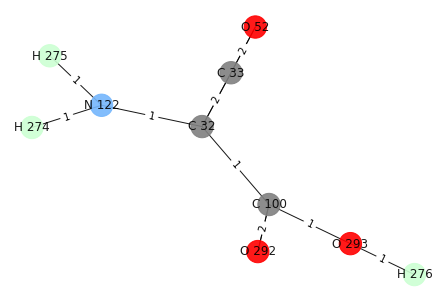

In [19]:
# Performing Strecker Amino Acid Synthesis.

#The below list will be serving as a reserve for addition of -CN, -COOH later.
extra_H = [Atom("H", i) for i in range(100,300)]
extra_O = [Atom("O", i) for i in range(100,300)]
extra_C = [Atom("C", i) for i in range(100,300)]
extra_N = [Atom("N", i) for i in range(100,300)]

oidx = 0
hidx = 0
cidx = 0
nidx = 0

changed_graph = {}

# Identify if the connected component, i.e, the compound has an aldehyde/ketone group or cyanide group.
for compound in new_final:
    flag = False
    print("Next compound")
    plot_fig(compound)
    for c in aldehyde_ketones[compound]:
        if c[0] in nx.nodes(compound):
            flag = True
            case = "CO"
            break
    if flag == False:
        for cn in cyanides[compound]:
            if cn[0] in nx.nodes(compound):
                flag = True
                case = "CN"
                break

    #If compound is an aldehyde/ketone
    if flag == True and case=="CO":
        print("flag == True, CO")
        compound = nx.MultiGraph(compound)
        
        compound.remove_edge(c[1], c[0])
        # Reduce the compound, by adding NH2.
        new_h = hidx
        compound.add_edge(c[1],extra_H[hidx])
        hidx += 1
        compound.add_edge(c[0],extra_N[nidx])
        for time in range(2):
            compound.add_edge(extra_N[nidx],extra_H[hidx])
            hidx += 1
        nidx += 1
        plot_fig(compound)
        
        compound.remove_edge(c[1], c[0])
        compound.remove_node(c[1])
        compound.remove_node(extra_H[new_h])
        
        #The C-OH group becomes a C-CN group according to the reaction
        compound.add_edge(c[0],extra_C[cidx])
        for time in range(3):
            compound.add_edge(extra_C[cidx],extra_N[nidx])
        plot_fig(compound)
        
        #The C-CN group further gets oxidised to form C-COOH group, forming an amino acid.
        for time in range(3):
            compound.remove_edge(extra_C[cidx],extra_N[nidx])
        compound.remove_node(extra_N[nidx])
        for i in range(2):
            compound.add_edge(extra_C[cidx],extra_O[oidx])
        oidx += 1
        compound.add_edge(extra_C[cidx],extra_O[oidx])
        compound.add_edge(extra_O[oidx],extra_H[hidx])
        hidx += 1
        
        changed_graph[compound] = input_G(compound)
        fix_valencies(compound)
        plot_fig(compound)
    
    #If the compound has a CN group
    elif flag == True and case=="CN":
        print("flag == True, CN")
        print(cn)
        compound = nx.MultiGraph(compound)
        neigh = compound[cn[0]]
        non_n_neigh = [i for i in neigh if (i._name.split()[0]!="N")]
        
        #The C-CN group is oxidised to form C-COOH group
        for time in range(3):
            compound.remove_edge(cn[1], cn[0])
        
        for time in range(2):
            compound.add_edge(cn[0], extra_O[oidx])
        oidx += 1
        
        compound.add_edge(cn[0], extra_O[oidx])
        compound.add_edge(extra_O[oidx], extra_H[hidx])
        hidx += 1
        oidx += 1
        
        compound.remove_node(cn[1])
        changed_graph[compound] = input_G(compound)
        fix_valencies(compound)
        plot_fig(compound, changed_graph[compound])